In [ ]:
!pip install segmentation-models-pytorch

# Polyps Segmentation using U-Net

Note: This notebook is run on Google Colab

## Contents
1. [Environment](#1)
2. [Data Exploration](#2)
    - Sample images
    - Distribution
3. [Data preprocessing](#3)
    - Recoding the mask colours to classes
    - Crop images and masks
    - Augmentations
    - Prepare Dataset and DataLoader
    - Calculate class weights
4. [Baseline UNet Model](#4)
    - Model Architecture
    - Convolution block
    - Downsample block
    - Upsample block
    - UNet Model
    - Model compile and Training
    - Hyperparameter Tuning
    - Evaluate model
5. [Modified UNet Model](#5)
    - Model Architecture
    - Attention Block
    - Attention UNet Model
    - Hyper-parameter Tuning
    - Evaluate model
6. [Comparing both models](#6)
    - Best Hyperparameters
    - Performance on Test Set

<a id="1"></a>
## 1. Environment

Environment

|Python Packages|Version|
|---|---|
|anaconda|23.5.0|
|python|3.9.16|
|numpy|1.24.3|
|matplotlib|3.7.1|
|opencv-python|4.8.0.74|
|pillow|9.4.0|
|albumentation|1.3.1 |
|pytorch|2.0.1|
|segmentation-models-pytorch|0.3.3|
|tqdm|4.65.0|

In [37]:
from typing import Union
import random
import pathlib
import glob
import time
import os
import gc

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix
import cv2
from PIL import Image

import albumentations as A
from albumentations.pytorch import ToTensorV2

import segmentation_models_pytorch as smp

import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn

from tqdm import tqdm

In [3]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [38]:
project_folder_path = "/content/drive/MyDrive/"

os.makedirs(f"{project_folder_path}models/", exist_ok=True)

Fix random seeds

In [39]:
torch.manual_seed(0)
random.seed(0)
np.random.seed(0)
torch.backends.cudnn.benchmark = False
torch.backends.cudnn.deterministic = True

Set device according to CUDA availablility

In [40]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


<a id="2"></a>
## 2. Data Exploration <a id="2"></a>
### Sample images
Both the image and the masks are in RGB where the neoplastic polyp is red and non-neoplastic polyp is green.

The images have varying sizes where the width is always 1280 pixels while the height of the images includes the following values: `[959, 969, 977, 995, 1024]`

The height differences are due to the UI in the software which captures and visualise the colonoscopy images.

In [41]:
def plot_image_and_mask(sample_img: Union[np.ndarray, Image.Image], sample_mask: Union[np.ndarray, Image.Image]):
    """
    Plot the image and mask together.

        Args:
            sample_img (np.array): The image.
            sample_mask (np.array): The mask.
    """
    fig, ax = plt.subplots(1, 3, figsize=(10, 10))

    # Plot image
    ax[0].imshow(sample_img)
    ax[0].set_title("Image")
    ax[0].set_axis_off()

    # Plot mask
    ax[1].imshow(sample_mask)
    ax[1].set_title("Mask")
    ax[1].set_axis_off()

    # Plot overlay
    ax[2].imshow(sample_img)
    ax[2].imshow(sample_mask, alpha=0.25)
    ax[2].set_title("Overlay")
    ax[2].set_axis_off()

    plt.tight_layout()
    plt.show()

### Sample image with neoplastic polyp class and extra height due to software UI

Image size: (1280, 995)


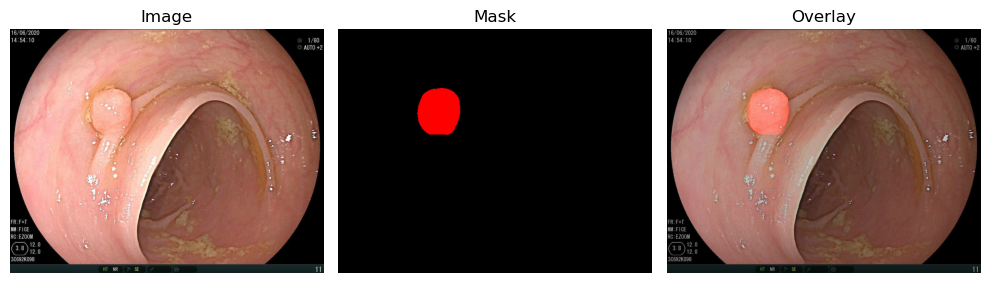

In [42]:
sample_img = Image.open(pathlib.Path(project_folder_path)/"train"/"image"/"fc01019eec999fd84e679b05f9a5e1ac.jpeg")
sample_mask = Image.open(pathlib.Path(project_folder_path)/"train"/"gt"/"fc01019eec999fd84e679b05f9a5e1ac.jpeg")

print(f"Image size: {sample_img.size}")
# Plot the image and mask
plot_image_and_mask(sample_img, sample_mask)

### Sample image with non-neoplastic ployp and minimum height

Image size: (1280, 959)


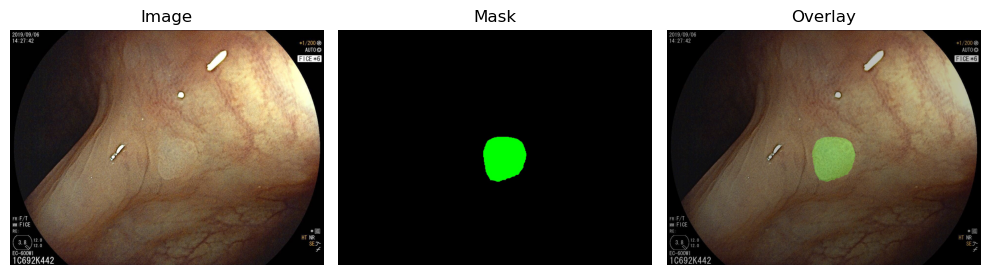

In [43]:
sample_img = Image.open(pathlib.Path(project_folder_path)/"train"/"image"/"f55b0b4c4137c02accbfc1328f439a11.jpeg")
sample_mask = Image.open(pathlib.Path(project_folder_path)/"train"/"gt"/"f55b0b4c4137c02accbfc1328f439a11.jpeg")

print(f"Image size: {sample_img.size}")
# Plot the image and mask
plot_image_and_mask(sample_img, sample_mask)

### Sample image with both classes and extra height due to software UI

Image size: (1280, 995)


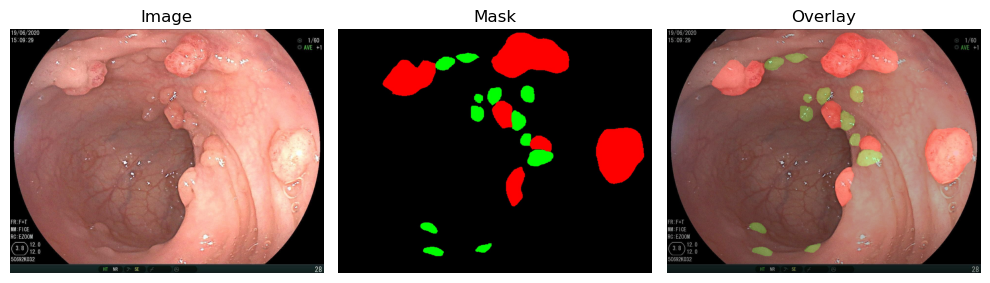

In [44]:
sample_img = Image.open(pathlib.Path(project_folder_path)/"train"/"image"/"960c94b0aab4c024a573c692195f853a.jpeg")
sample_mask = Image.open(pathlib.Path(project_folder_path)/"train"/"gt"/"960c94b0aab4c024a573c692195f853a.jpeg")

print(f"Image size: {sample_img.size}")
# Plot the image and mask
plot_image_and_mask(sample_img, sample_mask)

### Distribution

There are relatively more reds (neoplastic polyphs) than greens (non-neoplasitc polyps), approximately `144:7:1` (bg:red:green)

In addition, more than 3 unique RGB colour values are stored within the mask images after thresholding instead of only red `[255,0,0]`, green `[0,255,0]`, and black `[0,0,0]`, the classes assignment of these pixels will be handled in preprocessing below

In [ ]:
static_pixel_count = {(0, 0, 0): 947062543, (255, 0, 0): 46606695, (0, 255, 0): 6590575, (255, 255, 0): 27}


In [ ]:
print(static_pixel_count)

{(0, 0, 0): 947062543, (255, 0, 0): 46606695, (0, 255, 0): 6590575, (255, 255, 0): 27}


In [ ]:
def get_pixel_count_after_threshold():
    pixel_count = {}
    for mask in tqdm(os.listdir(pathlib.Path(project_folder_path)/"train"/"gt")):
        sample_mask = cv2.imread(project_folder_path + "train/gt/" + mask)
        filtered_mask = cv2.cvtColor(sample_mask, cv2.COLOR_BGR2RGB)
        filtered_mask = cv2.threshold(filtered_mask, 128, 255, cv2.THRESH_BINARY)[1]

        for colour, count in zip(*np.unique(filtered_mask.reshape(-1, filtered_mask.shape[2]), axis=0, return_counts=True)):
            if tuple(colour) not in pixel_count:
                pixel_count[tuple(colour)] = count
            else:
                pixel_count[tuple(colour)] += count

    return pixel_count

# Uncomment to run as it takes more than 5 minutes to run
# pixel_count = get_pixel_count_after_threshold()
# print()
# print(pixel_count)

100%|██████████| 795/795 [23:32<00:00,  1.78s/it]


{(0, 0, 0): 947062543, (255, 0, 0): 46606695, (0, 255, 0): 6590575, (255, 255, 0): 27}


<a id="3"></a>
## 3. Data preprocessing

### Recoding the mask colours to classes
The `recode_mask_colours` function is used to recode the mask image to a H x W x (number of classes) array

In all of the subsequent preprocessing steps below, it is assumed that:
1. red (neoplastic polyp class) is equivalent to pixels with RGB value `[>128,<30,<30]`
2. green (non-neoplastic polyp class) is equivalent to pixels with RGB value `[<30,>128,<30]`
3. black (others and background) is equivalent all other pixels

In [45]:
def recode_mask_colours(mask: np.ndarray):
    """
    Recode the mask colours to 0, 1, 2 for black (background, others), red (noeplastic polyp), green (non-noeplastic polyp) respectively.

        Args:
            mask (np.array): The mask to recode.

        Returns:
            np.array: The recoded mask.
    """
    # create a 1 channel mask with -1 as the default value
    filtered_mask = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int8)

    # red
    filtered_mask[cv2.inRange(mask, (128, 0, 0), (255, 30, 30)) > 0] = 1.
    # green
    filtered_mask[cv2.inRange(mask, (0, 128, 0), (30, 255, 30)) > 0] = 2.

    return filtered_mask

def decode_mask_colours(mask: np.ndarray):
    """
    Decode the mask colours to black (background, others), red (noeplastic polyp), green (non-noeplastic polyp) from 0, 1, 2 respectively.

        Args:
            mask (np.array): The mask to decode.

        Returns:
            np.array: The decoded mask.
    """
    # create a 3 channel mask with 0 as the default value
    decoded_mask = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)

    # red
    decoded_mask[(mask == 1).squeeze(axis=-1) if mask.ndim == 3 else (mask == 1)] = [255, 0, 0]
    # green
    decoded_mask[(mask == 2).squeeze(axis=-1) if mask.ndim == 3 else (mask == 2)] = [0, 255, 0]

    return decoded_mask

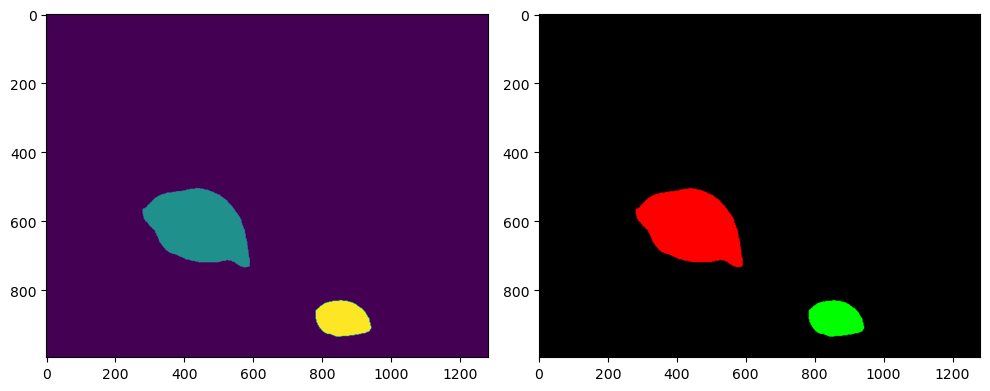

In [46]:
sample_img = Image.open(pathlib.Path(project_folder_path)/"train"/"image"/"f809d3ddb54343665e7e177b15dfae76.jpeg")
sample_mask = Image.open(pathlib.Path(project_folder_path)/"train"/"gt"/"f809d3ddb54343665e7e177b15dfae76.jpeg")

# Plot the filtered mask of 1 channel with classes 0, 1, 2
encoded_mask = recode_mask_colours(np.array(sample_mask))
fig, ax = plt.subplots(1, 2, figsize=(10, 10))
ax[0].imshow(encoded_mask)
decoded_mask = decode_mask_colours(encoded_mask)
ax[1].imshow(decoded_mask)

plt.tight_layout()
plt.show()

### Crop images and masks
The `remove_bottom_row` function is used to crop the image and the mask to remove the bottom UI display, results in a image of height of 959 pixels to align with the images with minimum dimensions

In [47]:
def remove_bottom_row(img: np.ndarray, mask: np.ndarray):
    """
    Remove the bottom row of the image and mask resulting in a 1280x959 image and mask.

        Args:
            img (np.array): The image.
            mask (np.array): The mask.

        Returns:
            np.array: The cropped image.
            np.array: The cropped mask.
    """
    return img[:959], mask[:959]

before processing
Image shape: (995, 1280, 3)


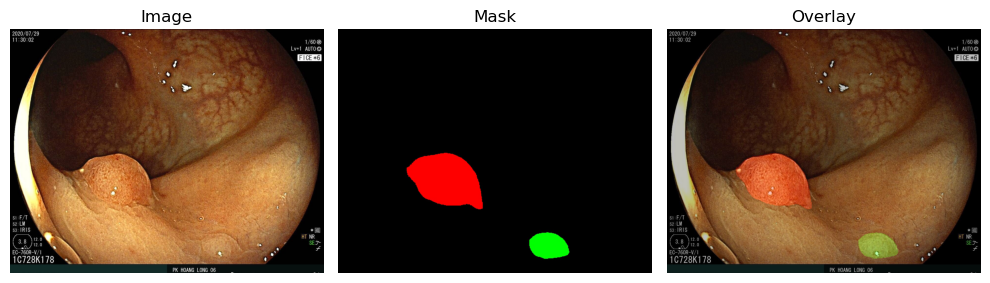

after processing
Image shape: (959, 1280, 3)


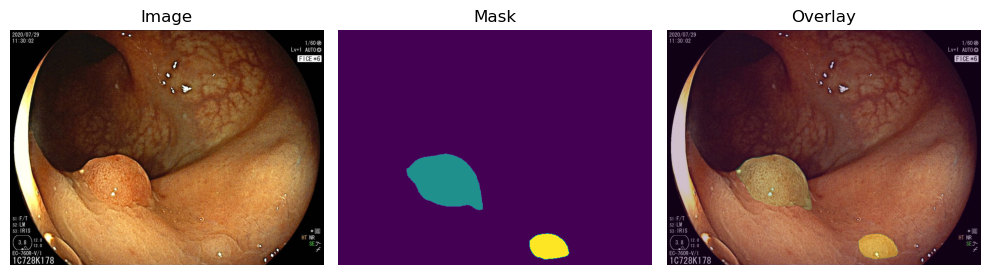

In [48]:
processed_img, processed_mask = remove_bottom_row(np.array(sample_img), recode_mask_colours(np.array(sample_mask)))

print("before processing")
print(f"Image shape: {np.array(sample_img).shape}")
plot_image_and_mask(sample_img, sample_mask)
print("after processing")
print(f"Image shape: {processed_img.shape}")
plot_image_and_mask(processed_img, processed_mask)

### Augmentations
Using `torchvision.transforms` modules and classes to augment the image and masks

All images are normalised via `ToTensor()` scaling from [0, 255] to [0, 1] and then resized to 256x256

Since the image contents will be within the ellipse of the center of the image, selected transformations included

|Transformation|
|---|
|Random Rotation of 90 degrees|
|Random Horizontal Flip|
|Random Vertical Flip|

In [49]:
train_transform = A.Compose([
    A.Resize(256, 256),
    A.Rotate([90, 90], p=0.5),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    ToTensorV2()
])

val_transform = A.Compose([
    A.Resize(256, 256),
    ToTensorV2()
])

### Prepare Dataset and DataLoader

In [50]:
class PolypDataset(Dataset):
    def __init__(self, imgPaths, maskPaths, transform=None, seed=0):
        self.transform = transform
        self.imgs = imgPaths
        self.masks = maskPaths
        self.seed = seed

    def __len__(self):
        return len(self.imgs)

    def __getitem__(self, idx):
        img_path = self.imgs[idx]
        mask_path = self.masks[idx]
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(mask_path)
        mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
        img, mask = remove_bottom_row(np.array(img), np.array(mask))
        mask = recode_mask_colours(mask)

        # DEBUG use
        # print(f"image path: {img_path}, mask path: {mask_path}")

        # set seed so that the same transformation is applied to image and mask
        if self.transform:
            # transform the image and mask
            random.seed(self.seed)
            transformed = self.transform(image=img, mask=mask)
            img, mask = transformed["image"].float() / 255.0, transformed["mask"].long()

            # change seed so that the next image and mask will be transformed differently
            # but the whole series will be reproducible throughout the training
            self.seed += 1

        return img, mask

train size: 636
test size: 159


image shape: torch.Size([8, 3, 256, 256])
mask shape: torch.Size([8, 256, 256])


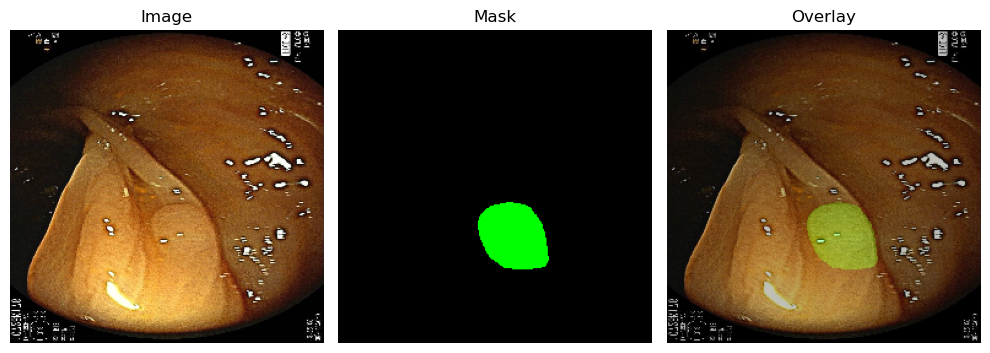

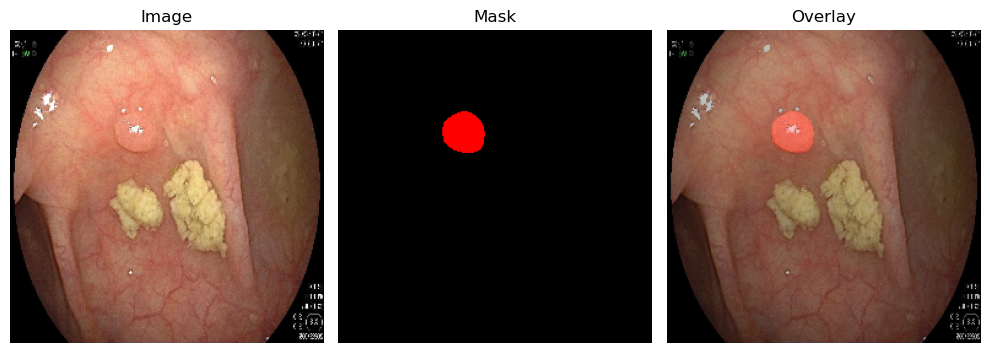

In [51]:
imgPaths = sorted(list(glob.glob(project_folder_path + "train/image/*.jpeg")))
maskPaths = sorted(list(glob.glob(project_folder_path + "train/gt/*.jpeg")))

img_mask_paths = list(zip(imgPaths, maskPaths))

random.seed(0)
random.shuffle(img_mask_paths)

train_files = img_mask_paths[:int(len(imgPaths)*0.8)]
valid_files = img_mask_paths[int(len(imgPaths)*0.8):]

# create the dataset
train_dataset = PolypDataset([x[0] for x in train_files], [x[1] for x in train_files], transform=train_transform)
valid_dataset = PolypDataset([x[0] for x in valid_files], [x[1] for x in valid_files], transform=val_transform)

print(f"train size: {len(train_dataset)}")
print(f"test size: {len(valid_dataset)}")

# create the dataloader with batch size of 4
torch.manual_seed(0)
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)

# plot 2 of the augmented images
img, mask = next(iter(train_loader))
print(f"image shape: {img.shape}")
print(f"mask shape: {mask.shape}")

aug_img, aug_mask = img[6].permute(1, 2, 0), decode_mask_colours(mask[6])
aug_img2, aug_mask2 = img[7].permute(1, 2, 0), decode_mask_colours(mask[7])
plot_image_and_mask(aug_img, aug_mask)
plot_image_and_mask(aug_img2, aug_mask2)

check and compare with original image and mask

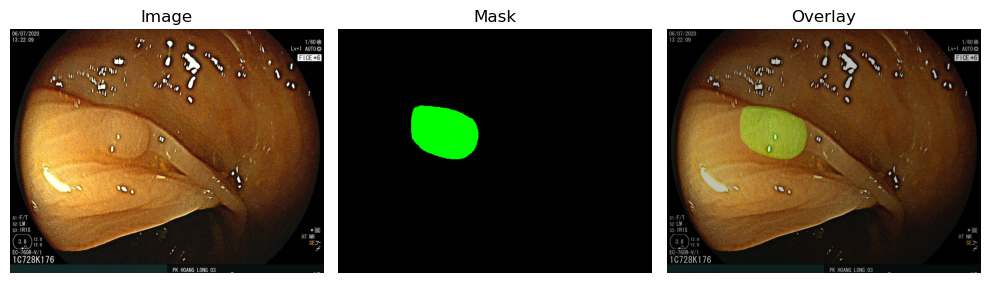

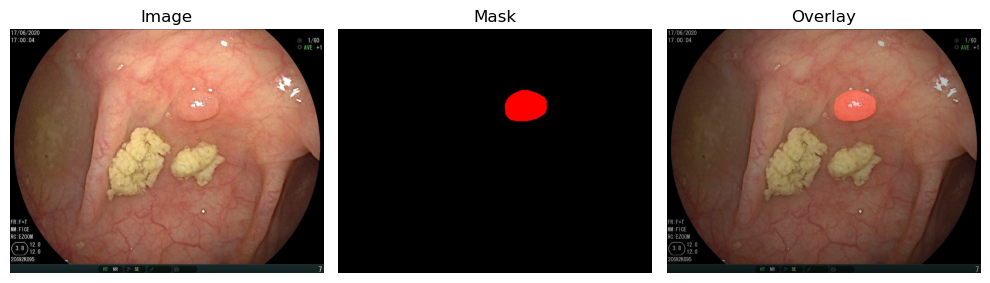

In [52]:
plot_image_and_mask(Image.open(project_folder_path + "train/image/76ed9f178dc2f4af626650908b1cb932.jpeg"), Image.open(project_folder_path + "train/gt/76ed9f178dc2f4af626650908b1cb932.jpeg"))
plot_image_and_mask(Image.open(project_folder_path + "train/image/076135d76d0bbd4ce2a1405f7d507592.jpeg"), Image.open(project_folder_path + "train/gt/076135d76d0bbd4ce2a1405f7d507592.jpeg"))

### Calculate class weights

The class weights for each class is calculated by $\frac{\textrm{Numer of pixels in Class c}}{\textrm{Total number of pixels}}$ among images only in the training set.

This is to prevent data leakage with the mix of distribution of validation set and test set.

In [53]:
# Get class counts and return weights for each class

# Use a full batch size to calculate class weights
train_batches = DataLoader(train_dataset, batch_size=len(train_dataset))

def get_class_weights(batches: DataLoader, device: str="cpu") -> torch.Tensor:
    class_count = torch.zeros(3).to(device, non_blocking=True)

    for _, targets in batches:
        _, counts = torch.unique(targets.to(device, non_blocking=True), return_counts=True)
        class_count += counts
    class_weights = torch.sum(class_count) / class_count

    assert len(class_weights) == 3, "Class weights should be of length 3"
    return class_weights

class_weights = get_class_weights(train_batches, device).to(device)

print("using class weights:", class_weights)

using class weights: tensor([  1.0580,  20.6045, 159.4367], device='cuda:0')


<a id="4"></a>
## 4. Baseline Unet Model

### Model Architecture
The UNet uses convolutional layers to train parameters (weights and bias) of image kernels which further learns the characteristics including lines, contour, up to complex shapes in deeper layers. It utilises the downsampling blocks with max pooling to reduce the dimensions of the original image by convolution but growing number of channels and then upsampling blocks to expand the dimension back to the original image size by transposed convolutions. Skip connections are added from downsampling layers to upsampling layers where the feature map obtained through convolution blocks before max pooling is concatenated to the corresponding results after upsampling then further passed to the next convolution. Finally, a specific convolutional layer can be added to the last upsampling block. In this case a softmax activation function can be used to obtain the probabilities for each class and argmax is used to get the assigned class for multiclass classfication. Cross entropy loss and Dice Loss will be used to optimize the network.

### Convolution block
A double convolutional block that is used both in upsampling and downsampling blocks

In [54]:
class Conv_block(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding="same"):
        super(Conv_block, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size, stride, padding, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu2 = nn.ReLU(inplace=True)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu2(x)
        return x

### Downsample block
A downsampling block that wraps the convolution block and max pooling layer

In [55]:
class Downsample_block(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding="same"):
        super(Downsample_block, self).__init__()
        self.conv_block = Conv_block(in_channels, out_channels, kernel_size, stride, padding)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        skip = self.conv_block(x)
        x = self.pool(skip)
        return x, skip

### Upsample block
A upsampling block that wraps the concatenates the skip connection features and wraps the transpose convolution layer and convolution block

In [56]:
class Upsample_block(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding="same"):
        super(Upsample_block, self).__init__()
        self.up = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv_block = Conv_block(in_channels, out_channels, kernel_size, stride, padding)

    def forward(self, x, skip):
        x = self.up(x)
        x = torch.cat([x, skip], axis=1)
        x = self.conv_block(x)
        return x

### UNet Model
Combine all parts for the model

In [57]:
class UNet(nn.Module):
    def __init__(self, out_channels=3, features=[64, 128, 256, 512]):
        super(UNet, self).__init__()
        # Downsample 64 -> 128 -> 256 -> 512
        self.down1 = Downsample_block(3, features[0])
        self.down2 = Downsample_block(features[0], features[1])
        self.down3 = Downsample_block(features[1], features[2])
        self.down4 = Downsample_block(features[2], features[3])
        # Bottleneck 512 -> 1024
        self.bottleneck = Conv_block(features[3], features[3]*2, kernel_size=3, stride=1, padding="same")
        # Upsample 512 -> 256 -> 128 -> 64
        self.up1 = Upsample_block(features[3]*2, features[3])
        self.up2 = Upsample_block(features[3], features[2])
        self.up3 = Upsample_block(features[2], features[1])
        self.up4 = Upsample_block(features[1], features[0])
        self.out = nn.Conv2d(features[0], out_channels, kernel_size=1, stride=1, padding=0, bias=True)

    def forward(self, x):
        # Downsample 64 -> 128 -> 256 -> 512
        x, skip1 = self.down1(x)
        x, skip2 = self.down2(x)
        x, skip3 = self.down3(x)
        x, skip4 = self.down4(x)
        # Bottleneck 512 -> 1024
        x = self.bottleneck(x)
        # Upsample 512 -> 256 -> 128 -> 64 with concatenation and skip connections
        x = self.up1(x, skip4)
        x = self.up2(x, skip3)
        x = self.up3(x, skip2)
        x = self.up4(x, skip1)
        x = self.out(x)
        return x

### Model compile and Training

Example for model compilation

In [58]:
model = UNet(out_channels=3).to(device)

Define training loop

In [59]:
def run_train_loop(
        set_name: str, model: UNet, train_batches: DataLoader, valid_batches: DataLoader, epochs: int,
        criterion: torch.nn.Module, optimizer: torch.optim.Optimizer
    ):
    model.to(device)

    history = {
        "train_loss": [],
        "val_loss": [],
        "train_dice": [],
        "val_dice": []
    }

    for epoch in range(epochs):
        # set the model in training phase
        model.train()

        total_train_loss = 0
        total_val_loss = 0
        train_dice = 0
        val_dice = 0

        for data, targets in tqdm(train_batches):
            data = data.to(device, non_blocking=True)
            targets = targets.to(device, non_blocking=True)

            # zero the parameter gradients
            optimizer.zero_grad()

            # forward
            output = model(data)
            loss = criterion(output, targets)

            # backward
            loss.backward()

            # gradient descent or adam step
            optimizer.step()

            total_train_loss += loss.detach()*data.size(0)

            # evaluate dice coefficient on test set
            tp, fp, fn, tn = smp.metrics.get_stats(torch.argmax(output, dim=1).long(), targets, mode="multiclass", num_classes=3)
            train_dice = smp.metrics.f1_score(tp, fp, fn, tn, reduction="weighted", class_weights=class_weights).detach()

        # set the model in evaluation phase
        with torch.no_grad():
            model.eval()

            for data, targets in valid_batches:
                data = data.to(device, non_blocking=True)
                targets = targets.to(device, non_blocking=True)

                # forward
                output = model(data)
                loss = criterion(output, targets)

                total_val_loss += loss.detach()*data.size(0)

                # evaluate dice coefficient on test set
                tp, fp, fn, tn = smp.metrics.get_stats(torch.argmax(output, dim=1).long(), targets, mode="multiclass", num_classes=3)
                val_dice = smp.metrics.f1_score(tp, fp, fn, tn, reduction="weighted", class_weights=class_weights).detach()

        # compute the average loss and accuracy
        avg_train_loss = total_train_loss.cpu() / len(train_dataset)
        avg_val_loss = total_val_loss.cpu() / len(valid_dataset)

        history["train_loss"].append(avg_train_loss)
        history["val_loss"].append(avg_val_loss)
        history["train_dice"].append(train_dice)
        history["val_dice"].append(val_dice)

        if (epoch+1) % 20 == 0:
            torch.save(
                {
                    "epoch": epoch+1,
                    "model_state_dict": model.state_dict(),
                    "optimizer_state_dict": optimizer.state_dict(),
                    "history": history,
                },
                f"{project_folder_path}models/{set_name}_model_epoch{epoch+1}.pth"
            )

        # print the loss and accuracy for the epoch
        print(f"Epoch {(epoch+1)}/{epochs} Train Loss: {avg_train_loss:.4f} Validation Loss: {avg_val_loss:.4f}, Train Dice Score: {train_dice:.4f} Validation Dice Score: {val_dice:.4f}")

    return history

In [60]:
def plot_history(history):
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(history["train_loss"], label="train loss")
    plt.plot(history["val_loss"], label="validation loss")
    plt.title("Loss vs epochs")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.ylim([0, 1])
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history["train_dice"], label="train dice score")
    plt.plot(history["val_dice"], label="validation dice score")
    plt.title("Dice score vs epochs")
    plt.xlabel("Epochs")
    plt.ylabel("Weighted Dice Coefficient")
    plt.ylim([0, 1])
    plt.legend()
    plt.show()

Create seed worker for data loader

In [61]:
def seed_worker(worker_id):
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)
    torch.manual_seed(worker_seed)
    torch.cuda.manual_seed_all(worker_seed)

<i>Optional garbage collection to free up space</i>

In [62]:
torch.cuda.empty_cache()
gc.collect()

76116

### Hyperparameter Tuning

To keep running the hyperparameters tuning within time acceptable range, only learning rate is focused.

The models are saved per 20 epochs so the best model can be selected in a sense of early stopping.

| Hyperparameters | Set 1 | Set 2 | Set 3 | Set 4 |
|---|---|---|---|---|
| loss function | Weighted Cross Entropy |  Weighted Cross Entropy | Dice Loss | Dice Loss |
| learning rate $\alpha$ | `1e-4`, i.e. `0.0001` | `1e-5`, i.e. `0.00005`|`1e-4`, i.e. `0.0001` | `1e-5`, i.e. `0.00005`|
| batch size | `32` | `32` | `32` | `32` |
| epochs | `250` | `250` | `250` | `250` |

#### Set 1
loss: Weighted Cross Entropy, learning rate: 1e-4, batch size: 32, epochs: 250

100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 1/250 Train Loss: 1.0906 Validation Loss: 1.0820, Train Dice Score: 0.0510 Validation Dice Score: 0.0087


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 2/250 Train Loss: 0.9679 Validation Loss: 1.0056, Train Dice Score: 0.0346 Validation Dice Score: 0.0388


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 3/250 Train Loss: 0.9079 Validation Loss: 0.8708, Train Dice Score: 0.0451 Validation Dice Score: 0.0443


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 4/250 Train Loss: 0.8837 Validation Loss: 0.8969, Train Dice Score: 0.0499 Validation Dice Score: 0.0406


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 5/250 Train Loss: 0.8499 Validation Loss: 0.8083, Train Dice Score: 0.0573 Validation Dice Score: 0.0436


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 6/250 Train Loss: 0.8305 Validation Loss: 0.8492, Train Dice Score: 0.0605 Validation Dice Score: 0.0462


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 7/250 Train Loss: 0.8190 Validation Loss: 0.8190, Train Dice Score: 0.0649 Validation Dice Score: 0.0466


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 8/250 Train Loss: 0.8196 Validation Loss: 0.8312, Train Dice Score: 0.0846 Validation Dice Score: 0.0436


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 9/250 Train Loss: 0.8094 Validation Loss: 0.7465, Train Dice Score: 0.0668 Validation Dice Score: 0.0665


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 10/250 Train Loss: 0.7853 Validation Loss: 0.7307, Train Dice Score: 0.0526 Validation Dice Score: 0.0542


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 11/250 Train Loss: 0.7800 Validation Loss: 0.7211, Train Dice Score: 0.0368 Validation Dice Score: 0.0578


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 12/250 Train Loss: 0.7473 Validation Loss: 0.7144, Train Dice Score: 0.0608 Validation Dice Score: 0.0635


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 13/250 Train Loss: 0.7476 Validation Loss: 0.7137, Train Dice Score: 0.1099 Validation Dice Score: 0.0582


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 14/250 Train Loss: 0.7217 Validation Loss: 0.7985, Train Dice Score: 0.0795 Validation Dice Score: 0.0580


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 15/250 Train Loss: 0.7230 Validation Loss: 0.7371, Train Dice Score: 0.0665 Validation Dice Score: 0.0559


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 16/250 Train Loss: 0.6901 Validation Loss: 0.7384, Train Dice Score: 0.0798 Validation Dice Score: 0.0807


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 17/250 Train Loss: 0.7009 Validation Loss: 0.6510, Train Dice Score: 0.0768 Validation Dice Score: 0.0646


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 18/250 Train Loss: 0.6869 Validation Loss: 0.6869, Train Dice Score: 0.0703 Validation Dice Score: 0.0607


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 19/250 Train Loss: 0.6891 Validation Loss: 0.6921, Train Dice Score: 0.0728 Validation Dice Score: 0.0790


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 20/250 Train Loss: 0.6473 Validation Loss: 0.6525, Train Dice Score: 0.0993 Validation Dice Score: 0.0842


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 21/250 Train Loss: 0.6728 Validation Loss: 0.8300, Train Dice Score: 0.0646 Validation Dice Score: 0.0473


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 22/250 Train Loss: 0.7147 Validation Loss: 0.7188, Train Dice Score: 0.1078 Validation Dice Score: 0.0881


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 23/250 Train Loss: 0.6533 Validation Loss: 0.6720, Train Dice Score: 0.1236 Validation Dice Score: 0.0657


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 24/250 Train Loss: 0.6168 Validation Loss: 0.7519, Train Dice Score: 0.1376 Validation Dice Score: 0.0734


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 25/250 Train Loss: 0.6401 Validation Loss: 0.6179, Train Dice Score: 0.0577 Validation Dice Score: 0.0857


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 26/250 Train Loss: 0.6641 Validation Loss: 0.6033, Train Dice Score: 0.1138 Validation Dice Score: 0.0712


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 27/250 Train Loss: 0.6086 Validation Loss: 0.5838, Train Dice Score: 0.1213 Validation Dice Score: 0.0859


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 28/250 Train Loss: 0.5875 Validation Loss: 0.8287, Train Dice Score: 0.1026 Validation Dice Score: 0.0718


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 29/250 Train Loss: 0.6495 Validation Loss: 0.6243, Train Dice Score: 0.0988 Validation Dice Score: 0.0897


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 30/250 Train Loss: 0.5617 Validation Loss: 0.6344, Train Dice Score: 0.0992 Validation Dice Score: 0.1042


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 31/250 Train Loss: 0.5582 Validation Loss: 0.6725, Train Dice Score: 0.1397 Validation Dice Score: 0.0743


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 32/250 Train Loss: 0.5536 Validation Loss: 0.6468, Train Dice Score: 0.1395 Validation Dice Score: 0.0772


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 33/250 Train Loss: 0.5527 Validation Loss: 0.6499, Train Dice Score: 0.0923 Validation Dice Score: 0.0963


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 34/250 Train Loss: 0.5397 Validation Loss: 0.6129, Train Dice Score: 0.1054 Validation Dice Score: 0.0846


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 35/250 Train Loss: 0.5428 Validation Loss: 0.6016, Train Dice Score: 0.0989 Validation Dice Score: 0.0984


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 36/250 Train Loss: 0.5402 Validation Loss: 0.6060, Train Dice Score: 0.1586 Validation Dice Score: 0.0998


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 37/250 Train Loss: 0.4936 Validation Loss: 0.6012, Train Dice Score: 0.1260 Validation Dice Score: 0.1045


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 38/250 Train Loss: 0.5201 Validation Loss: 0.6345, Train Dice Score: 0.0906 Validation Dice Score: 0.0793


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 39/250 Train Loss: 0.5244 Validation Loss: 0.6365, Train Dice Score: 0.1134 Validation Dice Score: 0.1055


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 40/250 Train Loss: 0.4863 Validation Loss: 0.5797, Train Dice Score: 0.1068 Validation Dice Score: 0.0942


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 41/250 Train Loss: 0.4769 Validation Loss: 0.5703, Train Dice Score: 0.1363 Validation Dice Score: 0.0962


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 42/250 Train Loss: 0.4547 Validation Loss: 0.6450, Train Dice Score: 0.1109 Validation Dice Score: 0.1012


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 43/250 Train Loss: 0.4772 Validation Loss: 0.5789, Train Dice Score: 0.1061 Validation Dice Score: 0.1001


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 44/250 Train Loss: 0.4640 Validation Loss: 0.6455, Train Dice Score: 0.1084 Validation Dice Score: 0.0863


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 45/250 Train Loss: 0.4490 Validation Loss: 0.6399, Train Dice Score: 0.1336 Validation Dice Score: 0.1016


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 46/250 Train Loss: 0.4697 Validation Loss: 0.9616, Train Dice Score: 0.1051 Validation Dice Score: 0.0883


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 47/250 Train Loss: 0.5202 Validation Loss: 0.6059, Train Dice Score: 0.0991 Validation Dice Score: 0.0844


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 48/250 Train Loss: 0.4778 Validation Loss: 0.5837, Train Dice Score: 0.1845 Validation Dice Score: 0.0982


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 49/250 Train Loss: 0.4367 Validation Loss: 0.5275, Train Dice Score: 0.2154 Validation Dice Score: 0.1067


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 50/250 Train Loss: 0.4583 Validation Loss: 0.5864, Train Dice Score: 0.0903 Validation Dice Score: 0.1024


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 51/250 Train Loss: 0.4290 Validation Loss: 0.5915, Train Dice Score: 0.1493 Validation Dice Score: 0.1020


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 52/250 Train Loss: 0.4212 Validation Loss: 0.6054, Train Dice Score: 0.1144 Validation Dice Score: 0.1049


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 53/250 Train Loss: 0.3924 Validation Loss: 0.5647, Train Dice Score: 0.1654 Validation Dice Score: 0.1012


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 54/250 Train Loss: 0.4479 Validation Loss: 0.7085, Train Dice Score: 0.1952 Validation Dice Score: 0.1384


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 55/250 Train Loss: 0.4238 Validation Loss: 0.5689, Train Dice Score: 0.1170 Validation Dice Score: 0.1116


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 56/250 Train Loss: 0.4001 Validation Loss: 0.5606, Train Dice Score: 0.1138 Validation Dice Score: 0.0958


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 57/250 Train Loss: 0.4128 Validation Loss: 0.6328, Train Dice Score: 0.1456 Validation Dice Score: 0.0981


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 58/250 Train Loss: 0.4012 Validation Loss: 0.5582, Train Dice Score: 0.0953 Validation Dice Score: 0.1033


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 59/250 Train Loss: 0.3667 Validation Loss: 0.5022, Train Dice Score: 0.1490 Validation Dice Score: 0.1180


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 60/250 Train Loss: 0.4389 Validation Loss: 0.8743, Train Dice Score: 0.1088 Validation Dice Score: 0.0924


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 61/250 Train Loss: 0.4247 Validation Loss: 0.5559, Train Dice Score: 0.1462 Validation Dice Score: 0.1042


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 62/250 Train Loss: 0.3650 Validation Loss: 0.5166, Train Dice Score: 0.1666 Validation Dice Score: 0.1216


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 63/250 Train Loss: 0.3560 Validation Loss: 0.5968, Train Dice Score: 0.1225 Validation Dice Score: 0.0903


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 64/250 Train Loss: 0.3426 Validation Loss: 0.6071, Train Dice Score: 0.1199 Validation Dice Score: 0.1146


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 65/250 Train Loss: 0.3423 Validation Loss: 0.7468, Train Dice Score: 0.1780 Validation Dice Score: 0.0964


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 66/250 Train Loss: 0.3731 Validation Loss: 0.5816, Train Dice Score: 0.2305 Validation Dice Score: 0.1665


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 67/250 Train Loss: 0.3666 Validation Loss: 0.4999, Train Dice Score: 0.1288 Validation Dice Score: 0.1096


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 68/250 Train Loss: 0.4463 Validation Loss: 0.5493, Train Dice Score: 0.1042 Validation Dice Score: 0.1026


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 69/250 Train Loss: 0.3700 Validation Loss: 0.5833, Train Dice Score: 0.1217 Validation Dice Score: 0.0883


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 70/250 Train Loss: 0.3328 Validation Loss: 0.6549, Train Dice Score: 0.2107 Validation Dice Score: 0.1067


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 71/250 Train Loss: 0.3375 Validation Loss: 0.6840, Train Dice Score: 0.1571 Validation Dice Score: 0.1083


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 72/250 Train Loss: 0.3379 Validation Loss: 0.5907, Train Dice Score: 0.1113 Validation Dice Score: 0.0998


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 73/250 Train Loss: 0.3711 Validation Loss: 0.6820, Train Dice Score: 0.1505 Validation Dice Score: 0.1236


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 74/250 Train Loss: 0.3272 Validation Loss: 0.5540, Train Dice Score: 0.2011 Validation Dice Score: 0.1087


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 75/250 Train Loss: 0.3138 Validation Loss: 0.5198, Train Dice Score: 0.2057 Validation Dice Score: 0.0903


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 76/250 Train Loss: 0.3165 Validation Loss: 0.5638, Train Dice Score: 0.1083 Validation Dice Score: 0.1037


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 77/250 Train Loss: 0.3187 Validation Loss: 0.5636, Train Dice Score: 0.1318 Validation Dice Score: 0.1117


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 78/250 Train Loss: 0.3047 Validation Loss: 0.6695, Train Dice Score: 0.1284 Validation Dice Score: 0.1200


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 79/250 Train Loss: 0.2947 Validation Loss: 0.7818, Train Dice Score: 0.1705 Validation Dice Score: 0.1748


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 80/250 Train Loss: 0.3135 Validation Loss: 0.6060, Train Dice Score: 0.1395 Validation Dice Score: 0.1094


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 81/250 Train Loss: 0.3012 Validation Loss: 0.5030, Train Dice Score: 0.1437 Validation Dice Score: 0.1208


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 82/250 Train Loss: 0.2957 Validation Loss: 0.7044, Train Dice Score: 0.1826 Validation Dice Score: 0.1107


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 83/250 Train Loss: 0.2794 Validation Loss: 0.5038, Train Dice Score: 0.1789 Validation Dice Score: 0.1511


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 84/250 Train Loss: 0.2711 Validation Loss: 0.6211, Train Dice Score: 0.2070 Validation Dice Score: 0.1156


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 85/250 Train Loss: 0.2444 Validation Loss: 0.7188, Train Dice Score: 0.2537 Validation Dice Score: 0.1388


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 86/250 Train Loss: 0.2744 Validation Loss: 0.6782, Train Dice Score: 0.1281 Validation Dice Score: 0.1209


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 87/250 Train Loss: 0.2698 Validation Loss: 0.5631, Train Dice Score: 0.1435 Validation Dice Score: 0.1252


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 88/250 Train Loss: 0.2867 Validation Loss: 0.5718, Train Dice Score: 0.2167 Validation Dice Score: 0.1120


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 89/250 Train Loss: 0.2570 Validation Loss: 0.4568, Train Dice Score: 0.4423 Validation Dice Score: 0.1393


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 90/250 Train Loss: 0.2701 Validation Loss: 0.6422, Train Dice Score: 0.2471 Validation Dice Score: 0.1277


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 91/250 Train Loss: 0.2995 Validation Loss: 0.5828, Train Dice Score: 0.1405 Validation Dice Score: 0.1073


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 92/250 Train Loss: 0.2788 Validation Loss: 0.6710, Train Dice Score: 0.2355 Validation Dice Score: 0.1354


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 93/250 Train Loss: 0.2637 Validation Loss: 0.7627, Train Dice Score: 0.2315 Validation Dice Score: 0.1573


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 94/250 Train Loss: 0.2788 Validation Loss: 0.5276, Train Dice Score: 0.1454 Validation Dice Score: 0.1035


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 95/250 Train Loss: 0.2864 Validation Loss: 0.5841, Train Dice Score: 0.2150 Validation Dice Score: 0.1141


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 96/250 Train Loss: 0.2471 Validation Loss: 0.5930, Train Dice Score: 0.1166 Validation Dice Score: 0.1389


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 97/250 Train Loss: 0.2329 Validation Loss: 0.4528, Train Dice Score: 0.2068 Validation Dice Score: 0.1442


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 98/250 Train Loss: 0.2200 Validation Loss: 0.5220, Train Dice Score: 0.1936 Validation Dice Score: 0.1208


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 99/250 Train Loss: 0.2290 Validation Loss: 0.5455, Train Dice Score: 0.1337 Validation Dice Score: 0.1367


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 100/250 Train Loss: 0.2774 Validation Loss: 0.4780, Train Dice Score: 0.1569 Validation Dice Score: 0.1319


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 101/250 Train Loss: 0.2718 Validation Loss: 0.5456, Train Dice Score: 0.1544 Validation Dice Score: 0.1170


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 102/250 Train Loss: 0.2454 Validation Loss: 0.6210, Train Dice Score: 0.1837 Validation Dice Score: 0.1207


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 103/250 Train Loss: 0.3233 Validation Loss: 0.7448, Train Dice Score: 0.2002 Validation Dice Score: 0.1017


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 104/250 Train Loss: 0.2898 Validation Loss: 0.5066, Train Dice Score: 0.2535 Validation Dice Score: 0.1160


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 105/250 Train Loss: 0.2384 Validation Loss: 0.8346, Train Dice Score: 0.1824 Validation Dice Score: 0.1308


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 106/250 Train Loss: 0.2263 Validation Loss: 0.6344, Train Dice Score: 0.1803 Validation Dice Score: 0.1640


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 107/250 Train Loss: 0.1961 Validation Loss: 0.6873, Train Dice Score: 0.2009 Validation Dice Score: 0.1579


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 108/250 Train Loss: 0.2073 Validation Loss: 0.6221, Train Dice Score: 0.2100 Validation Dice Score: 0.1121


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 109/250 Train Loss: 0.2293 Validation Loss: 0.5320, Train Dice Score: 0.1489 Validation Dice Score: 0.1307


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 110/250 Train Loss: 0.2749 Validation Loss: 0.4966, Train Dice Score: 0.2426 Validation Dice Score: 0.1230


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 111/250 Train Loss: 0.2212 Validation Loss: 0.5342, Train Dice Score: 0.3864 Validation Dice Score: 0.1512


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 112/250 Train Loss: 0.1882 Validation Loss: 0.5477, Train Dice Score: 0.2619 Validation Dice Score: 0.1569


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 113/250 Train Loss: 0.1902 Validation Loss: 0.5559, Train Dice Score: 0.1677 Validation Dice Score: 0.1492


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 114/250 Train Loss: 0.1763 Validation Loss: 0.6117, Train Dice Score: 0.3084 Validation Dice Score: 0.1462


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 115/250 Train Loss: 0.2018 Validation Loss: 0.4705, Train Dice Score: 0.1742 Validation Dice Score: 0.1443


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 116/250 Train Loss: 0.2038 Validation Loss: 0.6323, Train Dice Score: 0.2962 Validation Dice Score: 0.1844


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 117/250 Train Loss: 0.1951 Validation Loss: 0.5581, Train Dice Score: 0.2559 Validation Dice Score: 0.1350


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 118/250 Train Loss: 0.2355 Validation Loss: 0.7606, Train Dice Score: 0.2341 Validation Dice Score: 0.1130


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 119/250 Train Loss: 0.2202 Validation Loss: 0.5321, Train Dice Score: 0.1693 Validation Dice Score: 0.1610


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 120/250 Train Loss: 0.1790 Validation Loss: 0.4562, Train Dice Score: 0.2812 Validation Dice Score: 0.1470


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 121/250 Train Loss: 0.1644 Validation Loss: 0.7124, Train Dice Score: 0.1996 Validation Dice Score: 0.1989


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 122/250 Train Loss: 0.1552 Validation Loss: 0.6066, Train Dice Score: 0.4267 Validation Dice Score: 0.1208


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 123/250 Train Loss: 0.1569 Validation Loss: 0.6079, Train Dice Score: 0.2815 Validation Dice Score: 0.2189


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 124/250 Train Loss: 0.1573 Validation Loss: 0.6923, Train Dice Score: 0.2281 Validation Dice Score: 0.1674


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 125/250 Train Loss: 0.1619 Validation Loss: 0.6838, Train Dice Score: 0.3304 Validation Dice Score: 0.1907


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 126/250 Train Loss: 0.1597 Validation Loss: 0.6532, Train Dice Score: 0.2788 Validation Dice Score: 0.1923


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 127/250 Train Loss: 0.1983 Validation Loss: 0.7393, Train Dice Score: 0.2427 Validation Dice Score: 0.1559


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 128/250 Train Loss: 0.2121 Validation Loss: 0.6178, Train Dice Score: 0.2803 Validation Dice Score: 0.1325


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 129/250 Train Loss: 0.2320 Validation Loss: 0.6763, Train Dice Score: 0.2299 Validation Dice Score: 0.1474


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 130/250 Train Loss: 0.2057 Validation Loss: 0.7005, Train Dice Score: 0.1620 Validation Dice Score: 0.1039


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 131/250 Train Loss: 0.1685 Validation Loss: 0.6311, Train Dice Score: 0.1831 Validation Dice Score: 0.1467


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 132/250 Train Loss: 0.1531 Validation Loss: 0.7032, Train Dice Score: 0.2583 Validation Dice Score: 0.1760


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 133/250 Train Loss: 0.1603 Validation Loss: 0.6804, Train Dice Score: 0.1474 Validation Dice Score: 0.1469


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 134/250 Train Loss: 0.2379 Validation Loss: 0.7101, Train Dice Score: 0.2151 Validation Dice Score: 0.1103


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 135/250 Train Loss: 0.2783 Validation Loss: 0.8489, Train Dice Score: 0.2398 Validation Dice Score: 0.1396


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 136/250 Train Loss: 0.1680 Validation Loss: 0.6430, Train Dice Score: 0.2325 Validation Dice Score: 0.1428


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 137/250 Train Loss: 0.1368 Validation Loss: 0.6520, Train Dice Score: 0.3510 Validation Dice Score: 0.1888


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 138/250 Train Loss: 0.1499 Validation Loss: 0.9577, Train Dice Score: 0.5974 Validation Dice Score: 0.2491


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 139/250 Train Loss: 0.1797 Validation Loss: 0.6858, Train Dice Score: 0.2090 Validation Dice Score: 0.1447


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 140/250 Train Loss: 0.1623 Validation Loss: 0.4863, Train Dice Score: 0.2206 Validation Dice Score: 0.1163


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 141/250 Train Loss: 0.1667 Validation Loss: 0.7806, Train Dice Score: 0.3833 Validation Dice Score: 0.2209


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 142/250 Train Loss: 0.1552 Validation Loss: 0.9011, Train Dice Score: 0.1593 Validation Dice Score: 0.1887


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 143/250 Train Loss: 0.2097 Validation Loss: 0.6548, Train Dice Score: 0.2179 Validation Dice Score: 0.1750


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 144/250 Train Loss: 0.1832 Validation Loss: 0.6896, Train Dice Score: 0.1799 Validation Dice Score: 0.1695


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 145/250 Train Loss: 0.1607 Validation Loss: 0.6789, Train Dice Score: 0.4226 Validation Dice Score: 0.1886


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 146/250 Train Loss: 0.1956 Validation Loss: 0.5213, Train Dice Score: 0.1710 Validation Dice Score: 0.1281


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 147/250 Train Loss: 0.1442 Validation Loss: 0.8531, Train Dice Score: 0.2924 Validation Dice Score: 0.1359


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 148/250 Train Loss: 0.1807 Validation Loss: 0.8063, Train Dice Score: 0.2576 Validation Dice Score: 0.0948


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 149/250 Train Loss: 0.2859 Validation Loss: 0.5663, Train Dice Score: 0.1214 Validation Dice Score: 0.1482


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 150/250 Train Loss: 0.2215 Validation Loss: 0.5730, Train Dice Score: 0.2648 Validation Dice Score: 0.2210


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 151/250 Train Loss: 0.1758 Validation Loss: 0.5388, Train Dice Score: 0.3660 Validation Dice Score: 0.1520


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 152/250 Train Loss: 0.1474 Validation Loss: 0.5593, Train Dice Score: 0.2465 Validation Dice Score: 0.1603


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 153/250 Train Loss: 0.1223 Validation Loss: 0.5836, Train Dice Score: 0.3217 Validation Dice Score: 0.2577


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 154/250 Train Loss: 0.1408 Validation Loss: 0.5008, Train Dice Score: 0.2063 Validation Dice Score: 0.1588


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 155/250 Train Loss: 0.1322 Validation Loss: 0.6800, Train Dice Score: 0.3338 Validation Dice Score: 0.2132


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 156/250 Train Loss: 0.1134 Validation Loss: 0.5206, Train Dice Score: 0.4881 Validation Dice Score: 0.1481


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 157/250 Train Loss: 0.1237 Validation Loss: 0.7769, Train Dice Score: 0.2208 Validation Dice Score: 0.1907


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 158/250 Train Loss: 0.1079 Validation Loss: 0.6643, Train Dice Score: 0.4028 Validation Dice Score: 0.2167


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 159/250 Train Loss: 0.1026 Validation Loss: 0.6484, Train Dice Score: 0.2732 Validation Dice Score: 0.2800


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 160/250 Train Loss: 0.1012 Validation Loss: 0.5685, Train Dice Score: 0.3482 Validation Dice Score: 0.2094


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 161/250 Train Loss: 0.1096 Validation Loss: 0.5178, Train Dice Score: 0.3269 Validation Dice Score: 0.1577


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 162/250 Train Loss: 0.0980 Validation Loss: 0.6385, Train Dice Score: 0.3554 Validation Dice Score: 0.2306


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 163/250 Train Loss: 0.2167 Validation Loss: 0.5584, Train Dice Score: 0.1965 Validation Dice Score: 0.1304


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 164/250 Train Loss: 0.1753 Validation Loss: 0.5771, Train Dice Score: 0.1861 Validation Dice Score: 0.2716


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 165/250 Train Loss: 0.1583 Validation Loss: 0.6096, Train Dice Score: 0.2523 Validation Dice Score: 0.1601


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 166/250 Train Loss: 0.1158 Validation Loss: 0.5577, Train Dice Score: 0.6503 Validation Dice Score: 0.2339


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 167/250 Train Loss: 0.1098 Validation Loss: 0.6600, Train Dice Score: 0.2418 Validation Dice Score: 0.2947


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 168/250 Train Loss: 0.1246 Validation Loss: 0.5937, Train Dice Score: 0.3842 Validation Dice Score: 0.2128


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 169/250 Train Loss: 0.1506 Validation Loss: 0.6925, Train Dice Score: 0.1441 Validation Dice Score: 0.1861


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 170/250 Train Loss: 0.1420 Validation Loss: 0.9647, Train Dice Score: 0.2764 Validation Dice Score: 0.2127


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 171/250 Train Loss: 0.1559 Validation Loss: 0.6202, Train Dice Score: 0.2073 Validation Dice Score: 0.1578


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 172/250 Train Loss: 0.1196 Validation Loss: 0.7407, Train Dice Score: 0.3759 Validation Dice Score: 0.2740


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 173/250 Train Loss: 0.1406 Validation Loss: 0.8755, Train Dice Score: 0.3027 Validation Dice Score: 0.1103


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 174/250 Train Loss: 0.1945 Validation Loss: 0.8070, Train Dice Score: 0.1606 Validation Dice Score: 0.1421


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 175/250 Train Loss: 0.1265 Validation Loss: 0.6826, Train Dice Score: 0.3985 Validation Dice Score: 0.2591


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 176/250 Train Loss: 0.1061 Validation Loss: 0.9126, Train Dice Score: 0.4478 Validation Dice Score: 0.2026


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 177/250 Train Loss: 0.1817 Validation Loss: 1.2012, Train Dice Score: 0.1912 Validation Dice Score: 0.0785


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 178/250 Train Loss: 0.2732 Validation Loss: 0.4998, Train Dice Score: 0.1509 Validation Dice Score: 0.1361


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 179/250 Train Loss: 0.1810 Validation Loss: 0.6907, Train Dice Score: 0.2925 Validation Dice Score: 0.1618


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 180/250 Train Loss: 0.1291 Validation Loss: 0.5595, Train Dice Score: 0.4116 Validation Dice Score: 0.1921


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 181/250 Train Loss: 0.1222 Validation Loss: 0.5256, Train Dice Score: 0.4641 Validation Dice Score: 0.2243


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 182/250 Train Loss: 0.1109 Validation Loss: 0.8445, Train Dice Score: 0.3526 Validation Dice Score: 0.2618


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 183/250 Train Loss: 0.1056 Validation Loss: 0.4577, Train Dice Score: 0.1980 Validation Dice Score: 0.2071


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 184/250 Train Loss: 0.0982 Validation Loss: 0.6663, Train Dice Score: 0.6893 Validation Dice Score: 0.2526


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 185/250 Train Loss: 0.0836 Validation Loss: 0.6966, Train Dice Score: 0.4886 Validation Dice Score: 0.2577


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 186/250 Train Loss: 0.0931 Validation Loss: 0.5992, Train Dice Score: 0.6887 Validation Dice Score: 0.2355


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 187/250 Train Loss: 0.1094 Validation Loss: 0.6251, Train Dice Score: 0.4244 Validation Dice Score: 0.2475


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 188/250 Train Loss: 0.0948 Validation Loss: 0.5344, Train Dice Score: 0.2458 Validation Dice Score: 0.1537


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 189/250 Train Loss: 0.0952 Validation Loss: 1.0280, Train Dice Score: 0.5111 Validation Dice Score: 0.2689


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 190/250 Train Loss: 0.0817 Validation Loss: 0.6392, Train Dice Score: 0.7144 Validation Dice Score: 0.2668


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 191/250 Train Loss: 0.0793 Validation Loss: 0.8691, Train Dice Score: 0.6062 Validation Dice Score: 0.2935


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 192/250 Train Loss: 0.0803 Validation Loss: 1.0452, Train Dice Score: 0.1839 Validation Dice Score: 0.1985


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 193/250 Train Loss: 0.0980 Validation Loss: 0.6897, Train Dice Score: 0.4574 Validation Dice Score: 0.2875


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 194/250 Train Loss: 0.0919 Validation Loss: 0.7399, Train Dice Score: 0.4524 Validation Dice Score: 0.2164


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 195/250 Train Loss: 0.0857 Validation Loss: 0.8943, Train Dice Score: 0.5736 Validation Dice Score: 0.2896


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 196/250 Train Loss: 0.0756 Validation Loss: 0.6064, Train Dice Score: 0.5299 Validation Dice Score: 0.2267


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 197/250 Train Loss: 0.0683 Validation Loss: 0.7590, Train Dice Score: 0.6404 Validation Dice Score: 0.2726


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 198/250 Train Loss: 0.0674 Validation Loss: 0.6281, Train Dice Score: 0.4546 Validation Dice Score: 0.2693


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 199/250 Train Loss: 0.0663 Validation Loss: 0.6312, Train Dice Score: 0.4505 Validation Dice Score: 0.2819


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 200/250 Train Loss: 0.0877 Validation Loss: 0.6735, Train Dice Score: 0.7037 Validation Dice Score: 0.3199


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 201/250 Train Loss: 0.1254 Validation Loss: 0.6409, Train Dice Score: 0.2856 Validation Dice Score: 0.2039


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 202/250 Train Loss: 0.1265 Validation Loss: 0.7179, Train Dice Score: 0.2029 Validation Dice Score: 0.1408


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 203/250 Train Loss: 0.1012 Validation Loss: 0.6873, Train Dice Score: 0.3356 Validation Dice Score: 0.3020


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 204/250 Train Loss: 0.0839 Validation Loss: 0.7435, Train Dice Score: 0.2707 Validation Dice Score: 0.2690


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 205/250 Train Loss: 0.0682 Validation Loss: 0.7674, Train Dice Score: 0.6094 Validation Dice Score: 0.3213


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 206/250 Train Loss: 0.0721 Validation Loss: 0.7939, Train Dice Score: 0.6169 Validation Dice Score: 0.2801


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 207/250 Train Loss: 0.0603 Validation Loss: 0.9079, Train Dice Score: 0.5335 Validation Dice Score: 0.3055


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 208/250 Train Loss: 0.0623 Validation Loss: 0.8419, Train Dice Score: 0.7735 Validation Dice Score: 0.2878


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 209/250 Train Loss: 0.0624 Validation Loss: 0.7685, Train Dice Score: 0.5205 Validation Dice Score: 0.2738


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 210/250 Train Loss: 0.0689 Validation Loss: 0.9906, Train Dice Score: 0.5488 Validation Dice Score: 0.3650


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 211/250 Train Loss: 0.0699 Validation Loss: 0.8011, Train Dice Score: 0.5313 Validation Dice Score: 0.2571


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 212/250 Train Loss: 0.0729 Validation Loss: 1.0434, Train Dice Score: 0.5787 Validation Dice Score: 0.2976


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 213/250 Train Loss: 0.0792 Validation Loss: 0.8707, Train Dice Score: 0.2724 Validation Dice Score: 0.2674


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 214/250 Train Loss: 0.1016 Validation Loss: 0.8856, Train Dice Score: 0.3263 Validation Dice Score: 0.2318


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 215/250 Train Loss: 0.0988 Validation Loss: 0.8092, Train Dice Score: 0.5172 Validation Dice Score: 0.2673


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 216/250 Train Loss: 0.1285 Validation Loss: 0.6104, Train Dice Score: 0.2657 Validation Dice Score: 0.1452


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 217/250 Train Loss: 0.1369 Validation Loss: 0.5429, Train Dice Score: 0.3295 Validation Dice Score: 0.1627


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 218/250 Train Loss: 0.0879 Validation Loss: 0.8787, Train Dice Score: 0.3898 Validation Dice Score: 0.2500


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 219/250 Train Loss: 0.0807 Validation Loss: 0.8642, Train Dice Score: 0.4166 Validation Dice Score: 0.3107


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 220/250 Train Loss: 0.0781 Validation Loss: 0.7529, Train Dice Score: 0.4924 Validation Dice Score: 0.2977


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 221/250 Train Loss: 0.1937 Validation Loss: 0.6861, Train Dice Score: 0.2117 Validation Dice Score: 0.1399


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 222/250 Train Loss: 0.1474 Validation Loss: 0.5574, Train Dice Score: 0.2562 Validation Dice Score: 0.1735


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 223/250 Train Loss: 0.1214 Validation Loss: 0.7668, Train Dice Score: 0.3711 Validation Dice Score: 0.2344


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 224/250 Train Loss: 0.1448 Validation Loss: 0.7804, Train Dice Score: 0.3396 Validation Dice Score: 0.1472


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 225/250 Train Loss: 0.1076 Validation Loss: 0.7976, Train Dice Score: 0.4970 Validation Dice Score: 0.3617


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 226/250 Train Loss: 0.0922 Validation Loss: 0.8535, Train Dice Score: 0.3767 Validation Dice Score: 0.3161


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 227/250 Train Loss: 0.0724 Validation Loss: 0.7381, Train Dice Score: 0.6100 Validation Dice Score: 0.2501


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 228/250 Train Loss: 0.0671 Validation Loss: 0.7982, Train Dice Score: 0.4177 Validation Dice Score: 0.3004


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 229/250 Train Loss: 0.0664 Validation Loss: 0.9837, Train Dice Score: 0.6721 Validation Dice Score: 0.3311


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 230/250 Train Loss: 0.0576 Validation Loss: 0.7220, Train Dice Score: 0.6919 Validation Dice Score: 0.3423


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 231/250 Train Loss: 0.0539 Validation Loss: 0.8556, Train Dice Score: 0.7511 Validation Dice Score: 0.3805


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 232/250 Train Loss: 0.0496 Validation Loss: 0.8397, Train Dice Score: 0.4686 Validation Dice Score: 0.3429


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 233/250 Train Loss: 0.0473 Validation Loss: 0.7359, Train Dice Score: 0.4732 Validation Dice Score: 0.3451


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 234/250 Train Loss: 0.0504 Validation Loss: 0.7474, Train Dice Score: 0.7715 Validation Dice Score: 0.3476


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 235/250 Train Loss: 0.0616 Validation Loss: 0.8923, Train Dice Score: 0.6983 Validation Dice Score: 0.3755


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 236/250 Train Loss: 0.0617 Validation Loss: 0.7415, Train Dice Score: 0.3796 Validation Dice Score: 0.3736


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 237/250 Train Loss: 0.0579 Validation Loss: 0.6610, Train Dice Score: 0.5603 Validation Dice Score: 0.3249


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 238/250 Train Loss: 0.0540 Validation Loss: 0.7964, Train Dice Score: 0.7403 Validation Dice Score: 0.3173


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 239/250 Train Loss: 0.0528 Validation Loss: 0.7253, Train Dice Score: 0.6460 Validation Dice Score: 0.3032


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 240/250 Train Loss: 0.0495 Validation Loss: 0.9748, Train Dice Score: 0.7918 Validation Dice Score: 0.3694


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 241/250 Train Loss: 0.0498 Validation Loss: 0.8768, Train Dice Score: 0.3436 Validation Dice Score: 0.3270


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 242/250 Train Loss: 0.0544 Validation Loss: 0.9973, Train Dice Score: 0.6132 Validation Dice Score: 0.3042


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 243/250 Train Loss: 0.0469 Validation Loss: 1.0165, Train Dice Score: 0.6506 Validation Dice Score: 0.2836


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 244/250 Train Loss: 0.0549 Validation Loss: 0.7829, Train Dice Score: 0.7616 Validation Dice Score: 0.1736


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 245/250 Train Loss: 0.0797 Validation Loss: 0.8923, Train Dice Score: 0.3427 Validation Dice Score: 0.2064


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 246/250 Train Loss: 0.0975 Validation Loss: 1.2426, Train Dice Score: 0.3394 Validation Dice Score: 0.1764


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 247/250 Train Loss: 0.0881 Validation Loss: 0.7105, Train Dice Score: 0.4393 Validation Dice Score: 0.2663


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 248/250 Train Loss: 0.0713 Validation Loss: 0.8013, Train Dice Score: 0.4129 Validation Dice Score: 0.3378


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 249/250 Train Loss: 0.0547 Validation Loss: 0.8162, Train Dice Score: 0.6125 Validation Dice Score: 0.3035


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 250/250 Train Loss: 0.1308 Validation Loss: 0.7375, Train Dice Score: 0.4309 Validation Dice Score: 0.2401
Total time taken to train the model: 2595.61s


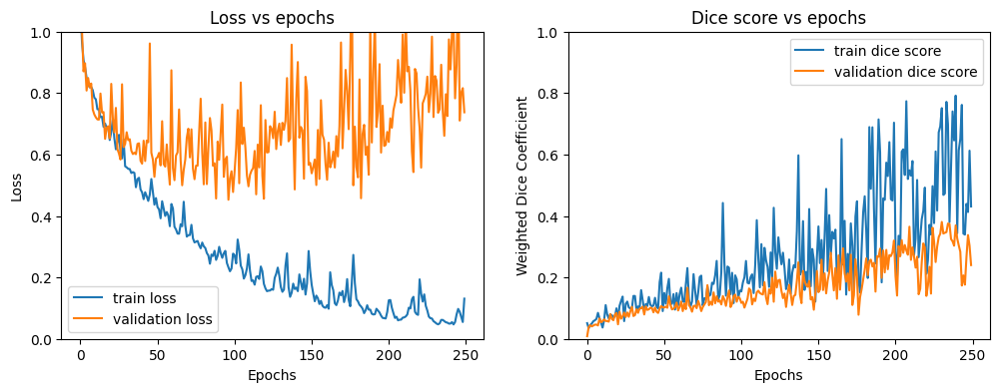

In [ ]:
# recompile model
model = UNet(out_channels=3)

# define the hyperparameters
LEARNING_RATE = 1e-4
BATCHSIZE = 32
EPOCHS = 250
NUM_WORKERS = 4

if __name__ == "__main__":

    worker_g = torch.Generator()
    worker_g.manual_seed(0)
    train_batches = DataLoader(
        train_dataset, batch_size=BATCHSIZE, shuffle=True,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )
    worker_g.manual_seed(0)
    valid_batches = DataLoader(
        valid_dataset, batch_size=BATCHSIZE, shuffle=False,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )

    # define the loss function and the optimizer
    criterion = nn.CrossEntropyLoss(weight=class_weights)
    optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

    start_time = time.time()

    # train the network
    history = run_train_loop("unetset1", model, train_batches, valid_batches, EPOCHS, criterion, optimizer)
    torch.save(
        {
            "epoch": 250,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "history": history,
        },
        f"{project_folder_path}models/unetset1_model_final.pth"
    )

    # display the total time needed to perform the training
    end_time = time.time()
    print(f"Total time taken to train the model: {(end_time - start_time):.2f}s")

    # plot the loss and accuracy history
    plot_history(history)

<i>Optional garbage collection to free up space</i>

In [ ]:
torch.cuda.empty_cache()
gc.collect()

6944

#### Set 2
loss: Weighted Cross Entropy, learning rate: 1e-5, batch size: 32, epochs: 250

100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 1/250 Train Loss: 1.1020 Validation Loss: 1.1102, Train Dice Score: 0.0275 Validation Dice Score: 0.0089


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 2/250 Train Loss: 1.0404 Validation Loss: 1.0382, Train Dice Score: 0.0437 Validation Dice Score: 0.0332


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 3/250 Train Loss: 0.9909 Validation Loss: 0.9455, Train Dice Score: 0.0497 Validation Dice Score: 0.0365


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 4/250 Train Loss: 0.9619 Validation Loss: 0.9055, Train Dice Score: 0.0581 Validation Dice Score: 0.0391


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 5/250 Train Loss: 0.9273 Validation Loss: 0.8974, Train Dice Score: 0.0549 Validation Dice Score: 0.0387


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 6/250 Train Loss: 0.9138 Validation Loss: 0.8657, Train Dice Score: 0.0657 Validation Dice Score: 0.0435


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 7/250 Train Loss: 0.8834 Validation Loss: 0.8445, Train Dice Score: 0.0642 Validation Dice Score: 0.0426


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 8/250 Train Loss: 0.8559 Validation Loss: 0.8371, Train Dice Score: 0.0843 Validation Dice Score: 0.0471


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 9/250 Train Loss: 0.8200 Validation Loss: 0.8078, Train Dice Score: 0.0604 Validation Dice Score: 0.0490


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 10/250 Train Loss: 0.8052 Validation Loss: 0.8086, Train Dice Score: 0.0474 Validation Dice Score: 0.0508


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 11/250 Train Loss: 0.8088 Validation Loss: 0.8137, Train Dice Score: 0.0561 Validation Dice Score: 0.0473


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 12/250 Train Loss: 0.7759 Validation Loss: 0.8405, Train Dice Score: 0.0534 Validation Dice Score: 0.0501


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 13/250 Train Loss: 0.7753 Validation Loss: 0.7970, Train Dice Score: 0.0676 Validation Dice Score: 0.0512


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 14/250 Train Loss: 0.7576 Validation Loss: 0.8810, Train Dice Score: 0.0403 Validation Dice Score: 0.0475


100%|██████████| 20/20 [00:07<00:00,  2.75it/s]


Epoch 15/250 Train Loss: 0.7371 Validation Loss: 0.8008, Train Dice Score: 0.0569 Validation Dice Score: 0.0596


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 16/250 Train Loss: 0.7327 Validation Loss: 0.7854, Train Dice Score: 0.0649 Validation Dice Score: 0.0599


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 17/250 Train Loss: 0.6945 Validation Loss: 0.7769, Train Dice Score: 0.0759 Validation Dice Score: 0.0581


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 18/250 Train Loss: 0.6756 Validation Loss: 0.7647, Train Dice Score: 0.0575 Validation Dice Score: 0.0613


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 19/250 Train Loss: 0.6809 Validation Loss: 0.8310, Train Dice Score: 0.0987 Validation Dice Score: 0.0608


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 20/250 Train Loss: 0.6633 Validation Loss: 0.7413, Train Dice Score: 0.1343 Validation Dice Score: 0.0665


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 21/250 Train Loss: 0.6566 Validation Loss: 0.8674, Train Dice Score: 0.0725 Validation Dice Score: 0.0626


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 22/250 Train Loss: 0.6515 Validation Loss: 0.7802, Train Dice Score: 0.1456 Validation Dice Score: 0.0703


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 23/250 Train Loss: 0.6261 Validation Loss: 0.7784, Train Dice Score: 0.0911 Validation Dice Score: 0.0710


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 24/250 Train Loss: 0.5977 Validation Loss: 0.8112, Train Dice Score: 0.0990 Validation Dice Score: 0.0756


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 25/250 Train Loss: 0.5929 Validation Loss: 0.7698, Train Dice Score: 0.0604 Validation Dice Score: 0.0749


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 26/250 Train Loss: 0.5858 Validation Loss: 0.7920, Train Dice Score: 0.1328 Validation Dice Score: 0.0717


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 27/250 Train Loss: 0.5844 Validation Loss: 0.8072, Train Dice Score: 0.2538 Validation Dice Score: 0.0708


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 28/250 Train Loss: 0.5777 Validation Loss: 0.7892, Train Dice Score: 0.0980 Validation Dice Score: 0.0844


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 29/250 Train Loss: 0.5662 Validation Loss: 0.7543, Train Dice Score: 0.1451 Validation Dice Score: 0.0839


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 30/250 Train Loss: 0.5498 Validation Loss: 0.7793, Train Dice Score: 0.0943 Validation Dice Score: 0.0760


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 31/250 Train Loss: 0.5471 Validation Loss: 0.6983, Train Dice Score: 0.1159 Validation Dice Score: 0.0740


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 32/250 Train Loss: 0.5710 Validation Loss: 0.7283, Train Dice Score: 0.0910 Validation Dice Score: 0.0807


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 33/250 Train Loss: 0.5488 Validation Loss: 0.7417, Train Dice Score: 0.1247 Validation Dice Score: 0.0842


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 34/250 Train Loss: 0.5144 Validation Loss: 0.7332, Train Dice Score: 0.1527 Validation Dice Score: 0.0833


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 35/250 Train Loss: 0.4998 Validation Loss: 0.8133, Train Dice Score: 0.1048 Validation Dice Score: 0.0910


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 36/250 Train Loss: 0.4981 Validation Loss: 0.7484, Train Dice Score: 0.1705 Validation Dice Score: 0.0817


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 37/250 Train Loss: 0.5001 Validation Loss: 0.7847, Train Dice Score: 0.1401 Validation Dice Score: 0.0892


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 38/250 Train Loss: 0.5096 Validation Loss: 0.7476, Train Dice Score: 0.0942 Validation Dice Score: 0.0834


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 39/250 Train Loss: 0.4835 Validation Loss: 0.7204, Train Dice Score: 0.1195 Validation Dice Score: 0.0953


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 40/250 Train Loss: 0.4594 Validation Loss: 0.7724, Train Dice Score: 0.1318 Validation Dice Score: 0.0868


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 41/250 Train Loss: 0.4409 Validation Loss: 0.7987, Train Dice Score: 0.1295 Validation Dice Score: 0.0907


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 42/250 Train Loss: 0.4707 Validation Loss: 0.7258, Train Dice Score: 0.2005 Validation Dice Score: 0.0900


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 43/250 Train Loss: 0.4571 Validation Loss: 0.7078, Train Dice Score: 0.3058 Validation Dice Score: 0.0927


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 44/250 Train Loss: 0.4356 Validation Loss: 0.7073, Train Dice Score: 0.1214 Validation Dice Score: 0.1115


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 45/250 Train Loss: 0.4468 Validation Loss: 0.8212, Train Dice Score: 0.1608 Validation Dice Score: 0.0694


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 46/250 Train Loss: 0.4428 Validation Loss: 0.7888, Train Dice Score: 0.1412 Validation Dice Score: 0.0945


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 47/250 Train Loss: 0.3948 Validation Loss: 0.7090, Train Dice Score: 0.2144 Validation Dice Score: 0.0958


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 48/250 Train Loss: 0.3820 Validation Loss: 0.7021, Train Dice Score: 0.1740 Validation Dice Score: 0.0987


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 49/250 Train Loss: 0.3846 Validation Loss: 0.6846, Train Dice Score: 0.1679 Validation Dice Score: 0.1096


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 50/250 Train Loss: 0.4190 Validation Loss: 0.9609, Train Dice Score: 0.1744 Validation Dice Score: 0.0724


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 51/250 Train Loss: 0.4159 Validation Loss: 0.7156, Train Dice Score: 0.1122 Validation Dice Score: 0.1129


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 52/250 Train Loss: 0.3856 Validation Loss: 0.7014, Train Dice Score: 0.1650 Validation Dice Score: 0.0914


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 53/250 Train Loss: 0.3802 Validation Loss: 0.7156, Train Dice Score: 0.1710 Validation Dice Score: 0.1022


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 54/250 Train Loss: 0.3843 Validation Loss: 0.7620, Train Dice Score: 0.5014 Validation Dice Score: 0.1051


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 55/250 Train Loss: 0.3887 Validation Loss: 0.8505, Train Dice Score: 0.1113 Validation Dice Score: 0.1110


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 56/250 Train Loss: 0.3664 Validation Loss: 0.6916, Train Dice Score: 0.0897 Validation Dice Score: 0.1134


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 57/250 Train Loss: 0.3665 Validation Loss: 0.7183, Train Dice Score: 0.1703 Validation Dice Score: 0.1130


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 58/250 Train Loss: 0.3540 Validation Loss: 0.7317, Train Dice Score: 0.1553 Validation Dice Score: 0.1113


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 59/250 Train Loss: 0.3911 Validation Loss: 0.7985, Train Dice Score: 0.1531 Validation Dice Score: 0.1051


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 60/250 Train Loss: 0.3612 Validation Loss: 0.6880, Train Dice Score: 0.1709 Validation Dice Score: 0.0882


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 61/250 Train Loss: 0.3365 Validation Loss: 0.7649, Train Dice Score: 0.2241 Validation Dice Score: 0.1135


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 62/250 Train Loss: 0.3281 Validation Loss: 0.7253, Train Dice Score: 0.1829 Validation Dice Score: 0.1121


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 63/250 Train Loss: 0.3698 Validation Loss: 0.9358, Train Dice Score: 0.1142 Validation Dice Score: 0.0709


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 64/250 Train Loss: 0.3700 Validation Loss: 0.9902, Train Dice Score: 0.1547 Validation Dice Score: 0.1235


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 65/250 Train Loss: 0.3442 Validation Loss: 0.9182, Train Dice Score: 0.2381 Validation Dice Score: 0.1054


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 66/250 Train Loss: 0.3272 Validation Loss: 0.7642, Train Dice Score: 0.1508 Validation Dice Score: 0.1056


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 67/250 Train Loss: 0.3316 Validation Loss: 0.8133, Train Dice Score: 0.1556 Validation Dice Score: 0.1187


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 68/250 Train Loss: 0.3233 Validation Loss: 0.7598, Train Dice Score: 0.2367 Validation Dice Score: 0.1091


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 69/250 Train Loss: 0.3038 Validation Loss: 0.7737, Train Dice Score: 0.2158 Validation Dice Score: 0.1399


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 70/250 Train Loss: 0.2960 Validation Loss: 0.8071, Train Dice Score: 0.2284 Validation Dice Score: 0.1572


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 71/250 Train Loss: 0.3262 Validation Loss: 0.7247, Train Dice Score: 0.2383 Validation Dice Score: 0.1101


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 72/250 Train Loss: 0.3146 Validation Loss: 0.8246, Train Dice Score: 0.2068 Validation Dice Score: 0.1131


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 73/250 Train Loss: 0.3019 Validation Loss: 0.7421, Train Dice Score: 0.5774 Validation Dice Score: 0.0913


100%|██████████| 20/20 [00:07<00:00,  2.75it/s]


Epoch 74/250 Train Loss: 0.2909 Validation Loss: 0.8105, Train Dice Score: 0.1434 Validation Dice Score: 0.0990


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 75/250 Train Loss: 0.2739 Validation Loss: 0.8675, Train Dice Score: 0.2106 Validation Dice Score: 0.1385


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 76/250 Train Loss: 0.2760 Validation Loss: 0.8167, Train Dice Score: 0.1931 Validation Dice Score: 0.1152


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 77/250 Train Loss: 0.2828 Validation Loss: 0.7821, Train Dice Score: 0.2615 Validation Dice Score: 0.1010


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 78/250 Train Loss: 0.2815 Validation Loss: 0.8243, Train Dice Score: 0.5810 Validation Dice Score: 0.1447


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 79/250 Train Loss: 0.2679 Validation Loss: 0.8761, Train Dice Score: 0.3599 Validation Dice Score: 0.1396


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 80/250 Train Loss: 0.2681 Validation Loss: 0.7075, Train Dice Score: 0.1637 Validation Dice Score: 0.1241


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 81/250 Train Loss: 0.2535 Validation Loss: 0.6940, Train Dice Score: 0.3457 Validation Dice Score: 0.1358


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 82/250 Train Loss: 0.2532 Validation Loss: 0.8179, Train Dice Score: 0.2121 Validation Dice Score: 0.1791


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 83/250 Train Loss: 0.2516 Validation Loss: 0.8659, Train Dice Score: 0.2393 Validation Dice Score: 0.0906


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 84/250 Train Loss: 0.2485 Validation Loss: 0.8106, Train Dice Score: 0.3244 Validation Dice Score: 0.1358


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 85/250 Train Loss: 0.2616 Validation Loss: 0.8569, Train Dice Score: 0.2910 Validation Dice Score: 0.1289


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 86/250 Train Loss: 0.2967 Validation Loss: 1.0694, Train Dice Score: 0.2439 Validation Dice Score: 0.1366


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 87/250 Train Loss: 0.2966 Validation Loss: 0.7504, Train Dice Score: 0.2850 Validation Dice Score: 0.1234


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 88/250 Train Loss: 0.2826 Validation Loss: 1.0226, Train Dice Score: 0.3282 Validation Dice Score: 0.1318


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 89/250 Train Loss: 0.2603 Validation Loss: 0.7714, Train Dice Score: 0.6625 Validation Dice Score: 0.1351


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 90/250 Train Loss: 0.2537 Validation Loss: 0.7830, Train Dice Score: 0.2871 Validation Dice Score: 0.1154


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 91/250 Train Loss: 0.2497 Validation Loss: 0.8264, Train Dice Score: 0.2702 Validation Dice Score: 0.1744


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 92/250 Train Loss: 0.2385 Validation Loss: 0.6892, Train Dice Score: 0.2553 Validation Dice Score: 0.1505


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 93/250 Train Loss: 0.2321 Validation Loss: 0.8329, Train Dice Score: 0.4799 Validation Dice Score: 0.1450


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 94/250 Train Loss: 0.2314 Validation Loss: 0.8142, Train Dice Score: 0.4727 Validation Dice Score: 0.1276


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 95/250 Train Loss: 0.2391 Validation Loss: 0.8644, Train Dice Score: 0.2539 Validation Dice Score: 0.1705


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 96/250 Train Loss: 0.2451 Validation Loss: 0.8052, Train Dice Score: 0.2187 Validation Dice Score: 0.1612


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 97/250 Train Loss: 0.2235 Validation Loss: 0.8617, Train Dice Score: 0.3477 Validation Dice Score: 0.1744


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 98/250 Train Loss: 0.2173 Validation Loss: 0.8682, Train Dice Score: 0.1638 Validation Dice Score: 0.1867


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 99/250 Train Loss: 0.2165 Validation Loss: 0.7794, Train Dice Score: 0.4066 Validation Dice Score: 0.1554


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 100/250 Train Loss: 0.2236 Validation Loss: 0.9718, Train Dice Score: 0.2951 Validation Dice Score: 0.1294


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 101/250 Train Loss: 0.2126 Validation Loss: 0.8068, Train Dice Score: 0.4318 Validation Dice Score: 0.1572


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 102/250 Train Loss: 0.2111 Validation Loss: 0.7963, Train Dice Score: 0.2158 Validation Dice Score: 0.1936


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 103/250 Train Loss: 0.2410 Validation Loss: 0.8885, Train Dice Score: 0.1336 Validation Dice Score: 0.0907


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 104/250 Train Loss: 0.2314 Validation Loss: 0.8548, Train Dice Score: 0.3110 Validation Dice Score: 0.1386


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 105/250 Train Loss: 0.2162 Validation Loss: 0.8839, Train Dice Score: 0.3947 Validation Dice Score: 0.1908


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 106/250 Train Loss: 0.2176 Validation Loss: 0.8347, Train Dice Score: 0.2297 Validation Dice Score: 0.1186


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 107/250 Train Loss: 0.2205 Validation Loss: 1.0384, Train Dice Score: 0.5179 Validation Dice Score: 0.1285


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 108/250 Train Loss: 0.2175 Validation Loss: 0.7610, Train Dice Score: 0.1826 Validation Dice Score: 0.1660


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 109/250 Train Loss: 0.2076 Validation Loss: 0.8373, Train Dice Score: 0.2344 Validation Dice Score: 0.1574


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 110/250 Train Loss: 0.1965 Validation Loss: 0.9522, Train Dice Score: 0.3391 Validation Dice Score: 0.2032


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 111/250 Train Loss: 0.1948 Validation Loss: 0.8363, Train Dice Score: 0.3602 Validation Dice Score: 0.1882


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 112/250 Train Loss: 0.1897 Validation Loss: 0.7808, Train Dice Score: 0.3488 Validation Dice Score: 0.2080


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 113/250 Train Loss: 0.1859 Validation Loss: 0.8766, Train Dice Score: 0.5620 Validation Dice Score: 0.2102


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 114/250 Train Loss: 0.1883 Validation Loss: 0.8433, Train Dice Score: 0.3854 Validation Dice Score: 0.1908


100%|██████████| 20/20 [00:07<00:00,  2.77it/s]


Epoch 115/250 Train Loss: 0.1947 Validation Loss: 0.9520, Train Dice Score: 0.2072 Validation Dice Score: 0.1761


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 116/250 Train Loss: 0.1951 Validation Loss: 0.8770, Train Dice Score: 0.1920 Validation Dice Score: 0.2040


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 117/250 Train Loss: 0.1887 Validation Loss: 0.9464, Train Dice Score: 0.3535 Validation Dice Score: 0.1407


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 118/250 Train Loss: 0.1881 Validation Loss: 0.8160, Train Dice Score: 0.4566 Validation Dice Score: 0.1880


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 119/250 Train Loss: 0.1891 Validation Loss: 0.9416, Train Dice Score: 0.2631 Validation Dice Score: 0.1587


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 120/250 Train Loss: 0.1849 Validation Loss: 0.9900, Train Dice Score: 0.3391 Validation Dice Score: 0.2779


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 121/250 Train Loss: 0.1769 Validation Loss: 0.8673, Train Dice Score: 0.4103 Validation Dice Score: 0.2293


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 122/250 Train Loss: 0.1715 Validation Loss: 0.9312, Train Dice Score: 0.4086 Validation Dice Score: 0.2195


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 123/250 Train Loss: 0.1677 Validation Loss: 0.8730, Train Dice Score: 0.3264 Validation Dice Score: 0.2274


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 124/250 Train Loss: 0.1714 Validation Loss: 0.9527, Train Dice Score: 0.4456 Validation Dice Score: 0.1510


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 125/250 Train Loss: 0.1728 Validation Loss: 0.8789, Train Dice Score: 0.2408 Validation Dice Score: 0.1503


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 126/250 Train Loss: 0.1812 Validation Loss: 0.8670, Train Dice Score: 0.3557 Validation Dice Score: 0.1534


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 127/250 Train Loss: 0.1967 Validation Loss: 0.7494, Train Dice Score: 0.5036 Validation Dice Score: 0.1742


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 128/250 Train Loss: 0.1874 Validation Loss: 0.7436, Train Dice Score: 0.3137 Validation Dice Score: 0.1415


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 129/250 Train Loss: 0.1836 Validation Loss: 0.9640, Train Dice Score: 0.3215 Validation Dice Score: 0.2451


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 130/250 Train Loss: 0.1896 Validation Loss: 0.8334, Train Dice Score: 0.4008 Validation Dice Score: 0.1623


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 131/250 Train Loss: 0.1811 Validation Loss: 1.0947, Train Dice Score: 0.4812 Validation Dice Score: 0.2078


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 132/250 Train Loss: 0.1714 Validation Loss: 0.9039, Train Dice Score: 0.4603 Validation Dice Score: 0.1872


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 133/250 Train Loss: 0.1688 Validation Loss: 0.9570, Train Dice Score: 0.5138 Validation Dice Score: 0.2545


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 134/250 Train Loss: 0.1696 Validation Loss: 0.8980, Train Dice Score: 0.5183 Validation Dice Score: 0.1945


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 135/250 Train Loss: 0.1650 Validation Loss: 0.8488, Train Dice Score: 0.4849 Validation Dice Score: 0.3038


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 136/250 Train Loss: 0.1601 Validation Loss: 0.8536, Train Dice Score: 0.3349 Validation Dice Score: 0.2273


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 137/250 Train Loss: 0.1643 Validation Loss: 0.9272, Train Dice Score: 0.6839 Validation Dice Score: 0.2363


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 138/250 Train Loss: 0.1579 Validation Loss: 1.0762, Train Dice Score: 0.3213 Validation Dice Score: 0.2065


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 139/250 Train Loss: 0.1629 Validation Loss: 0.9382, Train Dice Score: 0.4108 Validation Dice Score: 0.2414


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 140/250 Train Loss: 0.1523 Validation Loss: 1.0275, Train Dice Score: 0.5207 Validation Dice Score: 0.2449


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 141/250 Train Loss: 0.1471 Validation Loss: 0.8155, Train Dice Score: 0.5649 Validation Dice Score: 0.2263


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 142/250 Train Loss: 0.1484 Validation Loss: 0.8554, Train Dice Score: 0.3849 Validation Dice Score: 0.1951


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 143/250 Train Loss: 0.1493 Validation Loss: 0.9510, Train Dice Score: 0.3827 Validation Dice Score: 0.2086


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 144/250 Train Loss: 0.1512 Validation Loss: 0.8848, Train Dice Score: 0.2704 Validation Dice Score: 0.1680


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 145/250 Train Loss: 0.1483 Validation Loss: 0.9053, Train Dice Score: 0.3966 Validation Dice Score: 0.2272


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 146/250 Train Loss: 0.1411 Validation Loss: 0.9267, Train Dice Score: 0.4030 Validation Dice Score: 0.2436


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 147/250 Train Loss: 0.1382 Validation Loss: 0.9166, Train Dice Score: 0.7462 Validation Dice Score: 0.2015


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 148/250 Train Loss: 0.1371 Validation Loss: 0.9234, Train Dice Score: 0.4547 Validation Dice Score: 0.2391


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 149/250 Train Loss: 0.1340 Validation Loss: 0.8661, Train Dice Score: 0.1850 Validation Dice Score: 0.2647


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 150/250 Train Loss: 0.1341 Validation Loss: 0.9057, Train Dice Score: 0.3933 Validation Dice Score: 0.2240


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 151/250 Train Loss: 0.1375 Validation Loss: 0.9323, Train Dice Score: 0.7575 Validation Dice Score: 0.2701


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 152/250 Train Loss: 0.1349 Validation Loss: 0.9584, Train Dice Score: 0.2344 Validation Dice Score: 0.2252


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 153/250 Train Loss: 0.1389 Validation Loss: 0.9290, Train Dice Score: 0.7530 Validation Dice Score: 0.2660


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 154/250 Train Loss: 0.1295 Validation Loss: 0.9820, Train Dice Score: 0.5620 Validation Dice Score: 0.2636


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 155/250 Train Loss: 0.1308 Validation Loss: 0.8083, Train Dice Score: 0.5101 Validation Dice Score: 0.1920


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 156/250 Train Loss: 0.1346 Validation Loss: 1.0728, Train Dice Score: 0.4492 Validation Dice Score: 0.2808


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 157/250 Train Loss: 0.1349 Validation Loss: 1.0662, Train Dice Score: 0.5038 Validation Dice Score: 0.1718


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 158/250 Train Loss: 0.1311 Validation Loss: 1.0287, Train Dice Score: 0.5269 Validation Dice Score: 0.2876


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 159/250 Train Loss: 0.1264 Validation Loss: 0.9391, Train Dice Score: 0.6836 Validation Dice Score: 0.2150


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 160/250 Train Loss: 0.1349 Validation Loss: 0.9268, Train Dice Score: 0.4625 Validation Dice Score: 0.2254


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 161/250 Train Loss: 0.1373 Validation Loss: 0.9885, Train Dice Score: 0.2902 Validation Dice Score: 0.2671


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 162/250 Train Loss: 0.1286 Validation Loss: 0.9063, Train Dice Score: 0.3885 Validation Dice Score: 0.2388


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 163/250 Train Loss: 0.1278 Validation Loss: 0.9035, Train Dice Score: 0.7863 Validation Dice Score: 0.2773


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 164/250 Train Loss: 0.1243 Validation Loss: 0.8843, Train Dice Score: 0.4391 Validation Dice Score: 0.2712


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 165/250 Train Loss: 0.1223 Validation Loss: 1.0020, Train Dice Score: 0.6129 Validation Dice Score: 0.2781


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 166/250 Train Loss: 0.1227 Validation Loss: 0.9300, Train Dice Score: 0.6083 Validation Dice Score: 0.2802


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 167/250 Train Loss: 0.1219 Validation Loss: 0.9511, Train Dice Score: 0.4610 Validation Dice Score: 0.2651


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 168/250 Train Loss: 0.1298 Validation Loss: 0.9327, Train Dice Score: 0.4432 Validation Dice Score: 0.2885


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 169/250 Train Loss: 0.1249 Validation Loss: 0.9432, Train Dice Score: 0.5299 Validation Dice Score: 0.2362


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 170/250 Train Loss: 0.1188 Validation Loss: 0.9637, Train Dice Score: 0.5966 Validation Dice Score: 0.2225


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 171/250 Train Loss: 0.1203 Validation Loss: 0.9033, Train Dice Score: 0.4576 Validation Dice Score: 0.2023


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 172/250 Train Loss: 0.1186 Validation Loss: 1.0589, Train Dice Score: 0.3039 Validation Dice Score: 0.2311


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 173/250 Train Loss: 0.1239 Validation Loss: 1.0656, Train Dice Score: 0.5052 Validation Dice Score: 0.2602


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 174/250 Train Loss: 0.1211 Validation Loss: 0.9457, Train Dice Score: 0.5647 Validation Dice Score: 0.3004


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 175/250 Train Loss: 0.1189 Validation Loss: 0.9116, Train Dice Score: 0.5707 Validation Dice Score: 0.3005


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 176/250 Train Loss: 0.1155 Validation Loss: 0.9830, Train Dice Score: 0.5147 Validation Dice Score: 0.2408


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 177/250 Train Loss: 0.1193 Validation Loss: 0.7340, Train Dice Score: 0.5788 Validation Dice Score: 0.2319


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 178/250 Train Loss: 0.1263 Validation Loss: 0.9232, Train Dice Score: 0.3967 Validation Dice Score: 0.2712


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 179/250 Train Loss: 0.1143 Validation Loss: 1.0599, Train Dice Score: 0.5339 Validation Dice Score: 0.2045


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 180/250 Train Loss: 0.1130 Validation Loss: 1.0063, Train Dice Score: 0.6307 Validation Dice Score: 0.2061


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 181/250 Train Loss: 0.1125 Validation Loss: 0.8530, Train Dice Score: 0.7388 Validation Dice Score: 0.2502


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 182/250 Train Loss: 0.1166 Validation Loss: 1.0260, Train Dice Score: 0.4712 Validation Dice Score: 0.2345


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 183/250 Train Loss: 0.1106 Validation Loss: 0.9627, Train Dice Score: 0.3646 Validation Dice Score: 0.2454


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 184/250 Train Loss: 0.1077 Validation Loss: 0.9536, Train Dice Score: 0.4883 Validation Dice Score: 0.2873


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 185/250 Train Loss: 0.1164 Validation Loss: 1.1648, Train Dice Score: 0.3860 Validation Dice Score: 0.1978


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 186/250 Train Loss: 0.1161 Validation Loss: 0.9782, Train Dice Score: 0.5259 Validation Dice Score: 0.2691


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 187/250 Train Loss: 0.1103 Validation Loss: 0.8744, Train Dice Score: 0.5334 Validation Dice Score: 0.2871


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 188/250 Train Loss: 0.1111 Validation Loss: 1.0306, Train Dice Score: 0.5529 Validation Dice Score: 0.1948


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 189/250 Train Loss: 0.1286 Validation Loss: 0.9381, Train Dice Score: 0.4855 Validation Dice Score: 0.2451


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 190/250 Train Loss: 0.1250 Validation Loss: 1.3911, Train Dice Score: 0.5382 Validation Dice Score: 0.1871


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 191/250 Train Loss: 0.1243 Validation Loss: 0.9953, Train Dice Score: 0.3847 Validation Dice Score: 0.2377


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 192/250 Train Loss: 0.1151 Validation Loss: 0.9103, Train Dice Score: 0.5024 Validation Dice Score: 0.2624


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 193/250 Train Loss: 0.1144 Validation Loss: 0.9000, Train Dice Score: 0.6518 Validation Dice Score: 0.3019


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 194/250 Train Loss: 0.1095 Validation Loss: 1.0327, Train Dice Score: 0.6161 Validation Dice Score: 0.3042


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 195/250 Train Loss: 0.1310 Validation Loss: 1.2434, Train Dice Score: 0.3974 Validation Dice Score: 0.2287


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 196/250 Train Loss: 0.1610 Validation Loss: 1.0617, Train Dice Score: 0.6546 Validation Dice Score: 0.1559


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 197/250 Train Loss: 0.1894 Validation Loss: 0.9638, Train Dice Score: 0.3356 Validation Dice Score: 0.2294


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 198/250 Train Loss: 0.2150 Validation Loss: 1.0708, Train Dice Score: 0.3803 Validation Dice Score: 0.1158


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 199/250 Train Loss: 0.1693 Validation Loss: 0.8311, Train Dice Score: 0.5979 Validation Dice Score: 0.2385


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 200/250 Train Loss: 0.1319 Validation Loss: 0.8516, Train Dice Score: 0.1917 Validation Dice Score: 0.2849


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 201/250 Train Loss: 0.1219 Validation Loss: 0.9370, Train Dice Score: 0.4763 Validation Dice Score: 0.2574


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 202/250 Train Loss: 0.1139 Validation Loss: 0.9636, Train Dice Score: 0.3906 Validation Dice Score: 0.1808


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 203/250 Train Loss: 0.1061 Validation Loss: 0.8772, Train Dice Score: 0.6555 Validation Dice Score: 0.2596


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 204/250 Train Loss: 0.1038 Validation Loss: 0.9849, Train Dice Score: 0.5862 Validation Dice Score: 0.3456


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 205/250 Train Loss: 0.0994 Validation Loss: 0.8859, Train Dice Score: 0.6209 Validation Dice Score: 0.3418


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 206/250 Train Loss: 0.0967 Validation Loss: 0.9598, Train Dice Score: 0.6260 Validation Dice Score: 0.2983


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 207/250 Train Loss: 0.1007 Validation Loss: 1.0247, Train Dice Score: 0.6849 Validation Dice Score: 0.3192


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 208/250 Train Loss: 0.0947 Validation Loss: 0.9738, Train Dice Score: 0.6436 Validation Dice Score: 0.3140


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 209/250 Train Loss: 0.0932 Validation Loss: 0.9835, Train Dice Score: 0.5554 Validation Dice Score: 0.3573


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 210/250 Train Loss: 0.0922 Validation Loss: 0.9867, Train Dice Score: 0.6479 Validation Dice Score: 0.3240


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 211/250 Train Loss: 0.0916 Validation Loss: 0.9742, Train Dice Score: 0.6425 Validation Dice Score: 0.3361


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 212/250 Train Loss: 0.0903 Validation Loss: 0.9219, Train Dice Score: 0.6893 Validation Dice Score: 0.3168


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 213/250 Train Loss: 0.0924 Validation Loss: 0.9232, Train Dice Score: 0.7457 Validation Dice Score: 0.3475


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 214/250 Train Loss: 0.0899 Validation Loss: 0.9434, Train Dice Score: 0.6802 Validation Dice Score: 0.3380


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 215/250 Train Loss: 0.0906 Validation Loss: 1.0139, Train Dice Score: 0.5614 Validation Dice Score: 0.2748


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 216/250 Train Loss: 0.0917 Validation Loss: 0.8974, Train Dice Score: 0.4717 Validation Dice Score: 0.2560


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 217/250 Train Loss: 0.0888 Validation Loss: 0.9911, Train Dice Score: 0.5487 Validation Dice Score: 0.3432


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 218/250 Train Loss: 0.0865 Validation Loss: 0.9642, Train Dice Score: 0.7848 Validation Dice Score: 0.2761


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 219/250 Train Loss: 0.0848 Validation Loss: 1.0326, Train Dice Score: 0.7717 Validation Dice Score: 0.3668


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 220/250 Train Loss: 0.0856 Validation Loss: 0.9421, Train Dice Score: 0.8292 Validation Dice Score: 0.3583


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 221/250 Train Loss: 0.0834 Validation Loss: 1.0146, Train Dice Score: 0.8150 Validation Dice Score: 0.2908


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 222/250 Train Loss: 0.0858 Validation Loss: 0.9955, Train Dice Score: 0.6712 Validation Dice Score: 0.3612


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 223/250 Train Loss: 0.0842 Validation Loss: 0.9524, Train Dice Score: 0.6258 Validation Dice Score: 0.3222


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 224/250 Train Loss: 0.0820 Validation Loss: 1.0020, Train Dice Score: 0.6985 Validation Dice Score: 0.3303


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 225/250 Train Loss: 0.0816 Validation Loss: 0.9533, Train Dice Score: 0.6461 Validation Dice Score: 0.3208


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 226/250 Train Loss: 0.0829 Validation Loss: 1.0024, Train Dice Score: 0.7385 Validation Dice Score: 0.3315


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 227/250 Train Loss: 0.0811 Validation Loss: 1.0465, Train Dice Score: 0.8091 Validation Dice Score: 0.3128


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 228/250 Train Loss: 0.0816 Validation Loss: 1.0594, Train Dice Score: 0.7800 Validation Dice Score: 0.3182


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 229/250 Train Loss: 0.0811 Validation Loss: 0.8863, Train Dice Score: 0.6361 Validation Dice Score: 0.3435


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 230/250 Train Loss: 0.0793 Validation Loss: 1.0030, Train Dice Score: 0.4114 Validation Dice Score: 0.3207


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 231/250 Train Loss: 0.0846 Validation Loss: 1.0583, Train Dice Score: 0.8528 Validation Dice Score: 0.3054


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 232/250 Train Loss: 0.0785 Validation Loss: 1.1006, Train Dice Score: 0.7516 Validation Dice Score: 0.3366


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 233/250 Train Loss: 0.0805 Validation Loss: 1.0088, Train Dice Score: 0.7182 Validation Dice Score: 0.2728


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 234/250 Train Loss: 0.0759 Validation Loss: 1.0439, Train Dice Score: 0.6687 Validation Dice Score: 0.3494


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 235/250 Train Loss: 0.0749 Validation Loss: 1.0422, Train Dice Score: 0.8201 Validation Dice Score: 0.3490


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 236/250 Train Loss: 0.0771 Validation Loss: 1.0377, Train Dice Score: 0.6732 Validation Dice Score: 0.2954


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 237/250 Train Loss: 0.0786 Validation Loss: 1.0323, Train Dice Score: 0.7379 Validation Dice Score: 0.3607


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 238/250 Train Loss: 0.0759 Validation Loss: 0.9796, Train Dice Score: 0.7733 Validation Dice Score: 0.3598


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 239/250 Train Loss: 0.0762 Validation Loss: 0.9684, Train Dice Score: 0.7479 Validation Dice Score: 0.3371


100%|██████████| 20/20 [00:07<00:00,  2.76it/s]


Epoch 240/250 Train Loss: 0.0764 Validation Loss: 1.0587, Train Dice Score: 0.6819 Validation Dice Score: 0.3825


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 241/250 Train Loss: 0.0709 Validation Loss: 0.9965, Train Dice Score: 0.7579 Validation Dice Score: 0.3838


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 242/250 Train Loss: 0.0720 Validation Loss: 1.0948, Train Dice Score: 0.7427 Validation Dice Score: 0.3918


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 243/250 Train Loss: 0.0746 Validation Loss: 1.0146, Train Dice Score: 0.6460 Validation Dice Score: 0.3593


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 244/250 Train Loss: 0.0723 Validation Loss: 1.0443, Train Dice Score: 0.6812 Validation Dice Score: 0.3572


100%|██████████| 20/20 [00:07<00:00,  2.77it/s]


Epoch 245/250 Train Loss: 0.0720 Validation Loss: 1.0364, Train Dice Score: 0.8397 Validation Dice Score: 0.3615


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 246/250 Train Loss: 0.0707 Validation Loss: 1.0501, Train Dice Score: 0.7669 Validation Dice Score: 0.3495


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 247/250 Train Loss: 0.0713 Validation Loss: 0.9925, Train Dice Score: 0.8734 Validation Dice Score: 0.3402


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 248/250 Train Loss: 0.0739 Validation Loss: 1.1160, Train Dice Score: 0.6524 Validation Dice Score: 0.2856


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 249/250 Train Loss: 0.0715 Validation Loss: 1.0724, Train Dice Score: 0.7821 Validation Dice Score: 0.3665


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 250/250 Train Loss: 0.0713 Validation Loss: 1.0499, Train Dice Score: 0.7850 Validation Dice Score: 0.3611
Total time taken to train the model: 2563.48s


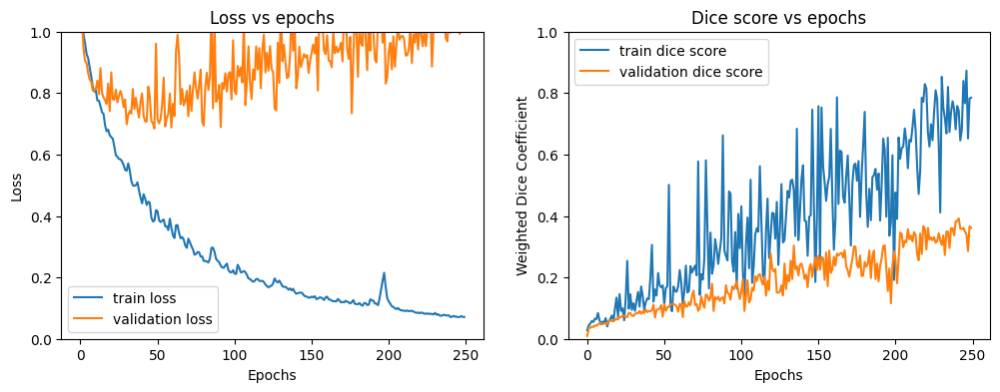

In [ ]:
# recompile model
model = UNet(out_channels=3)

# define the hyperparameters
LEARNING_RATE = 1e-5
BATCHSIZE = 32
EPOCHS = 250
NUM_WORKERS = 4

if __name__ == "__main__":

    worker_g = torch.Generator()
    worker_g.manual_seed(0)
    train_batches = DataLoader(
        train_dataset, batch_size=BATCHSIZE, shuffle=True,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )
    worker_g.manual_seed(0)
    valid_batches = DataLoader(
        valid_dataset, batch_size=BATCHSIZE, shuffle=False,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )

    # define the loss function and the optimizer
    criterion = nn.CrossEntropyLoss(weight=class_weights)
    optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

    start_time = time.time()

    # train the network
    history = run_train_loop("unetset2", model, train_batches, valid_batches, EPOCHS, criterion, optimizer)
    torch.save(
        {
            "epoch": 250,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "history": history,
        },
        f"{project_folder_path}models/unetset2_model_final.pth"
    )

    # display the total time needed to perform the training
    end_time = time.time()
    print(f"Total time taken to train the model: {(end_time - start_time):.2f}s")

    # plot the loss and accuracy history
    plot_history(history)

<i>Optional garbage collection to free up space</i>

In [ ]:
torch.cuda.empty_cache()
gc.collect()

6864

#### Set 3
loss: Dice Loss, learning rate: 1e-4, batch size: 32, epochs: 250

100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 1/250 Train Loss: 0.7736 Validation Loss: 0.7778, Train Dice Score: 0.0404 Validation Dice Score: 0.0057


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 2/250 Train Loss: 0.7114 Validation Loss: 0.7121, Train Dice Score: 0.0763 Validation Dice Score: 0.0361


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 3/250 Train Loss: 0.6858 Validation Loss: 0.6816, Train Dice Score: 0.0644 Validation Dice Score: 0.0467


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 4/250 Train Loss: 0.6711 Validation Loss: 0.6732, Train Dice Score: 0.0631 Validation Dice Score: 0.0458


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 5/250 Train Loss: 0.6554 Validation Loss: 0.6533, Train Dice Score: 0.0672 Validation Dice Score: 0.0583


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 6/250 Train Loss: 0.6469 Validation Loss: 0.6558, Train Dice Score: 0.0785 Validation Dice Score: 0.0630


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 7/250 Train Loss: 0.6360 Validation Loss: 0.6455, Train Dice Score: 0.0782 Validation Dice Score: 0.0547


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 8/250 Train Loss: 0.6263 Validation Loss: 0.6253, Train Dice Score: 0.0846 Validation Dice Score: 0.0738


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 9/250 Train Loss: 0.6170 Validation Loss: 0.6506, Train Dice Score: 0.0784 Validation Dice Score: 0.0516


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 10/250 Train Loss: 0.6067 Validation Loss: 0.6158, Train Dice Score: 0.0815 Validation Dice Score: 0.0841


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 11/250 Train Loss: 0.5979 Validation Loss: 0.6114, Train Dice Score: 0.0761 Validation Dice Score: 0.1033


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 12/250 Train Loss: 0.5869 Validation Loss: 0.5969, Train Dice Score: 0.1174 Validation Dice Score: 0.1053


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 13/250 Train Loss: 0.5802 Validation Loss: 0.5868, Train Dice Score: 0.0943 Validation Dice Score: 0.1193


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 14/250 Train Loss: 0.5676 Validation Loss: 0.5909, Train Dice Score: 0.1071 Validation Dice Score: 0.0860


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 15/250 Train Loss: 0.5619 Validation Loss: 0.5736, Train Dice Score: 0.1232 Validation Dice Score: 0.0746


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 16/250 Train Loss: 0.5532 Validation Loss: 0.5634, Train Dice Score: 0.1730 Validation Dice Score: 0.1222


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 17/250 Train Loss: 0.5440 Validation Loss: 0.5438, Train Dice Score: 0.1413 Validation Dice Score: 0.1321


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 18/250 Train Loss: 0.5342 Validation Loss: 0.5397, Train Dice Score: 0.1458 Validation Dice Score: 0.1357


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 19/250 Train Loss: 0.5266 Validation Loss: 0.5488, Train Dice Score: 0.1246 Validation Dice Score: 0.0966


100%|██████████| 20/20 [00:07<00:00,  2.76it/s]


Epoch 20/250 Train Loss: 0.5201 Validation Loss: 0.5278, Train Dice Score: 0.2273 Validation Dice Score: 0.1004


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 21/250 Train Loss: 0.5155 Validation Loss: 0.5691, Train Dice Score: 0.1575 Validation Dice Score: 0.1226


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 22/250 Train Loss: 0.5045 Validation Loss: 0.5154, Train Dice Score: 0.2155 Validation Dice Score: 0.1559


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 23/250 Train Loss: 0.4988 Validation Loss: 0.5016, Train Dice Score: 0.1794 Validation Dice Score: 0.1853


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 24/250 Train Loss: 0.4893 Validation Loss: 0.5116, Train Dice Score: 0.2677 Validation Dice Score: 0.1686


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 25/250 Train Loss: 0.4858 Validation Loss: 0.5004, Train Dice Score: 0.1339 Validation Dice Score: 0.1391


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 26/250 Train Loss: 0.4756 Validation Loss: 0.4843, Train Dice Score: 0.1522 Validation Dice Score: 0.1632


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 27/250 Train Loss: 0.4674 Validation Loss: 0.4987, Train Dice Score: 0.2308 Validation Dice Score: 0.1732


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 28/250 Train Loss: 0.4685 Validation Loss: 0.4890, Train Dice Score: 0.2945 Validation Dice Score: 0.1310


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 29/250 Train Loss: 0.4582 Validation Loss: 0.4751, Train Dice Score: 0.4455 Validation Dice Score: 0.2086


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 30/250 Train Loss: 0.4521 Validation Loss: 0.4615, Train Dice Score: 0.1765 Validation Dice Score: 0.1698


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 31/250 Train Loss: 0.4417 Validation Loss: 0.4510, Train Dice Score: 0.2164 Validation Dice Score: 0.3578


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 32/250 Train Loss: 0.4368 Validation Loss: 0.4469, Train Dice Score: 0.1629 Validation Dice Score: 0.1967


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 33/250 Train Loss: 0.4320 Validation Loss: 0.4367, Train Dice Score: 0.3442 Validation Dice Score: 0.2050


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 34/250 Train Loss: 0.4285 Validation Loss: 0.4564, Train Dice Score: 0.2803 Validation Dice Score: 0.2197


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 35/250 Train Loss: 0.4135 Validation Loss: 0.4728, Train Dice Score: 0.2530 Validation Dice Score: 0.2088


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 36/250 Train Loss: 0.4110 Validation Loss: 0.4181, Train Dice Score: 0.5096 Validation Dice Score: 0.3341


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 37/250 Train Loss: 0.4024 Validation Loss: 0.4112, Train Dice Score: 0.2986 Validation Dice Score: 0.2883


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 38/250 Train Loss: 0.3979 Validation Loss: 0.4239, Train Dice Score: 0.3197 Validation Dice Score: 0.3164


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 39/250 Train Loss: 0.4045 Validation Loss: 0.4203, Train Dice Score: 0.3533 Validation Dice Score: 0.3007


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 40/250 Train Loss: 0.3990 Validation Loss: 0.3891, Train Dice Score: 0.2153 Validation Dice Score: 0.2549


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 41/250 Train Loss: 0.3804 Validation Loss: 0.4074, Train Dice Score: 0.3138 Validation Dice Score: 0.3619


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 42/250 Train Loss: 0.3688 Validation Loss: 0.4138, Train Dice Score: 0.4311 Validation Dice Score: 0.2618


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 43/250 Train Loss: 0.3775 Validation Loss: 0.3694, Train Dice Score: 0.4874 Validation Dice Score: 0.4489


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 44/250 Train Loss: 0.3705 Validation Loss: 0.4054, Train Dice Score: 0.4958 Validation Dice Score: 0.3411


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 45/250 Train Loss: 0.3656 Validation Loss: 0.3582, Train Dice Score: 0.5154 Validation Dice Score: 0.4074


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 46/250 Train Loss: 0.3571 Validation Loss: 0.3638, Train Dice Score: 0.4783 Validation Dice Score: 0.4778


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 47/250 Train Loss: 0.3544 Validation Loss: 0.3858, Train Dice Score: 0.3119 Validation Dice Score: 0.3581


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 48/250 Train Loss: 0.3634 Validation Loss: 0.3833, Train Dice Score: 0.4569 Validation Dice Score: 0.4426


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 49/250 Train Loss: 0.3378 Validation Loss: 0.3254, Train Dice Score: 0.4982 Validation Dice Score: 0.4224


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 50/250 Train Loss: 0.3279 Validation Loss: 0.3618, Train Dice Score: 0.2629 Validation Dice Score: 0.4862


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 51/250 Train Loss: 0.3205 Validation Loss: 0.3348, Train Dice Score: 0.2814 Validation Dice Score: 0.5561


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 52/250 Train Loss: 0.3140 Validation Loss: 0.3321, Train Dice Score: 0.6376 Validation Dice Score: 0.4690


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 53/250 Train Loss: 0.3280 Validation Loss: 0.3661, Train Dice Score: 0.3897 Validation Dice Score: 0.2926


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 54/250 Train Loss: 0.3241 Validation Loss: 0.3276, Train Dice Score: 0.2792 Validation Dice Score: 0.4676


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 55/250 Train Loss: 0.2975 Validation Loss: 0.3655, Train Dice Score: 0.5074 Validation Dice Score: 0.3538


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 56/250 Train Loss: 0.2936 Validation Loss: 0.3066, Train Dice Score: 0.5719 Validation Dice Score: 0.5206


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 57/250 Train Loss: 0.2805 Validation Loss: 0.3080, Train Dice Score: 0.4324 Validation Dice Score: 0.4286


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 58/250 Train Loss: 0.2969 Validation Loss: 0.3229, Train Dice Score: 0.5163 Validation Dice Score: 0.5139


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 59/250 Train Loss: 0.2818 Validation Loss: 0.2810, Train Dice Score: 0.6688 Validation Dice Score: 0.5023


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 60/250 Train Loss: 0.2876 Validation Loss: 0.3395, Train Dice Score: 0.4064 Validation Dice Score: 0.5291


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 61/250 Train Loss: 0.2726 Validation Loss: 0.3092, Train Dice Score: 0.2871 Validation Dice Score: 0.5355


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 62/250 Train Loss: 0.2802 Validation Loss: 0.4025, Train Dice Score: 0.2825 Validation Dice Score: 0.3980


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 63/250 Train Loss: 0.2834 Validation Loss: 0.3289, Train Dice Score: 0.3044 Validation Dice Score: 0.4313


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 64/250 Train Loss: 0.2826 Validation Loss: 0.3192, Train Dice Score: 0.3815 Validation Dice Score: 0.5436


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 65/250 Train Loss: 0.2774 Validation Loss: 0.3138, Train Dice Score: 0.3356 Validation Dice Score: 0.3521


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 66/250 Train Loss: 0.2789 Validation Loss: 0.3175, Train Dice Score: 0.2663 Validation Dice Score: 0.5132


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 67/250 Train Loss: 0.2638 Validation Loss: 0.3104, Train Dice Score: 0.3718 Validation Dice Score: 0.4965


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 68/250 Train Loss: 0.2545 Validation Loss: 0.2819, Train Dice Score: 0.5938 Validation Dice Score: 0.6038


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 69/250 Train Loss: 0.2470 Validation Loss: 0.2715, Train Dice Score: 0.6572 Validation Dice Score: 0.5972


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 70/250 Train Loss: 0.2289 Validation Loss: 0.2572, Train Dice Score: 0.5003 Validation Dice Score: 0.5687


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 71/250 Train Loss: 0.2171 Validation Loss: 0.2983, Train Dice Score: 0.5455 Validation Dice Score: 0.5849


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 72/250 Train Loss: 0.2287 Validation Loss: 0.2728, Train Dice Score: 0.5607 Validation Dice Score: 0.5453


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 73/250 Train Loss: 0.2209 Validation Loss: 0.3096, Train Dice Score: 0.6468 Validation Dice Score: 0.5059


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 74/250 Train Loss: 0.2226 Validation Loss: 0.2476, Train Dice Score: 0.7122 Validation Dice Score: 0.5612


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 75/250 Train Loss: 0.2113 Validation Loss: 0.2261, Train Dice Score: 0.6904 Validation Dice Score: 0.5964


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 76/250 Train Loss: 0.2148 Validation Loss: 0.4108, Train Dice Score: 0.7673 Validation Dice Score: 0.2237


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 77/250 Train Loss: 0.2254 Validation Loss: 0.3095, Train Dice Score: 0.3545 Validation Dice Score: 0.5579


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 78/250 Train Loss: 0.2444 Validation Loss: 0.3332, Train Dice Score: 0.4285 Validation Dice Score: 0.5906


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 79/250 Train Loss: 0.2059 Validation Loss: 0.2912, Train Dice Score: 0.5844 Validation Dice Score: 0.5544


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 80/250 Train Loss: 0.2163 Validation Loss: 0.3369, Train Dice Score: 0.5446 Validation Dice Score: 0.5188


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 81/250 Train Loss: 0.2199 Validation Loss: 0.2416, Train Dice Score: 0.6458 Validation Dice Score: 0.5199


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 82/250 Train Loss: 0.1979 Validation Loss: 0.2874, Train Dice Score: 0.5418 Validation Dice Score: 0.5118


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 83/250 Train Loss: 0.2013 Validation Loss: 0.2584, Train Dice Score: 0.4201 Validation Dice Score: 0.5098


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 84/250 Train Loss: 0.1937 Validation Loss: 0.2637, Train Dice Score: 0.8087 Validation Dice Score: 0.5454


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 85/250 Train Loss: 0.1926 Validation Loss: 0.2220, Train Dice Score: 0.7847 Validation Dice Score: 0.5271


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 86/250 Train Loss: 0.1943 Validation Loss: 0.2731, Train Dice Score: 0.7217 Validation Dice Score: 0.4965


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 87/250 Train Loss: 0.2118 Validation Loss: 0.3075, Train Dice Score: 0.7435 Validation Dice Score: 0.4929


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 88/250 Train Loss: 0.2329 Validation Loss: 0.2798, Train Dice Score: 0.5328 Validation Dice Score: 0.4925


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 89/250 Train Loss: 0.2279 Validation Loss: 0.3022, Train Dice Score: 0.5119 Validation Dice Score: 0.6587


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 90/250 Train Loss: 0.2146 Validation Loss: 0.2710, Train Dice Score: 0.6836 Validation Dice Score: 0.5730


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 91/250 Train Loss: 0.1999 Validation Loss: 0.2587, Train Dice Score: 0.7050 Validation Dice Score: 0.5880


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 92/250 Train Loss: 0.1807 Validation Loss: 0.2126, Train Dice Score: 0.8002 Validation Dice Score: 0.5773


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 93/250 Train Loss: 0.2084 Validation Loss: 0.2757, Train Dice Score: 0.8264 Validation Dice Score: 0.4850


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 94/250 Train Loss: 0.1809 Validation Loss: 0.2180, Train Dice Score: 0.7336 Validation Dice Score: 0.5536


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 95/250 Train Loss: 0.1864 Validation Loss: 0.3088, Train Dice Score: 0.7102 Validation Dice Score: 0.4217


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 96/250 Train Loss: 0.1788 Validation Loss: 0.3430, Train Dice Score: 0.7722 Validation Dice Score: 0.4896


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 97/250 Train Loss: 0.1783 Validation Loss: 0.2229, Train Dice Score: 0.6953 Validation Dice Score: 0.5815


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 98/250 Train Loss: 0.1858 Validation Loss: 0.2271, Train Dice Score: 0.7308 Validation Dice Score: 0.4686


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 99/250 Train Loss: 0.1680 Validation Loss: 0.2581, Train Dice Score: 0.3580 Validation Dice Score: 0.5802


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 100/250 Train Loss: 0.1801 Validation Loss: 0.2420, Train Dice Score: 0.6547 Validation Dice Score: 0.5033


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 101/250 Train Loss: 0.1949 Validation Loss: 0.2562, Train Dice Score: 0.6386 Validation Dice Score: 0.5561


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 102/250 Train Loss: 0.2046 Validation Loss: 0.2320, Train Dice Score: 0.3352 Validation Dice Score: 0.6081


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 103/250 Train Loss: 0.1876 Validation Loss: 0.2257, Train Dice Score: 0.6018 Validation Dice Score: 0.5342


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 104/250 Train Loss: 0.1805 Validation Loss: 0.2142, Train Dice Score: 0.7455 Validation Dice Score: 0.5300


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 105/250 Train Loss: 0.1676 Validation Loss: 0.2368, Train Dice Score: 0.5573 Validation Dice Score: 0.4975


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 106/250 Train Loss: 0.1680 Validation Loss: 0.2312, Train Dice Score: 0.8056 Validation Dice Score: 0.5187


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 107/250 Train Loss: 0.1744 Validation Loss: 0.2630, Train Dice Score: 0.7028 Validation Dice Score: 0.4086


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 108/250 Train Loss: 0.1967 Validation Loss: 0.2467, Train Dice Score: 0.5646 Validation Dice Score: 0.3807


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 109/250 Train Loss: 0.1720 Validation Loss: 0.2300, Train Dice Score: 0.7156 Validation Dice Score: 0.5163


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 110/250 Train Loss: 0.1619 Validation Loss: 0.2231, Train Dice Score: 0.6078 Validation Dice Score: 0.4891


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 111/250 Train Loss: 0.1560 Validation Loss: 0.2446, Train Dice Score: 0.6532 Validation Dice Score: 0.4820


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 112/250 Train Loss: 0.1641 Validation Loss: 0.2392, Train Dice Score: 0.3996 Validation Dice Score: 0.4632


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 113/250 Train Loss: 0.1800 Validation Loss: 0.2418, Train Dice Score: 0.4497 Validation Dice Score: 0.4520


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 114/250 Train Loss: 0.1770 Validation Loss: 0.2099, Train Dice Score: 0.8001 Validation Dice Score: 0.5316


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 115/250 Train Loss: 0.1568 Validation Loss: 0.2198, Train Dice Score: 0.7436 Validation Dice Score: 0.4980


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 116/250 Train Loss: 0.1795 Validation Loss: 0.2701, Train Dice Score: 0.7119 Validation Dice Score: 0.5648


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 117/250 Train Loss: 0.1714 Validation Loss: 0.2606, Train Dice Score: 0.7252 Validation Dice Score: 0.5161


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 118/250 Train Loss: 0.1662 Validation Loss: 0.2199, Train Dice Score: 0.8195 Validation Dice Score: 0.5474


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 119/250 Train Loss: 0.1667 Validation Loss: 0.2226, Train Dice Score: 0.6928 Validation Dice Score: 0.5480


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 120/250 Train Loss: 0.1576 Validation Loss: 0.2453, Train Dice Score: 0.7002 Validation Dice Score: 0.4907


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 121/250 Train Loss: 0.1466 Validation Loss: 0.2766, Train Dice Score: 0.7472 Validation Dice Score: 0.5073


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 122/250 Train Loss: 0.1462 Validation Loss: 0.2062, Train Dice Score: 0.8908 Validation Dice Score: 0.5544


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 123/250 Train Loss: 0.1554 Validation Loss: 0.2294, Train Dice Score: 0.3631 Validation Dice Score: 0.5765


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 124/250 Train Loss: 0.1633 Validation Loss: 0.1916, Train Dice Score: 0.6917 Validation Dice Score: 0.5370


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 125/250 Train Loss: 0.1497 Validation Loss: 0.3070, Train Dice Score: 0.6483 Validation Dice Score: 0.4699


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 126/250 Train Loss: 0.1693 Validation Loss: 0.2785, Train Dice Score: 0.8546 Validation Dice Score: 0.4672


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 127/250 Train Loss: 0.1470 Validation Loss: 0.2746, Train Dice Score: 0.7548 Validation Dice Score: 0.5008


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 128/250 Train Loss: 0.1412 Validation Loss: 0.2383, Train Dice Score: 0.7691 Validation Dice Score: 0.5031


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 129/250 Train Loss: 0.1505 Validation Loss: 0.2442, Train Dice Score: 0.7643 Validation Dice Score: 0.5364


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 130/250 Train Loss: 0.1504 Validation Loss: 0.2319, Train Dice Score: 0.8280 Validation Dice Score: 0.5548


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 131/250 Train Loss: 0.1435 Validation Loss: 0.2835, Train Dice Score: 0.4624 Validation Dice Score: 0.5150


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 132/250 Train Loss: 0.1449 Validation Loss: 0.2444, Train Dice Score: 0.8424 Validation Dice Score: 0.6011


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 133/250 Train Loss: 0.1352 Validation Loss: 0.2196, Train Dice Score: 0.8506 Validation Dice Score: 0.5701


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 134/250 Train Loss: 0.1272 Validation Loss: 0.2577, Train Dice Score: 0.7122 Validation Dice Score: 0.6037


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 135/250 Train Loss: 0.1194 Validation Loss: 0.2578, Train Dice Score: 0.3677 Validation Dice Score: 0.5757


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 136/250 Train Loss: 0.1290 Validation Loss: 0.2618, Train Dice Score: 0.7581 Validation Dice Score: 0.5346


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 137/250 Train Loss: 0.1329 Validation Loss: 0.2128, Train Dice Score: 0.5739 Validation Dice Score: 0.5436


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 138/250 Train Loss: 0.1465 Validation Loss: 0.2350, Train Dice Score: 0.7625 Validation Dice Score: 0.5028


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 139/250 Train Loss: 0.1255 Validation Loss: 0.2791, Train Dice Score: 0.8441 Validation Dice Score: 0.4059


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 140/250 Train Loss: 0.1441 Validation Loss: 0.2169, Train Dice Score: 0.6757 Validation Dice Score: 0.5951


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 141/250 Train Loss: 0.1444 Validation Loss: 0.2588, Train Dice Score: 0.5942 Validation Dice Score: 0.5422


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 142/250 Train Loss: 0.1529 Validation Loss: 0.2729, Train Dice Score: 0.3770 Validation Dice Score: 0.4631


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 143/250 Train Loss: 0.1232 Validation Loss: 0.2136, Train Dice Score: 0.8438 Validation Dice Score: 0.4858


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 144/250 Train Loss: 0.1360 Validation Loss: 0.2337, Train Dice Score: 0.7052 Validation Dice Score: 0.4878


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 145/250 Train Loss: 0.1413 Validation Loss: 0.2199, Train Dice Score: 0.7599 Validation Dice Score: 0.5637


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 146/250 Train Loss: 0.1265 Validation Loss: 0.2106, Train Dice Score: 0.8286 Validation Dice Score: 0.6468


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 147/250 Train Loss: 0.1256 Validation Loss: 0.2885, Train Dice Score: 0.7946 Validation Dice Score: 0.6150


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 148/250 Train Loss: 0.1306 Validation Loss: 0.2752, Train Dice Score: 0.8847 Validation Dice Score: 0.5581


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 149/250 Train Loss: 0.1245 Validation Loss: 0.2126, Train Dice Score: 0.8949 Validation Dice Score: 0.6352


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 150/250 Train Loss: 0.1116 Validation Loss: 0.2350, Train Dice Score: 0.7961 Validation Dice Score: 0.5534


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 151/250 Train Loss: 0.1193 Validation Loss: 0.2218, Train Dice Score: 0.8613 Validation Dice Score: 0.5205


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 152/250 Train Loss: 0.1086 Validation Loss: 0.2151, Train Dice Score: 0.7316 Validation Dice Score: 0.5154


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 153/250 Train Loss: 0.1164 Validation Loss: 0.2220, Train Dice Score: 0.5783 Validation Dice Score: 0.5726


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 154/250 Train Loss: 0.1318 Validation Loss: 0.2438, Train Dice Score: 0.6523 Validation Dice Score: 0.5884


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 155/250 Train Loss: 0.1372 Validation Loss: 0.2531, Train Dice Score: 0.8064 Validation Dice Score: 0.4538


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 156/250 Train Loss: 0.1343 Validation Loss: 0.2553, Train Dice Score: 0.7329 Validation Dice Score: 0.4701


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 157/250 Train Loss: 0.1161 Validation Loss: 0.2208, Train Dice Score: 0.8223 Validation Dice Score: 0.4962


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 158/250 Train Loss: 0.1135 Validation Loss: 0.2399, Train Dice Score: 0.4477 Validation Dice Score: 0.5611


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 159/250 Train Loss: 0.1137 Validation Loss: 0.2250, Train Dice Score: 0.8968 Validation Dice Score: 0.5470


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 160/250 Train Loss: 0.1109 Validation Loss: 0.2437, Train Dice Score: 0.9154 Validation Dice Score: 0.5083


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 161/250 Train Loss: 0.1148 Validation Loss: 0.2162, Train Dice Score: 0.3915 Validation Dice Score: 0.5088


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 162/250 Train Loss: 0.1121 Validation Loss: 0.2308, Train Dice Score: 0.8790 Validation Dice Score: 0.5874


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 163/250 Train Loss: 0.1189 Validation Loss: 0.2618, Train Dice Score: 0.7153 Validation Dice Score: 0.4750


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 164/250 Train Loss: 0.1088 Validation Loss: 0.2190, Train Dice Score: 0.8918 Validation Dice Score: 0.6054


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 165/250 Train Loss: 0.1114 Validation Loss: 0.2369, Train Dice Score: 0.8455 Validation Dice Score: 0.5974


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 166/250 Train Loss: 0.1031 Validation Loss: 0.2687, Train Dice Score: 0.8168 Validation Dice Score: 0.5586


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 167/250 Train Loss: 0.1135 Validation Loss: 0.2172, Train Dice Score: 0.7653 Validation Dice Score: 0.6411


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 168/250 Train Loss: 0.1211 Validation Loss: 0.2675, Train Dice Score: 0.7817 Validation Dice Score: 0.6086


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 169/250 Train Loss: 0.1409 Validation Loss: 0.2873, Train Dice Score: 0.6698 Validation Dice Score: 0.5966


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 170/250 Train Loss: 0.1397 Validation Loss: 0.2656, Train Dice Score: 0.7597 Validation Dice Score: 0.6567


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 171/250 Train Loss: 0.1329 Validation Loss: 0.2347, Train Dice Score: 0.7987 Validation Dice Score: 0.6326


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 172/250 Train Loss: 0.1185 Validation Loss: 0.2235, Train Dice Score: 0.5515 Validation Dice Score: 0.6552


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 173/250 Train Loss: 0.1035 Validation Loss: 0.2246, Train Dice Score: 0.8600 Validation Dice Score: 0.6366


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 174/250 Train Loss: 0.1095 Validation Loss: 0.2791, Train Dice Score: 0.7331 Validation Dice Score: 0.5763


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 175/250 Train Loss: 0.1067 Validation Loss: 0.2132, Train Dice Score: 0.8323 Validation Dice Score: 0.5757


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 176/250 Train Loss: 0.0998 Validation Loss: 0.2156, Train Dice Score: 0.8729 Validation Dice Score: 0.5532


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 177/250 Train Loss: 0.1027 Validation Loss: 0.1997, Train Dice Score: 0.8781 Validation Dice Score: 0.5488


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 178/250 Train Loss: 0.1187 Validation Loss: 0.2043, Train Dice Score: 0.7759 Validation Dice Score: 0.5122


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 179/250 Train Loss: 0.1061 Validation Loss: 0.2548, Train Dice Score: 0.8462 Validation Dice Score: 0.5358


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 180/250 Train Loss: 0.1176 Validation Loss: 0.2016, Train Dice Score: 0.6958 Validation Dice Score: 0.5860


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 181/250 Train Loss: 0.1319 Validation Loss: 0.2720, Train Dice Score: 0.9206 Validation Dice Score: 0.5955


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 182/250 Train Loss: 0.1022 Validation Loss: 0.2075, Train Dice Score: 0.9183 Validation Dice Score: 0.6056


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 183/250 Train Loss: 0.1006 Validation Loss: 0.2200, Train Dice Score: 0.8442 Validation Dice Score: 0.5413


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 184/250 Train Loss: 0.1115 Validation Loss: 0.2307, Train Dice Score: 0.2931 Validation Dice Score: 0.5892


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 185/250 Train Loss: 0.1039 Validation Loss: 0.2043, Train Dice Score: 0.3307 Validation Dice Score: 0.4830


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 186/250 Train Loss: 0.1022 Validation Loss: 0.2586, Train Dice Score: 0.6567 Validation Dice Score: 0.4708


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 187/250 Train Loss: 0.1097 Validation Loss: 0.1966, Train Dice Score: 0.9063 Validation Dice Score: 0.5449


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 188/250 Train Loss: 0.1022 Validation Loss: 0.2032, Train Dice Score: 0.7819 Validation Dice Score: 0.5614


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 189/250 Train Loss: 0.0939 Validation Loss: 0.2017, Train Dice Score: 0.6924 Validation Dice Score: 0.5701


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 190/250 Train Loss: 0.0862 Validation Loss: 0.2108, Train Dice Score: 0.7870 Validation Dice Score: 0.5666


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 191/250 Train Loss: 0.0950 Validation Loss: 0.2530, Train Dice Score: 0.7287 Validation Dice Score: 0.5219


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 192/250 Train Loss: 0.1030 Validation Loss: 0.2743, Train Dice Score: 0.8692 Validation Dice Score: 0.6162


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 193/250 Train Loss: 0.1174 Validation Loss: 0.2084, Train Dice Score: 0.7379 Validation Dice Score: 0.5797


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 194/250 Train Loss: 0.1067 Validation Loss: 0.2470, Train Dice Score: 0.8931 Validation Dice Score: 0.5465


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 195/250 Train Loss: 0.1153 Validation Loss: 0.2306, Train Dice Score: 0.5056 Validation Dice Score: 0.4929


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 196/250 Train Loss: 0.1023 Validation Loss: 0.2443, Train Dice Score: 0.8190 Validation Dice Score: 0.4740


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 197/250 Train Loss: 0.1069 Validation Loss: 0.2333, Train Dice Score: 0.7872 Validation Dice Score: 0.4914


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 198/250 Train Loss: 0.1028 Validation Loss: 0.2626, Train Dice Score: 0.7945 Validation Dice Score: 0.5758


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 199/250 Train Loss: 0.1071 Validation Loss: 0.2114, Train Dice Score: 0.7600 Validation Dice Score: 0.6357


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 200/250 Train Loss: 0.1008 Validation Loss: 0.2216, Train Dice Score: 0.5800 Validation Dice Score: 0.5273


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 201/250 Train Loss: 0.0962 Validation Loss: 0.3005, Train Dice Score: 0.8240 Validation Dice Score: 0.3780


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 202/250 Train Loss: 0.1050 Validation Loss: 0.2546, Train Dice Score: 0.8085 Validation Dice Score: 0.5256


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 203/250 Train Loss: 0.1121 Validation Loss: 0.2841, Train Dice Score: 0.7423 Validation Dice Score: 0.5052


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 204/250 Train Loss: 0.0976 Validation Loss: 0.2964, Train Dice Score: 0.9120 Validation Dice Score: 0.5481


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 205/250 Train Loss: 0.1330 Validation Loss: 0.2665, Train Dice Score: 0.8302 Validation Dice Score: 0.5207


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 206/250 Train Loss: 0.1332 Validation Loss: 0.2194, Train Dice Score: 0.7580 Validation Dice Score: 0.5521


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 207/250 Train Loss: 0.1341 Validation Loss: 0.2483, Train Dice Score: 0.8418 Validation Dice Score: 0.5339


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 208/250 Train Loss: 0.1080 Validation Loss: 0.3239, Train Dice Score: 0.7298 Validation Dice Score: 0.4469


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 209/250 Train Loss: 0.1145 Validation Loss: 0.2081, Train Dice Score: 0.8918 Validation Dice Score: 0.5270


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 210/250 Train Loss: 0.1042 Validation Loss: 0.2379, Train Dice Score: 0.8269 Validation Dice Score: 0.5971


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 211/250 Train Loss: 0.0983 Validation Loss: 0.2307, Train Dice Score: 0.8065 Validation Dice Score: 0.5902


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 212/250 Train Loss: 0.0847 Validation Loss: 0.2302, Train Dice Score: 0.9124 Validation Dice Score: 0.5671


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 213/250 Train Loss: 0.0934 Validation Loss: 0.2449, Train Dice Score: 0.8572 Validation Dice Score: 0.5680


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 214/250 Train Loss: 0.0931 Validation Loss: 0.1951, Train Dice Score: 0.8343 Validation Dice Score: 0.6054


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 215/250 Train Loss: 0.0881 Validation Loss: 0.2095, Train Dice Score: 0.9411 Validation Dice Score: 0.5848


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 216/250 Train Loss: 0.0911 Validation Loss: 0.2169, Train Dice Score: 0.8981 Validation Dice Score: 0.5653


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 217/250 Train Loss: 0.0823 Validation Loss: 0.2326, Train Dice Score: 0.9079 Validation Dice Score: 0.6245


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 218/250 Train Loss: 0.0991 Validation Loss: 0.1997, Train Dice Score: 0.7873 Validation Dice Score: 0.6345


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 219/250 Train Loss: 0.1061 Validation Loss: 0.2002, Train Dice Score: 0.8744 Validation Dice Score: 0.6040


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 220/250 Train Loss: 0.0948 Validation Loss: 0.1874, Train Dice Score: 0.8794 Validation Dice Score: 0.6045


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 221/250 Train Loss: 0.0876 Validation Loss: 0.1933, Train Dice Score: 0.7624 Validation Dice Score: 0.5996


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 222/250 Train Loss: 0.0950 Validation Loss: 0.1749, Train Dice Score: 0.7963 Validation Dice Score: 0.6123


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 223/250 Train Loss: 0.0871 Validation Loss: 0.2010, Train Dice Score: 0.9391 Validation Dice Score: 0.6233


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 224/250 Train Loss: 0.0964 Validation Loss: 0.2395, Train Dice Score: 0.7894 Validation Dice Score: 0.6497


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 225/250 Train Loss: 0.0863 Validation Loss: 0.2052, Train Dice Score: 0.8732 Validation Dice Score: 0.5977


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 226/250 Train Loss: 0.0982 Validation Loss: 0.2352, Train Dice Score: 0.8186 Validation Dice Score: 0.6153


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 227/250 Train Loss: 0.1014 Validation Loss: 0.2621, Train Dice Score: 0.9030 Validation Dice Score: 0.6325


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 228/250 Train Loss: 0.0906 Validation Loss: 0.2313, Train Dice Score: 0.8763 Validation Dice Score: 0.5808


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 229/250 Train Loss: 0.0754 Validation Loss: 0.2164, Train Dice Score: 0.8185 Validation Dice Score: 0.5522


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 230/250 Train Loss: 0.0800 Validation Loss: 0.2037, Train Dice Score: 0.8684 Validation Dice Score: 0.5934


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 231/250 Train Loss: 0.0879 Validation Loss: 0.1908, Train Dice Score: 0.8422 Validation Dice Score: 0.6732


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 232/250 Train Loss: 0.0846 Validation Loss: 0.1888, Train Dice Score: 0.9184 Validation Dice Score: 0.6454


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 233/250 Train Loss: 0.0853 Validation Loss: 0.1973, Train Dice Score: 0.8401 Validation Dice Score: 0.6124


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 234/250 Train Loss: 0.0728 Validation Loss: 0.1941, Train Dice Score: 0.7320 Validation Dice Score: 0.6723


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 235/250 Train Loss: 0.0817 Validation Loss: 0.1938, Train Dice Score: 0.7574 Validation Dice Score: 0.5475


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 236/250 Train Loss: 0.0934 Validation Loss: 0.1977, Train Dice Score: 0.7614 Validation Dice Score: 0.6174


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 237/250 Train Loss: 0.0809 Validation Loss: 0.2528, Train Dice Score: 0.8152 Validation Dice Score: 0.6852


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 238/250 Train Loss: 0.0875 Validation Loss: 0.1921, Train Dice Score: 0.9074 Validation Dice Score: 0.6588


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 239/250 Train Loss: 0.0818 Validation Loss: 0.1956, Train Dice Score: 0.9053 Validation Dice Score: 0.6583


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 240/250 Train Loss: 0.0843 Validation Loss: 0.2388, Train Dice Score: 0.8622 Validation Dice Score: 0.5878


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 241/250 Train Loss: 0.0897 Validation Loss: 0.1896, Train Dice Score: 0.8665 Validation Dice Score: 0.6486


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 242/250 Train Loss: 0.1105 Validation Loss: 0.2041, Train Dice Score: 0.8262 Validation Dice Score: 0.6079


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 243/250 Train Loss: 0.0960 Validation Loss: 0.1912, Train Dice Score: 0.9315 Validation Dice Score: 0.6346


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 244/250 Train Loss: 0.0848 Validation Loss: 0.2045, Train Dice Score: 0.9249 Validation Dice Score: 0.6311


100%|██████████| 20/20 [00:07<00:00,  2.75it/s]


Epoch 245/250 Train Loss: 0.0902 Validation Loss: 0.2035, Train Dice Score: 0.8260 Validation Dice Score: 0.6410


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 246/250 Train Loss: 0.1093 Validation Loss: 0.2167, Train Dice Score: 0.8984 Validation Dice Score: 0.5911


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 247/250 Train Loss: 0.0968 Validation Loss: 0.1764, Train Dice Score: 0.8652 Validation Dice Score: 0.6641


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 248/250 Train Loss: 0.0876 Validation Loss: 0.2650, Train Dice Score: 0.8498 Validation Dice Score: 0.5624


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 249/250 Train Loss: 0.1413 Validation Loss: 0.2930, Train Dice Score: 0.6488 Validation Dice Score: 0.4501


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 250/250 Train Loss: 0.1158 Validation Loss: 0.2215, Train Dice Score: 0.9269 Validation Dice Score: 0.5718
Total time taken to train the model: 2573.36s


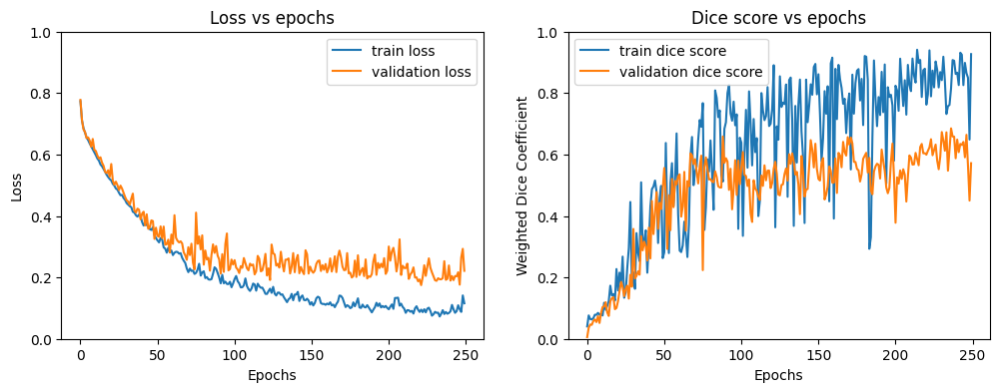

In [ ]:
# recompile model
model = UNet(out_channels=3)

# define the hyperparameters
LEARNING_RATE = 1e-4
BATCHSIZE = 32
EPOCHS = 250
NUM_WORKERS = 4

if __name__ == "__main__":

    worker_g = torch.Generator()
    worker_g.manual_seed(0)
    train_batches = DataLoader(
        train_dataset, batch_size=BATCHSIZE, shuffle=True,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )
    worker_g.manual_seed(0)
    valid_batches = DataLoader(
        valid_dataset, batch_size=BATCHSIZE, shuffle=False,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )

    # define the loss function and the optimizer
    criterion = smp.losses.DiceLoss(mode="multiclass", from_logits=True)
    optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

    start_time = time.time()

    # train the network
    history = run_train_loop("unetset3", model, train_batches, valid_batches, EPOCHS, criterion, optimizer)
    torch.save(
        {
            "epoch": 100,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "history": history,
        },
        f"{project_folder_path}models/unetset3_model_final.pth"
    )

    # display the total time needed to perform the training
    end_time = time.time()
    print(f"Total time taken to train the model: {(end_time - start_time):.2f}s")

    # plot the loss and accuracy history
    plot_history(history)

<i>Optional garbage collection to free up space</i>

In [ ]:
torch.cuda.empty_cache()
gc.collect()

6924

#### Set 4
loss: Dice Loss, learning rate: 1e-5, batch size: 32, epochs: 250

100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 1/250 Train Loss: 0.7966 Validation Loss: 0.8044, Train Dice Score: 0.0286 Validation Dice Score: 0.0111


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 2/250 Train Loss: 0.7774 Validation Loss: 0.7721, Train Dice Score: 0.0301 Validation Dice Score: 0.0329


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 3/250 Train Loss: 0.7572 Validation Loss: 0.7477, Train Dice Score: 0.0379 Validation Dice Score: 0.0348


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 4/250 Train Loss: 0.7369 Validation Loss: 0.7403, Train Dice Score: 0.0579 Validation Dice Score: 0.0358


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 5/250 Train Loss: 0.7218 Validation Loss: 0.7270, Train Dice Score: 0.0741 Validation Dice Score: 0.0415


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 6/250 Train Loss: 0.7092 Validation Loss: 0.7248, Train Dice Score: 0.0442 Validation Dice Score: 0.0416


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 7/250 Train Loss: 0.6995 Validation Loss: 0.7041, Train Dice Score: 0.0654 Validation Dice Score: 0.0597


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 8/250 Train Loss: 0.6917 Validation Loss: 0.7004, Train Dice Score: 0.0949 Validation Dice Score: 0.0537


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 9/250 Train Loss: 0.6853 Validation Loss: 0.6938, Train Dice Score: 0.0758 Validation Dice Score: 0.0600


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 10/250 Train Loss: 0.6786 Validation Loss: 0.6820, Train Dice Score: 0.0700 Validation Dice Score: 0.0737


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 11/250 Train Loss: 0.6744 Validation Loss: 0.6806, Train Dice Score: 0.1000 Validation Dice Score: 0.0628


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 12/250 Train Loss: 0.6702 Validation Loss: 0.6746, Train Dice Score: 0.0776 Validation Dice Score: 0.0764


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 13/250 Train Loss: 0.6627 Validation Loss: 0.6715, Train Dice Score: 0.0699 Validation Dice Score: 0.0768


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 14/250 Train Loss: 0.6598 Validation Loss: 0.6712, Train Dice Score: 0.0882 Validation Dice Score: 0.0782


100%|██████████| 20/20 [00:07<00:00,  2.76it/s]


Epoch 15/250 Train Loss: 0.6577 Validation Loss: 0.6735, Train Dice Score: 0.0743 Validation Dice Score: 0.0683


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 16/250 Train Loss: 0.6544 Validation Loss: 0.6656, Train Dice Score: 0.0960 Validation Dice Score: 0.0747


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 17/250 Train Loss: 0.6504 Validation Loss: 0.6609, Train Dice Score: 0.1001 Validation Dice Score: 0.0834


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 18/250 Train Loss: 0.6488 Validation Loss: 0.6633, Train Dice Score: 0.0872 Validation Dice Score: 0.0783


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 19/250 Train Loss: 0.6468 Validation Loss: 0.6573, Train Dice Score: 0.1188 Validation Dice Score: 0.0796


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 20/250 Train Loss: 0.6428 Validation Loss: 0.6600, Train Dice Score: 0.0656 Validation Dice Score: 0.0714


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 21/250 Train Loss: 0.6377 Validation Loss: 0.6617, Train Dice Score: 0.1240 Validation Dice Score: 0.0738


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 22/250 Train Loss: 0.6362 Validation Loss: 0.6559, Train Dice Score: 0.1103 Validation Dice Score: 0.0833


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 23/250 Train Loss: 0.6358 Validation Loss: 0.6579, Train Dice Score: 0.0836 Validation Dice Score: 0.0712


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 24/250 Train Loss: 0.6328 Validation Loss: 0.6590, Train Dice Score: 0.1023 Validation Dice Score: 0.0654


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 25/250 Train Loss: 0.6313 Validation Loss: 0.6474, Train Dice Score: 0.1047 Validation Dice Score: 0.0896


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 26/250 Train Loss: 0.6297 Validation Loss: 0.6414, Train Dice Score: 0.1140 Validation Dice Score: 0.0903


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 27/250 Train Loss: 0.6278 Validation Loss: 0.6446, Train Dice Score: 0.1332 Validation Dice Score: 0.0936


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 28/250 Train Loss: 0.6225 Validation Loss: 0.6513, Train Dice Score: 0.1067 Validation Dice Score: 0.0707


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 29/250 Train Loss: 0.6199 Validation Loss: 0.6396, Train Dice Score: 0.1128 Validation Dice Score: 0.0916


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 30/250 Train Loss: 0.6207 Validation Loss: 0.6380, Train Dice Score: 0.1362 Validation Dice Score: 0.0864


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 31/250 Train Loss: 0.6207 Validation Loss: 0.6349, Train Dice Score: 0.1157 Validation Dice Score: 0.0909


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 32/250 Train Loss: 0.6158 Validation Loss: 0.6408, Train Dice Score: 0.1000 Validation Dice Score: 0.0841


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 33/250 Train Loss: 0.6133 Validation Loss: 0.6349, Train Dice Score: 0.0880 Validation Dice Score: 0.0872


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 34/250 Train Loss: 0.6114 Validation Loss: 0.6394, Train Dice Score: 0.1158 Validation Dice Score: 0.0982


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 35/250 Train Loss: 0.6117 Validation Loss: 0.6262, Train Dice Score: 0.1180 Validation Dice Score: 0.1021


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 36/250 Train Loss: 0.6069 Validation Loss: 0.6251, Train Dice Score: 0.1214 Validation Dice Score: 0.0951


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 37/250 Train Loss: 0.6052 Validation Loss: 0.6279, Train Dice Score: 0.1192 Validation Dice Score: 0.1032


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 38/250 Train Loss: 0.6049 Validation Loss: 0.6298, Train Dice Score: 0.1007 Validation Dice Score: 0.0857


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 39/250 Train Loss: 0.6027 Validation Loss: 0.6233, Train Dice Score: 0.1123 Validation Dice Score: 0.1081


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 40/250 Train Loss: 0.6021 Validation Loss: 0.6275, Train Dice Score: 0.1314 Validation Dice Score: 0.0927


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 41/250 Train Loss: 0.5992 Validation Loss: 0.6204, Train Dice Score: 0.1167 Validation Dice Score: 0.1055


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 42/250 Train Loss: 0.5976 Validation Loss: 0.6204, Train Dice Score: 0.1087 Validation Dice Score: 0.1019


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 43/250 Train Loss: 0.5956 Validation Loss: 0.6182, Train Dice Score: 0.1345 Validation Dice Score: 0.1044


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 44/250 Train Loss: 0.5933 Validation Loss: 0.6191, Train Dice Score: 0.1043 Validation Dice Score: 0.1005


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 45/250 Train Loss: 0.5904 Validation Loss: 0.6176, Train Dice Score: 0.1118 Validation Dice Score: 0.1098


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 46/250 Train Loss: 0.5909 Validation Loss: 0.6186, Train Dice Score: 0.1339 Validation Dice Score: 0.1028


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 47/250 Train Loss: 0.5911 Validation Loss: 0.6134, Train Dice Score: 0.1327 Validation Dice Score: 0.1032


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 48/250 Train Loss: 0.5879 Validation Loss: 0.6089, Train Dice Score: 0.1079 Validation Dice Score: 0.1100


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 49/250 Train Loss: 0.5881 Validation Loss: 0.6104, Train Dice Score: 0.1112 Validation Dice Score: 0.1033


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 50/250 Train Loss: 0.5836 Validation Loss: 0.6052, Train Dice Score: 0.1347 Validation Dice Score: 0.1141


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 51/250 Train Loss: 0.5815 Validation Loss: 0.6105, Train Dice Score: 0.1314 Validation Dice Score: 0.1120


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 52/250 Train Loss: 0.5796 Validation Loss: 0.6103, Train Dice Score: 0.1228 Validation Dice Score: 0.1029


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 53/250 Train Loss: 0.5789 Validation Loss: 0.6071, Train Dice Score: 0.1290 Validation Dice Score: 0.1010


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 54/250 Train Loss: 0.5775 Validation Loss: 0.6129, Train Dice Score: 0.1287 Validation Dice Score: 0.1029


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 55/250 Train Loss: 0.5787 Validation Loss: 0.6115, Train Dice Score: 0.1281 Validation Dice Score: 0.1091


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 56/250 Train Loss: 0.5757 Validation Loss: 0.6032, Train Dice Score: 0.1238 Validation Dice Score: 0.1086


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 57/250 Train Loss: 0.5733 Validation Loss: 0.5995, Train Dice Score: 0.1476 Validation Dice Score: 0.1034


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 58/250 Train Loss: 0.5719 Validation Loss: 0.6069, Train Dice Score: 0.1597 Validation Dice Score: 0.1115


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 59/250 Train Loss: 0.5681 Validation Loss: 0.5985, Train Dice Score: 0.1203 Validation Dice Score: 0.1094


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 60/250 Train Loss: 0.5695 Validation Loss: 0.6002, Train Dice Score: 0.1358 Validation Dice Score: 0.1107


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 61/250 Train Loss: 0.5669 Validation Loss: 0.5963, Train Dice Score: 0.1288 Validation Dice Score: 0.1111


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 62/250 Train Loss: 0.5642 Validation Loss: 0.5953, Train Dice Score: 0.1167 Validation Dice Score: 0.1098


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 63/250 Train Loss: 0.5627 Validation Loss: 0.5911, Train Dice Score: 0.1318 Validation Dice Score: 0.1111


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 64/250 Train Loss: 0.5615 Validation Loss: 0.5922, Train Dice Score: 0.1303 Validation Dice Score: 0.1106


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 65/250 Train Loss: 0.5590 Validation Loss: 0.5946, Train Dice Score: 0.1478 Validation Dice Score: 0.1097


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 66/250 Train Loss: 0.5589 Validation Loss: 0.5948, Train Dice Score: 0.1360 Validation Dice Score: 0.1021


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 67/250 Train Loss: 0.5592 Validation Loss: 0.5947, Train Dice Score: 0.1439 Validation Dice Score: 0.1031


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 68/250 Train Loss: 0.5574 Validation Loss: 0.5932, Train Dice Score: 0.1590 Validation Dice Score: 0.1124


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 69/250 Train Loss: 0.5568 Validation Loss: 0.5895, Train Dice Score: 0.1323 Validation Dice Score: 0.1140


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 70/250 Train Loss: 0.5529 Validation Loss: 0.5856, Train Dice Score: 0.1512 Validation Dice Score: 0.1136


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 71/250 Train Loss: 0.5509 Validation Loss: 0.5864, Train Dice Score: 0.1448 Validation Dice Score: 0.1101


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 72/250 Train Loss: 0.5490 Validation Loss: 0.5894, Train Dice Score: 0.1347 Validation Dice Score: 0.1107


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 73/250 Train Loss: 0.5551 Validation Loss: 0.5888, Train Dice Score: 0.1697 Validation Dice Score: 0.1138


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 74/250 Train Loss: 0.5495 Validation Loss: 0.6026, Train Dice Score: 0.1479 Validation Dice Score: 0.0877


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 75/250 Train Loss: 0.5498 Validation Loss: 0.5865, Train Dice Score: 0.1493 Validation Dice Score: 0.1109


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 76/250 Train Loss: 0.5487 Validation Loss: 0.5834, Train Dice Score: 0.1242 Validation Dice Score: 0.1109


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 77/250 Train Loss: 0.5447 Validation Loss: 0.5951, Train Dice Score: 0.1159 Validation Dice Score: 0.0889


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 78/250 Train Loss: 0.5451 Validation Loss: 0.5896, Train Dice Score: 0.1246 Validation Dice Score: 0.0933


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 79/250 Train Loss: 0.5458 Validation Loss: 0.5870, Train Dice Score: 0.1287 Validation Dice Score: 0.1038


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 80/250 Train Loss: 0.5446 Validation Loss: 0.5766, Train Dice Score: 0.1514 Validation Dice Score: 0.1091


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 81/250 Train Loss: 0.5397 Validation Loss: 0.5763, Train Dice Score: 0.1286 Validation Dice Score: 0.1135


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 82/250 Train Loss: 0.5377 Validation Loss: 0.5743, Train Dice Score: 0.1327 Validation Dice Score: 0.1130


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 83/250 Train Loss: 0.5370 Validation Loss: 0.5711, Train Dice Score: 0.1270 Validation Dice Score: 0.1150


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 84/250 Train Loss: 0.5381 Validation Loss: 0.5774, Train Dice Score: 0.2020 Validation Dice Score: 0.1162


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 85/250 Train Loss: 0.5368 Validation Loss: 0.5772, Train Dice Score: 0.1303 Validation Dice Score: 0.1118


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 86/250 Train Loss: 0.5331 Validation Loss: 0.5755, Train Dice Score: 0.1495 Validation Dice Score: 0.1082


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 87/250 Train Loss: 0.5338 Validation Loss: 0.5757, Train Dice Score: 0.1739 Validation Dice Score: 0.1097


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 88/250 Train Loss: 0.5313 Validation Loss: 0.5715, Train Dice Score: 0.1572 Validation Dice Score: 0.1089


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 89/250 Train Loss: 0.5302 Validation Loss: 0.5739, Train Dice Score: 0.1418 Validation Dice Score: 0.1137


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 90/250 Train Loss: 0.5296 Validation Loss: 0.5723, Train Dice Score: 0.1381 Validation Dice Score: 0.1145


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 91/250 Train Loss: 0.5313 Validation Loss: 0.5835, Train Dice Score: 0.1070 Validation Dice Score: 0.1055


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 92/250 Train Loss: 0.5310 Validation Loss: 0.5752, Train Dice Score: 0.1544 Validation Dice Score: 0.1013


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 93/250 Train Loss: 0.5291 Validation Loss: 0.5719, Train Dice Score: 0.1234 Validation Dice Score: 0.1113


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 94/250 Train Loss: 0.5265 Validation Loss: 0.5647, Train Dice Score: 0.2064 Validation Dice Score: 0.1209


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 95/250 Train Loss: 0.5235 Validation Loss: 0.5687, Train Dice Score: 0.1652 Validation Dice Score: 0.1138


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 96/250 Train Loss: 0.5218 Validation Loss: 0.5662, Train Dice Score: 0.1487 Validation Dice Score: 0.1164


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 97/250 Train Loss: 0.5204 Validation Loss: 0.5608, Train Dice Score: 0.1245 Validation Dice Score: 0.1166


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 98/250 Train Loss: 0.5198 Validation Loss: 0.5644, Train Dice Score: 0.1865 Validation Dice Score: 0.1138


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 99/250 Train Loss: 0.5202 Validation Loss: 0.5697, Train Dice Score: 0.1888 Validation Dice Score: 0.1071


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 100/250 Train Loss: 0.5178 Validation Loss: 0.5570, Train Dice Score: 0.1510 Validation Dice Score: 0.1183


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 101/250 Train Loss: 0.5157 Validation Loss: 0.5607, Train Dice Score: 0.1547 Validation Dice Score: 0.1155


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 102/250 Train Loss: 0.5154 Validation Loss: 0.5648, Train Dice Score: 0.1333 Validation Dice Score: 0.1141


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 103/250 Train Loss: 0.5136 Validation Loss: 0.5575, Train Dice Score: 0.1373 Validation Dice Score: 0.1195


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 104/250 Train Loss: 0.5122 Validation Loss: 0.5534, Train Dice Score: 0.1307 Validation Dice Score: 0.1193


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 105/250 Train Loss: 0.5124 Validation Loss: 0.5572, Train Dice Score: 0.1486 Validation Dice Score: 0.1163


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 106/250 Train Loss: 0.5112 Validation Loss: 0.5555, Train Dice Score: 0.1232 Validation Dice Score: 0.1173


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 107/250 Train Loss: 0.5089 Validation Loss: 0.5602, Train Dice Score: 0.1454 Validation Dice Score: 0.1137


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 108/250 Train Loss: 0.5096 Validation Loss: 0.5541, Train Dice Score: 0.1704 Validation Dice Score: 0.1143


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 109/250 Train Loss: 0.5076 Validation Loss: 0.5514, Train Dice Score: 0.1299 Validation Dice Score: 0.1122


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 110/250 Train Loss: 0.5076 Validation Loss: 0.5531, Train Dice Score: 0.2063 Validation Dice Score: 0.1223


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 111/250 Train Loss: 0.5058 Validation Loss: 0.5528, Train Dice Score: 0.1441 Validation Dice Score: 0.1149


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 112/250 Train Loss: 0.5060 Validation Loss: 0.5562, Train Dice Score: 0.1222 Validation Dice Score: 0.1163


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 113/250 Train Loss: 0.5031 Validation Loss: 0.5513, Train Dice Score: 0.1425 Validation Dice Score: 0.1139


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 114/250 Train Loss: 0.5029 Validation Loss: 0.5639, Train Dice Score: 0.1814 Validation Dice Score: 0.1055


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 115/250 Train Loss: 0.5028 Validation Loss: 0.5474, Train Dice Score: 0.1252 Validation Dice Score: 0.1187


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 116/250 Train Loss: 0.5020 Validation Loss: 0.5489, Train Dice Score: 0.1491 Validation Dice Score: 0.1170


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 117/250 Train Loss: 0.5011 Validation Loss: 0.5507, Train Dice Score: 0.1272 Validation Dice Score: 0.1174


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 118/250 Train Loss: 0.5004 Validation Loss: 0.5483, Train Dice Score: 0.1525 Validation Dice Score: 0.1169


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 119/250 Train Loss: 0.4964 Validation Loss: 0.5462, Train Dice Score: 0.1519 Validation Dice Score: 0.1167


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 120/250 Train Loss: 0.4969 Validation Loss: 0.5439, Train Dice Score: 0.1313 Validation Dice Score: 0.1213


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 121/250 Train Loss: 0.4946 Validation Loss: 0.5436, Train Dice Score: 0.1323 Validation Dice Score: 0.1194


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 122/250 Train Loss: 0.4937 Validation Loss: 0.5456, Train Dice Score: 0.1354 Validation Dice Score: 0.1212


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 123/250 Train Loss: 0.4935 Validation Loss: 0.5467, Train Dice Score: 0.1311 Validation Dice Score: 0.1209


100%|██████████| 20/20 [00:07<00:00,  2.77it/s]


Epoch 124/250 Train Loss: 0.4933 Validation Loss: 0.5434, Train Dice Score: 0.1368 Validation Dice Score: 0.1164


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 125/250 Train Loss: 0.4955 Validation Loss: 0.5461, Train Dice Score: 0.1430 Validation Dice Score: 0.1173


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 126/250 Train Loss: 0.4914 Validation Loss: 0.5446, Train Dice Score: 0.1561 Validation Dice Score: 0.1150


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 127/250 Train Loss: 0.4918 Validation Loss: 0.5420, Train Dice Score: 0.2637 Validation Dice Score: 0.1221


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 128/250 Train Loss: 0.4912 Validation Loss: 0.5388, Train Dice Score: 0.1542 Validation Dice Score: 0.1223


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 129/250 Train Loss: 0.4888 Validation Loss: 0.5413, Train Dice Score: 0.1472 Validation Dice Score: 0.1223


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 130/250 Train Loss: 0.4890 Validation Loss: 0.5452, Train Dice Score: 0.1419 Validation Dice Score: 0.1141


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 131/250 Train Loss: 0.4875 Validation Loss: 0.5386, Train Dice Score: 0.2212 Validation Dice Score: 0.1155


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 132/250 Train Loss: 0.4858 Validation Loss: 0.5426, Train Dice Score: 0.1451 Validation Dice Score: 0.1148


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 133/250 Train Loss: 0.4851 Validation Loss: 0.5370, Train Dice Score: 0.1640 Validation Dice Score: 0.1185


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 134/250 Train Loss: 0.4832 Validation Loss: 0.5357, Train Dice Score: 0.1434 Validation Dice Score: 0.1190


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 135/250 Train Loss: 0.4837 Validation Loss: 0.5334, Train Dice Score: 0.1759 Validation Dice Score: 0.1216


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 136/250 Train Loss: 0.4828 Validation Loss: 0.5374, Train Dice Score: 0.1522 Validation Dice Score: 0.1182


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 137/250 Train Loss: 0.4816 Validation Loss: 0.5315, Train Dice Score: 0.1601 Validation Dice Score: 0.1196


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 138/250 Train Loss: 0.4820 Validation Loss: 0.5355, Train Dice Score: 0.1616 Validation Dice Score: 0.1202


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 139/250 Train Loss: 0.4788 Validation Loss: 0.5410, Train Dice Score: 0.1855 Validation Dice Score: 0.1158


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 140/250 Train Loss: 0.4795 Validation Loss: 0.5310, Train Dice Score: 0.1580 Validation Dice Score: 0.1171


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 141/250 Train Loss: 0.4801 Validation Loss: 0.5372, Train Dice Score: 0.1369 Validation Dice Score: 0.1173


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 142/250 Train Loss: 0.4777 Validation Loss: 0.5375, Train Dice Score: 0.1595 Validation Dice Score: 0.1104


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 143/250 Train Loss: 0.4784 Validation Loss: 0.5364, Train Dice Score: 0.1469 Validation Dice Score: 0.1159


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 144/250 Train Loss: 0.4796 Validation Loss: 0.5353, Train Dice Score: 0.1893 Validation Dice Score: 0.1162


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 145/250 Train Loss: 0.4749 Validation Loss: 0.5325, Train Dice Score: 0.1778 Validation Dice Score: 0.1132


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 146/250 Train Loss: 0.4759 Validation Loss: 0.5413, Train Dice Score: 0.1428 Validation Dice Score: 0.1162


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 147/250 Train Loss: 0.4746 Validation Loss: 0.5285, Train Dice Score: 0.1337 Validation Dice Score: 0.1162


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 148/250 Train Loss: 0.4731 Validation Loss: 0.5321, Train Dice Score: 0.1480 Validation Dice Score: 0.1117


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 149/250 Train Loss: 0.4704 Validation Loss: 0.5258, Train Dice Score: 0.1310 Validation Dice Score: 0.1202


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 150/250 Train Loss: 0.4713 Validation Loss: 0.5237, Train Dice Score: 0.1850 Validation Dice Score: 0.1186


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 151/250 Train Loss: 0.4699 Validation Loss: 0.5265, Train Dice Score: 0.1575 Validation Dice Score: 0.1088


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 152/250 Train Loss: 0.4689 Validation Loss: 0.5269, Train Dice Score: 0.1367 Validation Dice Score: 0.1165


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 153/250 Train Loss: 0.4682 Validation Loss: 0.5221, Train Dice Score: 0.1594 Validation Dice Score: 0.1194


100%|██████████| 20/20 [00:07<00:00,  2.75it/s]


Epoch 154/250 Train Loss: 0.4687 Validation Loss: 0.5264, Train Dice Score: 0.1235 Validation Dice Score: 0.1156


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 155/250 Train Loss: 0.4676 Validation Loss: 0.5250, Train Dice Score: 0.1646 Validation Dice Score: 0.1214


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 156/250 Train Loss: 0.4667 Validation Loss: 0.5194, Train Dice Score: 0.1553 Validation Dice Score: 0.1142


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 157/250 Train Loss: 0.4662 Validation Loss: 0.5251, Train Dice Score: 0.1403 Validation Dice Score: 0.1149


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 158/250 Train Loss: 0.4654 Validation Loss: 0.5191, Train Dice Score: 0.1371 Validation Dice Score: 0.1200


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 159/250 Train Loss: 0.4629 Validation Loss: 0.5151, Train Dice Score: 0.1483 Validation Dice Score: 0.1158


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 160/250 Train Loss: 0.4627 Validation Loss: 0.5267, Train Dice Score: 0.1309 Validation Dice Score: 0.1174


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 161/250 Train Loss: 0.4620 Validation Loss: 0.5227, Train Dice Score: 0.1159 Validation Dice Score: 0.1164


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 162/250 Train Loss: 0.4620 Validation Loss: 0.5190, Train Dice Score: 0.1505 Validation Dice Score: 0.1171


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 163/250 Train Loss: 0.4609 Validation Loss: 0.5249, Train Dice Score: 0.1645 Validation Dice Score: 0.1145


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 164/250 Train Loss: 0.4592 Validation Loss: 0.5177, Train Dice Score: 0.1515 Validation Dice Score: 0.1186


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 165/250 Train Loss: 0.4565 Validation Loss: 0.5141, Train Dice Score: 0.1722 Validation Dice Score: 0.1203


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 166/250 Train Loss: 0.4572 Validation Loss: 0.5129, Train Dice Score: 0.1657 Validation Dice Score: 0.1174


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 167/250 Train Loss: 0.4574 Validation Loss: 0.5154, Train Dice Score: 0.3182 Validation Dice Score: 0.1223


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 168/250 Train Loss: 0.4547 Validation Loss: 0.5120, Train Dice Score: 0.1707 Validation Dice Score: 0.1233


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 169/250 Train Loss: 0.4536 Validation Loss: 0.5131, Train Dice Score: 0.1923 Validation Dice Score: 0.1236


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 170/250 Train Loss: 0.4555 Validation Loss: 0.5196, Train Dice Score: 0.1478 Validation Dice Score: 0.1211


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 171/250 Train Loss: 0.4522 Validation Loss: 0.5207, Train Dice Score: 0.1479 Validation Dice Score: 0.1199


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 172/250 Train Loss: 0.4515 Validation Loss: 0.5120, Train Dice Score: 0.1635 Validation Dice Score: 0.1225


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 173/250 Train Loss: 0.4518 Validation Loss: 0.5150, Train Dice Score: 0.1623 Validation Dice Score: 0.1168


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 174/250 Train Loss: 0.4516 Validation Loss: 0.5102, Train Dice Score: 0.1749 Validation Dice Score: 0.1266


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 175/250 Train Loss: 0.4492 Validation Loss: 0.5152, Train Dice Score: 0.1796 Validation Dice Score: 0.1240


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 176/250 Train Loss: 0.4491 Validation Loss: 0.5125, Train Dice Score: 0.2104 Validation Dice Score: 0.1201


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 177/250 Train Loss: 0.4481 Validation Loss: 0.5108, Train Dice Score: 0.1647 Validation Dice Score: 0.1194


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 178/250 Train Loss: 0.4487 Validation Loss: 0.5062, Train Dice Score: 0.1768 Validation Dice Score: 0.1259


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 179/250 Train Loss: 0.4470 Validation Loss: 0.5101, Train Dice Score: 0.1421 Validation Dice Score: 0.1272


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 180/250 Train Loss: 0.4450 Validation Loss: 0.5041, Train Dice Score: 0.2281 Validation Dice Score: 0.1292


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 181/250 Train Loss: 0.4427 Validation Loss: 0.5019, Train Dice Score: 0.2891 Validation Dice Score: 0.1297


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 182/250 Train Loss: 0.4448 Validation Loss: 0.5020, Train Dice Score: 0.1640 Validation Dice Score: 0.1328


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 183/250 Train Loss: 0.4430 Validation Loss: 0.5009, Train Dice Score: 0.1760 Validation Dice Score: 0.1275


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 184/250 Train Loss: 0.4412 Validation Loss: 0.5050, Train Dice Score: 0.1832 Validation Dice Score: 0.1239


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 185/250 Train Loss: 0.4403 Validation Loss: 0.4981, Train Dice Score: 0.1504 Validation Dice Score: 0.1410


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 186/250 Train Loss: 0.4402 Validation Loss: 0.5022, Train Dice Score: 0.2135 Validation Dice Score: 0.1291


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 187/250 Train Loss: 0.4389 Validation Loss: 0.5007, Train Dice Score: 0.1993 Validation Dice Score: 0.1268


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 188/250 Train Loss: 0.4379 Validation Loss: 0.5060, Train Dice Score: 0.1713 Validation Dice Score: 0.1200


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 189/250 Train Loss: 0.4370 Validation Loss: 0.4927, Train Dice Score: 0.2093 Validation Dice Score: 0.1316


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 190/250 Train Loss: 0.4354 Validation Loss: 0.4954, Train Dice Score: 0.1890 Validation Dice Score: 0.1364


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 191/250 Train Loss: 0.4334 Validation Loss: 0.4900, Train Dice Score: 0.1813 Validation Dice Score: 0.1416


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 192/250 Train Loss: 0.4334 Validation Loss: 0.4845, Train Dice Score: 0.2405 Validation Dice Score: 0.1604


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 193/250 Train Loss: 0.4321 Validation Loss: 0.4919, Train Dice Score: 0.2294 Validation Dice Score: 0.1468


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 194/250 Train Loss: 0.4336 Validation Loss: 0.4956, Train Dice Score: 0.2637 Validation Dice Score: 0.1435


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 195/250 Train Loss: 0.4319 Validation Loss: 0.4953, Train Dice Score: 0.2269 Validation Dice Score: 0.1330


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 196/250 Train Loss: 0.4319 Validation Loss: 0.4779, Train Dice Score: 0.2280 Validation Dice Score: 0.1752


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 197/250 Train Loss: 0.4298 Validation Loss: 0.4977, Train Dice Score: 0.2614 Validation Dice Score: 0.1405


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 198/250 Train Loss: 0.4288 Validation Loss: 0.5041, Train Dice Score: 0.1783 Validation Dice Score: 0.1259


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 199/250 Train Loss: 0.4275 Validation Loss: 0.4866, Train Dice Score: 0.2276 Validation Dice Score: 0.1525


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 200/250 Train Loss: 0.4279 Validation Loss: 0.4851, Train Dice Score: 0.4064 Validation Dice Score: 0.1853


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 201/250 Train Loss: 0.4274 Validation Loss: 0.4822, Train Dice Score: 0.2448 Validation Dice Score: 0.1803


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 202/250 Train Loss: 0.4262 Validation Loss: 0.4857, Train Dice Score: 0.1754 Validation Dice Score: 0.1696


100%|██████████| 20/20 [00:07<00:00,  2.75it/s]


Epoch 203/250 Train Loss: 0.4235 Validation Loss: 0.4864, Train Dice Score: 0.3299 Validation Dice Score: 0.1680


100%|██████████| 20/20 [00:07<00:00,  2.74it/s]


Epoch 204/250 Train Loss: 0.4207 Validation Loss: 0.4913, Train Dice Score: 0.1708 Validation Dice Score: 0.1583


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 205/250 Train Loss: 0.4233 Validation Loss: 0.4954, Train Dice Score: 0.1952 Validation Dice Score: 0.1497


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 206/250 Train Loss: 0.4243 Validation Loss: 0.4825, Train Dice Score: 0.2084 Validation Dice Score: 0.1983


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 207/250 Train Loss: 0.4205 Validation Loss: 0.4843, Train Dice Score: 0.2370 Validation Dice Score: 0.1831


100%|██████████| 20/20 [00:07<00:00,  2.75it/s]


Epoch 208/250 Train Loss: 0.4210 Validation Loss: 0.4844, Train Dice Score: 0.2602 Validation Dice Score: 0.1604


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 209/250 Train Loss: 0.4229 Validation Loss: 0.4926, Train Dice Score: 0.2781 Validation Dice Score: 0.1458


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 210/250 Train Loss: 0.4182 Validation Loss: 0.4751, Train Dice Score: 0.2895 Validation Dice Score: 0.2201


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 211/250 Train Loss: 0.4155 Validation Loss: 0.4910, Train Dice Score: 0.2524 Validation Dice Score: 0.1458


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 212/250 Train Loss: 0.4173 Validation Loss: 0.4887, Train Dice Score: 0.2724 Validation Dice Score: 0.1459


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 213/250 Train Loss: 0.4177 Validation Loss: 0.4816, Train Dice Score: 0.3209 Validation Dice Score: 0.1869


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 214/250 Train Loss: 0.4161 Validation Loss: 0.4868, Train Dice Score: 0.2591 Validation Dice Score: 0.1797


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 215/250 Train Loss: 0.4108 Validation Loss: 0.4770, Train Dice Score: 0.2779 Validation Dice Score: 0.1922


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 216/250 Train Loss: 0.4104 Validation Loss: 0.4765, Train Dice Score: 0.2297 Validation Dice Score: 0.1963


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 217/250 Train Loss: 0.4097 Validation Loss: 0.4736, Train Dice Score: 0.2946 Validation Dice Score: 0.2574


100%|██████████| 20/20 [00:07<00:00,  2.76it/s]


Epoch 218/250 Train Loss: 0.4088 Validation Loss: 0.4828, Train Dice Score: 0.2417 Validation Dice Score: 0.1575


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 219/250 Train Loss: 0.4096 Validation Loss: 0.4792, Train Dice Score: 0.1977 Validation Dice Score: 0.2194


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 220/250 Train Loss: 0.4066 Validation Loss: 0.4812, Train Dice Score: 0.3251 Validation Dice Score: 0.2064


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 221/250 Train Loss: 0.4048 Validation Loss: 0.4720, Train Dice Score: 0.2151 Validation Dice Score: 0.1690


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 222/250 Train Loss: 0.3987 Validation Loss: 0.4709, Train Dice Score: 0.2399 Validation Dice Score: 0.2359


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 223/250 Train Loss: 0.4010 Validation Loss: 0.4713, Train Dice Score: 0.3360 Validation Dice Score: 0.2099


100%|██████████| 20/20 [00:07<00:00,  2.67it/s]


Epoch 224/250 Train Loss: 0.4057 Validation Loss: 0.4788, Train Dice Score: 0.3068 Validation Dice Score: 0.2845


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 225/250 Train Loss: 0.4008 Validation Loss: 0.4640, Train Dice Score: 0.6184 Validation Dice Score: 0.2568


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 226/250 Train Loss: 0.3993 Validation Loss: 0.4769, Train Dice Score: 0.4906 Validation Dice Score: 0.2811


100%|██████████| 20/20 [00:07<00:00,  2.66it/s]


Epoch 227/250 Train Loss: 0.3975 Validation Loss: 0.4734, Train Dice Score: 0.4759 Validation Dice Score: 0.3837


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 228/250 Train Loss: 0.3934 Validation Loss: 0.4648, Train Dice Score: 0.4110 Validation Dice Score: 0.2867


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 229/250 Train Loss: 0.3916 Validation Loss: 0.4654, Train Dice Score: 0.3416 Validation Dice Score: 0.2681


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 230/250 Train Loss: 0.3917 Validation Loss: 0.4708, Train Dice Score: 0.5438 Validation Dice Score: 0.2485


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 231/250 Train Loss: 0.3884 Validation Loss: 0.4739, Train Dice Score: 0.5416 Validation Dice Score: 0.1964


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 232/250 Train Loss: 0.3871 Validation Loss: 0.4694, Train Dice Score: 0.6926 Validation Dice Score: 0.3924


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 233/250 Train Loss: 0.3836 Validation Loss: 0.4604, Train Dice Score: 0.4845 Validation Dice Score: 0.2659


100%|██████████| 20/20 [00:07<00:00,  2.75it/s]


Epoch 234/250 Train Loss: 0.3878 Validation Loss: 0.4692, Train Dice Score: 0.5067 Validation Dice Score: 0.3301


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 235/250 Train Loss: 0.3847 Validation Loss: 0.4594, Train Dice Score: 0.4134 Validation Dice Score: 0.3086


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 236/250 Train Loss: 0.3786 Validation Loss: 0.4619, Train Dice Score: 0.5515 Validation Dice Score: 0.2921


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 237/250 Train Loss: 0.3777 Validation Loss: 0.4660, Train Dice Score: 0.4964 Validation Dice Score: 0.2451


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 238/250 Train Loss: 0.3773 Validation Loss: 0.4615, Train Dice Score: 0.5581 Validation Dice Score: 0.2197


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 239/250 Train Loss: 0.3780 Validation Loss: 0.4666, Train Dice Score: 0.1560 Validation Dice Score: 0.1750


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 240/250 Train Loss: 0.3787 Validation Loss: 0.4623, Train Dice Score: 0.4584 Validation Dice Score: 0.2763


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 241/250 Train Loss: 0.3756 Validation Loss: 0.4539, Train Dice Score: 0.7478 Validation Dice Score: 0.3465


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 242/250 Train Loss: 0.3764 Validation Loss: 0.4607, Train Dice Score: 0.4159 Validation Dice Score: 0.2843


100%|██████████| 20/20 [00:07<00:00,  2.68it/s]


Epoch 243/250 Train Loss: 0.3737 Validation Loss: 0.4574, Train Dice Score: 0.4309 Validation Dice Score: 0.3125


100%|██████████| 20/20 [00:07<00:00,  2.73it/s]


Epoch 244/250 Train Loss: 0.3679 Validation Loss: 0.4539, Train Dice Score: 0.6072 Validation Dice Score: 0.4055


100%|██████████| 20/20 [00:07<00:00,  2.70it/s]


Epoch 245/250 Train Loss: 0.3710 Validation Loss: 0.4573, Train Dice Score: 0.3636 Validation Dice Score: 0.2061


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 246/250 Train Loss: 0.3662 Validation Loss: 0.4504, Train Dice Score: 0.6201 Validation Dice Score: 0.3006


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 247/250 Train Loss: 0.3655 Validation Loss: 0.4431, Train Dice Score: 0.4459 Validation Dice Score: 0.3308


100%|██████████| 20/20 [00:07<00:00,  2.71it/s]


Epoch 248/250 Train Loss: 0.3626 Validation Loss: 0.4524, Train Dice Score: 0.6211 Validation Dice Score: 0.3797


100%|██████████| 20/20 [00:07<00:00,  2.69it/s]


Epoch 249/250 Train Loss: 0.3599 Validation Loss: 0.4468, Train Dice Score: 0.6328 Validation Dice Score: 0.3529


100%|██████████| 20/20 [00:07<00:00,  2.72it/s]


Epoch 250/250 Train Loss: 0.3591 Validation Loss: 0.4557, Train Dice Score: 0.6183 Validation Dice Score: 0.3890
Total time taken to train the model: 2570.70s


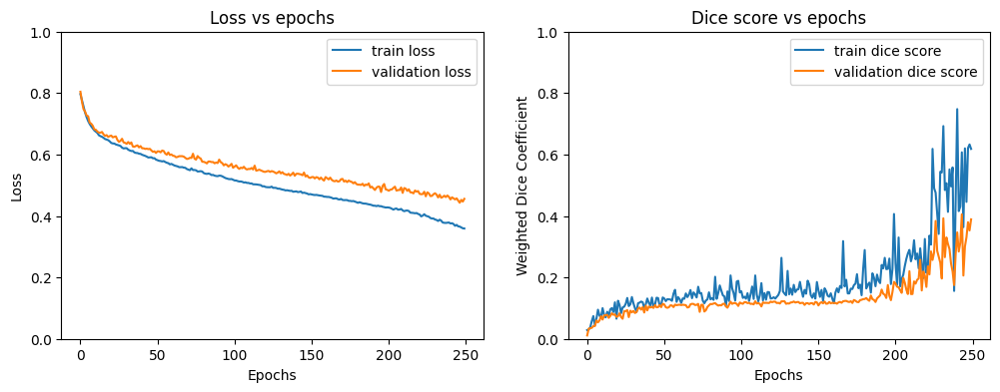

In [ ]:
# recompile model
model = UNet(out_channels=3)

# define the hyperparameters
LEARNING_RATE = 1e-5
BATCHSIZE = 32
EPOCHS = 250
NUM_WORKERS = 4

if __name__ == "__main__":

    worker_g = torch.Generator()
    worker_g.manual_seed(0)
    train_batches = DataLoader(
        train_dataset, batch_size=BATCHSIZE, shuffle=True,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )
    worker_g.manual_seed(0)
    valid_batches = DataLoader(
        valid_dataset, batch_size=BATCHSIZE, shuffle=False,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )

    # define the loss function and the optimizer
    criterion = smp.losses.DiceLoss(mode="multiclass", from_logits=True)
    optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

    start_time = time.time()

    # train the network
    history = run_train_loop("unetset4", model, train_batches, valid_batches, EPOCHS, criterion, optimizer)
    torch.save(
        {
            "epoch": 100,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "history": history,
        },
        f"{project_folder_path}models/unetset4_model_final.pth"
    )

    # display the total time needed to perform the training
    end_time = time.time()
    print(f"Total time taken to train the model: {(end_time - start_time):.2f}s")

    # plot the loss and accuracy history
    plot_history(history)

<i>Optional garbage collection to free up space</i>

In [ ]:
torch.cuda.empty_cache()
gc.collect()

6939

### Evaluate model

The test dataset is loaded with the same preprocessing method of the validation set for evaluation

In [63]:
test_imgPaths = sorted(list(glob.glob(project_folder_path + "test/image/*.jpeg")))
test_maskPaths = sorted(list(glob.glob(project_folder_path + "test/gt/*.jpeg")))
test_dataset = PolypDataset(test_imgPaths, test_maskPaths, transform=val_transform)
TARGET_NAMES = ["background", "neoplastic polyp", "non-neoplastic polyp"]

Result plotting

In [64]:
def plot_pred_and_gt(img: Union[np.ndarray, Image.Image], mask: Union[np.ndarray, Image.Image], pred: Union[np.ndarray, Image.Image]):
    """
    Plot the image and mask together.

        Args:
            sample_img (np.array): The image.
            sample_mask (np.array): The mask.
    """
    fig, ax = plt.subplots(1, 3, figsize=(10, 10))

    # Plot image
    ax[0].imshow(img)
    ax[0].set_title("Image")
    ax[0].set_axis_off()

    # Plot predicted mask
    ax[1].imshow(img)
    ax[1].imshow(decode_mask_colours(pred), alpha=0.25)
    ax[1].set_title("Predicted")
    ax[1].set_axis_off()

    # Plot ground truth mask
    ax[2].imshow(img)
    ax[2].imshow(decode_mask_colours(mask), alpha=0.25)
    ax[2].set_title("Ground Truth")
    ax[2].set_axis_off()

    plt.tight_layout()
    plt.show()

In [65]:
def evaluate_results(test_batches, plot_test_batches, model):
    for data, targets in test_batches:
        data = data.to(device, non_blocking=True)
        targets = targets.to(device, non_blocking=True)

        # forward
        output = model(data)

        y_true = targets.cpu().numpy().flatten()
        y_pred = torch.argmax(output, dim=1).cpu().numpy().flatten()

        print(classification_report(y_true, y_pred, target_names=TARGET_NAMES))
        sns.heatmap(confusion_matrix(y_true, y_pred), annot=True, fmt="d", cmap="Blues", cbar=False, xticklabels=TARGET_NAMES, yticklabels=TARGET_NAMES)
        plt.show()

    # plot some predictions
    data, targets = next(iter(plot_test_batches))
    data = data.to(device, non_blocking=True)
    targets = targets.to(device, non_blocking=True)

    # forward
    output = model(data)

    for i in range(4):
        # get the first image and mask from the batch
        img = data[i].cpu().numpy().transpose(1, 2, 0)
        mask = targets[i].cpu().numpy()
        pred = torch.argmax(output, dim=1)[i].cpu().numpy()

        # plot the image and masks
        plot_pred_and_gt(img, mask, pred)

#### Set 1

Results for UNet model 1
                      precision    recall  f1-score   support

          background       0.99      0.94      0.96  12750928
    neoplastic polyp       0.44      0.80      0.57    589027
non-neoplastic polyp       0.12      0.43      0.19     94925

            accuracy                           0.93  13434880
           macro avg       0.52      0.72      0.57  13434880
        weighted avg       0.96      0.93      0.94  13434880



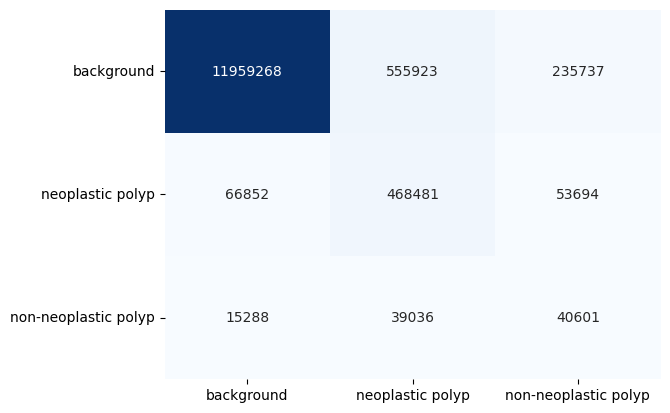

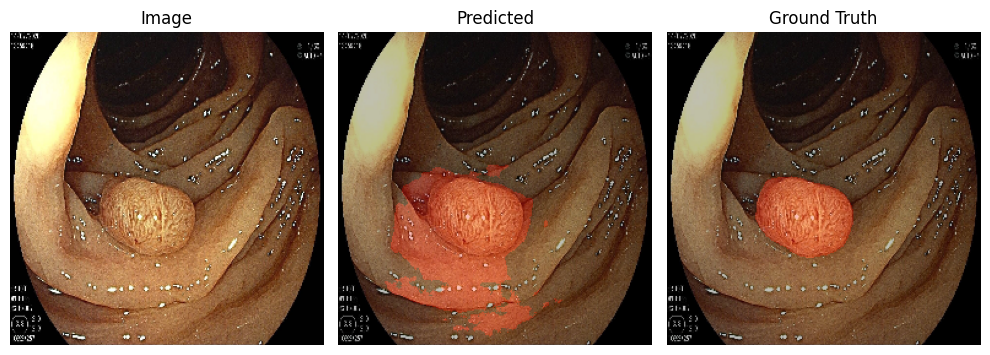

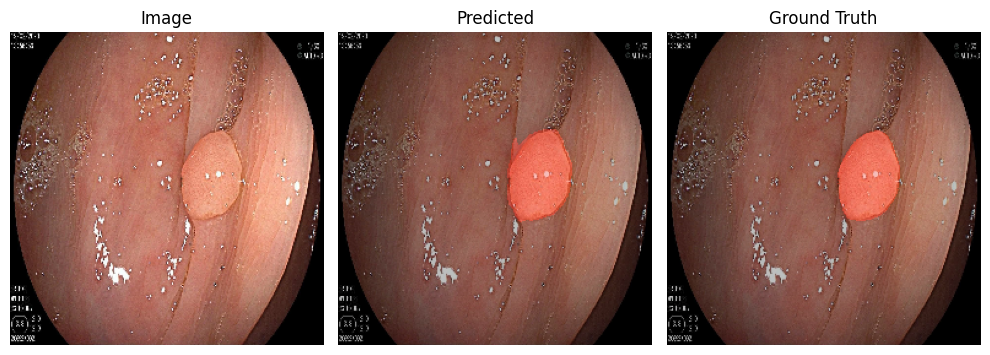

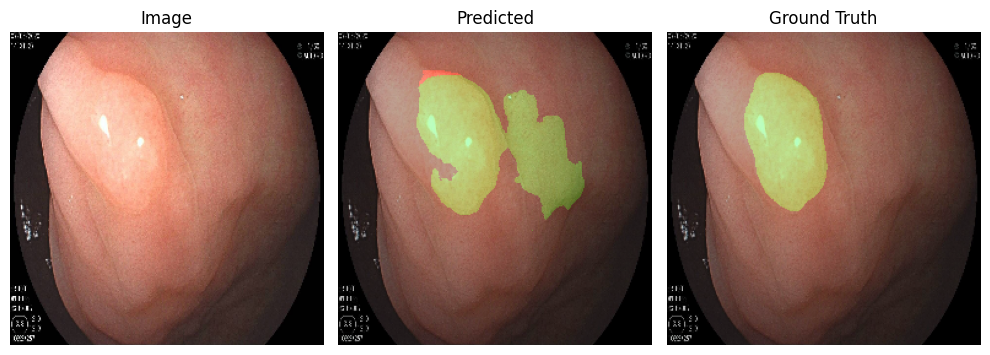

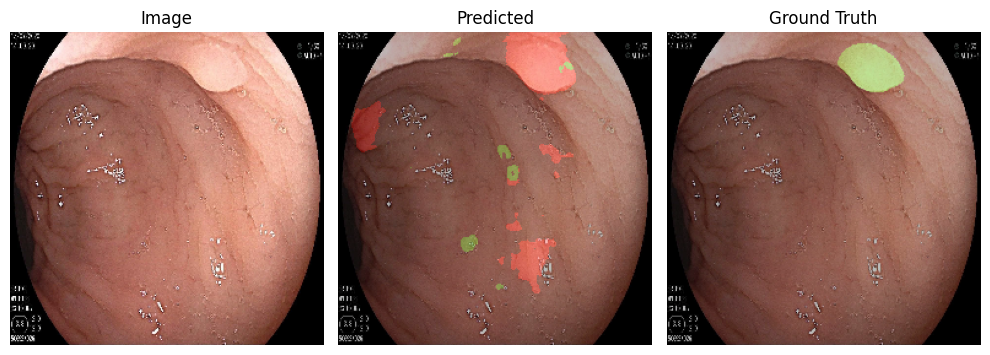

In [ ]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = UNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/unetset1_model_final.pth")["model_state_dict"])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for UNet model 1")
        evaluate_results(test_batches, plot_test_batches, model)

#### Set 2

Results for UNet model 2
                      precision    recall  f1-score   support

          background       0.98      0.99      0.98  12750928
    neoplastic polyp       0.76      0.61      0.68    589027
non-neoplastic polyp       0.19      0.19      0.19     94925

            accuracy                           0.97  13434880
           macro avg       0.64      0.60      0.62  13434880
        weighted avg       0.96      0.97      0.96  13434880



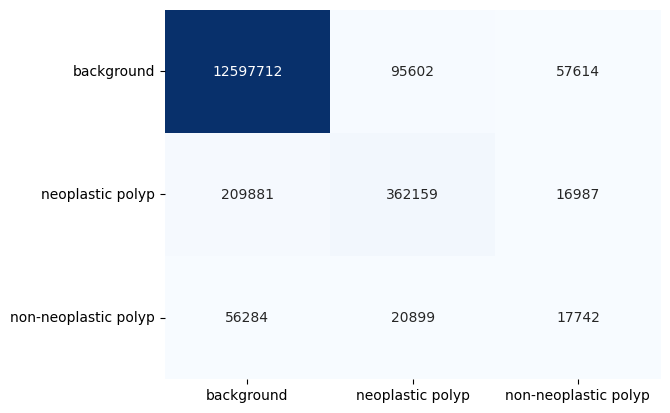

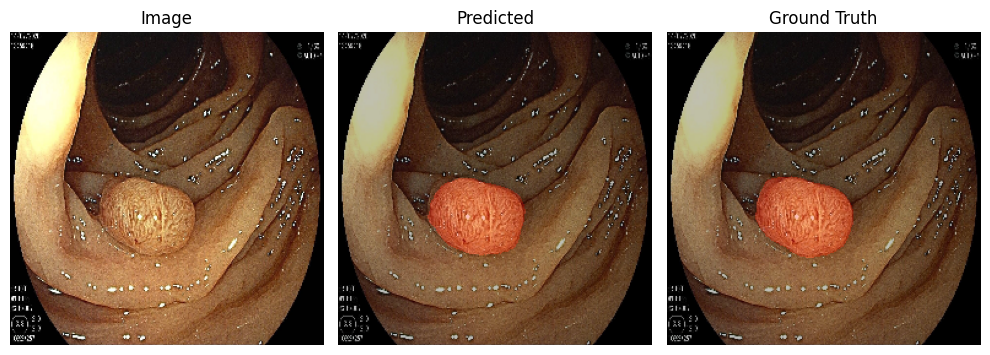

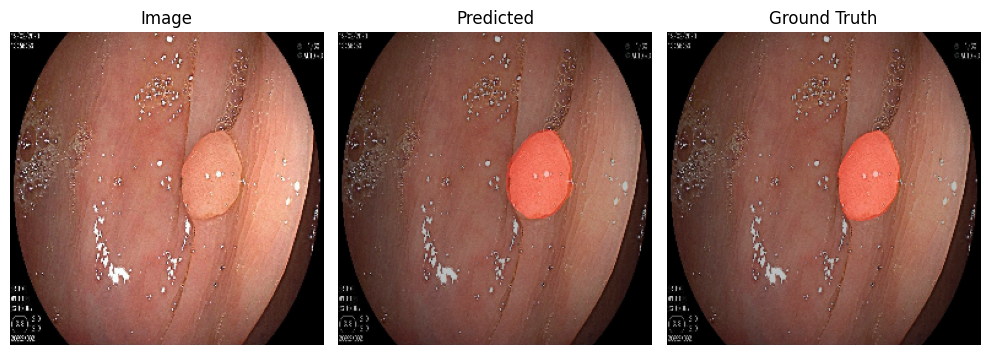

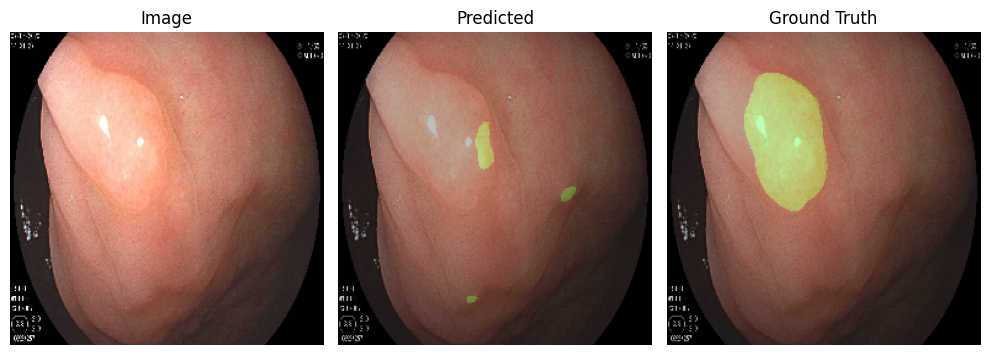

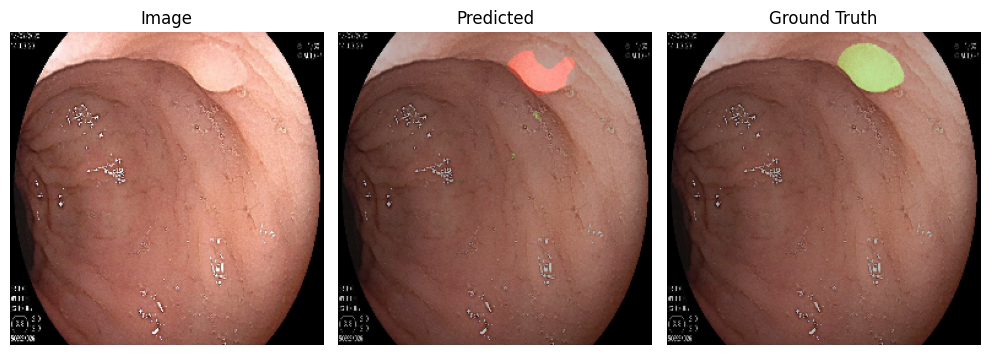

In [ ]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = UNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/unetset2_model_final.pth")['model_state_dict'])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for UNet model 2")
        evaluate_results(test_batches, plot_test_batches, model)

#### Set 3

Results for UNet model 3
                      precision    recall  f1-score   support

          background       0.99      1.00      0.99  12750928
    neoplastic polyp       0.85      0.75      0.79    589027
non-neoplastic polyp       0.53      0.22      0.31     94925

            accuracy                           0.98  13434880
           macro avg       0.79      0.65      0.70  13434880
        weighted avg       0.98      0.98      0.98  13434880



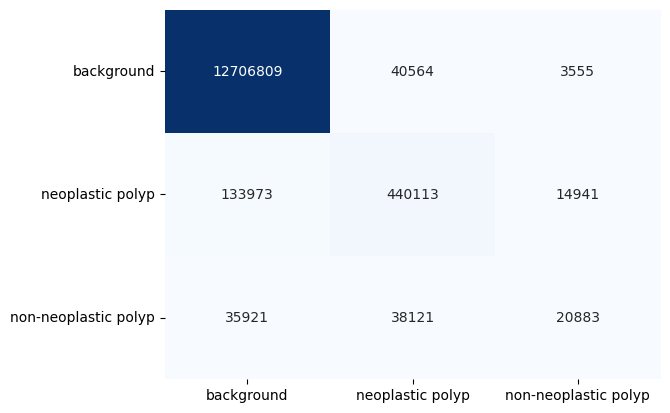

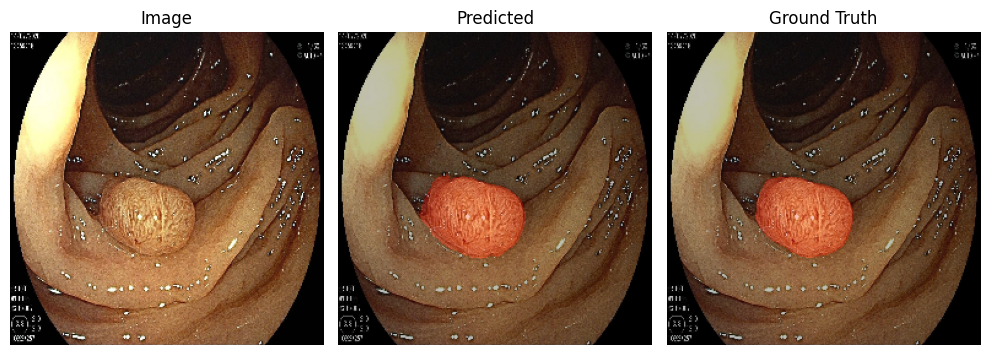

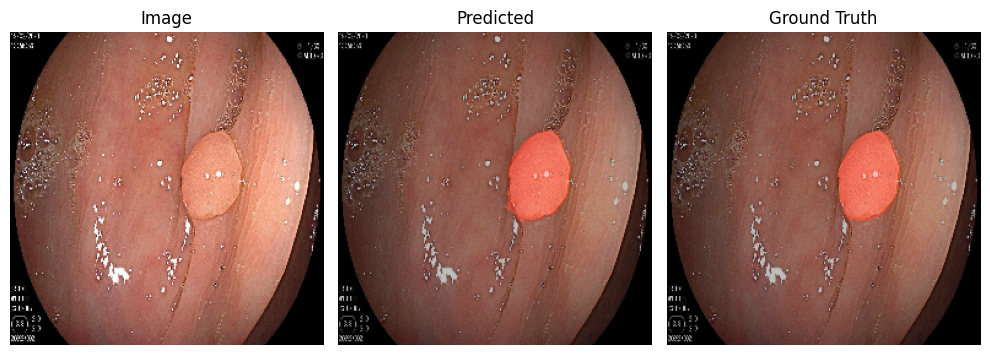

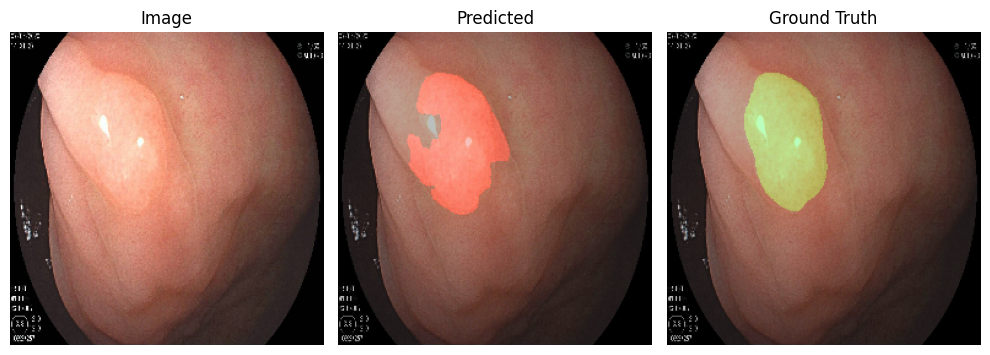

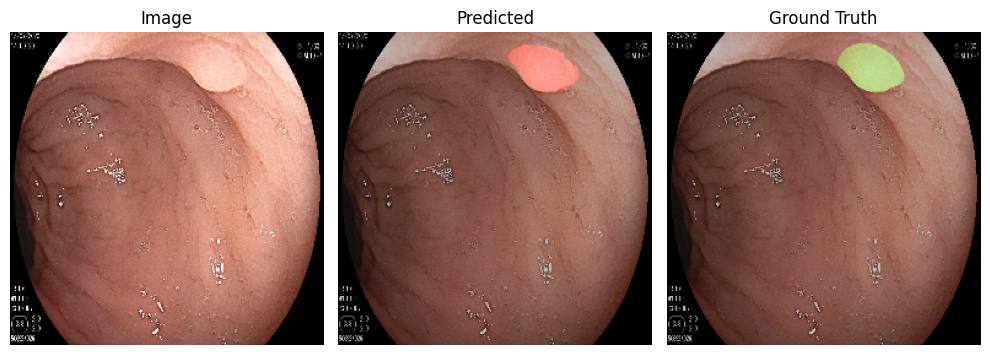

In [ ]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = UNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/unetset3_model_final.pth")['model_state_dict'])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for UNet model 3")
        evaluate_results(test_batches, plot_test_batches, model)

#### Set 4

Results for UNet model 4
                      precision    recall  f1-score   support

          background       0.99      0.99      0.99  12750928
    neoplastic polyp       0.78      0.70      0.74    589027
non-neoplastic polyp       0.17      0.26      0.21     94925

            accuracy                           0.97  13434880
           macro avg       0.64      0.65      0.64  13434880
        weighted avg       0.97      0.97      0.97  13434880



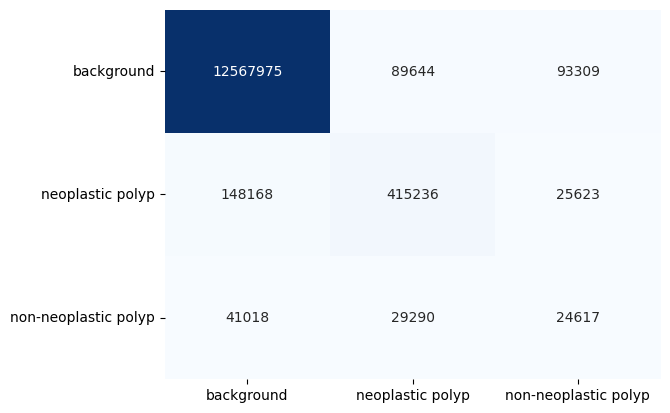

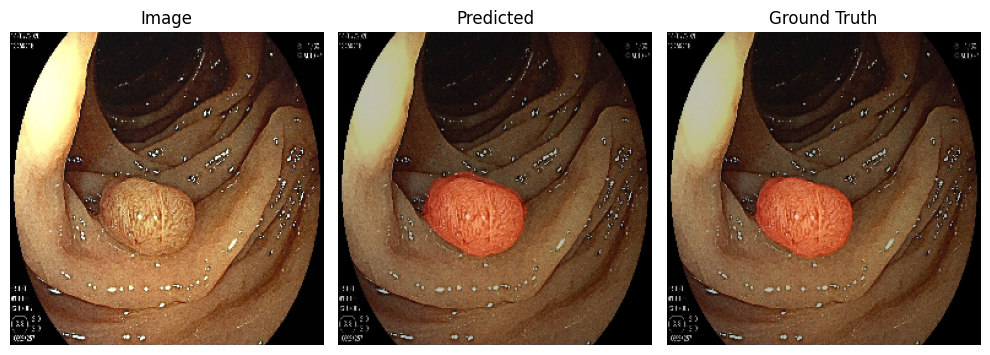

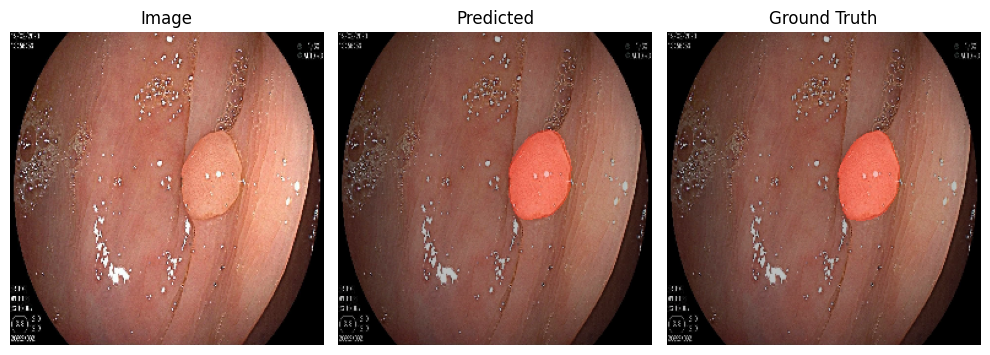

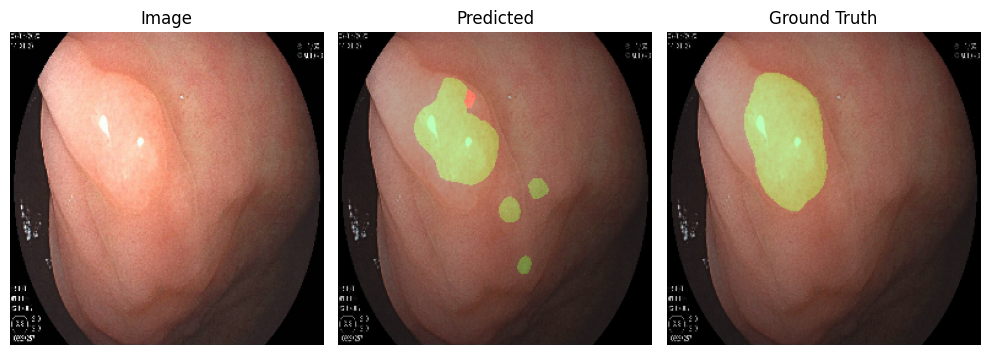

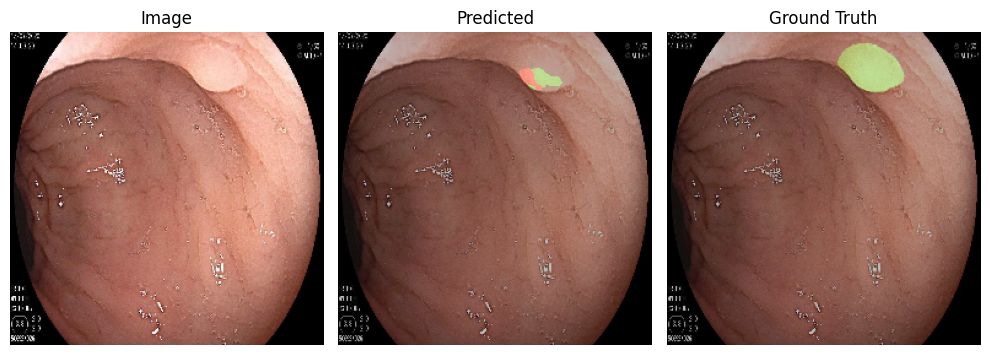

In [ ]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = UNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/unetset4_model_final.pth")['model_state_dict'])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for UNet model 4")
        evaluate_results(test_batches, plot_test_batches, model)

<i>Optional garbage collection to free up space</i>

In [ ]:
torch.cuda.empty_cache()
gc.collect()

15726

<a id="5"></a>
## 5. Modified Unet Model

### Model Architecture
Unet Model with Attention (Attention Unet)

Attention UNet is a modification of the original UNet architecture with the addition of attention gates.

The attention gates are applied to the skip connections between the downsampling and upsampling blocks.

### Attention Block
The attention block in this application is a convolutional block that takes in the skip connection feature map and the upsampled feature map and outputs the attention map.

In [66]:
class AttentionBlock(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super(AttentionBlock, self).__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(F_int)
        )
        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(F_int),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.relu = nn.ReLU(inplace=True)
        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1),
            nn.Sigmoid(),
        )
        self.upsample = nn.Upsample(scale_factor=2, mode="bilinear")

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        psi = self.upsample(psi)
        return x * psi

### Attention Gated Upsample Block
The attention gated upsampling block wraps the attention block and the upsampling block.

In [67]:
class AttentionUpsampleBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding="same"):
        super(AttentionUpsampleBlock, self).__init__()
        self.up = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        self.attn = AttentionBlock(F_g=in_channels, F_l=out_channels, F_int=out_channels)
        self.dropout = nn.Dropout2d(p=0.3)
        self.conv_block = Conv_block(in_channels, out_channels, kernel_size, stride, padding)

    def forward(self, x, skip):
        skip = self.attn(g=x, x=skip)
        x = self.up(x)
        x = torch.cat([x, skip], dim=1)
        x = self.dropout(x)
        x = self.conv_block(x)
        return x

### Attention UNet Model
Combine all parts for the model

In [68]:
class AttentionUNet(nn.Module):
    def __init__(self, out_channels=3, features=[64, 128, 256, 512]):
        super(AttentionUNet, self).__init__()
        # Downsample 64 -> 128 -> 256 -> 512
        self.down1 = Downsample_block(3, features[0])
        self.down2 = Downsample_block(features[0], features[1])
        self.down3 = Downsample_block(features[1], features[2])
        self.down4 = Downsample_block(features[2], features[3])
        # Bottleneck 512 -> 1024
        self.bottleneck = Conv_block(features[3], features[3]*2, kernel_size=3, stride=1, padding="same")
        # Upsample 512 -> 256 -> 128 -> 64
        self.up1 = AttentionUpsampleBlock(features[3]*2, features[3])
        self.up2 = AttentionUpsampleBlock(features[3], features[2])
        self.up3 = AttentionUpsampleBlock(features[2], features[1])
        self.up4 = AttentionUpsampleBlock(features[1], features[0])
        self.out = nn.Conv2d(features[0], out_channels, kernel_size=1, stride=1, padding=0, bias=True)

    def forward(self, x):
        # Downsample 64 -> 128 -> 256 -> 512
        x, skip1 = self.down1(x)
        x, skip2 = self.down2(x)
        x, skip3 = self.down3(x)
        x, skip4 = self.down4(x)
        # Bottleneck 512 -> 1024
        x = self.bottleneck(x)
        # Upsample 512 -> 256 -> 128 -> 64 with concatenation and skip connections
        x = self.up1(x, skip4)
        x = self.up2(x, skip3)
        x = self.up3(x, skip2)
        x = self.up4(x, skip1)
        x = self.out(x)
        return x

<i>Optional garbage collection to free up space</i>

In [32]:
torch.cuda.empty_cache()
gc.collect()

0

### Hyperparameter Tuning

Similarly, the parameter will be tuned only on learning rate.

The models are saved per 20 epochs so the best model can be selected in a sense of early stopping.

3 Specific runs are conducted with 100 epochs

| Hyperparameters | Set 1 | Set 2 | Set 3 | Set 4 |
|---|---|---|---|---|
| loss function | Weighted Cross Entropy |  Weighted Cross Entropy | Dice Loss | Dice Loss |
| learning rate $\alpha$ | `1e-4`, i.e. `0.0001` | `1e-5`, i.e. `0.00005`|`1e-4`, i.e. `0.0001` | `1e-5`, i.e. `0.00005`|
| batch size | `32` | `32` | `32` | `32` |
| epochs | `250` | `250` | `250` | `250` |

#### Set 1
loss: Weighted Cross Entropy, learning rate: 1e-4, batch size: 32, epochs: 250

100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 1/250 Train Loss: 1.0192 Validation Loss: 1.0726, Train Dice Score: 0.0284 Validation Dice Score: 0.0156


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 2/250 Train Loss: 0.9192 Validation Loss: 0.9820, Train Dice Score: 0.0405 Validation Dice Score: 0.0231


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 3/250 Train Loss: 0.8876 Validation Loss: 0.8836, Train Dice Score: 0.0377 Validation Dice Score: 0.0426


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 4/250 Train Loss: 0.8676 Validation Loss: 0.8241, Train Dice Score: 0.0732 Validation Dice Score: 0.0551


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 5/250 Train Loss: 0.8540 Validation Loss: 0.8640, Train Dice Score: 0.0615 Validation Dice Score: 0.0446


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 6/250 Train Loss: 0.8252 Validation Loss: 0.8172, Train Dice Score: 0.0556 Validation Dice Score: 0.0414


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 7/250 Train Loss: 0.8043 Validation Loss: 0.8535, Train Dice Score: 0.0777 Validation Dice Score: 0.0468


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 8/250 Train Loss: 0.8184 Validation Loss: 0.7761, Train Dice Score: 0.0444 Validation Dice Score: 0.0544


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 9/250 Train Loss: 0.7776 Validation Loss: 0.7616, Train Dice Score: 0.0836 Validation Dice Score: 0.0594


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 10/250 Train Loss: 0.7945 Validation Loss: 1.0998, Train Dice Score: 0.0460 Validation Dice Score: 0.0450


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 11/250 Train Loss: 0.7797 Validation Loss: 0.7449, Train Dice Score: 0.0549 Validation Dice Score: 0.0622


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 12/250 Train Loss: 0.7749 Validation Loss: 0.7845, Train Dice Score: 0.0653 Validation Dice Score: 0.0478


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 13/250 Train Loss: 0.7744 Validation Loss: 0.8284, Train Dice Score: 0.0826 Validation Dice Score: 0.0496


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 14/250 Train Loss: 0.7544 Validation Loss: 0.7001, Train Dice Score: 0.0779 Validation Dice Score: 0.0692


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 15/250 Train Loss: 0.7378 Validation Loss: 0.7304, Train Dice Score: 0.0919 Validation Dice Score: 0.0582


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 16/250 Train Loss: 0.7276 Validation Loss: 0.6593, Train Dice Score: 0.0623 Validation Dice Score: 0.0747


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 17/250 Train Loss: 0.7188 Validation Loss: 0.7646, Train Dice Score: 0.0859 Validation Dice Score: 0.0500


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 18/250 Train Loss: 0.6941 Validation Loss: 0.6543, Train Dice Score: 0.0549 Validation Dice Score: 0.0710


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 19/250 Train Loss: 0.6886 Validation Loss: 0.6571, Train Dice Score: 0.0571 Validation Dice Score: 0.0746


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 20/250 Train Loss: 0.6826 Validation Loss: 0.7217, Train Dice Score: 0.0716 Validation Dice Score: 0.0588


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 21/250 Train Loss: 0.7087 Validation Loss: 0.6519, Train Dice Score: 0.0668 Validation Dice Score: 0.0555


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 22/250 Train Loss: 0.6766 Validation Loss: 0.6688, Train Dice Score: 0.0945 Validation Dice Score: 0.0666


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 23/250 Train Loss: 0.6817 Validation Loss: 0.6750, Train Dice Score: 0.1085 Validation Dice Score: 0.0780


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 24/250 Train Loss: 0.6650 Validation Loss: 0.6734, Train Dice Score: 0.0789 Validation Dice Score: 0.0637


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 25/250 Train Loss: 0.6652 Validation Loss: 0.6917, Train Dice Score: 0.0930 Validation Dice Score: 0.0710


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 26/250 Train Loss: 0.6257 Validation Loss: 0.5974, Train Dice Score: 0.0992 Validation Dice Score: 0.0743


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 27/250 Train Loss: 0.6247 Validation Loss: 0.7382, Train Dice Score: 0.0637 Validation Dice Score: 0.0729


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 28/250 Train Loss: 0.6310 Validation Loss: 0.6406, Train Dice Score: 0.0928 Validation Dice Score: 0.0677


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 29/250 Train Loss: 0.6336 Validation Loss: 0.6432, Train Dice Score: 0.2049 Validation Dice Score: 0.0705


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 30/250 Train Loss: 0.6040 Validation Loss: 0.6475, Train Dice Score: 0.1013 Validation Dice Score: 0.0656


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 31/250 Train Loss: 0.5954 Validation Loss: 0.6663, Train Dice Score: 0.0806 Validation Dice Score: 0.0791


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 32/250 Train Loss: 0.5897 Validation Loss: 0.6045, Train Dice Score: 0.1265 Validation Dice Score: 0.0922


100%|██████████| 20/20 [00:08<00:00,  2.43it/s]


Epoch 33/250 Train Loss: 0.6163 Validation Loss: 0.6077, Train Dice Score: 0.1147 Validation Dice Score: 0.0849


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 34/250 Train Loss: 0.5812 Validation Loss: 0.7455, Train Dice Score: 0.0880 Validation Dice Score: 0.0719


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 35/250 Train Loss: 0.5815 Validation Loss: 0.6148, Train Dice Score: 0.0797 Validation Dice Score: 0.0681


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 36/250 Train Loss: 0.5705 Validation Loss: 0.6304, Train Dice Score: 0.1028 Validation Dice Score: 0.0887


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 37/250 Train Loss: 0.5726 Validation Loss: 0.5986, Train Dice Score: 0.0911 Validation Dice Score: 0.0860


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 38/250 Train Loss: 0.5592 Validation Loss: 0.6271, Train Dice Score: 0.0915 Validation Dice Score: 0.0821


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 39/250 Train Loss: 0.5488 Validation Loss: 0.6264, Train Dice Score: 0.1332 Validation Dice Score: 0.0706


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 40/250 Train Loss: 0.5529 Validation Loss: 0.6197, Train Dice Score: 0.0676 Validation Dice Score: 0.0796


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 41/250 Train Loss: 0.5307 Validation Loss: 0.5978, Train Dice Score: 0.0849 Validation Dice Score: 0.0796


100%|██████████| 20/20 [00:08<00:00,  2.45it/s]


Epoch 42/250 Train Loss: 0.5376 Validation Loss: 0.6471, Train Dice Score: 0.0867 Validation Dice Score: 0.0731


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 43/250 Train Loss: 0.5225 Validation Loss: 0.6674, Train Dice Score: 0.1060 Validation Dice Score: 0.0724


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 44/250 Train Loss: 0.5498 Validation Loss: 0.6161, Train Dice Score: 0.1493 Validation Dice Score: 0.1047


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 45/250 Train Loss: 0.4957 Validation Loss: 0.5431, Train Dice Score: 0.0973 Validation Dice Score: 0.0818


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 46/250 Train Loss: 0.4763 Validation Loss: 0.5518, Train Dice Score: 0.1106 Validation Dice Score: 0.0948


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 47/250 Train Loss: 0.4837 Validation Loss: 0.5563, Train Dice Score: 0.0809 Validation Dice Score: 0.0845


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 48/250 Train Loss: 0.4848 Validation Loss: 0.5966, Train Dice Score: 0.1167 Validation Dice Score: 0.0941


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 49/250 Train Loss: 0.4864 Validation Loss: 0.6071, Train Dice Score: 0.1084 Validation Dice Score: 0.0880


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 50/250 Train Loss: 0.4819 Validation Loss: 0.5652, Train Dice Score: 0.1334 Validation Dice Score: 0.0946


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 51/250 Train Loss: 0.4696 Validation Loss: 0.5957, Train Dice Score: 0.1150 Validation Dice Score: 0.0991


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 52/250 Train Loss: 0.4777 Validation Loss: 0.6019, Train Dice Score: 0.2215 Validation Dice Score: 0.0898


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 53/250 Train Loss: 0.4625 Validation Loss: 0.5926, Train Dice Score: 0.1194 Validation Dice Score: 0.0901


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 54/250 Train Loss: 0.4447 Validation Loss: 0.5520, Train Dice Score: 0.1084 Validation Dice Score: 0.0978


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 55/250 Train Loss: 0.4735 Validation Loss: 0.6529, Train Dice Score: 0.1062 Validation Dice Score: 0.0741


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 56/250 Train Loss: 0.4516 Validation Loss: 0.6360, Train Dice Score: 0.1058 Validation Dice Score: 0.0970


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 57/250 Train Loss: 0.4508 Validation Loss: 0.6041, Train Dice Score: 0.1294 Validation Dice Score: 0.0847


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 58/250 Train Loss: 0.4356 Validation Loss: 0.8084, Train Dice Score: 0.1375 Validation Dice Score: 0.0914


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 59/250 Train Loss: 0.4402 Validation Loss: 0.6898, Train Dice Score: 0.0965 Validation Dice Score: 0.0713


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 60/250 Train Loss: 0.4899 Validation Loss: 0.6406, Train Dice Score: 0.1029 Validation Dice Score: 0.0870


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 61/250 Train Loss: 0.4578 Validation Loss: 0.5928, Train Dice Score: 0.1216 Validation Dice Score: 0.0915


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 62/250 Train Loss: 0.4312 Validation Loss: 0.5843, Train Dice Score: 0.1839 Validation Dice Score: 0.0971


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 63/250 Train Loss: 0.4246 Validation Loss: 0.6450, Train Dice Score: 0.1217 Validation Dice Score: 0.0826


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 64/250 Train Loss: 0.3894 Validation Loss: 0.6307, Train Dice Score: 0.1315 Validation Dice Score: 0.1157


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 65/250 Train Loss: 0.3959 Validation Loss: 0.5145, Train Dice Score: 0.1280 Validation Dice Score: 0.1002


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 66/250 Train Loss: 0.4055 Validation Loss: 0.6301, Train Dice Score: 0.1414 Validation Dice Score: 0.1055


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 67/250 Train Loss: 0.4282 Validation Loss: 0.6242, Train Dice Score: 0.1438 Validation Dice Score: 0.0941


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 68/250 Train Loss: 0.4090 Validation Loss: 0.7455, Train Dice Score: 0.1086 Validation Dice Score: 0.0961


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 69/250 Train Loss: 0.3929 Validation Loss: 0.6769, Train Dice Score: 0.1090 Validation Dice Score: 0.0915


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 70/250 Train Loss: 0.3800 Validation Loss: 0.5611, Train Dice Score: 0.1370 Validation Dice Score: 0.0992


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 71/250 Train Loss: 0.3797 Validation Loss: 0.6119, Train Dice Score: 0.1390 Validation Dice Score: 0.0919


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 72/250 Train Loss: 0.3934 Validation Loss: 0.6457, Train Dice Score: 0.1288 Validation Dice Score: 0.1082


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 73/250 Train Loss: 0.3892 Validation Loss: 0.7637, Train Dice Score: 0.1652 Validation Dice Score: 0.0913


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 74/250 Train Loss: 0.3855 Validation Loss: 0.6506, Train Dice Score: 0.1613 Validation Dice Score: 0.0899


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 75/250 Train Loss: 0.4338 Validation Loss: 0.6417, Train Dice Score: 0.1280 Validation Dice Score: 0.0857


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 76/250 Train Loss: 0.4143 Validation Loss: 0.5661, Train Dice Score: 0.0847 Validation Dice Score: 0.0979


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 77/250 Train Loss: 0.3846 Validation Loss: 0.5857, Train Dice Score: 0.2740 Validation Dice Score: 0.1132


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 78/250 Train Loss: 0.3462 Validation Loss: 0.5636, Train Dice Score: 0.1299 Validation Dice Score: 0.1129


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 79/250 Train Loss: 0.3450 Validation Loss: 0.5516, Train Dice Score: 0.1766 Validation Dice Score: 0.1188


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 80/250 Train Loss: 0.3741 Validation Loss: 0.6275, Train Dice Score: 0.1534 Validation Dice Score: 0.0743


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 81/250 Train Loss: 0.3746 Validation Loss: 0.6658, Train Dice Score: 0.1627 Validation Dice Score: 0.1241


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 82/250 Train Loss: 0.3601 Validation Loss: 0.5790, Train Dice Score: 0.1335 Validation Dice Score: 0.1145


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 83/250 Train Loss: 0.3507 Validation Loss: 0.6136, Train Dice Score: 0.1176 Validation Dice Score: 0.0982


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 84/250 Train Loss: 0.3333 Validation Loss: 0.7846, Train Dice Score: 0.1136 Validation Dice Score: 0.1054


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 85/250 Train Loss: 0.3722 Validation Loss: 0.6248, Train Dice Score: 0.1550 Validation Dice Score: 0.1036


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 86/250 Train Loss: 0.3341 Validation Loss: 0.5908, Train Dice Score: 0.1714 Validation Dice Score: 0.1222


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 87/250 Train Loss: 0.3301 Validation Loss: 0.6086, Train Dice Score: 0.1131 Validation Dice Score: 0.0931


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 88/250 Train Loss: 0.3352 Validation Loss: 0.5523, Train Dice Score: 0.1811 Validation Dice Score: 0.1254


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 89/250 Train Loss: 0.3339 Validation Loss: 0.8359, Train Dice Score: 0.1169 Validation Dice Score: 0.1098


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 90/250 Train Loss: 0.3740 Validation Loss: 0.7075, Train Dice Score: 0.0978 Validation Dice Score: 0.0975


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 91/250 Train Loss: 0.3650 Validation Loss: 0.6107, Train Dice Score: 0.1339 Validation Dice Score: 0.1060


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 92/250 Train Loss: 0.3438 Validation Loss: 0.6534, Train Dice Score: 0.2424 Validation Dice Score: 0.0876


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 93/250 Train Loss: 0.3199 Validation Loss: 0.6476, Train Dice Score: 0.1316 Validation Dice Score: 0.1008


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 94/250 Train Loss: 0.2827 Validation Loss: 0.5835, Train Dice Score: 0.2075 Validation Dice Score: 0.1042


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 95/250 Train Loss: 0.3082 Validation Loss: 0.7472, Train Dice Score: 0.1595 Validation Dice Score: 0.0956


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 96/250 Train Loss: 0.2848 Validation Loss: 0.5903, Train Dice Score: 0.2193 Validation Dice Score: 0.1220


100%|██████████| 20/20 [00:08<00:00,  2.45it/s]


Epoch 97/250 Train Loss: 0.2865 Validation Loss: 0.5902, Train Dice Score: 0.1263 Validation Dice Score: 0.0949


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 98/250 Train Loss: 0.3010 Validation Loss: 0.7096, Train Dice Score: 0.1336 Validation Dice Score: 0.0925


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 99/250 Train Loss: 0.3102 Validation Loss: 0.4762, Train Dice Score: 0.2172 Validation Dice Score: 0.1082


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 100/250 Train Loss: 0.2981 Validation Loss: 0.7493, Train Dice Score: 0.1822 Validation Dice Score: 0.1362


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 101/250 Train Loss: 0.2922 Validation Loss: 0.6401, Train Dice Score: 0.3233 Validation Dice Score: 0.1128


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 102/250 Train Loss: 0.3742 Validation Loss: 0.6588, Train Dice Score: 0.1567 Validation Dice Score: 0.1292


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 103/250 Train Loss: 0.4160 Validation Loss: 0.7005, Train Dice Score: 0.1435 Validation Dice Score: 0.0825


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 104/250 Train Loss: 0.3516 Validation Loss: 0.5502, Train Dice Score: 0.1058 Validation Dice Score: 0.1005


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 105/250 Train Loss: 0.2981 Validation Loss: 0.6329, Train Dice Score: 0.1223 Validation Dice Score: 0.1361


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 106/250 Train Loss: 0.2721 Validation Loss: 0.5431, Train Dice Score: 0.2092 Validation Dice Score: 0.1016


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 107/250 Train Loss: 0.2809 Validation Loss: 0.5821, Train Dice Score: 0.1370 Validation Dice Score: 0.1122


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 108/250 Train Loss: 0.3130 Validation Loss: 0.6233, Train Dice Score: 0.1114 Validation Dice Score: 0.1023


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 109/250 Train Loss: 0.3124 Validation Loss: 0.7046, Train Dice Score: 0.3993 Validation Dice Score: 0.1200


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 110/250 Train Loss: 0.2637 Validation Loss: 0.6272, Train Dice Score: 0.2396 Validation Dice Score: 0.1369


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 111/250 Train Loss: 0.2927 Validation Loss: 0.6596, Train Dice Score: 0.2597 Validation Dice Score: 0.1057


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 112/250 Train Loss: 0.2679 Validation Loss: 0.6451, Train Dice Score: 0.1848 Validation Dice Score: 0.1533


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 113/250 Train Loss: 0.2398 Validation Loss: 0.5631, Train Dice Score: 0.1040 Validation Dice Score: 0.1299


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 114/250 Train Loss: 0.2563 Validation Loss: 0.6395, Train Dice Score: 0.1512 Validation Dice Score: 0.1343


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 115/250 Train Loss: 0.3747 Validation Loss: 0.6651, Train Dice Score: 0.1295 Validation Dice Score: 0.1031


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 116/250 Train Loss: 0.3399 Validation Loss: 0.6189, Train Dice Score: 0.2227 Validation Dice Score: 0.1334


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 117/250 Train Loss: 0.2881 Validation Loss: 0.5780, Train Dice Score: 0.1330 Validation Dice Score: 0.1002


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 118/250 Train Loss: 0.2791 Validation Loss: 0.7060, Train Dice Score: 0.1374 Validation Dice Score: 0.1427


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 119/250 Train Loss: 0.2636 Validation Loss: 0.6208, Train Dice Score: 0.1382 Validation Dice Score: 0.1313


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 120/250 Train Loss: 0.2545 Validation Loss: 0.5954, Train Dice Score: 0.2422 Validation Dice Score: 0.1506


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 121/250 Train Loss: 0.2303 Validation Loss: 0.6497, Train Dice Score: 0.2350 Validation Dice Score: 0.1474


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 122/250 Train Loss: 0.2314 Validation Loss: 0.6138, Train Dice Score: 0.1398 Validation Dice Score: 0.1255


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 123/250 Train Loss: 0.2309 Validation Loss: 0.7406, Train Dice Score: 0.1366 Validation Dice Score: 0.1313


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 124/250 Train Loss: 0.2911 Validation Loss: 0.7181, Train Dice Score: 0.1813 Validation Dice Score: 0.0980


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 125/250 Train Loss: 0.2690 Validation Loss: 0.5989, Train Dice Score: 0.1468 Validation Dice Score: 0.1366


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 126/250 Train Loss: 0.2197 Validation Loss: 0.7418, Train Dice Score: 0.1100 Validation Dice Score: 0.1430


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 127/250 Train Loss: 0.2284 Validation Loss: 0.8165, Train Dice Score: 0.2014 Validation Dice Score: 0.1450


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 128/250 Train Loss: 0.2477 Validation Loss: 0.7395, Train Dice Score: 0.1534 Validation Dice Score: 0.1233


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 129/250 Train Loss: 0.2390 Validation Loss: 0.6244, Train Dice Score: 0.2012 Validation Dice Score: 0.1757


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 130/250 Train Loss: 0.2320 Validation Loss: 0.6911, Train Dice Score: 0.2417 Validation Dice Score: 0.1309


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 131/250 Train Loss: 0.2196 Validation Loss: 0.5464, Train Dice Score: 0.2419 Validation Dice Score: 0.1143


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 132/250 Train Loss: 0.2094 Validation Loss: 0.7616, Train Dice Score: 0.1563 Validation Dice Score: 0.1410


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 133/250 Train Loss: 0.2323 Validation Loss: 0.7760, Train Dice Score: 0.2119 Validation Dice Score: 0.1170


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 134/250 Train Loss: 0.2306 Validation Loss: 0.6824, Train Dice Score: 0.1762 Validation Dice Score: 0.1669


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 135/250 Train Loss: 0.2193 Validation Loss: 0.6846, Train Dice Score: 0.2730 Validation Dice Score: 0.1346


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 136/250 Train Loss: 0.2771 Validation Loss: 0.6484, Train Dice Score: 0.3169 Validation Dice Score: 0.1449


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 137/250 Train Loss: 0.2452 Validation Loss: 0.5520, Train Dice Score: 0.1104 Validation Dice Score: 0.1460


100%|██████████| 20/20 [00:07<00:00,  2.64it/s]


Epoch 138/250 Train Loss: 0.2207 Validation Loss: 0.7418, Train Dice Score: 0.3800 Validation Dice Score: 0.1029


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 139/250 Train Loss: 0.2031 Validation Loss: 0.5665, Train Dice Score: 0.2551 Validation Dice Score: 0.1588


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 140/250 Train Loss: 0.2024 Validation Loss: 0.5898, Train Dice Score: 0.1959 Validation Dice Score: 0.1467


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 141/250 Train Loss: 0.1757 Validation Loss: 0.7302, Train Dice Score: 0.2500 Validation Dice Score: 0.1474


100%|██████████| 20/20 [00:08<00:00,  2.44it/s]


Epoch 142/250 Train Loss: 0.1889 Validation Loss: 0.7277, Train Dice Score: 0.1449 Validation Dice Score: 0.1538


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 143/250 Train Loss: 0.2251 Validation Loss: 0.6331, Train Dice Score: 0.3004 Validation Dice Score: 0.1359


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 144/250 Train Loss: 0.2503 Validation Loss: 0.6479, Train Dice Score: 0.2815 Validation Dice Score: 0.1268


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 145/250 Train Loss: 0.2144 Validation Loss: 0.6449, Train Dice Score: 0.3366 Validation Dice Score: 0.1496


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 146/250 Train Loss: 0.1994 Validation Loss: 0.7968, Train Dice Score: 0.1546 Validation Dice Score: 0.1696


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 147/250 Train Loss: 0.1895 Validation Loss: 0.7486, Train Dice Score: 0.2120 Validation Dice Score: 0.1603


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 148/250 Train Loss: 0.2281 Validation Loss: 1.1197, Train Dice Score: 0.1381 Validation Dice Score: 0.1136


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 149/250 Train Loss: 0.2317 Validation Loss: 0.7405, Train Dice Score: 0.2962 Validation Dice Score: 0.1501


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 150/250 Train Loss: 0.2645 Validation Loss: 0.8241, Train Dice Score: 0.1262 Validation Dice Score: 0.0938


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 151/250 Train Loss: 0.2803 Validation Loss: 0.6739, Train Dice Score: 0.1764 Validation Dice Score: 0.1306


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 152/250 Train Loss: 0.2797 Validation Loss: 0.5932, Train Dice Score: 0.1456 Validation Dice Score: 0.1426


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 153/250 Train Loss: 0.2376 Validation Loss: 0.5491, Train Dice Score: 0.4756 Validation Dice Score: 0.1466


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 154/250 Train Loss: 0.2069 Validation Loss: 0.7043, Train Dice Score: 0.2456 Validation Dice Score: 0.1290


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 155/250 Train Loss: 0.1853 Validation Loss: 0.6594, Train Dice Score: 0.1986 Validation Dice Score: 0.1585


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 156/250 Train Loss: 0.1798 Validation Loss: 0.6804, Train Dice Score: 0.1437 Validation Dice Score: 0.1873


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 157/250 Train Loss: 0.2032 Validation Loss: 0.6707, Train Dice Score: 0.2609 Validation Dice Score: 0.1743


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 158/250 Train Loss: 0.1738 Validation Loss: 0.6579, Train Dice Score: 0.2955 Validation Dice Score: 0.1509


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 159/250 Train Loss: 0.1896 Validation Loss: 0.7127, Train Dice Score: 0.2704 Validation Dice Score: 0.2072


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 160/250 Train Loss: 0.2905 Validation Loss: 0.6857, Train Dice Score: 0.1442 Validation Dice Score: 0.1108


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 161/250 Train Loss: 0.2387 Validation Loss: 0.8321, Train Dice Score: 0.5120 Validation Dice Score: 0.1647


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 162/250 Train Loss: 0.2628 Validation Loss: 0.6597, Train Dice Score: 0.1816 Validation Dice Score: 0.1224


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 163/250 Train Loss: 0.2198 Validation Loss: 0.7445, Train Dice Score: 0.1426 Validation Dice Score: 0.1560


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 164/250 Train Loss: 0.2474 Validation Loss: 1.0298, Train Dice Score: 0.2093 Validation Dice Score: 0.1383


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 165/250 Train Loss: 0.2969 Validation Loss: 0.6484, Train Dice Score: 0.1948 Validation Dice Score: 0.1574


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 166/250 Train Loss: 0.2122 Validation Loss: 0.5177, Train Dice Score: 0.1847 Validation Dice Score: 0.1828


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 167/250 Train Loss: 0.1828 Validation Loss: 0.6378, Train Dice Score: 0.2083 Validation Dice Score: 0.1425


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 168/250 Train Loss: 0.1759 Validation Loss: 0.6540, Train Dice Score: 0.2646 Validation Dice Score: 0.1666


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 169/250 Train Loss: 0.1979 Validation Loss: 0.6844, Train Dice Score: 0.2266 Validation Dice Score: 0.1938


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 170/250 Train Loss: 0.1663 Validation Loss: 0.7038, Train Dice Score: 0.2476 Validation Dice Score: 0.1623


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 171/250 Train Loss: 0.1528 Validation Loss: 0.6838, Train Dice Score: 0.1822 Validation Dice Score: 0.1730


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 172/250 Train Loss: 0.1355 Validation Loss: 0.8045, Train Dice Score: 0.4014 Validation Dice Score: 0.2055


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 173/250 Train Loss: 0.1367 Validation Loss: 0.6890, Train Dice Score: 0.1696 Validation Dice Score: 0.2006


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 174/250 Train Loss: 0.1427 Validation Loss: 0.8688, Train Dice Score: 0.5473 Validation Dice Score: 0.1842


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 175/250 Train Loss: 0.1586 Validation Loss: 0.8675, Train Dice Score: 0.1759 Validation Dice Score: 0.2050


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 176/250 Train Loss: 0.1441 Validation Loss: 0.7457, Train Dice Score: 0.5364 Validation Dice Score: 0.1567


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 177/250 Train Loss: 0.1550 Validation Loss: 0.9208, Train Dice Score: 0.2381 Validation Dice Score: 0.1626


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 178/250 Train Loss: 0.1470 Validation Loss: 0.6679, Train Dice Score: 0.3091 Validation Dice Score: 0.1686


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 179/250 Train Loss: 0.1374 Validation Loss: 0.7745, Train Dice Score: 0.3662 Validation Dice Score: 0.1834


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 180/250 Train Loss: 0.1258 Validation Loss: 0.8253, Train Dice Score: 0.3743 Validation Dice Score: 0.1894


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 181/250 Train Loss: 0.1208 Validation Loss: 1.0747, Train Dice Score: 0.3284 Validation Dice Score: 0.2485


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 182/250 Train Loss: 0.1533 Validation Loss: 0.8864, Train Dice Score: 0.1645 Validation Dice Score: 0.1342


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 183/250 Train Loss: 0.2043 Validation Loss: 1.1878, Train Dice Score: 0.1693 Validation Dice Score: 0.1927


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 184/250 Train Loss: 0.2875 Validation Loss: 0.6088, Train Dice Score: 0.2181 Validation Dice Score: 0.1039


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 185/250 Train Loss: 0.2283 Validation Loss: 0.7889, Train Dice Score: 0.2519 Validation Dice Score: 0.1557


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 186/250 Train Loss: 0.2232 Validation Loss: 0.7953, Train Dice Score: 0.1685 Validation Dice Score: 0.1651


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 187/250 Train Loss: 0.1733 Validation Loss: 0.7716, Train Dice Score: 0.2907 Validation Dice Score: 0.2115


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 188/250 Train Loss: 0.1673 Validation Loss: 0.6020, Train Dice Score: 0.2578 Validation Dice Score: 0.2053


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 189/250 Train Loss: 0.1443 Validation Loss: 0.7393, Train Dice Score: 0.1876 Validation Dice Score: 0.2276


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 190/250 Train Loss: 0.1301 Validation Loss: 0.8714, Train Dice Score: 0.2922 Validation Dice Score: 0.2277


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 191/250 Train Loss: 0.1857 Validation Loss: 0.5304, Train Dice Score: 0.1836 Validation Dice Score: 0.1361


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 192/250 Train Loss: 0.2256 Validation Loss: 0.6500, Train Dice Score: 0.1879 Validation Dice Score: 0.1365


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 193/250 Train Loss: 0.2598 Validation Loss: 0.6571, Train Dice Score: 0.3722 Validation Dice Score: 0.1339


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 194/250 Train Loss: 0.1898 Validation Loss: 0.5322, Train Dice Score: 0.1555 Validation Dice Score: 0.1195


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 195/250 Train Loss: 0.1779 Validation Loss: 0.8438, Train Dice Score: 0.2840 Validation Dice Score: 0.1844


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 196/250 Train Loss: 0.1800 Validation Loss: 0.7461, Train Dice Score: 0.3273 Validation Dice Score: 0.1761


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 197/250 Train Loss: 0.1520 Validation Loss: 0.7928, Train Dice Score: 0.2964 Validation Dice Score: 0.1845


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 198/250 Train Loss: 0.1986 Validation Loss: 0.6391, Train Dice Score: 0.2284 Validation Dice Score: 0.1841


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 199/250 Train Loss: 0.1393 Validation Loss: 0.6961, Train Dice Score: 0.2862 Validation Dice Score: 0.1815


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 200/250 Train Loss: 0.1255 Validation Loss: 0.6991, Train Dice Score: 0.3169 Validation Dice Score: 0.2357


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 201/250 Train Loss: 0.1282 Validation Loss: 0.8797, Train Dice Score: 0.5293 Validation Dice Score: 0.2103


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 202/250 Train Loss: 0.1730 Validation Loss: 0.9715, Train Dice Score: 0.3075 Validation Dice Score: 0.1984


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 203/250 Train Loss: 0.1657 Validation Loss: 0.6378, Train Dice Score: 0.2488 Validation Dice Score: 0.2022


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 204/250 Train Loss: 0.1474 Validation Loss: 0.8252, Train Dice Score: 0.2415 Validation Dice Score: 0.1643


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 205/250 Train Loss: 0.1367 Validation Loss: 0.8080, Train Dice Score: 0.4721 Validation Dice Score: 0.1969


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 206/250 Train Loss: 0.1254 Validation Loss: 0.7720, Train Dice Score: 0.1797 Validation Dice Score: 0.2573


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 207/250 Train Loss: 0.1141 Validation Loss: 0.7281, Train Dice Score: 0.3034 Validation Dice Score: 0.2150


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 208/250 Train Loss: 0.1091 Validation Loss: 0.8426, Train Dice Score: 0.3702 Validation Dice Score: 0.2758


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 209/250 Train Loss: 0.1082 Validation Loss: 0.7472, Train Dice Score: 0.2652 Validation Dice Score: 0.1723


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 210/250 Train Loss: 0.1102 Validation Loss: 0.7752, Train Dice Score: 0.3366 Validation Dice Score: 0.2580


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 211/250 Train Loss: 0.0983 Validation Loss: 0.8788, Train Dice Score: 0.3796 Validation Dice Score: 0.2191


100%|██████████| 20/20 [00:08<00:00,  2.45it/s]


Epoch 212/250 Train Loss: 0.1159 Validation Loss: 0.8604, Train Dice Score: 0.1583 Validation Dice Score: 0.2099


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 213/250 Train Loss: 0.0991 Validation Loss: 0.8801, Train Dice Score: 0.2271 Validation Dice Score: 0.2682


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 214/250 Train Loss: 0.1042 Validation Loss: 0.8211, Train Dice Score: 0.3124 Validation Dice Score: 0.2185


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 215/250 Train Loss: 0.0909 Validation Loss: 0.7637, Train Dice Score: 0.3817 Validation Dice Score: 0.2343


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 216/250 Train Loss: 0.1086 Validation Loss: 1.0134, Train Dice Score: 0.4394 Validation Dice Score: 0.2525


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 217/250 Train Loss: 0.1785 Validation Loss: 0.8678, Train Dice Score: 0.2508 Validation Dice Score: 0.1517


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 218/250 Train Loss: 0.1761 Validation Loss: 1.0931, Train Dice Score: 0.3476 Validation Dice Score: 0.1826


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 219/250 Train Loss: 0.1346 Validation Loss: 0.9502, Train Dice Score: 0.4327 Validation Dice Score: 0.1984


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 220/250 Train Loss: 0.1248 Validation Loss: 1.0457, Train Dice Score: 0.2732 Validation Dice Score: 0.2122


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 221/250 Train Loss: 0.1447 Validation Loss: 0.8752, Train Dice Score: 0.2305 Validation Dice Score: 0.2040


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 222/250 Train Loss: 0.1397 Validation Loss: 0.9495, Train Dice Score: 0.2865 Validation Dice Score: 0.2339


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 223/250 Train Loss: 0.1124 Validation Loss: 0.5802, Train Dice Score: 0.3295 Validation Dice Score: 0.2612


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 224/250 Train Loss: 0.1097 Validation Loss: 0.6853, Train Dice Score: 0.3576 Validation Dice Score: 0.2003


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 225/250 Train Loss: 0.1149 Validation Loss: 0.7750, Train Dice Score: 0.3840 Validation Dice Score: 0.2410


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 226/250 Train Loss: 0.1747 Validation Loss: 0.6055, Train Dice Score: 0.2990 Validation Dice Score: 0.1891


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 227/250 Train Loss: 0.1599 Validation Loss: 0.5900, Train Dice Score: 0.2137 Validation Dice Score: 0.1815


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 228/250 Train Loss: 0.1306 Validation Loss: 0.8152, Train Dice Score: 0.2418 Validation Dice Score: 0.1518


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 229/250 Train Loss: 0.1873 Validation Loss: 0.6935, Train Dice Score: 0.2662 Validation Dice Score: 0.2583


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 230/250 Train Loss: 0.1508 Validation Loss: 0.7681, Train Dice Score: 0.6855 Validation Dice Score: 0.2433


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 231/250 Train Loss: 0.1124 Validation Loss: 0.9322, Train Dice Score: 0.5983 Validation Dice Score: 0.2278


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 232/250 Train Loss: 0.0989 Validation Loss: 0.8455, Train Dice Score: 0.3721 Validation Dice Score: 0.2129


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 233/250 Train Loss: 0.0921 Validation Loss: 0.9785, Train Dice Score: 0.5198 Validation Dice Score: 0.2518


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 234/250 Train Loss: 0.0866 Validation Loss: 0.9765, Train Dice Score: 0.2835 Validation Dice Score: 0.2491


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 235/250 Train Loss: 0.1104 Validation Loss: 1.2242, Train Dice Score: 0.2880 Validation Dice Score: 0.1919


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 236/250 Train Loss: 0.1503 Validation Loss: 0.6721, Train Dice Score: 0.3373 Validation Dice Score: 0.2130


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 237/250 Train Loss: 0.1282 Validation Loss: 0.9420, Train Dice Score: 0.4192 Validation Dice Score: 0.2193


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 238/250 Train Loss: 0.1018 Validation Loss: 0.7569, Train Dice Score: 0.4175 Validation Dice Score: 0.2578


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 239/250 Train Loss: 0.0831 Validation Loss: 0.8837, Train Dice Score: 0.2058 Validation Dice Score: 0.2702


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 240/250 Train Loss: 0.0903 Validation Loss: 0.8113, Train Dice Score: 0.6143 Validation Dice Score: 0.2936


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 241/250 Train Loss: 0.0950 Validation Loss: 1.0286, Train Dice Score: 0.2458 Validation Dice Score: 0.2032


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 242/250 Train Loss: 0.1156 Validation Loss: 0.6822, Train Dice Score: 0.3272 Validation Dice Score: 0.2723


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 243/250 Train Loss: 0.1012 Validation Loss: 0.8481, Train Dice Score: 0.4496 Validation Dice Score: 0.2318


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 244/250 Train Loss: 0.1057 Validation Loss: 0.8105, Train Dice Score: 0.3730 Validation Dice Score: 0.1980


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 245/250 Train Loss: 0.1172 Validation Loss: 1.1137, Train Dice Score: 0.4625 Validation Dice Score: 0.1823


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 246/250 Train Loss: 0.1047 Validation Loss: 0.9259, Train Dice Score: 0.4094 Validation Dice Score: 0.2296


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 247/250 Train Loss: 0.0979 Validation Loss: 0.7428, Train Dice Score: 0.2565 Validation Dice Score: 0.2201


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 248/250 Train Loss: 0.1064 Validation Loss: 0.9109, Train Dice Score: 0.5059 Validation Dice Score: 0.2321


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 249/250 Train Loss: 0.1317 Validation Loss: 1.0273, Train Dice Score: 0.1997 Validation Dice Score: 0.1770


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 250/250 Train Loss: 0.1732 Validation Loss: 0.6649, Train Dice Score: 0.3792 Validation Dice Score: 0.2174
Total time taken to train the model: 2762.49s


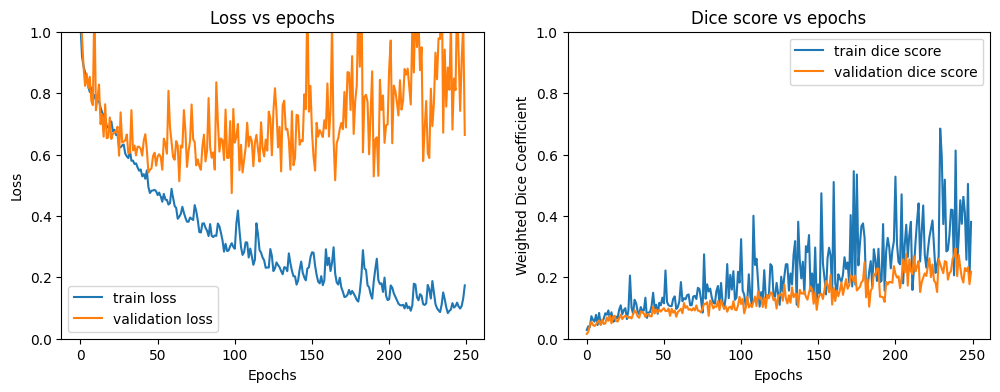

In [ ]:
# recompile model
model = AttentionUNet(out_channels=3)

# define the hyperparameters
LEARNING_RATE = 1e-4
BATCHSIZE = 32
EPOCHS = 250
NUM_WORKERS = 4

if __name__ == "__main__":

    worker_g = torch.Generator()
    worker_g.manual_seed(0)
    train_batches = DataLoader(
        train_dataset, batch_size=BATCHSIZE, shuffle=True,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )
    worker_g.manual_seed(0)
    valid_batches = DataLoader(
        valid_dataset, batch_size=BATCHSIZE, shuffle=False,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )

    # define the loss function and the optimizer
    criterion = nn.CrossEntropyLoss(weight=class_weights)
    optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

    start_time = time.time()

    # train the network
    history = run_train_loop("attnunetset1", model, train_batches, valid_batches, EPOCHS, criterion, optimizer)
    torch.save(
        {
            "epoch": 250,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "history": history,
        },
        f"{project_folder_path}models/attnunetset1_model_final.pth"
    )

    # display the total time needed to perform the training
    end_time = time.time()
    print(f"Total time taken to train the model: {(end_time - start_time):.2f}s")

    # plot the loss and accuracy history
    plot_history(history)

<i>Optional garbage collection to free up space</i>

In [ ]:
torch.cuda.empty_cache()
gc.collect()

6959

#### Set 2
loss: Weighted Cross Entropy, learning rate: 1e-5, batch size: 32, epochs: 250

100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 1/250 Train Loss: 1.1132 Validation Loss: 1.1010, Train Dice Score: 0.0266 Validation Dice Score: 0.0089


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 2/250 Train Loss: 1.0840 Validation Loss: 1.0681, Train Dice Score: 0.0212 Validation Dice Score: 0.0279


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 3/250 Train Loss: 1.0415 Validation Loss: 0.9844, Train Dice Score: 0.0258 Validation Dice Score: 0.0336


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 4/250 Train Loss: 1.0113 Validation Loss: 0.9481, Train Dice Score: 0.0321 Validation Dice Score: 0.0371


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 5/250 Train Loss: 0.9888 Validation Loss: 0.9258, Train Dice Score: 0.0399 Validation Dice Score: 0.0414


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 6/250 Train Loss: 0.9557 Validation Loss: 0.9172, Train Dice Score: 0.0408 Validation Dice Score: 0.0408


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 7/250 Train Loss: 0.9511 Validation Loss: 0.9271, Train Dice Score: 0.0483 Validation Dice Score: 0.0444


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 8/250 Train Loss: 0.9406 Validation Loss: 0.8720, Train Dice Score: 0.0407 Validation Dice Score: 0.0477


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 9/250 Train Loss: 0.9113 Validation Loss: 0.8792, Train Dice Score: 0.0453 Validation Dice Score: 0.0472


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 10/250 Train Loss: 0.9003 Validation Loss: 0.8536, Train Dice Score: 0.0866 Validation Dice Score: 0.0523


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 11/250 Train Loss: 0.8776 Validation Loss: 0.8457, Train Dice Score: 0.0531 Validation Dice Score: 0.0581


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 12/250 Train Loss: 0.8735 Validation Loss: 0.8830, Train Dice Score: 0.0365 Validation Dice Score: 0.0467


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 13/250 Train Loss: 0.8591 Validation Loss: 0.8400, Train Dice Score: 0.0616 Validation Dice Score: 0.0545


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 14/250 Train Loss: 0.8345 Validation Loss: 0.8864, Train Dice Score: 0.0870 Validation Dice Score: 0.0460


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 15/250 Train Loss: 0.8211 Validation Loss: 0.8688, Train Dice Score: 0.0821 Validation Dice Score: 0.0489


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 16/250 Train Loss: 0.7934 Validation Loss: 0.8325, Train Dice Score: 0.0583 Validation Dice Score: 0.0627


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 17/250 Train Loss: 0.7820 Validation Loss: 0.8370, Train Dice Score: 0.0681 Validation Dice Score: 0.0511


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 18/250 Train Loss: 0.7877 Validation Loss: 0.8488, Train Dice Score: 0.0412 Validation Dice Score: 0.0479


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 19/250 Train Loss: 0.7732 Validation Loss: 0.9110, Train Dice Score: 0.0496 Validation Dice Score: 0.0497


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 20/250 Train Loss: 0.7511 Validation Loss: 0.9132, Train Dice Score: 0.0495 Validation Dice Score: 0.0652


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 21/250 Train Loss: 0.7371 Validation Loss: 0.8150, Train Dice Score: 0.0449 Validation Dice Score: 0.0581


100%|██████████| 20/20 [00:08<00:00,  2.45it/s]


Epoch 22/250 Train Loss: 0.6948 Validation Loss: 0.8400, Train Dice Score: 0.0971 Validation Dice Score: 0.0544


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 23/250 Train Loss: 0.6985 Validation Loss: 0.8741, Train Dice Score: 0.1121 Validation Dice Score: 0.0626


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 24/250 Train Loss: 0.7151 Validation Loss: 0.8228, Train Dice Score: 0.0826 Validation Dice Score: 0.0654


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 25/250 Train Loss: 0.6845 Validation Loss: 0.8427, Train Dice Score: 0.0839 Validation Dice Score: 0.0642


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 26/250 Train Loss: 0.6729 Validation Loss: 0.8675, Train Dice Score: 0.0549 Validation Dice Score: 0.0576


100%|██████████| 20/20 [00:08<00:00,  2.45it/s]


Epoch 27/250 Train Loss: 0.6267 Validation Loss: 0.7912, Train Dice Score: 0.0804 Validation Dice Score: 0.0663


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 28/250 Train Loss: 0.6196 Validation Loss: 0.8344, Train Dice Score: 0.0692 Validation Dice Score: 0.0541


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 29/250 Train Loss: 0.6397 Validation Loss: 0.8251, Train Dice Score: 0.0891 Validation Dice Score: 0.0571


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 30/250 Train Loss: 0.6032 Validation Loss: 0.7397, Train Dice Score: 0.0754 Validation Dice Score: 0.0693


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 31/250 Train Loss: 0.5956 Validation Loss: 0.7843, Train Dice Score: 0.0590 Validation Dice Score: 0.0618


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 32/250 Train Loss: 0.5816 Validation Loss: 0.7779, Train Dice Score: 0.0996 Validation Dice Score: 0.0641


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 33/250 Train Loss: 0.5686 Validation Loss: 0.8048, Train Dice Score: 0.0902 Validation Dice Score: 0.0661


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 34/250 Train Loss: 0.5583 Validation Loss: 0.7857, Train Dice Score: 0.1085 Validation Dice Score: 0.0634


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 35/250 Train Loss: 0.5759 Validation Loss: 0.8478, Train Dice Score: 0.1052 Validation Dice Score: 0.0662


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 36/250 Train Loss: 0.5663 Validation Loss: 0.8079, Train Dice Score: 0.0953 Validation Dice Score: 0.0694


100%|██████████| 20/20 [00:07<00:00,  2.65it/s]


Epoch 37/250 Train Loss: 0.5625 Validation Loss: 0.8298, Train Dice Score: 0.0645 Validation Dice Score: 0.0555


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 38/250 Train Loss: 0.5523 Validation Loss: 0.7548, Train Dice Score: 0.0854 Validation Dice Score: 0.0690


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 39/250 Train Loss: 0.5415 Validation Loss: 0.7579, Train Dice Score: 0.1839 Validation Dice Score: 0.0696


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 40/250 Train Loss: 0.5177 Validation Loss: 0.7651, Train Dice Score: 0.0820 Validation Dice Score: 0.0734


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 41/250 Train Loss: 0.4985 Validation Loss: 0.7386, Train Dice Score: 0.0798 Validation Dice Score: 0.0670


100%|██████████| 20/20 [00:08<00:00,  2.43it/s]


Epoch 42/250 Train Loss: 0.5185 Validation Loss: 0.7617, Train Dice Score: 0.0640 Validation Dice Score: 0.0721


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 43/250 Train Loss: 0.4740 Validation Loss: 0.7712, Train Dice Score: 0.1000 Validation Dice Score: 0.0689


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 44/250 Train Loss: 0.4664 Validation Loss: 0.8149, Train Dice Score: 0.1430 Validation Dice Score: 0.0647


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 45/250 Train Loss: 0.4754 Validation Loss: 0.7925, Train Dice Score: 0.1202 Validation Dice Score: 0.0738


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 46/250 Train Loss: 0.4547 Validation Loss: 0.7291, Train Dice Score: 0.0969 Validation Dice Score: 0.0757


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 47/250 Train Loss: 0.4542 Validation Loss: 0.7363, Train Dice Score: 0.1124 Validation Dice Score: 0.0697


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 48/250 Train Loss: 0.4570 Validation Loss: 0.7935, Train Dice Score: 0.1041 Validation Dice Score: 0.0715


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 49/250 Train Loss: 0.4813 Validation Loss: 0.7499, Train Dice Score: 0.1401 Validation Dice Score: 0.0841


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 50/250 Train Loss: 0.4291 Validation Loss: 0.7252, Train Dice Score: 0.1192 Validation Dice Score: 0.0805


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 51/250 Train Loss: 0.4185 Validation Loss: 0.7069, Train Dice Score: 0.1506 Validation Dice Score: 0.0826


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 52/250 Train Loss: 0.4252 Validation Loss: 0.7629, Train Dice Score: 0.1046 Validation Dice Score: 0.0813


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 53/250 Train Loss: 0.4199 Validation Loss: 0.7627, Train Dice Score: 0.0887 Validation Dice Score: 0.0885


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 54/250 Train Loss: 0.4055 Validation Loss: 0.7344, Train Dice Score: 0.1703 Validation Dice Score: 0.0853


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 55/250 Train Loss: 0.4037 Validation Loss: 0.9231, Train Dice Score: 0.1631 Validation Dice Score: 0.0886


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 56/250 Train Loss: 0.4069 Validation Loss: 0.7432, Train Dice Score: 0.2298 Validation Dice Score: 0.0955


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 57/250 Train Loss: 0.3839 Validation Loss: 0.8386, Train Dice Score: 0.1287 Validation Dice Score: 0.0857


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 58/250 Train Loss: 0.3969 Validation Loss: 0.7554, Train Dice Score: 0.1057 Validation Dice Score: 0.0910


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 59/250 Train Loss: 0.3901 Validation Loss: 0.7796, Train Dice Score: 0.1958 Validation Dice Score: 0.0938


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 60/250 Train Loss: 0.3762 Validation Loss: 0.7124, Train Dice Score: 0.4087 Validation Dice Score: 0.0946


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 61/250 Train Loss: 0.3697 Validation Loss: 0.7113, Train Dice Score: 0.2205 Validation Dice Score: 0.0909


100%|██████████| 20/20 [00:08<00:00,  2.45it/s]


Epoch 62/250 Train Loss: 0.3608 Validation Loss: 0.8637, Train Dice Score: 0.1554 Validation Dice Score: 0.0853


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 63/250 Train Loss: 0.3721 Validation Loss: 0.7819, Train Dice Score: 0.1488 Validation Dice Score: 0.0919


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 64/250 Train Loss: 0.3624 Validation Loss: 0.7584, Train Dice Score: 0.1516 Validation Dice Score: 0.0993


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 65/250 Train Loss: 0.3599 Validation Loss: 0.7414, Train Dice Score: 0.1610 Validation Dice Score: 0.0981


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 66/250 Train Loss: 0.3453 Validation Loss: 0.7896, Train Dice Score: 0.2367 Validation Dice Score: 0.0978


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 67/250 Train Loss: 0.3382 Validation Loss: 0.6982, Train Dice Score: 0.2653 Validation Dice Score: 0.1103


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 68/250 Train Loss: 0.3352 Validation Loss: 0.7010, Train Dice Score: 0.1382 Validation Dice Score: 0.1035


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 69/250 Train Loss: 0.3344 Validation Loss: 0.7503, Train Dice Score: 0.1114 Validation Dice Score: 0.0980


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 70/250 Train Loss: 0.3221 Validation Loss: 0.7548, Train Dice Score: 0.3429 Validation Dice Score: 0.1027


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 71/250 Train Loss: 0.3292 Validation Loss: 0.8524, Train Dice Score: 0.2206 Validation Dice Score: 0.1055


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 72/250 Train Loss: 0.3281 Validation Loss: 0.7715, Train Dice Score: 0.1926 Validation Dice Score: 0.1266


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 73/250 Train Loss: 0.3166 Validation Loss: 0.7966, Train Dice Score: 0.1568 Validation Dice Score: 0.1076


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 74/250 Train Loss: 0.3249 Validation Loss: 0.9912, Train Dice Score: 0.2989 Validation Dice Score: 0.1001


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 75/250 Train Loss: 0.3033 Validation Loss: 0.8016, Train Dice Score: 0.5488 Validation Dice Score: 0.1148


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 76/250 Train Loss: 0.3066 Validation Loss: 0.7749, Train Dice Score: 0.5762 Validation Dice Score: 0.1198


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 77/250 Train Loss: 0.3085 Validation Loss: 0.7838, Train Dice Score: 0.2082 Validation Dice Score: 0.1204


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 78/250 Train Loss: 0.3005 Validation Loss: 0.7448, Train Dice Score: 0.2911 Validation Dice Score: 0.1260


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 79/250 Train Loss: 0.2995 Validation Loss: 0.8115, Train Dice Score: 0.1306 Validation Dice Score: 0.1062


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 80/250 Train Loss: 0.2934 Validation Loss: 0.7970, Train Dice Score: 0.2054 Validation Dice Score: 0.0912


100%|██████████| 20/20 [00:08<00:00,  2.44it/s]


Epoch 81/250 Train Loss: 0.2873 Validation Loss: 0.7915, Train Dice Score: 0.2190 Validation Dice Score: 0.1087


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 82/250 Train Loss: 0.2911 Validation Loss: 0.7667, Train Dice Score: 0.1779 Validation Dice Score: 0.1025


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 83/250 Train Loss: 0.3002 Validation Loss: 0.7618, Train Dice Score: 0.2617 Validation Dice Score: 0.1149


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 84/250 Train Loss: 0.2804 Validation Loss: 0.7550, Train Dice Score: 0.1803 Validation Dice Score: 0.1342


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 85/250 Train Loss: 0.2776 Validation Loss: 0.7396, Train Dice Score: 0.3037 Validation Dice Score: 0.1152


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 86/250 Train Loss: 0.2726 Validation Loss: 0.8472, Train Dice Score: 0.3609 Validation Dice Score: 0.1292


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 87/250 Train Loss: 0.2698 Validation Loss: 0.7886, Train Dice Score: 0.4039 Validation Dice Score: 0.1535


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 88/250 Train Loss: 0.3197 Validation Loss: 0.7700, Train Dice Score: 0.1610 Validation Dice Score: 0.1038


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 89/250 Train Loss: 0.2832 Validation Loss: 0.8255, Train Dice Score: 0.3130 Validation Dice Score: 0.0989


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 90/250 Train Loss: 0.2682 Validation Loss: 0.8171, Train Dice Score: 0.2775 Validation Dice Score: 0.0980


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 91/250 Train Loss: 0.2630 Validation Loss: 0.8348, Train Dice Score: 0.3640 Validation Dice Score: 0.1050


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 92/250 Train Loss: 0.2718 Validation Loss: 0.7668, Train Dice Score: 0.2623 Validation Dice Score: 0.1048


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 93/250 Train Loss: 0.2680 Validation Loss: 0.8200, Train Dice Score: 0.3583 Validation Dice Score: 0.1326


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 94/250 Train Loss: 0.2627 Validation Loss: 0.8589, Train Dice Score: 0.1865 Validation Dice Score: 0.1067


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 95/250 Train Loss: 0.2526 Validation Loss: 0.7821, Train Dice Score: 0.2081 Validation Dice Score: 0.1306


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 96/250 Train Loss: 0.2624 Validation Loss: 0.8428, Train Dice Score: 0.3592 Validation Dice Score: 0.1389


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 97/250 Train Loss: 0.2471 Validation Loss: 0.7474, Train Dice Score: 0.3239 Validation Dice Score: 0.1176


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 98/250 Train Loss: 0.2417 Validation Loss: 0.7956, Train Dice Score: 0.3771 Validation Dice Score: 0.1394


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 99/250 Train Loss: 0.2383 Validation Loss: 0.9702, Train Dice Score: 0.2821 Validation Dice Score: 0.1136


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 100/250 Train Loss: 0.2467 Validation Loss: 0.8828, Train Dice Score: 0.3886 Validation Dice Score: 0.1129


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 101/250 Train Loss: 0.2398 Validation Loss: 0.8906, Train Dice Score: 0.4027 Validation Dice Score: 0.0997


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 102/250 Train Loss: 0.2449 Validation Loss: 0.7739, Train Dice Score: 0.3312 Validation Dice Score: 0.1494


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 103/250 Train Loss: 0.2415 Validation Loss: 0.7760, Train Dice Score: 0.3283 Validation Dice Score: 0.1435


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 104/250 Train Loss: 0.2306 Validation Loss: 0.8891, Train Dice Score: 0.2502 Validation Dice Score: 0.1192


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 105/250 Train Loss: 0.2349 Validation Loss: 0.9695, Train Dice Score: 0.3708 Validation Dice Score: 0.1239


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 106/250 Train Loss: 0.2333 Validation Loss: 0.7879, Train Dice Score: 0.2146 Validation Dice Score: 0.1225


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 107/250 Train Loss: 0.2323 Validation Loss: 0.9240, Train Dice Score: 0.3737 Validation Dice Score: 0.1330


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 108/250 Train Loss: 0.2241 Validation Loss: 0.8468, Train Dice Score: 0.7294 Validation Dice Score: 0.1355


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 109/250 Train Loss: 0.2227 Validation Loss: 0.8979, Train Dice Score: 0.1494 Validation Dice Score: 0.1400


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 110/250 Train Loss: 0.2266 Validation Loss: 0.9161, Train Dice Score: 0.3661 Validation Dice Score: 0.1448


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 111/250 Train Loss: 0.2234 Validation Loss: 0.8777, Train Dice Score: 0.2387 Validation Dice Score: 0.1247


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 112/250 Train Loss: 0.2257 Validation Loss: 0.8135, Train Dice Score: 0.3444 Validation Dice Score: 0.1190


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 113/250 Train Loss: 0.2278 Validation Loss: 0.8930, Train Dice Score: 0.2513 Validation Dice Score: 0.1371


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 114/250 Train Loss: 0.2232 Validation Loss: 0.8121, Train Dice Score: 0.2610 Validation Dice Score: 0.1226


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 115/250 Train Loss: 0.2127 Validation Loss: 0.8742, Train Dice Score: 0.4797 Validation Dice Score: 0.1393


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 116/250 Train Loss: 0.2145 Validation Loss: 0.7891, Train Dice Score: 0.6289 Validation Dice Score: 0.1473


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 117/250 Train Loss: 0.2061 Validation Loss: 0.8031, Train Dice Score: 0.4926 Validation Dice Score: 0.1248


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 118/250 Train Loss: 0.2131 Validation Loss: 0.9234, Train Dice Score: 0.3123 Validation Dice Score: 0.1437


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 119/250 Train Loss: 0.2275 Validation Loss: 0.7992, Train Dice Score: 0.2058 Validation Dice Score: 0.1177


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 120/250 Train Loss: 0.2166 Validation Loss: 0.8504, Train Dice Score: 0.2720 Validation Dice Score: 0.1365


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 121/250 Train Loss: 0.2171 Validation Loss: 0.8779, Train Dice Score: 0.3612 Validation Dice Score: 0.1365


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 122/250 Train Loss: 0.2069 Validation Loss: 0.8673, Train Dice Score: 0.6833 Validation Dice Score: 0.1350


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 123/250 Train Loss: 0.2016 Validation Loss: 0.8717, Train Dice Score: 0.3896 Validation Dice Score: 0.1452


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 124/250 Train Loss: 0.2017 Validation Loss: 0.8080, Train Dice Score: 0.4308 Validation Dice Score: 0.1483


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 125/250 Train Loss: 0.1938 Validation Loss: 0.8561, Train Dice Score: 0.4771 Validation Dice Score: 0.1554


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 126/250 Train Loss: 0.1945 Validation Loss: 0.8570, Train Dice Score: 0.3061 Validation Dice Score: 0.1441


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 127/250 Train Loss: 0.1942 Validation Loss: 0.8426, Train Dice Score: 0.2452 Validation Dice Score: 0.1664


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 128/250 Train Loss: 0.1909 Validation Loss: 0.8408, Train Dice Score: 0.4743 Validation Dice Score: 0.1593


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 129/250 Train Loss: 0.1945 Validation Loss: 1.0298, Train Dice Score: 0.2112 Validation Dice Score: 0.1305


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 130/250 Train Loss: 0.1955 Validation Loss: 0.8022, Train Dice Score: 0.3930 Validation Dice Score: 0.1383


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 131/250 Train Loss: 0.1924 Validation Loss: 0.7613, Train Dice Score: 0.3421 Validation Dice Score: 0.1404


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 132/250 Train Loss: 0.1908 Validation Loss: 0.8309, Train Dice Score: 0.5256 Validation Dice Score: 0.1988


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 133/250 Train Loss: 0.1864 Validation Loss: 0.8408, Train Dice Score: 0.3198 Validation Dice Score: 0.1375


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 134/250 Train Loss: 0.1834 Validation Loss: 0.8882, Train Dice Score: 0.3408 Validation Dice Score: 0.1833


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 135/250 Train Loss: 0.1840 Validation Loss: 0.8981, Train Dice Score: 0.4550 Validation Dice Score: 0.1435


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 136/250 Train Loss: 0.2040 Validation Loss: 0.8891, Train Dice Score: 0.3678 Validation Dice Score: 0.1526


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 137/250 Train Loss: 0.2025 Validation Loss: 0.8378, Train Dice Score: 0.2965 Validation Dice Score: 0.1211


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 138/250 Train Loss: 0.2058 Validation Loss: 0.9177, Train Dice Score: 0.2616 Validation Dice Score: 0.1993


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 139/250 Train Loss: 0.2077 Validation Loss: 0.8910, Train Dice Score: 0.2834 Validation Dice Score: 0.1342


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 140/250 Train Loss: 0.1908 Validation Loss: 0.8623, Train Dice Score: 0.3508 Validation Dice Score: 0.1792


100%|██████████| 20/20 [00:08<00:00,  2.33it/s]


Epoch 141/250 Train Loss: 0.1807 Validation Loss: 0.7799, Train Dice Score: 0.4257 Validation Dice Score: 0.1231


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 142/250 Train Loss: 0.1980 Validation Loss: 0.8325, Train Dice Score: 0.2974 Validation Dice Score: 0.1373


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 143/250 Train Loss: 0.1868 Validation Loss: 0.7975, Train Dice Score: 0.2725 Validation Dice Score: 0.1344


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 144/250 Train Loss: 0.1846 Validation Loss: 0.8364, Train Dice Score: 0.3458 Validation Dice Score: 0.1436


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 145/250 Train Loss: 0.1841 Validation Loss: 0.8908, Train Dice Score: 0.3800 Validation Dice Score: 0.1544


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 146/250 Train Loss: 0.1770 Validation Loss: 0.9365, Train Dice Score: 0.5205 Validation Dice Score: 0.1504


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 147/250 Train Loss: 0.2038 Validation Loss: 0.9709, Train Dice Score: 0.4150 Validation Dice Score: 0.1408


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 148/250 Train Loss: 0.2088 Validation Loss: 0.9983, Train Dice Score: 0.4086 Validation Dice Score: 0.1242


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 149/250 Train Loss: 0.1928 Validation Loss: 0.8798, Train Dice Score: 0.3353 Validation Dice Score: 0.2030


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 150/250 Train Loss: 0.1768 Validation Loss: 0.8388, Train Dice Score: 0.6202 Validation Dice Score: 0.1946


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 151/250 Train Loss: 0.1728 Validation Loss: 0.9044, Train Dice Score: 0.5650 Validation Dice Score: 0.1690


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 152/250 Train Loss: 0.1746 Validation Loss: 0.8049, Train Dice Score: 0.4064 Validation Dice Score: 0.1388


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 153/250 Train Loss: 0.1770 Validation Loss: 0.8661, Train Dice Score: 0.2407 Validation Dice Score: 0.1491


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 154/250 Train Loss: 0.1647 Validation Loss: 0.9005, Train Dice Score: 0.4848 Validation Dice Score: 0.1668


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 155/250 Train Loss: 0.1674 Validation Loss: 0.8562, Train Dice Score: 0.4766 Validation Dice Score: 0.1799


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 156/250 Train Loss: 0.1640 Validation Loss: 0.9158, Train Dice Score: 0.3922 Validation Dice Score: 0.1620


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 157/250 Train Loss: 0.1604 Validation Loss: 0.8991, Train Dice Score: 0.5645 Validation Dice Score: 0.1533


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 158/250 Train Loss: 0.1600 Validation Loss: 0.7974, Train Dice Score: 0.6775 Validation Dice Score: 0.1506


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 159/250 Train Loss: 0.1595 Validation Loss: 0.8705, Train Dice Score: 0.6681 Validation Dice Score: 0.1252


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 160/250 Train Loss: 0.1575 Validation Loss: 0.9589, Train Dice Score: 0.5098 Validation Dice Score: 0.1376


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 161/250 Train Loss: 0.1608 Validation Loss: 0.8555, Train Dice Score: 0.3796 Validation Dice Score: 0.1331


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 162/250 Train Loss: 0.1627 Validation Loss: 0.9986, Train Dice Score: 0.4804 Validation Dice Score: 0.1771


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 163/250 Train Loss: 0.1603 Validation Loss: 0.9113, Train Dice Score: 0.4729 Validation Dice Score: 0.1415


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 164/250 Train Loss: 0.1608 Validation Loss: 0.8453, Train Dice Score: 0.6070 Validation Dice Score: 0.1386


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 165/250 Train Loss: 0.1671 Validation Loss: 0.8878, Train Dice Score: 0.4136 Validation Dice Score: 0.1645


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 166/250 Train Loss: 0.1583 Validation Loss: 0.8750, Train Dice Score: 0.5884 Validation Dice Score: 0.1532


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 167/250 Train Loss: 0.1550 Validation Loss: 0.8860, Train Dice Score: 0.3863 Validation Dice Score: 0.1619


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 168/250 Train Loss: 0.1522 Validation Loss: 0.9512, Train Dice Score: 0.4935 Validation Dice Score: 0.1504


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 169/250 Train Loss: 0.1554 Validation Loss: 0.8702, Train Dice Score: 0.5243 Validation Dice Score: 0.1714


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 170/250 Train Loss: 0.1499 Validation Loss: 0.8764, Train Dice Score: 0.3441 Validation Dice Score: 0.1881


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 171/250 Train Loss: 0.1463 Validation Loss: 0.8847, Train Dice Score: 0.4873 Validation Dice Score: 0.1722


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 172/250 Train Loss: 0.1442 Validation Loss: 1.0139, Train Dice Score: 0.4703 Validation Dice Score: 0.1650


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 173/250 Train Loss: 0.1457 Validation Loss: 0.9760, Train Dice Score: 0.5856 Validation Dice Score: 0.2062


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 174/250 Train Loss: 0.1435 Validation Loss: 0.9345, Train Dice Score: 0.4027 Validation Dice Score: 0.1801


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 175/250 Train Loss: 0.1411 Validation Loss: 0.8859, Train Dice Score: 0.2196 Validation Dice Score: 0.1687


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 176/250 Train Loss: 0.1407 Validation Loss: 0.9950, Train Dice Score: 0.5089 Validation Dice Score: 0.2059


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 177/250 Train Loss: 0.1410 Validation Loss: 0.9541, Train Dice Score: 0.4427 Validation Dice Score: 0.2010


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 178/250 Train Loss: 0.1445 Validation Loss: 1.0819, Train Dice Score: 0.2546 Validation Dice Score: 0.1183


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 179/250 Train Loss: 0.1439 Validation Loss: 0.9207, Train Dice Score: 0.4347 Validation Dice Score: 0.1705


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 180/250 Train Loss: 0.1438 Validation Loss: 0.9880, Train Dice Score: 0.6287 Validation Dice Score: 0.1698


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 181/250 Train Loss: 0.1391 Validation Loss: 0.9617, Train Dice Score: 0.5864 Validation Dice Score: 0.1814


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 182/250 Train Loss: 0.1389 Validation Loss: 1.0304, Train Dice Score: 0.5473 Validation Dice Score: 0.1952


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 183/250 Train Loss: 0.1425 Validation Loss: 0.9686, Train Dice Score: 0.3714 Validation Dice Score: 0.1547


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 184/250 Train Loss: 0.1398 Validation Loss: 0.9697, Train Dice Score: 0.6901 Validation Dice Score: 0.2042


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 185/250 Train Loss: 0.1406 Validation Loss: 0.9499, Train Dice Score: 0.2864 Validation Dice Score: 0.1589


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 186/250 Train Loss: 0.1347 Validation Loss: 1.0565, Train Dice Score: 0.6874 Validation Dice Score: 0.1501


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 187/250 Train Loss: 0.1363 Validation Loss: 0.9876, Train Dice Score: 0.5893 Validation Dice Score: 0.1923


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 188/250 Train Loss: 0.1351 Validation Loss: 1.0748, Train Dice Score: 0.2774 Validation Dice Score: 0.1617


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 189/250 Train Loss: 0.1355 Validation Loss: 1.0228, Train Dice Score: 0.5774 Validation Dice Score: 0.1335


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 190/250 Train Loss: 0.1296 Validation Loss: 1.0583, Train Dice Score: 0.6634 Validation Dice Score: 0.1734


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 191/250 Train Loss: 0.1280 Validation Loss: 0.9996, Train Dice Score: 0.6243 Validation Dice Score: 0.1736


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 192/250 Train Loss: 0.1258 Validation Loss: 1.1147, Train Dice Score: 0.4844 Validation Dice Score: 0.1557


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 193/250 Train Loss: 0.1407 Validation Loss: 1.0773, Train Dice Score: 0.4686 Validation Dice Score: 0.1511


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 194/250 Train Loss: 0.1384 Validation Loss: 1.0722, Train Dice Score: 0.3064 Validation Dice Score: 0.1423


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 195/250 Train Loss: 0.1305 Validation Loss: 0.9727, Train Dice Score: 0.5790 Validation Dice Score: 0.1749


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 196/250 Train Loss: 0.1234 Validation Loss: 1.0180, Train Dice Score: 0.4894 Validation Dice Score: 0.2263


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 197/250 Train Loss: 0.1368 Validation Loss: 0.9290, Train Dice Score: 0.3342 Validation Dice Score: 0.1085


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 198/250 Train Loss: 0.1738 Validation Loss: 1.1274, Train Dice Score: 0.2396 Validation Dice Score: 0.1136


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 199/250 Train Loss: 0.1603 Validation Loss: 0.8978, Train Dice Score: 0.3954 Validation Dice Score: 0.1469


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 200/250 Train Loss: 0.1419 Validation Loss: 0.9602, Train Dice Score: 0.3818 Validation Dice Score: 0.1689


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 201/250 Train Loss: 0.1349 Validation Loss: 0.9181, Train Dice Score: 0.3400 Validation Dice Score: 0.1626


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 202/250 Train Loss: 0.1320 Validation Loss: 0.9321, Train Dice Score: 0.5034 Validation Dice Score: 0.1886


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 203/250 Train Loss: 0.1253 Validation Loss: 0.9696, Train Dice Score: 0.5491 Validation Dice Score: 0.1801


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 204/250 Train Loss: 0.1228 Validation Loss: 0.8887, Train Dice Score: 0.4491 Validation Dice Score: 0.1665


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 205/250 Train Loss: 0.1231 Validation Loss: 0.9816, Train Dice Score: 0.2757 Validation Dice Score: 0.1838


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 206/250 Train Loss: 0.1208 Validation Loss: 1.1001, Train Dice Score: 0.3443 Validation Dice Score: 0.2199


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 207/250 Train Loss: 0.1222 Validation Loss: 0.9637, Train Dice Score: 0.5528 Validation Dice Score: 0.1845


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 208/250 Train Loss: 0.1310 Validation Loss: 1.0462, Train Dice Score: 0.3048 Validation Dice Score: 0.1292


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 209/250 Train Loss: 0.1271 Validation Loss: 0.9260, Train Dice Score: 0.5358 Validation Dice Score: 0.1408


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 210/250 Train Loss: 0.1332 Validation Loss: 0.9912, Train Dice Score: 0.2539 Validation Dice Score: 0.1379


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 211/250 Train Loss: 0.1251 Validation Loss: 1.0061, Train Dice Score: 0.4838 Validation Dice Score: 0.1800


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 212/250 Train Loss: 0.1204 Validation Loss: 1.0136, Train Dice Score: 0.6472 Validation Dice Score: 0.2187


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 213/250 Train Loss: 0.1196 Validation Loss: 1.0034, Train Dice Score: 0.6246 Validation Dice Score: 0.1997


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 214/250 Train Loss: 0.1169 Validation Loss: 1.0266, Train Dice Score: 0.6206 Validation Dice Score: 0.1659


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 215/250 Train Loss: 0.1164 Validation Loss: 1.0418, Train Dice Score: 0.6135 Validation Dice Score: 0.1850


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 216/250 Train Loss: 0.1131 Validation Loss: 0.9889, Train Dice Score: 0.6287 Validation Dice Score: 0.1619


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 217/250 Train Loss: 0.1155 Validation Loss: 1.0928, Train Dice Score: 0.5210 Validation Dice Score: 0.2147


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 218/250 Train Loss: 0.1151 Validation Loss: 0.9799, Train Dice Score: 0.5347 Validation Dice Score: 0.1512


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 219/250 Train Loss: 0.1121 Validation Loss: 1.0390, Train Dice Score: 0.6474 Validation Dice Score: 0.1983


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 220/250 Train Loss: 0.1152 Validation Loss: 1.0906, Train Dice Score: 0.4591 Validation Dice Score: 0.1919


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 221/250 Train Loss: 0.1101 Validation Loss: 1.0553, Train Dice Score: 0.4464 Validation Dice Score: 0.2290


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 222/250 Train Loss: 0.1094 Validation Loss: 1.0708, Train Dice Score: 0.4016 Validation Dice Score: 0.1787


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 223/250 Train Loss: 0.1075 Validation Loss: 1.1474, Train Dice Score: 0.4356 Validation Dice Score: 0.2063


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 224/250 Train Loss: 0.1073 Validation Loss: 1.0591, Train Dice Score: 0.8093 Validation Dice Score: 0.2851


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 225/250 Train Loss: 0.1067 Validation Loss: 1.0877, Train Dice Score: 0.3288 Validation Dice Score: 0.1811


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 226/250 Train Loss: 0.1082 Validation Loss: 1.0500, Train Dice Score: 0.6957 Validation Dice Score: 0.2592


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 227/250 Train Loss: 0.1068 Validation Loss: 1.0382, Train Dice Score: 0.6336 Validation Dice Score: 0.2331


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 228/250 Train Loss: 0.1046 Validation Loss: 1.0078, Train Dice Score: 0.4455 Validation Dice Score: 0.2712


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 229/250 Train Loss: 0.1038 Validation Loss: 1.0091, Train Dice Score: 0.6553 Validation Dice Score: 0.2474


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 230/250 Train Loss: 0.1048 Validation Loss: 1.0470, Train Dice Score: 0.5598 Validation Dice Score: 0.2613


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 231/250 Train Loss: 0.1015 Validation Loss: 1.1438, Train Dice Score: 0.5984 Validation Dice Score: 0.2302


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 232/250 Train Loss: 0.1008 Validation Loss: 1.1034, Train Dice Score: 0.3829 Validation Dice Score: 0.2375


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 233/250 Train Loss: 0.1039 Validation Loss: 1.0183, Train Dice Score: 0.5467 Validation Dice Score: 0.1905


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 234/250 Train Loss: 0.1034 Validation Loss: 1.2239, Train Dice Score: 0.3960 Validation Dice Score: 0.1561


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 235/250 Train Loss: 0.1037 Validation Loss: 1.1402, Train Dice Score: 0.6454 Validation Dice Score: 0.2138


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 236/250 Train Loss: 0.1024 Validation Loss: 1.1273, Train Dice Score: 0.5534 Validation Dice Score: 0.2168


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 237/250 Train Loss: 0.0983 Validation Loss: 1.0981, Train Dice Score: 0.3979 Validation Dice Score: 0.1766


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 238/250 Train Loss: 0.1026 Validation Loss: 1.1467, Train Dice Score: 0.7117 Validation Dice Score: 0.2510


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 239/250 Train Loss: 0.1045 Validation Loss: 1.1491, Train Dice Score: 0.7318 Validation Dice Score: 0.1844


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 240/250 Train Loss: 0.1048 Validation Loss: 1.0308, Train Dice Score: 0.5198 Validation Dice Score: 0.1611


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 241/250 Train Loss: 0.0974 Validation Loss: 1.0896, Train Dice Score: 0.5416 Validation Dice Score: 0.2358


100%|██████████| 20/20 [00:08<00:00,  2.45it/s]


Epoch 242/250 Train Loss: 0.1020 Validation Loss: 0.9245, Train Dice Score: 0.6413 Validation Dice Score: 0.1765


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 243/250 Train Loss: 0.1002 Validation Loss: 1.1553, Train Dice Score: 0.4698 Validation Dice Score: 0.1998


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 244/250 Train Loss: 0.1031 Validation Loss: 1.0000, Train Dice Score: 0.4834 Validation Dice Score: 0.1590


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 245/250 Train Loss: 0.1029 Validation Loss: 1.0865, Train Dice Score: 0.6744 Validation Dice Score: 0.1739


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 246/250 Train Loss: 0.0960 Validation Loss: 1.1207, Train Dice Score: 0.5982 Validation Dice Score: 0.1574


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 247/250 Train Loss: 0.0968 Validation Loss: 1.1072, Train Dice Score: 0.5660 Validation Dice Score: 0.2320


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 248/250 Train Loss: 0.1021 Validation Loss: 1.1675, Train Dice Score: 0.6532 Validation Dice Score: 0.2555


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 249/250 Train Loss: 0.0954 Validation Loss: 1.0636, Train Dice Score: 0.6570 Validation Dice Score: 0.2294


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 250/250 Train Loss: 0.0995 Validation Loss: 1.1308, Train Dice Score: 0.3839 Validation Dice Score: 0.1779
Total time taken to train the model: 2714.91s


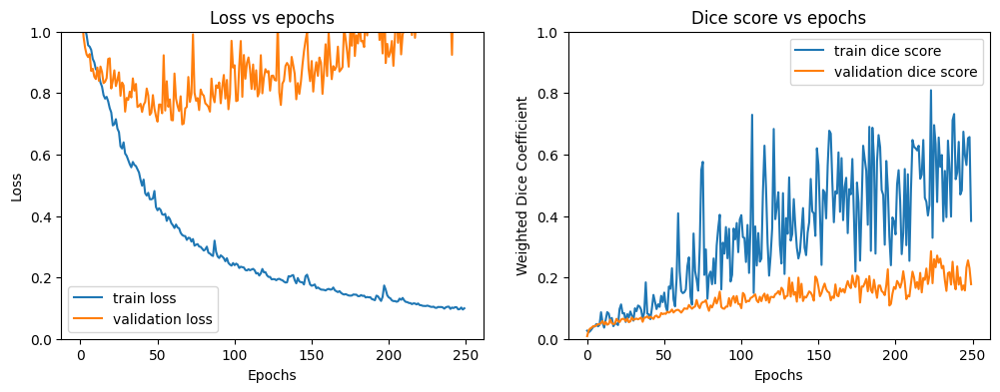

In [ ]:
# recompile model
model = AttentionUNet(out_channels=3)

# define the hyperparameters
LEARNING_RATE = 1e-5
BATCHSIZE = 32
EPOCHS = 250
NUM_WORKERS = 4

if __name__ == "__main__":

    worker_g = torch.Generator()
    worker_g.manual_seed(0)
    train_batches = DataLoader(
        train_dataset, batch_size=BATCHSIZE, shuffle=True,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )
    worker_g.manual_seed(0)
    valid_batches = DataLoader(
        valid_dataset, batch_size=BATCHSIZE, shuffle=False,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )

    # define the loss function and the optimizer
    criterion = nn.CrossEntropyLoss(weight=class_weights)
    optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

    start_time = time.time()

    # train the network

    history = run_train_loop("attnunetset2", model, train_batches, valid_batches, EPOCHS, criterion, optimizer)
    torch.save(
        {
            "epoch": 250,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "history": history,
        },
        f"{project_folder_path}models/attnunetset2_model_final.pth"
    )

    # display the total time needed to perform the training
    end_time = time.time()
    print(f"Total time taken to train the model: {(end_time - start_time):.2f}s")

    # plot the loss and accuracy history
    plot_history(history)

<i>Optional garbage collection to free up space</i>

In [ ]:
torch.cuda.empty_cache()
gc.collect()

6959

#### Set 3
loss: Dice Loss, learning rate: 1e-4, batch size: 32, epochs: 250

100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 1/250 Train Loss: 0.7670 Validation Loss: 0.7683, Train Dice Score: 0.0582 Validation Dice Score: 0.0057


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 2/250 Train Loss: 0.7139 Validation Loss: 0.7329, Train Dice Score: 0.0611 Validation Dice Score: 0.0372


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 3/250 Train Loss: 0.6892 Validation Loss: 0.7217, Train Dice Score: 0.0684 Validation Dice Score: 0.0337


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 4/250 Train Loss: 0.6743 Validation Loss: 0.6728, Train Dice Score: 0.0798 Validation Dice Score: 0.0720


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 5/250 Train Loss: 0.6644 Validation Loss: 0.6775, Train Dice Score: 0.0820 Validation Dice Score: 0.0588


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 6/250 Train Loss: 0.6531 Validation Loss: 0.6579, Train Dice Score: 0.0713 Validation Dice Score: 0.0591


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 7/250 Train Loss: 0.6411 Validation Loss: 0.6318, Train Dice Score: 0.0539 Validation Dice Score: 0.0604


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 8/250 Train Loss: 0.6291 Validation Loss: 0.6505, Train Dice Score: 0.0852 Validation Dice Score: 0.0551


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 9/250 Train Loss: 0.6227 Validation Loss: 0.6257, Train Dice Score: 0.0943 Validation Dice Score: 0.0610


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 10/250 Train Loss: 0.6117 Validation Loss: 0.6214, Train Dice Score: 0.0910 Validation Dice Score: 0.0597


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 11/250 Train Loss: 0.6032 Validation Loss: 0.6122, Train Dice Score: 0.0736 Validation Dice Score: 0.0608


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 12/250 Train Loss: 0.5952 Validation Loss: 0.6008, Train Dice Score: 0.0864 Validation Dice Score: 0.0637


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 13/250 Train Loss: 0.5868 Validation Loss: 0.5929, Train Dice Score: 0.0969 Validation Dice Score: 0.0720


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 14/250 Train Loss: 0.5775 Validation Loss: 0.5853, Train Dice Score: 0.0731 Validation Dice Score: 0.0664


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 15/250 Train Loss: 0.5703 Validation Loss: 0.5841, Train Dice Score: 0.0767 Validation Dice Score: 0.0589


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 16/250 Train Loss: 0.5612 Validation Loss: 0.5803, Train Dice Score: 0.0865 Validation Dice Score: 0.0644


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 17/250 Train Loss: 0.5507 Validation Loss: 0.5580, Train Dice Score: 0.0967 Validation Dice Score: 0.0743


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 18/250 Train Loss: 0.5436 Validation Loss: 0.5571, Train Dice Score: 0.0738 Validation Dice Score: 0.0745


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 19/250 Train Loss: 0.5360 Validation Loss: 0.5463, Train Dice Score: 0.0953 Validation Dice Score: 0.0804


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 20/250 Train Loss: 0.5246 Validation Loss: 0.5416, Train Dice Score: 0.0983 Validation Dice Score: 0.0810


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 21/250 Train Loss: 0.5216 Validation Loss: 0.5254, Train Dice Score: 0.0922 Validation Dice Score: 0.0807


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 22/250 Train Loss: 0.5135 Validation Loss: 0.5633, Train Dice Score: 0.0846 Validation Dice Score: 0.0608


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 23/250 Train Loss: 0.5052 Validation Loss: 0.5541, Train Dice Score: 0.0892 Validation Dice Score: 0.0735


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 24/250 Train Loss: 0.4991 Validation Loss: 0.5299, Train Dice Score: 0.1080 Validation Dice Score: 0.0807


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 25/250 Train Loss: 0.4952 Validation Loss: 0.5144, Train Dice Score: 0.1043 Validation Dice Score: 0.0967


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 26/250 Train Loss: 0.4885 Validation Loss: 0.4967, Train Dice Score: 0.1159 Validation Dice Score: 0.1100


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 27/250 Train Loss: 0.4799 Validation Loss: 0.4901, Train Dice Score: 0.1510 Validation Dice Score: 0.1108


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 28/250 Train Loss: 0.4686 Validation Loss: 0.4826, Train Dice Score: 0.3295 Validation Dice Score: 0.2285


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 29/250 Train Loss: 0.4637 Validation Loss: 0.5185, Train Dice Score: 0.2177 Validation Dice Score: 0.1313


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 30/250 Train Loss: 0.4570 Validation Loss: 0.4563, Train Dice Score: 0.2814 Validation Dice Score: 0.2801


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 31/250 Train Loss: 0.4577 Validation Loss: 0.4543, Train Dice Score: 0.1810 Validation Dice Score: 0.2210


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 32/250 Train Loss: 0.4455 Validation Loss: 0.4566, Train Dice Score: 0.3612 Validation Dice Score: 0.2702


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 33/250 Train Loss: 0.4338 Validation Loss: 0.4353, Train Dice Score: 0.2705 Validation Dice Score: 0.3318


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 34/250 Train Loss: 0.4332 Validation Loss: 0.4316, Train Dice Score: 0.2942 Validation Dice Score: 0.2137


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 35/250 Train Loss: 0.4200 Validation Loss: 0.4545, Train Dice Score: 0.4195 Validation Dice Score: 0.2493


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 36/250 Train Loss: 0.4203 Validation Loss: 0.4157, Train Dice Score: 0.4398 Validation Dice Score: 0.3548


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 37/250 Train Loss: 0.4147 Validation Loss: 0.4435, Train Dice Score: 0.2904 Validation Dice Score: 0.3117


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 38/250 Train Loss: 0.4032 Validation Loss: 0.4529, Train Dice Score: 0.3996 Validation Dice Score: 0.2410


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 39/250 Train Loss: 0.4063 Validation Loss: 0.4064, Train Dice Score: 0.0944 Validation Dice Score: 0.3309


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 40/250 Train Loss: 0.3929 Validation Loss: 0.3889, Train Dice Score: 0.3974 Validation Dice Score: 0.3412


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 41/250 Train Loss: 0.3910 Validation Loss: 0.4299, Train Dice Score: 0.3552 Validation Dice Score: 0.2877


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 42/250 Train Loss: 0.3870 Validation Loss: 0.4188, Train Dice Score: 0.4015 Validation Dice Score: 0.3613


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 43/250 Train Loss: 0.3765 Validation Loss: 0.3606, Train Dice Score: 0.4418 Validation Dice Score: 0.4012


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 44/250 Train Loss: 0.3677 Validation Loss: 0.4409, Train Dice Score: 0.3193 Validation Dice Score: 0.2305


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 45/250 Train Loss: 0.3818 Validation Loss: 0.3837, Train Dice Score: 0.3146 Validation Dice Score: 0.3605


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 46/250 Train Loss: 0.3571 Validation Loss: 0.3850, Train Dice Score: 0.3425 Validation Dice Score: 0.4412


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 47/250 Train Loss: 0.3532 Validation Loss: 0.3734, Train Dice Score: 0.3743 Validation Dice Score: 0.3908


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 48/250 Train Loss: 0.3637 Validation Loss: 0.3875, Train Dice Score: 0.4072 Validation Dice Score: 0.4509


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 49/250 Train Loss: 0.3358 Validation Loss: 0.3302, Train Dice Score: 0.3965 Validation Dice Score: 0.4993


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 50/250 Train Loss: 0.3160 Validation Loss: 0.3515, Train Dice Score: 0.5111 Validation Dice Score: 0.3601


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 51/250 Train Loss: 0.3146 Validation Loss: 0.3382, Train Dice Score: 0.6209 Validation Dice Score: 0.4326


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 52/250 Train Loss: 0.3316 Validation Loss: 0.3283, Train Dice Score: 0.3909 Validation Dice Score: 0.4248


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 53/250 Train Loss: 0.3028 Validation Loss: 0.3156, Train Dice Score: 0.2122 Validation Dice Score: 0.5208


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 54/250 Train Loss: 0.2994 Validation Loss: 0.3042, Train Dice Score: 0.3033 Validation Dice Score: 0.3711


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 55/250 Train Loss: 0.2956 Validation Loss: 0.3011, Train Dice Score: 0.4119 Validation Dice Score: 0.5469


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 56/250 Train Loss: 0.2999 Validation Loss: 0.3551, Train Dice Score: 0.4576 Validation Dice Score: 0.4162


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 57/250 Train Loss: 0.2867 Validation Loss: 0.2803, Train Dice Score: 0.2684 Validation Dice Score: 0.5023


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 58/250 Train Loss: 0.2701 Validation Loss: 0.3387, Train Dice Score: 0.5723 Validation Dice Score: 0.4599


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 59/250 Train Loss: 0.2844 Validation Loss: 0.3491, Train Dice Score: 0.5497 Validation Dice Score: 0.5243


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 60/250 Train Loss: 0.2792 Validation Loss: 0.4094, Train Dice Score: 0.4017 Validation Dice Score: 0.3427


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 61/250 Train Loss: 0.2964 Validation Loss: 0.3413, Train Dice Score: 0.2771 Validation Dice Score: 0.4988


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 62/250 Train Loss: 0.2700 Validation Loss: 0.2900, Train Dice Score: 0.5861 Validation Dice Score: 0.6321


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 63/250 Train Loss: 0.2889 Validation Loss: 0.2564, Train Dice Score: 0.4030 Validation Dice Score: 0.5347


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 64/250 Train Loss: 0.2779 Validation Loss: 0.2681, Train Dice Score: 0.5214 Validation Dice Score: 0.4420


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 65/250 Train Loss: 0.2667 Validation Loss: 0.2611, Train Dice Score: 0.5700 Validation Dice Score: 0.5621


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 66/250 Train Loss: 0.2505 Validation Loss: 0.3331, Train Dice Score: 0.6015 Validation Dice Score: 0.4919


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 67/250 Train Loss: 0.2341 Validation Loss: 0.2884, Train Dice Score: 0.6527 Validation Dice Score: 0.5195


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 68/250 Train Loss: 0.2548 Validation Loss: 0.2770, Train Dice Score: 0.6162 Validation Dice Score: 0.5623


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 69/250 Train Loss: 0.2397 Validation Loss: 0.2351, Train Dice Score: 0.5699 Validation Dice Score: 0.5735


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 70/250 Train Loss: 0.2510 Validation Loss: 0.2563, Train Dice Score: 0.4263 Validation Dice Score: 0.5742


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 71/250 Train Loss: 0.2293 Validation Loss: 0.2915, Train Dice Score: 0.5532 Validation Dice Score: 0.4632


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 72/250 Train Loss: 0.2415 Validation Loss: 0.3016, Train Dice Score: 0.6221 Validation Dice Score: 0.5004


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 73/250 Train Loss: 0.2319 Validation Loss: 0.2882, Train Dice Score: 0.4648 Validation Dice Score: 0.4535


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 74/250 Train Loss: 0.2638 Validation Loss: 0.2352, Train Dice Score: 0.2282 Validation Dice Score: 0.4617


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 75/250 Train Loss: 0.2441 Validation Loss: 0.2690, Train Dice Score: 0.5355 Validation Dice Score: 0.4420


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 76/250 Train Loss: 0.2175 Validation Loss: 0.2918, Train Dice Score: 0.7383 Validation Dice Score: 0.4854


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 77/250 Train Loss: 0.2277 Validation Loss: 0.2553, Train Dice Score: 0.6401 Validation Dice Score: 0.5424


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 78/250 Train Loss: 0.2119 Validation Loss: 0.3341, Train Dice Score: 0.2559 Validation Dice Score: 0.4215


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 79/250 Train Loss: 0.2282 Validation Loss: 0.2362, Train Dice Score: 0.4660 Validation Dice Score: 0.4591


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 80/250 Train Loss: 0.2362 Validation Loss: 0.2400, Train Dice Score: 0.5810 Validation Dice Score: 0.5560


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 81/250 Train Loss: 0.2400 Validation Loss: 0.2690, Train Dice Score: 0.4625 Validation Dice Score: 0.4235


100%|██████████| 20/20 [00:08<00:00,  2.42it/s]


Epoch 82/250 Train Loss: 0.2421 Validation Loss: 0.2464, Train Dice Score: 0.6550 Validation Dice Score: 0.4998


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 83/250 Train Loss: 0.2192 Validation Loss: 0.3468, Train Dice Score: 0.3286 Validation Dice Score: 0.4438


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 84/250 Train Loss: 0.2178 Validation Loss: 0.2720, Train Dice Score: 0.5054 Validation Dice Score: 0.5044


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 85/250 Train Loss: 0.2074 Validation Loss: 0.2583, Train Dice Score: 0.3991 Validation Dice Score: 0.5803


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 86/250 Train Loss: 0.2125 Validation Loss: 0.2279, Train Dice Score: 0.7148 Validation Dice Score: 0.5221


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 87/250 Train Loss: 0.2085 Validation Loss: 0.2667, Train Dice Score: 0.1310 Validation Dice Score: 0.5607


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 88/250 Train Loss: 0.2238 Validation Loss: 0.2404, Train Dice Score: 0.6098 Validation Dice Score: 0.6259


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 89/250 Train Loss: 0.2020 Validation Loss: 0.2484, Train Dice Score: 0.7113 Validation Dice Score: 0.5578


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 90/250 Train Loss: 0.1942 Validation Loss: 0.2275, Train Dice Score: 0.8168 Validation Dice Score: 0.6016


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 91/250 Train Loss: 0.2044 Validation Loss: 0.2145, Train Dice Score: 0.3143 Validation Dice Score: 0.5349


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 92/250 Train Loss: 0.2221 Validation Loss: 0.2472, Train Dice Score: 0.5844 Validation Dice Score: 0.5510


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 93/250 Train Loss: 0.2274 Validation Loss: 0.2519, Train Dice Score: 0.6560 Validation Dice Score: 0.4442


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 94/250 Train Loss: 0.2443 Validation Loss: 0.2814, Train Dice Score: 0.5213 Validation Dice Score: 0.5507


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 95/250 Train Loss: 0.2098 Validation Loss: 0.2553, Train Dice Score: 0.4310 Validation Dice Score: 0.4706


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 96/250 Train Loss: 0.2064 Validation Loss: 0.2461, Train Dice Score: 0.6223 Validation Dice Score: 0.4579


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 97/250 Train Loss: 0.1864 Validation Loss: 0.2566, Train Dice Score: 0.6160 Validation Dice Score: 0.6153


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 98/250 Train Loss: 0.1903 Validation Loss: 0.2250, Train Dice Score: 0.5823 Validation Dice Score: 0.4821


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 99/250 Train Loss: 0.1786 Validation Loss: 0.2076, Train Dice Score: 0.4039 Validation Dice Score: 0.5190


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 100/250 Train Loss: 0.1871 Validation Loss: 0.2612, Train Dice Score: 0.4602 Validation Dice Score: 0.5225


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 101/250 Train Loss: 0.2171 Validation Loss: 0.3388, Train Dice Score: 0.7206 Validation Dice Score: 0.4335


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 102/250 Train Loss: 0.1992 Validation Loss: 0.2497, Train Dice Score: 0.6038 Validation Dice Score: 0.5841


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 103/250 Train Loss: 0.2165 Validation Loss: 0.2470, Train Dice Score: 0.5226 Validation Dice Score: 0.5196


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 104/250 Train Loss: 0.2129 Validation Loss: 0.2519, Train Dice Score: 0.4382 Validation Dice Score: 0.6265


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 105/250 Train Loss: 0.2050 Validation Loss: 0.2397, Train Dice Score: 0.6590 Validation Dice Score: 0.5843


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 106/250 Train Loss: 0.1916 Validation Loss: 0.2330, Train Dice Score: 0.6362 Validation Dice Score: 0.6026


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 107/250 Train Loss: 0.2005 Validation Loss: 0.2398, Train Dice Score: 0.7575 Validation Dice Score: 0.6025


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 108/250 Train Loss: 0.1891 Validation Loss: 0.2395, Train Dice Score: 0.7468 Validation Dice Score: 0.5405


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 109/250 Train Loss: 0.1892 Validation Loss: 0.2340, Train Dice Score: 0.7419 Validation Dice Score: 0.4990


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 110/250 Train Loss: 0.1858 Validation Loss: 0.2006, Train Dice Score: 0.7014 Validation Dice Score: 0.5977


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 111/250 Train Loss: 0.1757 Validation Loss: 0.2179, Train Dice Score: 0.4133 Validation Dice Score: 0.5406


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 112/250 Train Loss: 0.1740 Validation Loss: 0.2596, Train Dice Score: 0.8303 Validation Dice Score: 0.5279


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 113/250 Train Loss: 0.1642 Validation Loss: 0.2474, Train Dice Score: 0.8553 Validation Dice Score: 0.4813


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 114/250 Train Loss: 0.1725 Validation Loss: 0.2032, Train Dice Score: 0.7394 Validation Dice Score: 0.5837


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 115/250 Train Loss: 0.1678 Validation Loss: 0.2622, Train Dice Score: 0.6743 Validation Dice Score: 0.5984


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 116/250 Train Loss: 0.1864 Validation Loss: 0.2643, Train Dice Score: 0.8519 Validation Dice Score: 0.4985


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 117/250 Train Loss: 0.1736 Validation Loss: 0.2571, Train Dice Score: 0.3697 Validation Dice Score: 0.6178


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 118/250 Train Loss: 0.1858 Validation Loss: 0.2924, Train Dice Score: 0.5954 Validation Dice Score: 0.5454


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 119/250 Train Loss: 0.1732 Validation Loss: 0.1966, Train Dice Score: 0.5970 Validation Dice Score: 0.5176


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 120/250 Train Loss: 0.1768 Validation Loss: 0.1949, Train Dice Score: 0.4466 Validation Dice Score: 0.5832


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 121/250 Train Loss: 0.1670 Validation Loss: 0.2081, Train Dice Score: 0.7558 Validation Dice Score: 0.5492


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 122/250 Train Loss: 0.1839 Validation Loss: 0.2450, Train Dice Score: 0.5175 Validation Dice Score: 0.5740


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 123/250 Train Loss: 0.1926 Validation Loss: 0.2447, Train Dice Score: 0.5320 Validation Dice Score: 0.5045


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 124/250 Train Loss: 0.2056 Validation Loss: 0.1990, Train Dice Score: 0.3678 Validation Dice Score: 0.5651


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 125/250 Train Loss: 0.1650 Validation Loss: 0.2419, Train Dice Score: 0.7271 Validation Dice Score: 0.5480


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 126/250 Train Loss: 0.1708 Validation Loss: 0.2495, Train Dice Score: 0.7324 Validation Dice Score: 0.5398


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 127/250 Train Loss: 0.1630 Validation Loss: 0.2993, Train Dice Score: 0.8630 Validation Dice Score: 0.5285


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 128/250 Train Loss: 0.1684 Validation Loss: 0.2299, Train Dice Score: 0.7725 Validation Dice Score: 0.5081


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 129/250 Train Loss: 0.1612 Validation Loss: 0.2486, Train Dice Score: 0.6796 Validation Dice Score: 0.5505


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 130/250 Train Loss: 0.1566 Validation Loss: 0.1945, Train Dice Score: 0.8107 Validation Dice Score: 0.4799


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 131/250 Train Loss: 0.1556 Validation Loss: 0.2424, Train Dice Score: 0.7883 Validation Dice Score: 0.5844


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 132/250 Train Loss: 0.1447 Validation Loss: 0.2053, Train Dice Score: 0.8303 Validation Dice Score: 0.6039


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 133/250 Train Loss: 0.1708 Validation Loss: 0.2964, Train Dice Score: 0.6672 Validation Dice Score: 0.5889


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 134/250 Train Loss: 0.1542 Validation Loss: 0.2334, Train Dice Score: 0.8360 Validation Dice Score: 0.5153


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 135/250 Train Loss: 0.1563 Validation Loss: 0.2511, Train Dice Score: 0.8317 Validation Dice Score: 0.5145


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 136/250 Train Loss: 0.1449 Validation Loss: 0.2214, Train Dice Score: 0.7546 Validation Dice Score: 0.4982


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 137/250 Train Loss: 0.1515 Validation Loss: 0.2605, Train Dice Score: 0.5523 Validation Dice Score: 0.4551


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 138/250 Train Loss: 0.1697 Validation Loss: 0.2852, Train Dice Score: 0.6508 Validation Dice Score: 0.3922


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 139/250 Train Loss: 0.1541 Validation Loss: 0.1966, Train Dice Score: 0.8370 Validation Dice Score: 0.5786


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 140/250 Train Loss: 0.1586 Validation Loss: 0.2354, Train Dice Score: 0.6646 Validation Dice Score: 0.5409


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 141/250 Train Loss: 0.1525 Validation Loss: 0.2224, Train Dice Score: 0.7380 Validation Dice Score: 0.5342


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 142/250 Train Loss: 0.1608 Validation Loss: 0.1938, Train Dice Score: 0.7145 Validation Dice Score: 0.6235


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 143/250 Train Loss: 0.1509 Validation Loss: 0.2019, Train Dice Score: 0.7979 Validation Dice Score: 0.6062


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 144/250 Train Loss: 0.1409 Validation Loss: 0.1996, Train Dice Score: 0.5230 Validation Dice Score: 0.5568


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 145/250 Train Loss: 0.1432 Validation Loss: 0.2292, Train Dice Score: 0.8427 Validation Dice Score: 0.5700


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 146/250 Train Loss: 0.1514 Validation Loss: 0.2565, Train Dice Score: 0.7904 Validation Dice Score: 0.5765


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 147/250 Train Loss: 0.1366 Validation Loss: 0.2401, Train Dice Score: 0.7068 Validation Dice Score: 0.5895


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 148/250 Train Loss: 0.1550 Validation Loss: 0.2702, Train Dice Score: 0.8409 Validation Dice Score: 0.5593


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 149/250 Train Loss: 0.1697 Validation Loss: 0.2383, Train Dice Score: 0.2795 Validation Dice Score: 0.6093


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 150/250 Train Loss: 0.1717 Validation Loss: 0.2522, Train Dice Score: 0.6890 Validation Dice Score: 0.5067


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 151/250 Train Loss: 0.1810 Validation Loss: 0.2321, Train Dice Score: 0.8993 Validation Dice Score: 0.6430


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 152/250 Train Loss: 0.1717 Validation Loss: 0.2239, Train Dice Score: 0.6626 Validation Dice Score: 0.7112


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 153/250 Train Loss: 0.1481 Validation Loss: 0.2463, Train Dice Score: 0.7439 Validation Dice Score: 0.5959


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 154/250 Train Loss: 0.1450 Validation Loss: 0.2514, Train Dice Score: 0.8372 Validation Dice Score: 0.5266


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 155/250 Train Loss: 0.1479 Validation Loss: 0.2883, Train Dice Score: 0.6306 Validation Dice Score: 0.5555


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 156/250 Train Loss: 0.1445 Validation Loss: 0.2529, Train Dice Score: 0.7466 Validation Dice Score: 0.6177


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 157/250 Train Loss: 0.1364 Validation Loss: 0.2156, Train Dice Score: 0.3713 Validation Dice Score: 0.5941


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 158/250 Train Loss: 0.1363 Validation Loss: 0.2348, Train Dice Score: 0.7291 Validation Dice Score: 0.5283


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 159/250 Train Loss: 0.1387 Validation Loss: 0.2376, Train Dice Score: 0.8196 Validation Dice Score: 0.5504


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 160/250 Train Loss: 0.1345 Validation Loss: 0.2169, Train Dice Score: 0.5595 Validation Dice Score: 0.5448


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 161/250 Train Loss: 0.1420 Validation Loss: 0.2086, Train Dice Score: 0.5498 Validation Dice Score: 0.5516


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 162/250 Train Loss: 0.1387 Validation Loss: 0.2260, Train Dice Score: 0.4892 Validation Dice Score: 0.6358


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 163/250 Train Loss: 0.1406 Validation Loss: 0.2214, Train Dice Score: 0.7470 Validation Dice Score: 0.5525


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 164/250 Train Loss: 0.1514 Validation Loss: 0.2144, Train Dice Score: 0.7019 Validation Dice Score: 0.5667


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 165/250 Train Loss: 0.1386 Validation Loss: 0.1961, Train Dice Score: 0.8831 Validation Dice Score: 0.6108


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 166/250 Train Loss: 0.1435 Validation Loss: 0.2380, Train Dice Score: 0.8014 Validation Dice Score: 0.5250


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 167/250 Train Loss: 0.1629 Validation Loss: 0.2889, Train Dice Score: 0.7199 Validation Dice Score: 0.4898


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 168/250 Train Loss: 0.1590 Validation Loss: 0.2177, Train Dice Score: 0.4026 Validation Dice Score: 0.5563


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 169/250 Train Loss: 0.1411 Validation Loss: 0.2131, Train Dice Score: 0.8792 Validation Dice Score: 0.5720


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 170/250 Train Loss: 0.1307 Validation Loss: 0.2204, Train Dice Score: 0.4814 Validation Dice Score: 0.5104


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 171/250 Train Loss: 0.1207 Validation Loss: 0.2155, Train Dice Score: 0.5850 Validation Dice Score: 0.5915


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 172/250 Train Loss: 0.1363 Validation Loss: 0.2494, Train Dice Score: 0.6148 Validation Dice Score: 0.5266


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 173/250 Train Loss: 0.1286 Validation Loss: 0.2151, Train Dice Score: 0.7011 Validation Dice Score: 0.5353


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 174/250 Train Loss: 0.1390 Validation Loss: 0.2264, Train Dice Score: 0.7120 Validation Dice Score: 0.5973


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 175/250 Train Loss: 0.1418 Validation Loss: 0.2113, Train Dice Score: 0.7902 Validation Dice Score: 0.5837


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 176/250 Train Loss: 0.1313 Validation Loss: 0.2028, Train Dice Score: 0.8346 Validation Dice Score: 0.5429


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 177/250 Train Loss: 0.1338 Validation Loss: 0.2336, Train Dice Score: 0.7278 Validation Dice Score: 0.5127


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 178/250 Train Loss: 0.1371 Validation Loss: 0.2197, Train Dice Score: 0.5746 Validation Dice Score: 0.4826


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 179/250 Train Loss: 0.1416 Validation Loss: 0.2371, Train Dice Score: 0.6849 Validation Dice Score: 0.5377


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 180/250 Train Loss: 0.1356 Validation Loss: 0.3429, Train Dice Score: 0.8037 Validation Dice Score: 0.5091


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 181/250 Train Loss: 0.1782 Validation Loss: 0.2650, Train Dice Score: 0.7817 Validation Dice Score: 0.5033


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 182/250 Train Loss: 0.1566 Validation Loss: 0.2563, Train Dice Score: 0.7566 Validation Dice Score: 0.4993


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 183/250 Train Loss: 0.1353 Validation Loss: 0.2017, Train Dice Score: 0.9313 Validation Dice Score: 0.5770


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 184/250 Train Loss: 0.1286 Validation Loss: 0.2281, Train Dice Score: 0.9167 Validation Dice Score: 0.5795


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 185/250 Train Loss: 0.1206 Validation Loss: 0.1968, Train Dice Score: 0.8331 Validation Dice Score: 0.5500


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 186/250 Train Loss: 0.1254 Validation Loss: 0.1985, Train Dice Score: 0.7127 Validation Dice Score: 0.5008


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 187/250 Train Loss: 0.1142 Validation Loss: 0.1934, Train Dice Score: 0.8444 Validation Dice Score: 0.5814


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 188/250 Train Loss: 0.1251 Validation Loss: 0.1951, Train Dice Score: 0.6427 Validation Dice Score: 0.6051


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 189/250 Train Loss: 0.1170 Validation Loss: 0.1942, Train Dice Score: 0.7644 Validation Dice Score: 0.6360


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 190/250 Train Loss: 0.1173 Validation Loss: 0.2061, Train Dice Score: 0.8642 Validation Dice Score: 0.5708


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 191/250 Train Loss: 0.1607 Validation Loss: 0.3038, Train Dice Score: 0.6194 Validation Dice Score: 0.5826


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 192/250 Train Loss: 0.1363 Validation Loss: 0.2187, Train Dice Score: 0.5828 Validation Dice Score: 0.5990


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 193/250 Train Loss: 0.1213 Validation Loss: 0.2331, Train Dice Score: 0.8992 Validation Dice Score: 0.5958


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 194/250 Train Loss: 0.1240 Validation Loss: 0.2037, Train Dice Score: 0.8648 Validation Dice Score: 0.5647


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 195/250 Train Loss: 0.1255 Validation Loss: 0.2136, Train Dice Score: 0.8958 Validation Dice Score: 0.5614


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 196/250 Train Loss: 0.1213 Validation Loss: 0.1898, Train Dice Score: 0.8890 Validation Dice Score: 0.5883


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 197/250 Train Loss: 0.1261 Validation Loss: 0.2046, Train Dice Score: 0.8865 Validation Dice Score: 0.6629


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 198/250 Train Loss: 0.1078 Validation Loss: 0.2055, Train Dice Score: 0.8027 Validation Dice Score: 0.6748


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 199/250 Train Loss: 0.1189 Validation Loss: 0.1988, Train Dice Score: 0.6577 Validation Dice Score: 0.6553


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 200/250 Train Loss: 0.1250 Validation Loss: 0.1981, Train Dice Score: 0.5915 Validation Dice Score: 0.6459


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 201/250 Train Loss: 0.1189 Validation Loss: 0.2348, Train Dice Score: 0.7500 Validation Dice Score: 0.6282


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 202/250 Train Loss: 0.1165 Validation Loss: 0.1886, Train Dice Score: 0.9490 Validation Dice Score: 0.5363


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 203/250 Train Loss: 0.1224 Validation Loss: 0.2041, Train Dice Score: 0.8180 Validation Dice Score: 0.6051


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 204/250 Train Loss: 0.1194 Validation Loss: 0.2541, Train Dice Score: 0.5611 Validation Dice Score: 0.6861


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 205/250 Train Loss: 0.1290 Validation Loss: 0.1996, Train Dice Score: 0.8127 Validation Dice Score: 0.6952


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 206/250 Train Loss: 0.1266 Validation Loss: 0.1958, Train Dice Score: 0.8065 Validation Dice Score: 0.6107


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 207/250 Train Loss: 0.1186 Validation Loss: 0.2150, Train Dice Score: 0.8738 Validation Dice Score: 0.7059


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 208/250 Train Loss: 0.1250 Validation Loss: 0.2047, Train Dice Score: 0.8792 Validation Dice Score: 0.6795


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 209/250 Train Loss: 0.1015 Validation Loss: 0.1964, Train Dice Score: 0.3725 Validation Dice Score: 0.6858


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 210/250 Train Loss: 0.1065 Validation Loss: 0.1866, Train Dice Score: 0.8747 Validation Dice Score: 0.6908


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 211/250 Train Loss: 0.1083 Validation Loss: 0.2113, Train Dice Score: 0.8490 Validation Dice Score: 0.6276


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 212/250 Train Loss: 0.1128 Validation Loss: 0.1978, Train Dice Score: 0.9028 Validation Dice Score: 0.6272


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 213/250 Train Loss: 0.1193 Validation Loss: 0.2115, Train Dice Score: 0.8511 Validation Dice Score: 0.6541


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 214/250 Train Loss: 0.1150 Validation Loss: 0.1935, Train Dice Score: 0.9162 Validation Dice Score: 0.6979


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 215/250 Train Loss: 0.1095 Validation Loss: 0.1941, Train Dice Score: 0.8431 Validation Dice Score: 0.6513


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 216/250 Train Loss: 0.1193 Validation Loss: 0.2037, Train Dice Score: 0.9103 Validation Dice Score: 0.5784


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 217/250 Train Loss: 0.1140 Validation Loss: 0.2011, Train Dice Score: 0.8825 Validation Dice Score: 0.5192


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 218/250 Train Loss: 0.1320 Validation Loss: 0.2214, Train Dice Score: 0.4621 Validation Dice Score: 0.7531


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 219/250 Train Loss: 0.1198 Validation Loss: 0.2054, Train Dice Score: 0.8111 Validation Dice Score: 0.6177


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 220/250 Train Loss: 0.1085 Validation Loss: 0.2121, Train Dice Score: 0.6562 Validation Dice Score: 0.6685


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 221/250 Train Loss: 0.1140 Validation Loss: 0.2083, Train Dice Score: 0.2926 Validation Dice Score: 0.7223


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 222/250 Train Loss: 0.1165 Validation Loss: 0.1940, Train Dice Score: 0.8977 Validation Dice Score: 0.6446


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 223/250 Train Loss: 0.1134 Validation Loss: 0.2260, Train Dice Score: 0.7043 Validation Dice Score: 0.7246


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 224/250 Train Loss: 0.1021 Validation Loss: 0.1960, Train Dice Score: 0.7399 Validation Dice Score: 0.6449


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 225/250 Train Loss: 0.1113 Validation Loss: 0.1952, Train Dice Score: 0.5179 Validation Dice Score: 0.6253


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 226/250 Train Loss: 0.1328 Validation Loss: 0.2433, Train Dice Score: 0.8057 Validation Dice Score: 0.4068


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 227/250 Train Loss: 0.1353 Validation Loss: 0.1917, Train Dice Score: 0.8506 Validation Dice Score: 0.6166


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 228/250 Train Loss: 0.1180 Validation Loss: 0.2039, Train Dice Score: 0.9125 Validation Dice Score: 0.6373


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 229/250 Train Loss: 0.1172 Validation Loss: 0.2059, Train Dice Score: 0.7055 Validation Dice Score: 0.5469


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 230/250 Train Loss: 0.1145 Validation Loss: 0.2090, Train Dice Score: 0.7481 Validation Dice Score: 0.6680


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 231/250 Train Loss: 0.1100 Validation Loss: 0.2035, Train Dice Score: 0.8210 Validation Dice Score: 0.5700


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 232/250 Train Loss: 0.1121 Validation Loss: 0.1972, Train Dice Score: 0.3769 Validation Dice Score: 0.5704


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 233/250 Train Loss: 0.1035 Validation Loss: 0.1887, Train Dice Score: 0.7250 Validation Dice Score: 0.5640


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 234/250 Train Loss: 0.1135 Validation Loss: 0.2497, Train Dice Score: 0.7838 Validation Dice Score: 0.5769


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 235/250 Train Loss: 0.1235 Validation Loss: 0.2258, Train Dice Score: 0.6690 Validation Dice Score: 0.5920


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 236/250 Train Loss: 0.1146 Validation Loss: 0.1821, Train Dice Score: 0.7221 Validation Dice Score: 0.6305


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 237/250 Train Loss: 0.0990 Validation Loss: 0.2212, Train Dice Score: 0.8338 Validation Dice Score: 0.7333


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 238/250 Train Loss: 0.1174 Validation Loss: 0.2301, Train Dice Score: 0.8642 Validation Dice Score: 0.5510


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 239/250 Train Loss: 0.1352 Validation Loss: 0.2705, Train Dice Score: 0.7379 Validation Dice Score: 0.5020


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 240/250 Train Loss: 0.1401 Validation Loss: 0.2092, Train Dice Score: 0.9227 Validation Dice Score: 0.5965


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 241/250 Train Loss: 0.0992 Validation Loss: 0.2013, Train Dice Score: 0.9424 Validation Dice Score: 0.5538


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 242/250 Train Loss: 0.1012 Validation Loss: 0.2167, Train Dice Score: 0.9254 Validation Dice Score: 0.5785


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 243/250 Train Loss: 0.0990 Validation Loss: 0.1951, Train Dice Score: 0.2993 Validation Dice Score: 0.6273


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 244/250 Train Loss: 0.0933 Validation Loss: 0.1800, Train Dice Score: 0.8447 Validation Dice Score: 0.6551


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 245/250 Train Loss: 0.0979 Validation Loss: 0.2232, Train Dice Score: 0.8537 Validation Dice Score: 0.6162


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 246/250 Train Loss: 0.0997 Validation Loss: 0.1891, Train Dice Score: 0.9023 Validation Dice Score: 0.6038


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 247/250 Train Loss: 0.0997 Validation Loss: 0.1926, Train Dice Score: 0.6592 Validation Dice Score: 0.5608


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 248/250 Train Loss: 0.1068 Validation Loss: 0.1981, Train Dice Score: 0.5669 Validation Dice Score: 0.5979


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 249/250 Train Loss: 0.1208 Validation Loss: 0.1819, Train Dice Score: 0.7640 Validation Dice Score: 0.4835


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 250/250 Train Loss: 0.1305 Validation Loss: 0.2481, Train Dice Score: 0.7802 Validation Dice Score: 0.5725
Total time taken to train the model: 2709.93s


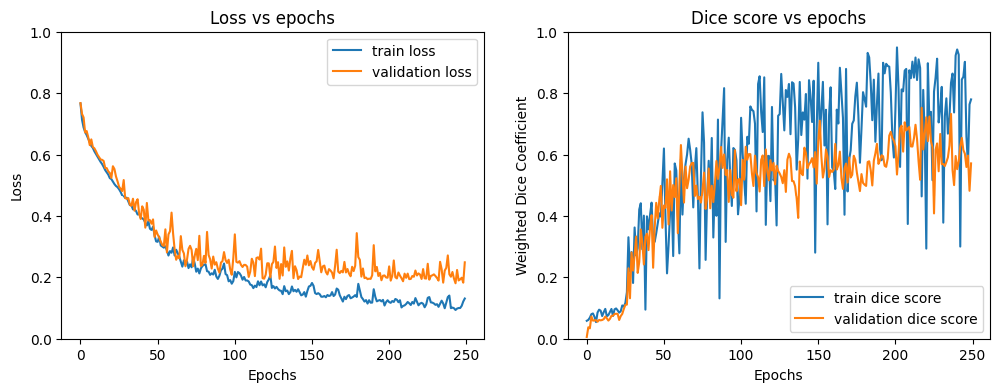

In [ ]:
# recompile model
model = AttentionUNet(out_channels=3)

# define the hyperparameters
LEARNING_RATE = 1e-4
BATCHSIZE = 32
EPOCHS = 250
NUM_WORKERS = 4

if __name__ == "__main__":

    worker_g = torch.Generator()
    worker_g.manual_seed(0)
    train_batches = DataLoader(
        train_dataset, batch_size=BATCHSIZE, shuffle=True,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )
    worker_g.manual_seed(0)
    valid_batches = DataLoader(
        valid_dataset, batch_size=BATCHSIZE, shuffle=False,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )

    # define the loss function and the optimizer
    criterion = smp.losses.DiceLoss(mode="multiclass", from_logits=True)
    optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

    start_time = time.time()

    # train the network
    history = run_train_loop("attnunetset3", model, train_batches, valid_batches, EPOCHS, criterion, optimizer)
    torch.save(
        {
            "epoch": 100,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "history": history,
        },
        f"{project_folder_path}models/attnunetset3_model_final.pth"
    )

    # display the total time needed to perform the training
    end_time = time.time()
    print(f"Total time taken to train the model: {(end_time - start_time):.2f}s")

    # plot the loss and accuracy history
    plot_history(history)

<i>Optional garbage collection to free up space</i>

In [ ]:
torch.cuda.empty_cache()
gc.collect()

6943

#### Set 4
loss: Dice Loss, learning rate: 1e-5, batch size: 32, epochs: 250

100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 1/250 Train Loss: 0.7982 Validation Loss: 0.8028, Train Dice Score: 0.0267 Validation Dice Score: 0.0178


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 2/250 Train Loss: 0.7852 Validation Loss: 0.7815, Train Dice Score: 0.0391 Validation Dice Score: 0.0507


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 3/250 Train Loss: 0.7688 Validation Loss: 0.7590, Train Dice Score: 0.0506 Validation Dice Score: 0.0433


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 4/250 Train Loss: 0.7515 Validation Loss: 0.7445, Train Dice Score: 0.0508 Validation Dice Score: 0.0405


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 5/250 Train Loss: 0.7347 Validation Loss: 0.7332, Train Dice Score: 0.0481 Validation Dice Score: 0.0437


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 6/250 Train Loss: 0.7227 Validation Loss: 0.7286, Train Dice Score: 0.0614 Validation Dice Score: 0.0476


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 7/250 Train Loss: 0.7131 Validation Loss: 0.7090, Train Dice Score: 0.0694 Validation Dice Score: 0.0611


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 8/250 Train Loss: 0.7053 Validation Loss: 0.7023, Train Dice Score: 0.0658 Validation Dice Score: 0.0717


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 9/250 Train Loss: 0.6972 Validation Loss: 0.6973, Train Dice Score: 0.0645 Validation Dice Score: 0.0588


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 10/250 Train Loss: 0.6919 Validation Loss: 0.6914, Train Dice Score: 0.0664 Validation Dice Score: 0.0647


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 11/250 Train Loss: 0.6881 Validation Loss: 0.6989, Train Dice Score: 0.0768 Validation Dice Score: 0.0552


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 12/250 Train Loss: 0.6823 Validation Loss: 0.6869, Train Dice Score: 0.0640 Validation Dice Score: 0.0648


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 13/250 Train Loss: 0.6786 Validation Loss: 0.6865, Train Dice Score: 0.0738 Validation Dice Score: 0.0583


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 14/250 Train Loss: 0.6746 Validation Loss: 0.6796, Train Dice Score: 0.0641 Validation Dice Score: 0.0560


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 15/250 Train Loss: 0.6720 Validation Loss: 0.6764, Train Dice Score: 0.0861 Validation Dice Score: 0.0603


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 16/250 Train Loss: 0.6670 Validation Loss: 0.6924, Train Dice Score: 0.0995 Validation Dice Score: 0.0564


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 17/250 Train Loss: 0.6679 Validation Loss: 0.6661, Train Dice Score: 0.0776 Validation Dice Score: 0.0795


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 18/250 Train Loss: 0.6616 Validation Loss: 0.6663, Train Dice Score: 0.0974 Validation Dice Score: 0.0691


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 19/250 Train Loss: 0.6585 Validation Loss: 0.6665, Train Dice Score: 0.0952 Validation Dice Score: 0.0670


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 20/250 Train Loss: 0.6574 Validation Loss: 0.6743, Train Dice Score: 0.0819 Validation Dice Score: 0.0504


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 21/250 Train Loss: 0.6543 Validation Loss: 0.6640, Train Dice Score: 0.0954 Validation Dice Score: 0.0652


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 22/250 Train Loss: 0.6505 Validation Loss: 0.6632, Train Dice Score: 0.0767 Validation Dice Score: 0.0711


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 23/250 Train Loss: 0.6488 Validation Loss: 0.6658, Train Dice Score: 0.0610 Validation Dice Score: 0.0610


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 24/250 Train Loss: 0.6479 Validation Loss: 0.6648, Train Dice Score: 0.0648 Validation Dice Score: 0.0564


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 25/250 Train Loss: 0.6440 Validation Loss: 0.6574, Train Dice Score: 0.0737 Validation Dice Score: 0.0723


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 26/250 Train Loss: 0.6412 Validation Loss: 0.6460, Train Dice Score: 0.0675 Validation Dice Score: 0.0709


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 27/250 Train Loss: 0.6398 Validation Loss: 0.6433, Train Dice Score: 0.0872 Validation Dice Score: 0.0795


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 28/250 Train Loss: 0.6348 Validation Loss: 0.6415, Train Dice Score: 0.0918 Validation Dice Score: 0.0750


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 29/250 Train Loss: 0.6330 Validation Loss: 0.6449, Train Dice Score: 0.0840 Validation Dice Score: 0.0711


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 30/250 Train Loss: 0.6310 Validation Loss: 0.6448, Train Dice Score: 0.0830 Validation Dice Score: 0.0646


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 31/250 Train Loss: 0.6288 Validation Loss: 0.6434, Train Dice Score: 0.0831 Validation Dice Score: 0.0694


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 32/250 Train Loss: 0.6276 Validation Loss: 0.6420, Train Dice Score: 0.0731 Validation Dice Score: 0.0745


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 33/250 Train Loss: 0.6236 Validation Loss: 0.6408, Train Dice Score: 0.0909 Validation Dice Score: 0.0653


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 34/250 Train Loss: 0.6217 Validation Loss: 0.6382, Train Dice Score: 0.0803 Validation Dice Score: 0.0702


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 35/250 Train Loss: 0.6193 Validation Loss: 0.6342, Train Dice Score: 0.0866 Validation Dice Score: 0.0731


100%|██████████| 20/20 [00:08<00:00,  2.47it/s]


Epoch 36/250 Train Loss: 0.6184 Validation Loss: 0.6302, Train Dice Score: 0.0825 Validation Dice Score: 0.0790


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 37/250 Train Loss: 0.6157 Validation Loss: 0.6318, Train Dice Score: 0.0925 Validation Dice Score: 0.0773


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 38/250 Train Loss: 0.6142 Validation Loss: 0.6306, Train Dice Score: 0.0809 Validation Dice Score: 0.0691


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 39/250 Train Loss: 0.6134 Validation Loss: 0.6276, Train Dice Score: 0.0785 Validation Dice Score: 0.0732


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 40/250 Train Loss: 0.6121 Validation Loss: 0.6328, Train Dice Score: 0.0937 Validation Dice Score: 0.0789


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 41/250 Train Loss: 0.6107 Validation Loss: 0.6317, Train Dice Score: 0.0978 Validation Dice Score: 0.0699


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 42/250 Train Loss: 0.6076 Validation Loss: 0.6269, Train Dice Score: 0.0996 Validation Dice Score: 0.0824


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 43/250 Train Loss: 0.6070 Validation Loss: 0.6271, Train Dice Score: 0.0808 Validation Dice Score: 0.0645


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 44/250 Train Loss: 0.6058 Validation Loss: 0.6290, Train Dice Score: 0.0878 Validation Dice Score: 0.0688


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 45/250 Train Loss: 0.6037 Validation Loss: 0.6298, Train Dice Score: 0.0958 Validation Dice Score: 0.0809


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 46/250 Train Loss: 0.6034 Validation Loss: 0.6212, Train Dice Score: 0.1036 Validation Dice Score: 0.0783


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 47/250 Train Loss: 0.6014 Validation Loss: 0.6206, Train Dice Score: 0.0968 Validation Dice Score: 0.0805


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 48/250 Train Loss: 0.5967 Validation Loss: 0.6245, Train Dice Score: 0.0997 Validation Dice Score: 0.0718


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 49/250 Train Loss: 0.5970 Validation Loss: 0.6165, Train Dice Score: 0.0992 Validation Dice Score: 0.0837


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 50/250 Train Loss: 0.5971 Validation Loss: 0.6208, Train Dice Score: 0.0913 Validation Dice Score: 0.0693


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 51/250 Train Loss: 0.5939 Validation Loss: 0.6187, Train Dice Score: 0.1015 Validation Dice Score: 0.0729


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 52/250 Train Loss: 0.5942 Validation Loss: 0.6189, Train Dice Score: 0.1004 Validation Dice Score: 0.0722


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 53/250 Train Loss: 0.5916 Validation Loss: 0.6123, Train Dice Score: 0.0999 Validation Dice Score: 0.0773


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 54/250 Train Loss: 0.5895 Validation Loss: 0.6090, Train Dice Score: 0.0904 Validation Dice Score: 0.0780


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 55/250 Train Loss: 0.5904 Validation Loss: 0.6198, Train Dice Score: 0.0968 Validation Dice Score: 0.0766


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 56/250 Train Loss: 0.5893 Validation Loss: 0.6322, Train Dice Score: 0.0977 Validation Dice Score: 0.0562


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 57/250 Train Loss: 0.5893 Validation Loss: 0.6194, Train Dice Score: 0.0838 Validation Dice Score: 0.0638


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 58/250 Train Loss: 0.5874 Validation Loss: 0.6074, Train Dice Score: 0.0975 Validation Dice Score: 0.0839


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 59/250 Train Loss: 0.5835 Validation Loss: 0.6077, Train Dice Score: 0.0823 Validation Dice Score: 0.0776


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 60/250 Train Loss: 0.5816 Validation Loss: 0.6086, Train Dice Score: 0.0980 Validation Dice Score: 0.0765


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 61/250 Train Loss: 0.5806 Validation Loss: 0.6034, Train Dice Score: 0.0835 Validation Dice Score: 0.0824


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 62/250 Train Loss: 0.5795 Validation Loss: 0.6024, Train Dice Score: 0.1078 Validation Dice Score: 0.0836


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 63/250 Train Loss: 0.5771 Validation Loss: 0.6061, Train Dice Score: 0.0987 Validation Dice Score: 0.0770


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 64/250 Train Loss: 0.5773 Validation Loss: 0.6049, Train Dice Score: 0.1012 Validation Dice Score: 0.0721


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 65/250 Train Loss: 0.5765 Validation Loss: 0.6067, Train Dice Score: 0.0919 Validation Dice Score: 0.0779


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 66/250 Train Loss: 0.5744 Validation Loss: 0.5953, Train Dice Score: 0.0904 Validation Dice Score: 0.0852


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 67/250 Train Loss: 0.5722 Validation Loss: 0.6046, Train Dice Score: 0.0930 Validation Dice Score: 0.0749


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 68/250 Train Loss: 0.5735 Validation Loss: 0.6074, Train Dice Score: 0.0825 Validation Dice Score: 0.0673


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 69/250 Train Loss: 0.5701 Validation Loss: 0.5946, Train Dice Score: 0.1032 Validation Dice Score: 0.0827


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 70/250 Train Loss: 0.5676 Validation Loss: 0.5975, Train Dice Score: 0.1032 Validation Dice Score: 0.0791


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 71/250 Train Loss: 0.5711 Validation Loss: 0.5957, Train Dice Score: 0.0867 Validation Dice Score: 0.0784


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 72/250 Train Loss: 0.5674 Validation Loss: 0.6144, Train Dice Score: 0.1024 Validation Dice Score: 0.0581


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 73/250 Train Loss: 0.5673 Validation Loss: 0.5946, Train Dice Score: 0.0841 Validation Dice Score: 0.0798


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 74/250 Train Loss: 0.5654 Validation Loss: 0.5971, Train Dice Score: 0.1030 Validation Dice Score: 0.0712


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 75/250 Train Loss: 0.5646 Validation Loss: 0.5916, Train Dice Score: 0.1085 Validation Dice Score: 0.0794


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 76/250 Train Loss: 0.5621 Validation Loss: 0.6051, Train Dice Score: 0.1071 Validation Dice Score: 0.0636


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 77/250 Train Loss: 0.5620 Validation Loss: 0.5912, Train Dice Score: 0.0976 Validation Dice Score: 0.0805


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 78/250 Train Loss: 0.5597 Validation Loss: 0.5970, Train Dice Score: 0.0931 Validation Dice Score: 0.0716


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 79/250 Train Loss: 0.5586 Validation Loss: 0.5888, Train Dice Score: 0.1046 Validation Dice Score: 0.0801


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 80/250 Train Loss: 0.5586 Validation Loss: 0.5894, Train Dice Score: 0.0947 Validation Dice Score: 0.0775


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 81/250 Train Loss: 0.5584 Validation Loss: 0.5837, Train Dice Score: 0.1077 Validation Dice Score: 0.0878


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 82/250 Train Loss: 0.5574 Validation Loss: 0.5817, Train Dice Score: 0.1041 Validation Dice Score: 0.0869


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 83/250 Train Loss: 0.5574 Validation Loss: 0.6035, Train Dice Score: 0.0968 Validation Dice Score: 0.0630


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 84/250 Train Loss: 0.5547 Validation Loss: 0.5812, Train Dice Score: 0.0974 Validation Dice Score: 0.0869


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 85/250 Train Loss: 0.5511 Validation Loss: 0.5817, Train Dice Score: 0.1062 Validation Dice Score: 0.0853


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 86/250 Train Loss: 0.5508 Validation Loss: 0.5828, Train Dice Score: 0.1082 Validation Dice Score: 0.0843


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 87/250 Train Loss: 0.5492 Validation Loss: 0.5826, Train Dice Score: 0.1057 Validation Dice Score: 0.0777


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 88/250 Train Loss: 0.5503 Validation Loss: 0.5744, Train Dice Score: 0.0905 Validation Dice Score: 0.0854


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 89/250 Train Loss: 0.5482 Validation Loss: 0.5784, Train Dice Score: 0.1079 Validation Dice Score: 0.0822


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 90/250 Train Loss: 0.5477 Validation Loss: 0.5740, Train Dice Score: 0.1083 Validation Dice Score: 0.0879


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 91/250 Train Loss: 0.5467 Validation Loss: 0.5786, Train Dice Score: 0.1089 Validation Dice Score: 0.0783


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 92/250 Train Loss: 0.5441 Validation Loss: 0.5798, Train Dice Score: 0.1066 Validation Dice Score: 0.0866


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 93/250 Train Loss: 0.5441 Validation Loss: 0.5738, Train Dice Score: 0.1084 Validation Dice Score: 0.0884


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 94/250 Train Loss: 0.5436 Validation Loss: 0.5767, Train Dice Score: 0.1091 Validation Dice Score: 0.0893


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 95/250 Train Loss: 0.5409 Validation Loss: 0.5711, Train Dice Score: 0.1092 Validation Dice Score: 0.0892


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 96/250 Train Loss: 0.5402 Validation Loss: 0.5816, Train Dice Score: 0.1035 Validation Dice Score: 0.0766


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 97/250 Train Loss: 0.5404 Validation Loss: 0.5683, Train Dice Score: 0.1094 Validation Dice Score: 0.0896


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 98/250 Train Loss: 0.5389 Validation Loss: 0.5708, Train Dice Score: 0.1091 Validation Dice Score: 0.0915


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 99/250 Train Loss: 0.5361 Validation Loss: 0.5684, Train Dice Score: 0.1094 Validation Dice Score: 0.0874


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 100/250 Train Loss: 0.5353 Validation Loss: 0.5669, Train Dice Score: 0.1074 Validation Dice Score: 0.0989


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 101/250 Train Loss: 0.5326 Validation Loss: 0.5687, Train Dice Score: 0.1066 Validation Dice Score: 0.1038


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 102/250 Train Loss: 0.5330 Validation Loss: 0.5693, Train Dice Score: 0.1147 Validation Dice Score: 0.1025


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 103/250 Train Loss: 0.5338 Validation Loss: 0.5690, Train Dice Score: 0.1184 Validation Dice Score: 0.1305


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 104/250 Train Loss: 0.5307 Validation Loss: 0.5672, Train Dice Score: 0.1264 Validation Dice Score: 0.1170


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 105/250 Train Loss: 0.5305 Validation Loss: 0.5606, Train Dice Score: 0.1074 Validation Dice Score: 0.1715


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 106/250 Train Loss: 0.5294 Validation Loss: 0.5606, Train Dice Score: 0.1614 Validation Dice Score: 0.1377


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 107/250 Train Loss: 0.5277 Validation Loss: 0.5604, Train Dice Score: 0.1432 Validation Dice Score: 0.1574


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 108/250 Train Loss: 0.5261 Validation Loss: 0.5625, Train Dice Score: 0.2407 Validation Dice Score: 0.1715


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 109/250 Train Loss: 0.5238 Validation Loss: 0.5744, Train Dice Score: 0.1954 Validation Dice Score: 0.1146


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 110/250 Train Loss: 0.5222 Validation Loss: 0.5612, Train Dice Score: 0.2035 Validation Dice Score: 0.1322


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 111/250 Train Loss: 0.5200 Validation Loss: 0.5550, Train Dice Score: 0.1858 Validation Dice Score: 0.1326


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 112/250 Train Loss: 0.5205 Validation Loss: 0.5625, Train Dice Score: 0.1393 Validation Dice Score: 0.1108


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 113/250 Train Loss: 0.5184 Validation Loss: 0.5586, Train Dice Score: 0.1216 Validation Dice Score: 0.1241


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 114/250 Train Loss: 0.5168 Validation Loss: 0.5466, Train Dice Score: 0.2668 Validation Dice Score: 0.1645


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 115/250 Train Loss: 0.5162 Validation Loss: 0.5441, Train Dice Score: 0.2476 Validation Dice Score: 0.1529


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 116/250 Train Loss: 0.5149 Validation Loss: 0.5513, Train Dice Score: 0.1576 Validation Dice Score: 0.1679


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 117/250 Train Loss: 0.5143 Validation Loss: 0.5492, Train Dice Score: 0.2245 Validation Dice Score: 0.1488


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 118/250 Train Loss: 0.5140 Validation Loss: 0.5427, Train Dice Score: 0.2097 Validation Dice Score: 0.1405


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 119/250 Train Loss: 0.5144 Validation Loss: 0.5461, Train Dice Score: 0.1893 Validation Dice Score: 0.1601


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 120/250 Train Loss: 0.5130 Validation Loss: 0.5533, Train Dice Score: 0.2504 Validation Dice Score: 0.1215


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 121/250 Train Loss: 0.5104 Validation Loss: 0.5444, Train Dice Score: 0.2347 Validation Dice Score: 0.1585


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 122/250 Train Loss: 0.5065 Validation Loss: 0.5388, Train Dice Score: 0.1792 Validation Dice Score: 0.1522


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 123/250 Train Loss: 0.5055 Validation Loss: 0.5407, Train Dice Score: 0.2581 Validation Dice Score: 0.1617


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 124/250 Train Loss: 0.5026 Validation Loss: 0.5453, Train Dice Score: 0.2416 Validation Dice Score: 0.1634


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 125/250 Train Loss: 0.5005 Validation Loss: 0.5391, Train Dice Score: 0.2509 Validation Dice Score: 0.1570


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 126/250 Train Loss: 0.5008 Validation Loss: 0.5398, Train Dice Score: 0.2988 Validation Dice Score: 0.1847


100%|██████████| 20/20 [00:07<00:00,  2.63it/s]


Epoch 127/250 Train Loss: 0.4979 Validation Loss: 0.5373, Train Dice Score: 0.1825 Validation Dice Score: 0.1897


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 128/250 Train Loss: 0.4985 Validation Loss: 0.5448, Train Dice Score: 0.1295 Validation Dice Score: 0.1606


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 129/250 Train Loss: 0.4968 Validation Loss: 0.5411, Train Dice Score: 0.2114 Validation Dice Score: 0.1854


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 130/250 Train Loss: 0.4976 Validation Loss: 0.5359, Train Dice Score: 0.2469 Validation Dice Score: 0.1557


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 131/250 Train Loss: 0.4970 Validation Loss: 0.5394, Train Dice Score: 0.2693 Validation Dice Score: 0.2034


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 132/250 Train Loss: 0.4955 Validation Loss: 0.5361, Train Dice Score: 0.1824 Validation Dice Score: 0.1642


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 133/250 Train Loss: 0.4932 Validation Loss: 0.5327, Train Dice Score: 0.1704 Validation Dice Score: 0.1760


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 134/250 Train Loss: 0.4921 Validation Loss: 0.5278, Train Dice Score: 0.1345 Validation Dice Score: 0.1991


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 135/250 Train Loss: 0.4900 Validation Loss: 0.5307, Train Dice Score: 0.2239 Validation Dice Score: 0.1870


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 136/250 Train Loss: 0.4884 Validation Loss: 0.5272, Train Dice Score: 0.1642 Validation Dice Score: 0.1710


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 137/250 Train Loss: 0.4872 Validation Loss: 0.5363, Train Dice Score: 0.2437 Validation Dice Score: 0.1404


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 138/250 Train Loss: 0.4882 Validation Loss: 0.5303, Train Dice Score: 0.2781 Validation Dice Score: 0.1832


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 139/250 Train Loss: 0.4883 Validation Loss: 0.5445, Train Dice Score: 0.2156 Validation Dice Score: 0.1202


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 140/250 Train Loss: 0.4852 Validation Loss: 0.5340, Train Dice Score: 0.1746 Validation Dice Score: 0.1514


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 141/250 Train Loss: 0.4867 Validation Loss: 0.5237, Train Dice Score: 0.2998 Validation Dice Score: 0.1864


100%|██████████| 20/20 [00:08<00:00,  2.42it/s]


Epoch 142/250 Train Loss: 0.4841 Validation Loss: 0.5236, Train Dice Score: 0.3691 Validation Dice Score: 0.1672


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 143/250 Train Loss: 0.4809 Validation Loss: 0.5205, Train Dice Score: 0.3768 Validation Dice Score: 0.1848


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 144/250 Train Loss: 0.4798 Validation Loss: 0.5199, Train Dice Score: 0.4752 Validation Dice Score: 0.1886


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 145/250 Train Loss: 0.4793 Validation Loss: 0.5256, Train Dice Score: 0.3559 Validation Dice Score: 0.1655


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 146/250 Train Loss: 0.4772 Validation Loss: 0.5210, Train Dice Score: 0.2730 Validation Dice Score: 0.1520


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 147/250 Train Loss: 0.4747 Validation Loss: 0.5279, Train Dice Score: 0.3480 Validation Dice Score: 0.1357


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 148/250 Train Loss: 0.4753 Validation Loss: 0.5213, Train Dice Score: 0.2555 Validation Dice Score: 0.1756


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 149/250 Train Loss: 0.4743 Validation Loss: 0.5185, Train Dice Score: 0.3392 Validation Dice Score: 0.2064


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 150/250 Train Loss: 0.4726 Validation Loss: 0.5179, Train Dice Score: 0.3371 Validation Dice Score: 0.2198


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 151/250 Train Loss: 0.4707 Validation Loss: 0.5147, Train Dice Score: 0.3474 Validation Dice Score: 0.2194


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 152/250 Train Loss: 0.4694 Validation Loss: 0.5188, Train Dice Score: 0.2839 Validation Dice Score: 0.1896


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 153/250 Train Loss: 0.4692 Validation Loss: 0.5180, Train Dice Score: 0.2807 Validation Dice Score: 0.1610


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 154/250 Train Loss: 0.4690 Validation Loss: 0.5149, Train Dice Score: 0.4167 Validation Dice Score: 0.1874


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 155/250 Train Loss: 0.4670 Validation Loss: 0.5138, Train Dice Score: 0.2522 Validation Dice Score: 0.2457


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 156/250 Train Loss: 0.4663 Validation Loss: 0.5131, Train Dice Score: 0.4251 Validation Dice Score: 0.1922


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 157/250 Train Loss: 0.4634 Validation Loss: 0.5147, Train Dice Score: 0.3257 Validation Dice Score: 0.1900


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 158/250 Train Loss: 0.4644 Validation Loss: 0.5284, Train Dice Score: 0.3420 Validation Dice Score: 0.1742


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 159/250 Train Loss: 0.4666 Validation Loss: 0.5152, Train Dice Score: 0.3180 Validation Dice Score: 0.1887


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 160/250 Train Loss: 0.4593 Validation Loss: 0.5094, Train Dice Score: 0.4391 Validation Dice Score: 0.2061


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 161/250 Train Loss: 0.4583 Validation Loss: 0.5077, Train Dice Score: 0.3954 Validation Dice Score: 0.1935


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 162/250 Train Loss: 0.4578 Validation Loss: 0.5135, Train Dice Score: 0.1821 Validation Dice Score: 0.1776


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 163/250 Train Loss: 0.4574 Validation Loss: 0.5045, Train Dice Score: 0.3528 Validation Dice Score: 0.1940


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 164/250 Train Loss: 0.4575 Validation Loss: 0.5136, Train Dice Score: 0.2974 Validation Dice Score: 0.1947


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 165/250 Train Loss: 0.4567 Validation Loss: 0.5138, Train Dice Score: 0.2772 Validation Dice Score: 0.1824


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 166/250 Train Loss: 0.4586 Validation Loss: 0.5203, Train Dice Score: 0.1627 Validation Dice Score: 0.1437


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 167/250 Train Loss: 0.4546 Validation Loss: 0.5075, Train Dice Score: 0.4964 Validation Dice Score: 0.1835


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 168/250 Train Loss: 0.4521 Validation Loss: 0.5171, Train Dice Score: 0.3109 Validation Dice Score: 0.1524


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 169/250 Train Loss: 0.4523 Validation Loss: 0.5126, Train Dice Score: 0.3293 Validation Dice Score: 0.2459


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 170/250 Train Loss: 0.4502 Validation Loss: 0.4975, Train Dice Score: 0.3428 Validation Dice Score: 0.2013


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 171/250 Train Loss: 0.4491 Validation Loss: 0.5045, Train Dice Score: 0.4062 Validation Dice Score: 0.2603


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 172/250 Train Loss: 0.4465 Validation Loss: 0.5011, Train Dice Score: 0.2181 Validation Dice Score: 0.2426


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 173/250 Train Loss: 0.4433 Validation Loss: 0.4978, Train Dice Score: 0.3364 Validation Dice Score: 0.2575


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 174/250 Train Loss: 0.4452 Validation Loss: 0.5047, Train Dice Score: 0.5907 Validation Dice Score: 0.2308


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 175/250 Train Loss: 0.4459 Validation Loss: 0.4985, Train Dice Score: 0.4378 Validation Dice Score: 0.2676


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 176/250 Train Loss: 0.4425 Validation Loss: 0.4981, Train Dice Score: 0.3286 Validation Dice Score: 0.1802


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 177/250 Train Loss: 0.4433 Validation Loss: 0.4976, Train Dice Score: 0.4701 Validation Dice Score: 0.1861


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 178/250 Train Loss: 0.4395 Validation Loss: 0.4924, Train Dice Score: 0.4117 Validation Dice Score: 0.2892


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 179/250 Train Loss: 0.4379 Validation Loss: 0.4908, Train Dice Score: 0.5504 Validation Dice Score: 0.2123


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 180/250 Train Loss: 0.4385 Validation Loss: 0.4893, Train Dice Score: 0.4187 Validation Dice Score: 0.3156


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 181/250 Train Loss: 0.4389 Validation Loss: 0.5040, Train Dice Score: 0.3491 Validation Dice Score: 0.2467


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 182/250 Train Loss: 0.4377 Validation Loss: 0.5001, Train Dice Score: 0.3845 Validation Dice Score: 0.2102


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 183/250 Train Loss: 0.4373 Validation Loss: 0.5063, Train Dice Score: 0.2792 Validation Dice Score: 0.2090


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 184/250 Train Loss: 0.4382 Validation Loss: 0.5046, Train Dice Score: 0.5723 Validation Dice Score: 0.2204


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 185/250 Train Loss: 0.4345 Validation Loss: 0.4965, Train Dice Score: 0.1739 Validation Dice Score: 0.1848


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 186/250 Train Loss: 0.4357 Validation Loss: 0.4890, Train Dice Score: 0.3774 Validation Dice Score: 0.2951


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 187/250 Train Loss: 0.4321 Validation Loss: 0.4939, Train Dice Score: 0.3076 Validation Dice Score: 0.2745


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 188/250 Train Loss: 0.4332 Validation Loss: 0.4947, Train Dice Score: 0.6131 Validation Dice Score: 0.2296


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 189/250 Train Loss: 0.4327 Validation Loss: 0.4869, Train Dice Score: 0.5776 Validation Dice Score: 0.1856


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 190/250 Train Loss: 0.4274 Validation Loss: 0.4793, Train Dice Score: 0.2373 Validation Dice Score: 0.3108


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 191/250 Train Loss: 0.4259 Validation Loss: 0.4836, Train Dice Score: 0.5523 Validation Dice Score: 0.2957


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 192/250 Train Loss: 0.4269 Validation Loss: 0.4839, Train Dice Score: 0.4001 Validation Dice Score: 0.2279


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 193/250 Train Loss: 0.4261 Validation Loss: 0.4859, Train Dice Score: 0.4761 Validation Dice Score: 0.2447


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 194/250 Train Loss: 0.4250 Validation Loss: 0.4793, Train Dice Score: 0.5294 Validation Dice Score: 0.3310


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 195/250 Train Loss: 0.4242 Validation Loss: 0.4830, Train Dice Score: 0.5748 Validation Dice Score: 0.2795


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 196/250 Train Loss: 0.4247 Validation Loss: 0.4832, Train Dice Score: 0.6625 Validation Dice Score: 0.2577


100%|██████████| 20/20 [00:08<00:00,  2.44it/s]


Epoch 197/250 Train Loss: 0.4230 Validation Loss: 0.4784, Train Dice Score: 0.5202 Validation Dice Score: 0.2924


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 198/250 Train Loss: 0.4224 Validation Loss: 0.4789, Train Dice Score: 0.5154 Validation Dice Score: 0.2509


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 199/250 Train Loss: 0.4191 Validation Loss: 0.4746, Train Dice Score: 0.5827 Validation Dice Score: 0.2351


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 200/250 Train Loss: 0.4185 Validation Loss: 0.4721, Train Dice Score: 0.3707 Validation Dice Score: 0.2582


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 201/250 Train Loss: 0.4159 Validation Loss: 0.4785, Train Dice Score: 0.5942 Validation Dice Score: 0.3214


100%|██████████| 20/20 [00:08<00:00,  2.46it/s]


Epoch 202/250 Train Loss: 0.4174 Validation Loss: 0.4721, Train Dice Score: 0.2340 Validation Dice Score: 0.2730


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 203/250 Train Loss: 0.4146 Validation Loss: 0.4790, Train Dice Score: 0.6481 Validation Dice Score: 0.3485


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 204/250 Train Loss: 0.4131 Validation Loss: 0.4765, Train Dice Score: 0.5883 Validation Dice Score: 0.3601


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 205/250 Train Loss: 0.4120 Validation Loss: 0.4756, Train Dice Score: 0.5633 Validation Dice Score: 0.2610


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 206/250 Train Loss: 0.4104 Validation Loss: 0.4743, Train Dice Score: 0.5786 Validation Dice Score: 0.3336


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 207/250 Train Loss: 0.4087 Validation Loss: 0.4734, Train Dice Score: 0.6216 Validation Dice Score: 0.2990


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 208/250 Train Loss: 0.4084 Validation Loss: 0.4751, Train Dice Score: 0.4647 Validation Dice Score: 0.4041


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 209/250 Train Loss: 0.4055 Validation Loss: 0.4672, Train Dice Score: 0.5705 Validation Dice Score: 0.2789


100%|██████████| 20/20 [00:08<00:00,  2.50it/s]


Epoch 210/250 Train Loss: 0.4071 Validation Loss: 0.4692, Train Dice Score: 0.7677 Validation Dice Score: 0.3314


100%|██████████| 20/20 [00:07<00:00,  2.50it/s]


Epoch 211/250 Train Loss: 0.4060 Validation Loss: 0.4769, Train Dice Score: 0.7142 Validation Dice Score: 0.3259


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 212/250 Train Loss: 0.4035 Validation Loss: 0.4671, Train Dice Score: 0.7027 Validation Dice Score: 0.3564


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 213/250 Train Loss: 0.4017 Validation Loss: 0.4712, Train Dice Score: 0.4527 Validation Dice Score: 0.3417


100%|██████████| 20/20 [00:07<00:00,  2.62it/s]


Epoch 214/250 Train Loss: 0.4046 Validation Loss: 0.4676, Train Dice Score: 0.7308 Validation Dice Score: 0.2789


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 215/250 Train Loss: 0.4014 Validation Loss: 0.4713, Train Dice Score: 0.4808 Validation Dice Score: 0.3731


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 216/250 Train Loss: 0.3972 Validation Loss: 0.4649, Train Dice Score: 0.6664 Validation Dice Score: 0.3644


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 217/250 Train Loss: 0.4020 Validation Loss: 0.4686, Train Dice Score: 0.8117 Validation Dice Score: 0.3366


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 218/250 Train Loss: 0.3987 Validation Loss: 0.4581, Train Dice Score: 0.4415 Validation Dice Score: 0.3586


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 219/250 Train Loss: 0.3974 Validation Loss: 0.4682, Train Dice Score: 0.8116 Validation Dice Score: 0.2987


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 220/250 Train Loss: 0.3989 Validation Loss: 0.4637, Train Dice Score: 0.5766 Validation Dice Score: 0.3219


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 221/250 Train Loss: 0.3944 Validation Loss: 0.4658, Train Dice Score: 0.7465 Validation Dice Score: 0.3249


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 222/250 Train Loss: 0.3930 Validation Loss: 0.4624, Train Dice Score: 0.7571 Validation Dice Score: 0.3622


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 223/250 Train Loss: 0.3950 Validation Loss: 0.4642, Train Dice Score: 0.4104 Validation Dice Score: 0.3889


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 224/250 Train Loss: 0.3894 Validation Loss: 0.4627, Train Dice Score: 0.6538 Validation Dice Score: 0.3546


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 225/250 Train Loss: 0.3914 Validation Loss: 0.4627, Train Dice Score: 0.6384 Validation Dice Score: 0.3617


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 226/250 Train Loss: 0.3883 Validation Loss: 0.4553, Train Dice Score: 0.7635 Validation Dice Score: 0.2868


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 227/250 Train Loss: 0.3892 Validation Loss: 0.4681, Train Dice Score: 0.6570 Validation Dice Score: 0.3225


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 228/250 Train Loss: 0.3874 Validation Loss: 0.4621, Train Dice Score: 0.5602 Validation Dice Score: 0.3127


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 229/250 Train Loss: 0.3873 Validation Loss: 0.4602, Train Dice Score: 0.5976 Validation Dice Score: 0.2880


100%|██████████| 20/20 [00:07<00:00,  2.55it/s]


Epoch 230/250 Train Loss: 0.3877 Validation Loss: 0.4615, Train Dice Score: 0.6086 Validation Dice Score: 0.3409


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 231/250 Train Loss: 0.3888 Validation Loss: 0.4561, Train Dice Score: 0.8232 Validation Dice Score: 0.2629


100%|██████████| 20/20 [00:07<00:00,  2.60it/s]


Epoch 232/250 Train Loss: 0.3888 Validation Loss: 0.4433, Train Dice Score: 0.5630 Validation Dice Score: 0.3041


100%|██████████| 20/20 [00:07<00:00,  2.56it/s]


Epoch 233/250 Train Loss: 0.3860 Validation Loss: 0.4595, Train Dice Score: 0.6487 Validation Dice Score: 0.3821


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 234/250 Train Loss: 0.3866 Validation Loss: 0.4572, Train Dice Score: 0.6320 Validation Dice Score: 0.3496


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 235/250 Train Loss: 0.3841 Validation Loss: 0.4533, Train Dice Score: 0.6437 Validation Dice Score: 0.3533


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 236/250 Train Loss: 0.3809 Validation Loss: 0.4561, Train Dice Score: 0.5709 Validation Dice Score: 0.4256


100%|██████████| 20/20 [00:07<00:00,  2.61it/s]


Epoch 237/250 Train Loss: 0.3793 Validation Loss: 0.4559, Train Dice Score: 0.4766 Validation Dice Score: 0.4343


100%|██████████| 20/20 [00:07<00:00,  2.59it/s]


Epoch 238/250 Train Loss: 0.3776 Validation Loss: 0.4502, Train Dice Score: 0.6706 Validation Dice Score: 0.3831


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 239/250 Train Loss: 0.3748 Validation Loss: 0.4510, Train Dice Score: 0.7369 Validation Dice Score: 0.4366


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 240/250 Train Loss: 0.3735 Validation Loss: 0.4514, Train Dice Score: 0.7562 Validation Dice Score: 0.3390


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 241/250 Train Loss: 0.3759 Validation Loss: 0.4558, Train Dice Score: 0.7299 Validation Dice Score: 0.3149


100%|██████████| 20/20 [00:08<00:00,  2.48it/s]


Epoch 242/250 Train Loss: 0.3718 Validation Loss: 0.4514, Train Dice Score: 0.5863 Validation Dice Score: 0.3828


100%|██████████| 20/20 [00:07<00:00,  2.54it/s]


Epoch 243/250 Train Loss: 0.3717 Validation Loss: 0.4437, Train Dice Score: 0.5937 Validation Dice Score: 0.3832


100%|██████████| 20/20 [00:07<00:00,  2.58it/s]


Epoch 244/250 Train Loss: 0.3672 Validation Loss: 0.4458, Train Dice Score: 0.5382 Validation Dice Score: 0.4608


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 245/250 Train Loss: 0.3688 Validation Loss: 0.4385, Train Dice Score: 0.5383 Validation Dice Score: 0.4320


100%|██████████| 20/20 [00:07<00:00,  2.57it/s]


Epoch 246/250 Train Loss: 0.3703 Validation Loss: 0.4518, Train Dice Score: 0.6963 Validation Dice Score: 0.3957


100%|██████████| 20/20 [00:07<00:00,  2.53it/s]


Epoch 247/250 Train Loss: 0.3721 Validation Loss: 0.4647, Train Dice Score: 0.7140 Validation Dice Score: 0.4338


100%|██████████| 20/20 [00:08<00:00,  2.49it/s]


Epoch 248/250 Train Loss: 0.3708 Validation Loss: 0.4551, Train Dice Score: 0.6701 Validation Dice Score: 0.4077


100%|██████████| 20/20 [00:07<00:00,  2.52it/s]


Epoch 249/250 Train Loss: 0.3699 Validation Loss: 0.4561, Train Dice Score: 0.5295 Validation Dice Score: 0.3760


100%|██████████| 20/20 [00:07<00:00,  2.51it/s]


Epoch 250/250 Train Loss: 0.3746 Validation Loss: 0.4483, Train Dice Score: 0.6135 Validation Dice Score: 0.3438
Total time taken to train the model: 2696.06s


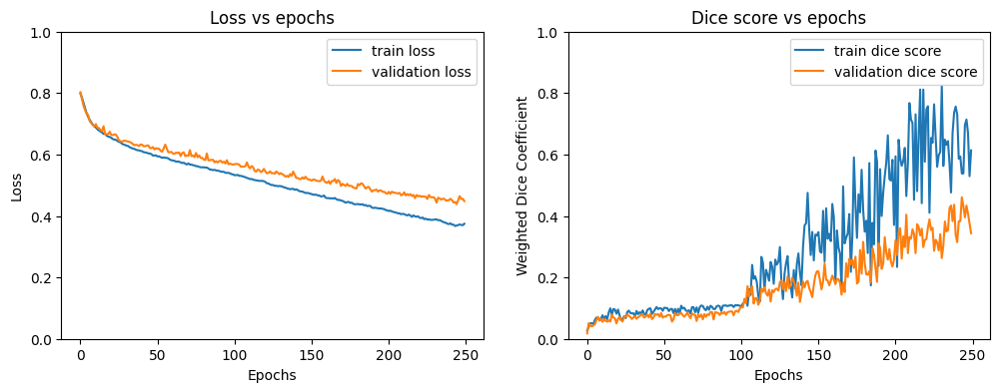

In [34]:
# recompile model
model = AttentionUNet(out_channels=3)

# define the hyperparameters
LEARNING_RATE = 1e-5
BATCHSIZE = 32
EPOCHS = 250
NUM_WORKERS = 4

if __name__ == "__main__":

    worker_g = torch.Generator()
    worker_g.manual_seed(0)
    train_batches = DataLoader(
        train_dataset, batch_size=BATCHSIZE, shuffle=True,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )
    worker_g.manual_seed(0)
    valid_batches = DataLoader(
        valid_dataset, batch_size=BATCHSIZE, shuffle=False,
        num_workers=NUM_WORKERS, worker_init_fn=seed_worker, pin_memory=True, prefetch_factor=2
    )

    # define the loss function and the optimizer
    criterion = smp.losses.DiceLoss(mode="multiclass", from_logits=True)
    optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

    start_time = time.time()

    # train the network
    history = run_train_loop("attnunetset4", model, train_batches, valid_batches, EPOCHS, criterion, optimizer)
    torch.save(
        {
            "epoch": 100,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "history": history,
        },
        f"{project_folder_path}models/attnunetset4_model_final.pth"
    )

    # display the total time needed to perform the training
    end_time = time.time()
    print(f"Total time taken to train the model: {(end_time - start_time):.2f}s")

    # plot the loss and accuracy history
    plot_history(history)

<i>Optional garbage collection to free up space</i>

In [35]:
torch.cuda.empty_cache()
gc.collect()

6894

### Evaluate model

Similarly, the test dataset is loaded for evaluation

#### Set 1

Results for Attention UNet model 1
                      precision    recall  f1-score   support

          background       0.99      0.95      0.97  12750928
    neoplastic polyp       0.54      0.78      0.64    589027
non-neoplastic polyp       0.09      0.39      0.15     94925

            accuracy                           0.94  13434880
           macro avg       0.54      0.71      0.59  13434880
        weighted avg       0.97      0.94      0.95  13434880



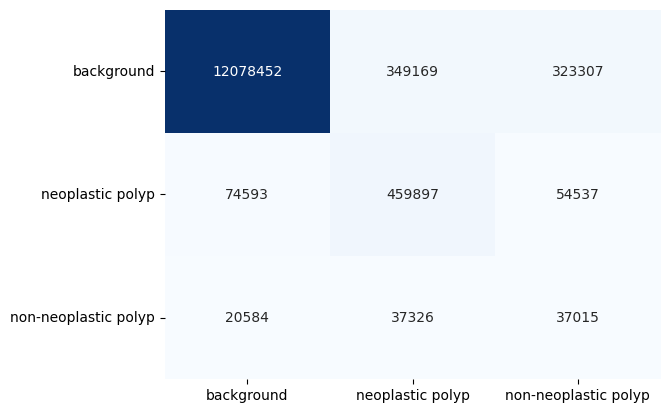

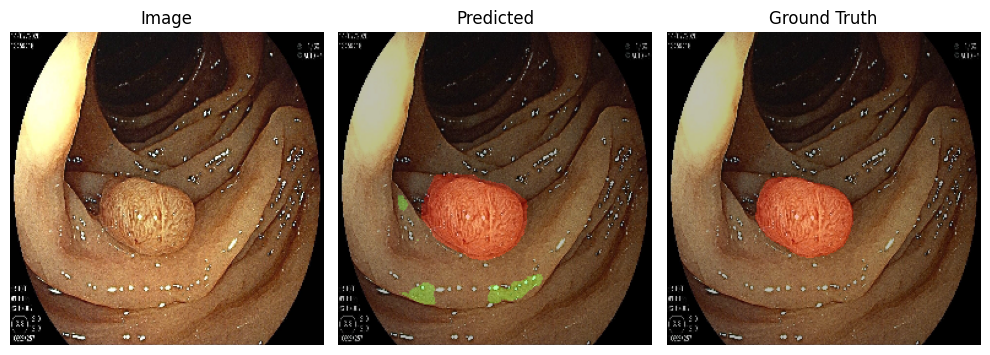

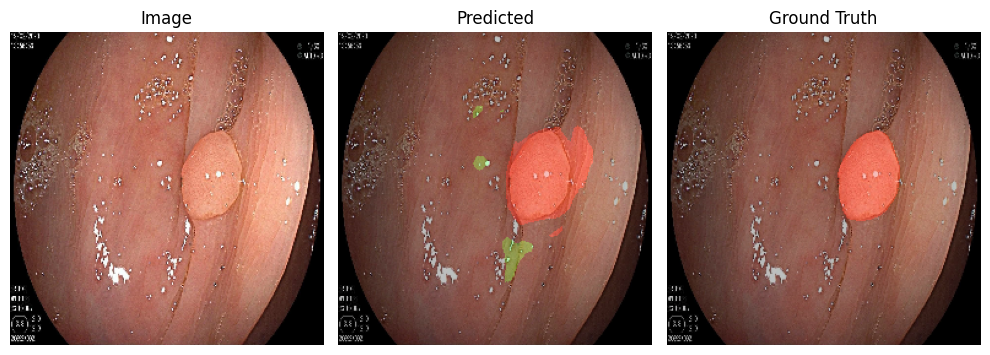

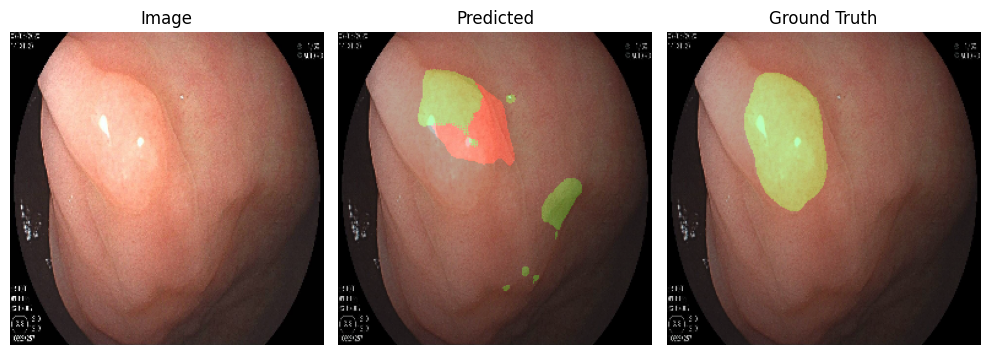

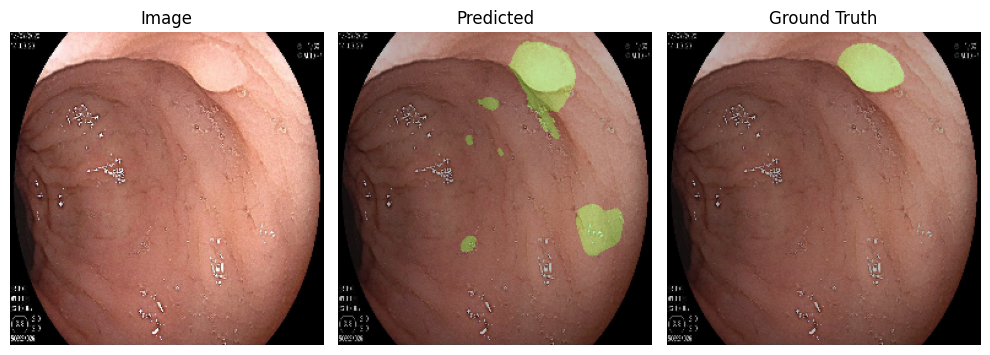

In [40]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = AttentionUNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/attnunetset1_model_final.pth")['model_state_dict'])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for Attention UNet model 1")
        evaluate_results(test_batches, plot_test_batches, model)

#### Set 2

Results for Attention UNet model 2
                      precision    recall  f1-score   support

          background       0.98      0.98      0.98  12750928
    neoplastic polyp       0.67      0.65      0.66    589027
non-neoplastic polyp       0.08      0.11      0.09     94925

            accuracy                           0.96  13434880
           macro avg       0.58      0.58      0.58  13434880
        weighted avg       0.96      0.96      0.96  13434880



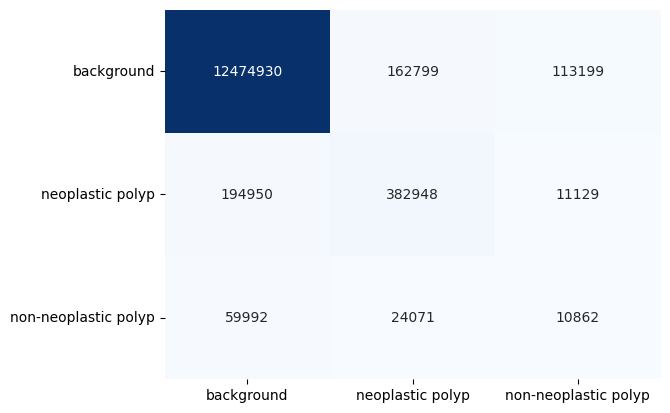

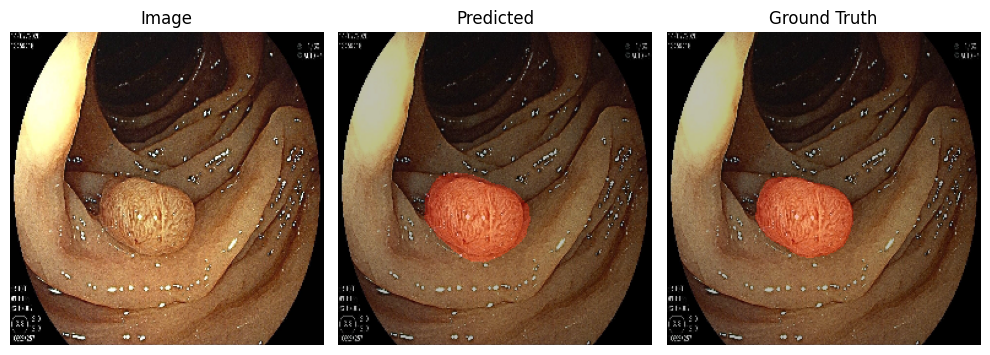

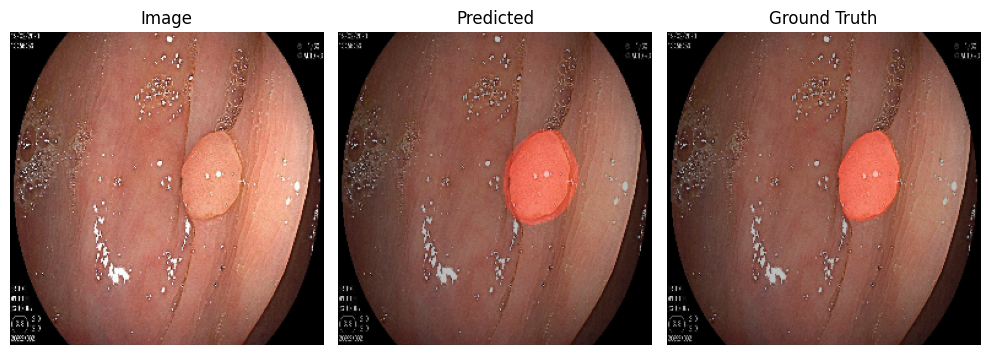

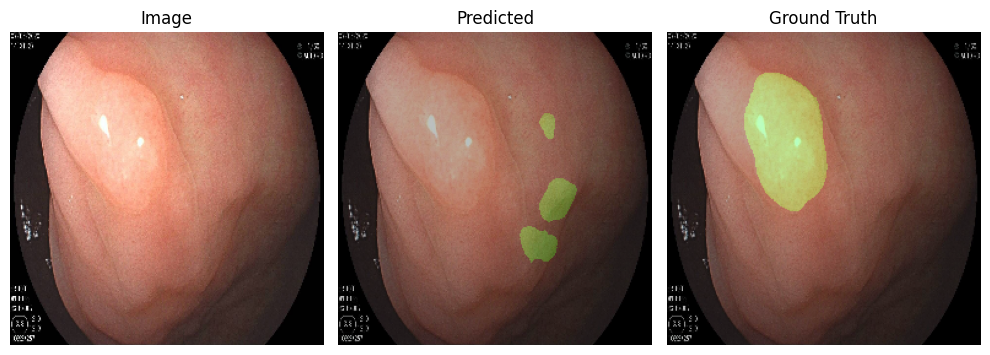

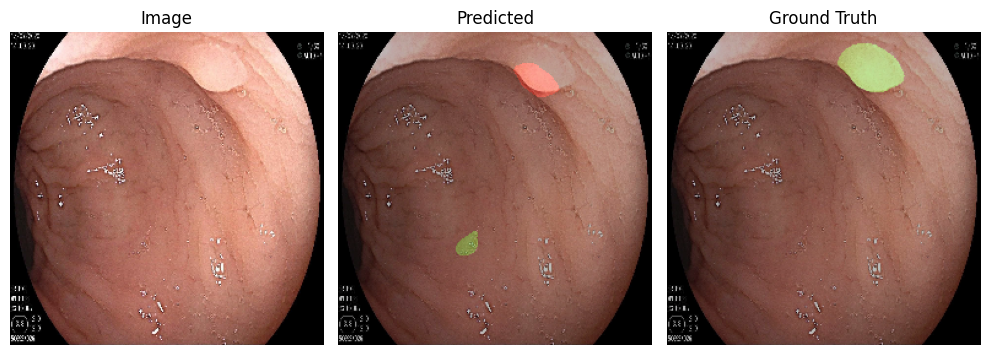

In [41]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = AttentionUNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/attnunetset2_model_final.pth")['model_state_dict'])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for Attention UNet model 2")
        evaluate_results(test_batches, plot_test_batches, model)

#### Set 3

Results for Attention UNet model 3
                      precision    recall  f1-score   support

          background       0.99      0.99      0.99  12750928
    neoplastic polyp       0.78      0.78      0.78    589027
non-neoplastic polyp       0.47      0.26      0.34     94925

            accuracy                           0.98  13434880
           macro avg       0.75      0.68      0.70  13434880
        weighted avg       0.98      0.98      0.98  13434880



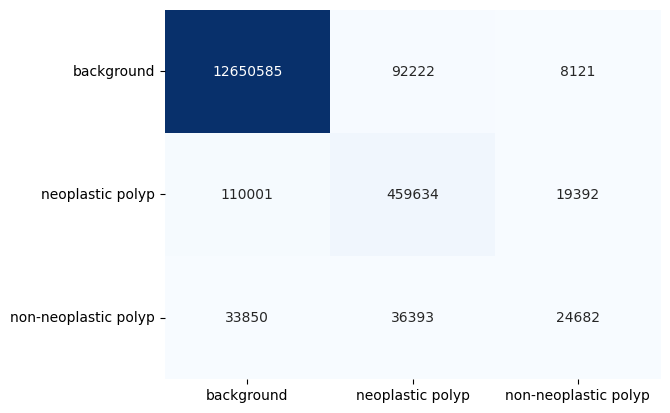

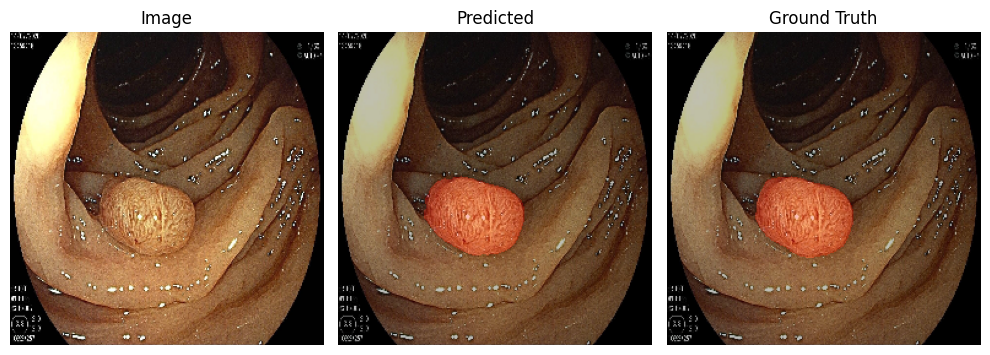

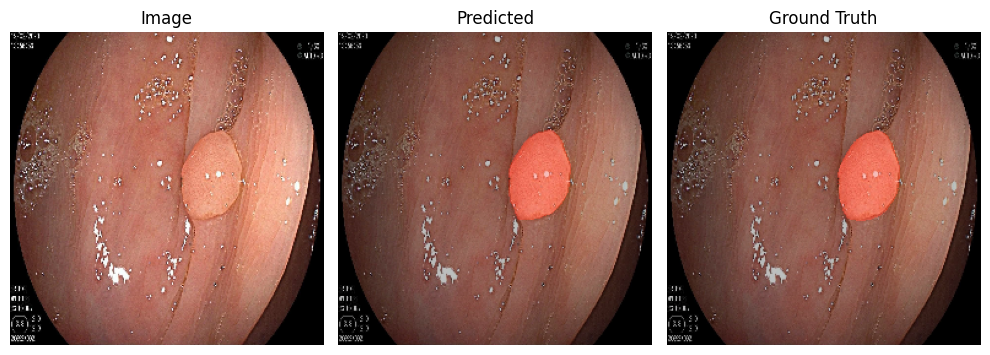

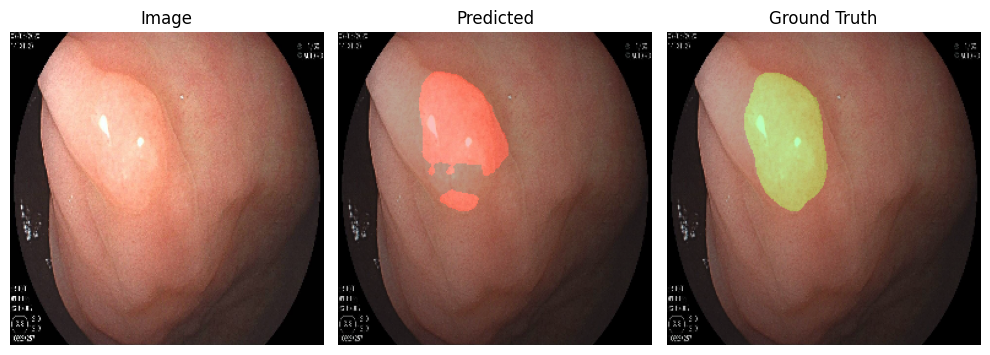

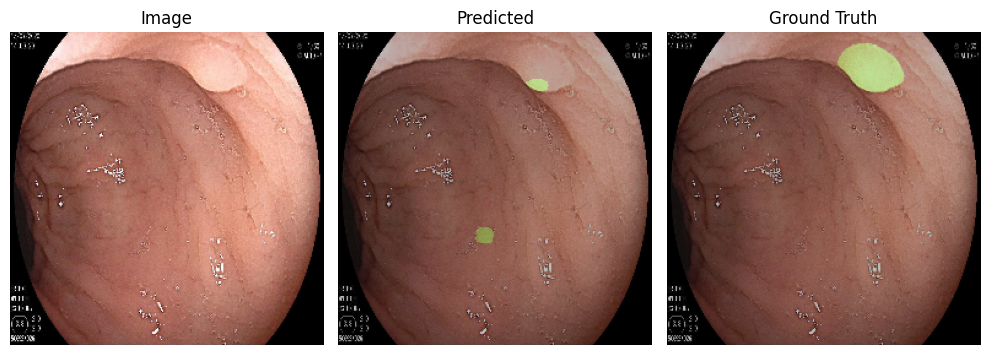

In [42]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = AttentionUNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/attnunetset3_model_final.pth")['model_state_dict'])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for Attention UNet model 3")
        evaluate_results(test_batches, plot_test_batches, model)

#### Set 4

Results for Attention UNet model 4
                      precision    recall  f1-score   support

          background       0.99      0.98      0.98  12750928
    neoplastic polyp       0.70      0.75      0.72    589027
non-neoplastic polyp       0.15      0.15      0.15     94925

            accuracy                           0.97  13434880
           macro avg       0.61      0.63      0.62  13434880
        weighted avg       0.97      0.97      0.97  13434880



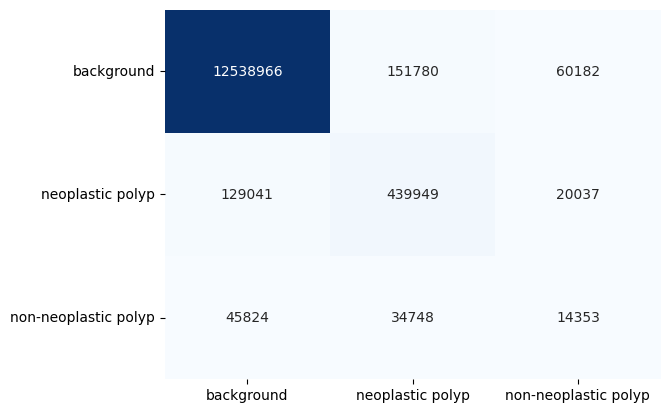

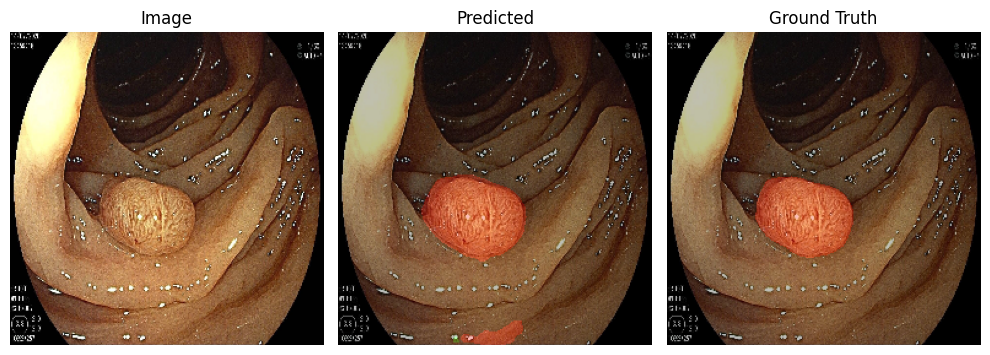

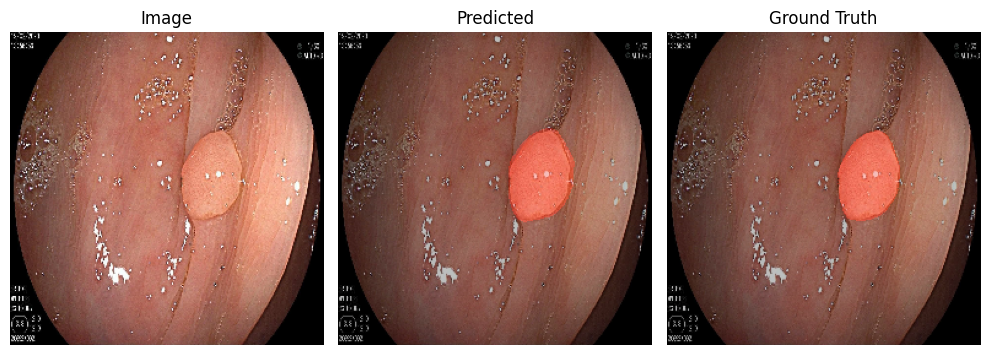

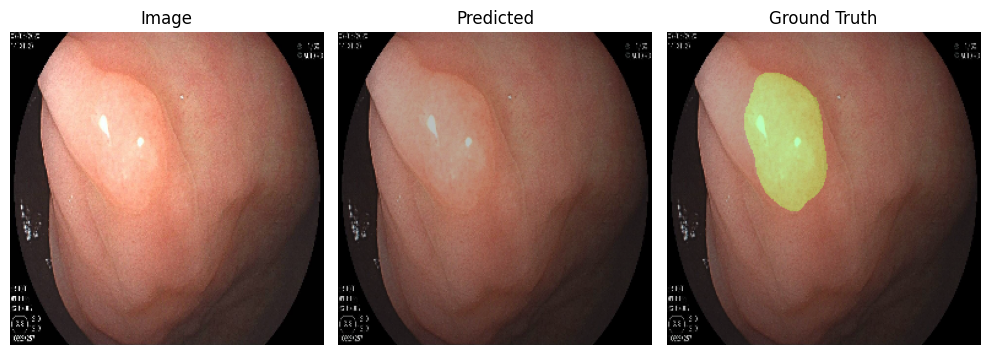

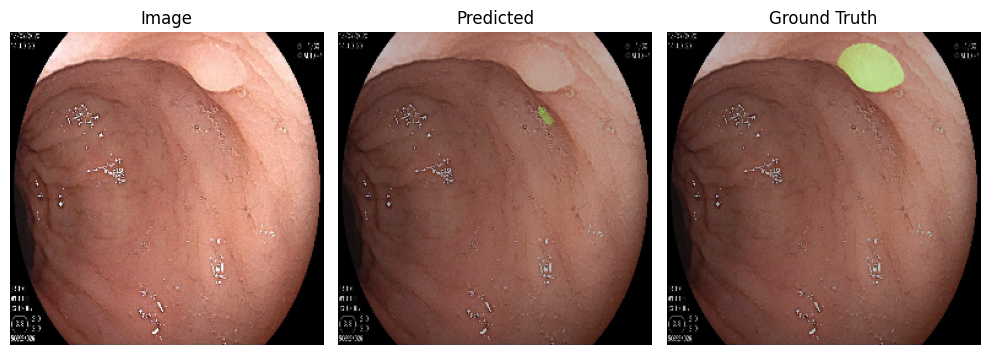

In [43]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = AttentionUNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/attnunetset4_model_final.pth")['model_state_dict'])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for Attention UNet model 4")
        evaluate_results(test_batches, plot_test_batches, model)

<i>Optional garbage collection to free up space</i>

In [44]:
torch.cuda.empty_cache()
gc.collect()

34220

<a id="6"></a>
## 6. Comparing Both Models

### Best Hyperparameters

From the results above, it shows that the among the explored hyperparameters the best hyperparameters for both Unnet and Attention Unet architecture in this train-validation split shuffle are:
- Loss function: Dice Loss
- Learning Rate: 1e-4, i.e. 0.0001

### Performance on Test Set

The best models are handpicked from the best checkpoints available of the above mentioned models based on highest validation score.

The best Unet model based on highest validation score (on 220 epoch) performs differenly compared to the complete 250 epochs with a lower f1 score per class

#### Best Dice Loss Unet Model

Results for Best UNet model
                      precision    recall  f1-score   support

          background       0.99      1.00      0.99  12750928
    neoplastic polyp       0.84      0.78      0.81    589027
non-neoplastic polyp       0.49      0.28      0.35     94925

            accuracy                           0.98  13434880
           macro avg       0.77      0.68      0.72  13434880
        weighted avg       0.98      0.98      0.98  13434880



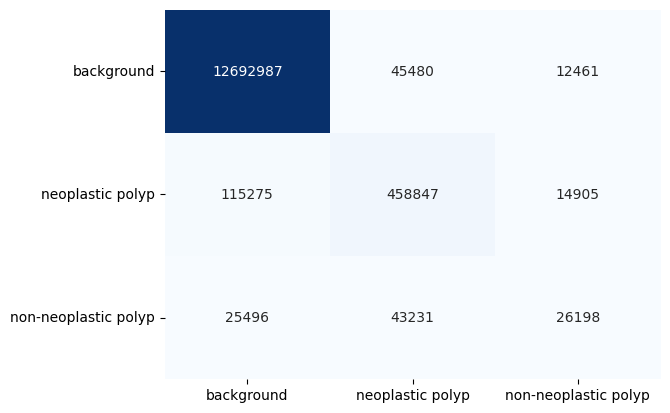

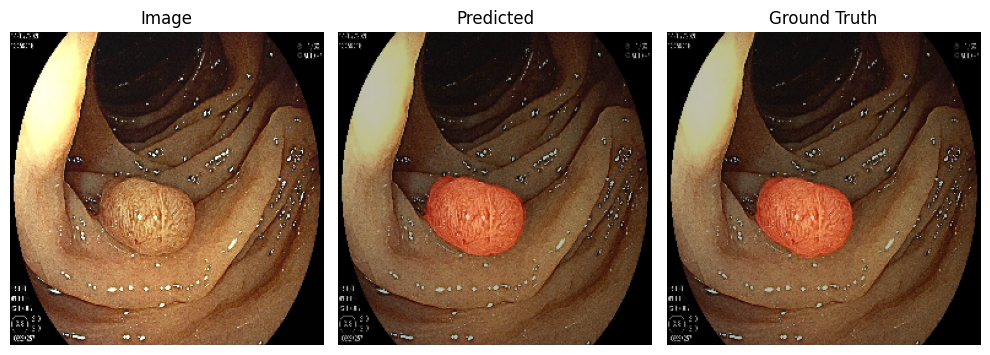

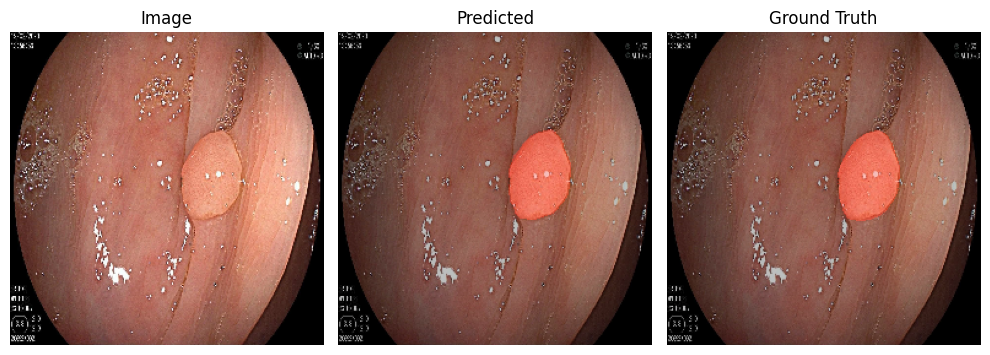

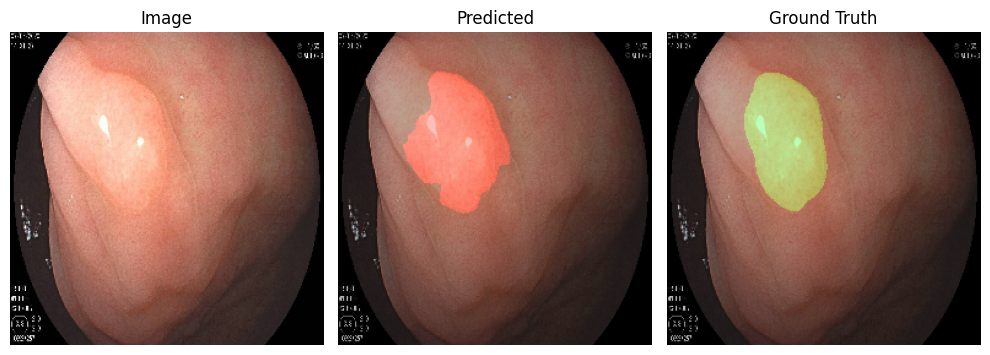

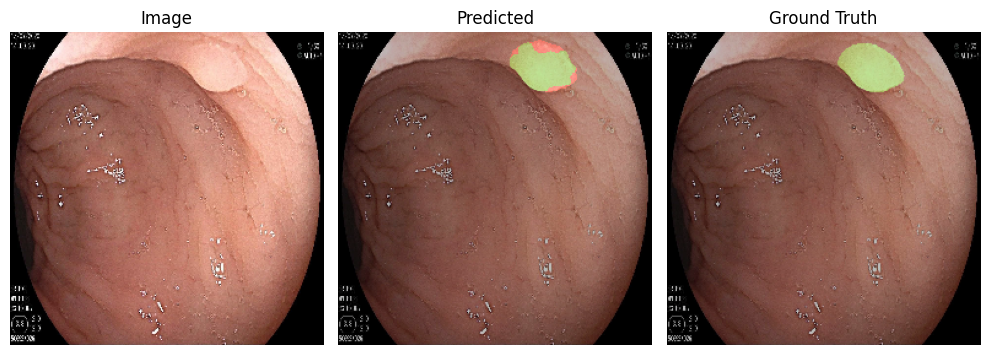

In [46]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = UNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/unetset3_model_epoch220.pth")['model_state_dict'])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for Best UNet model")
        evaluate_results(test_batches, plot_test_batches, model)

#### Best Dice Loss Attention Unet Model

Results for Best Attention UNet model
                      precision    recall  f1-score   support

          background       0.99      0.99      0.99  12750928
    neoplastic polyp       0.80      0.78      0.79    589027
non-neoplastic polyp       0.48      0.30      0.37     94925

            accuracy                           0.98  13434880
           macro avg       0.76      0.69      0.72  13434880
        weighted avg       0.98      0.98      0.98  13434880



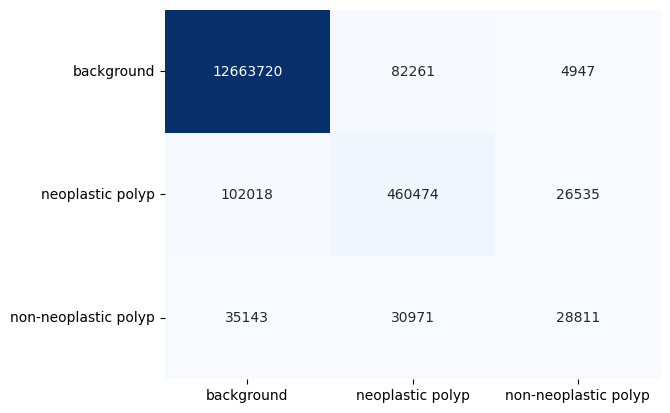

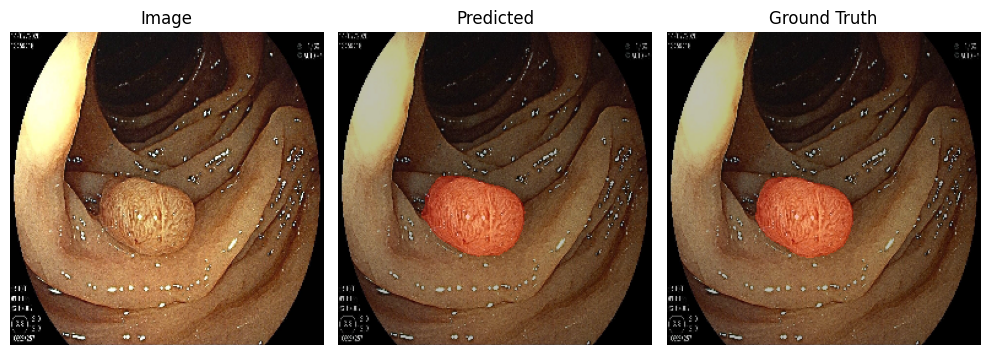

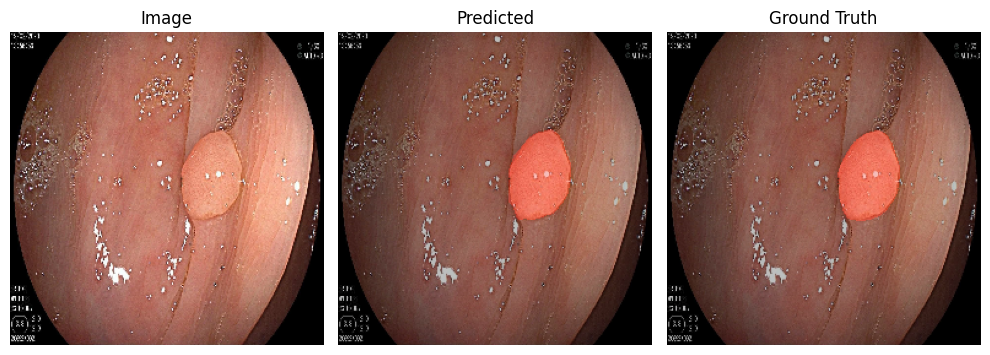

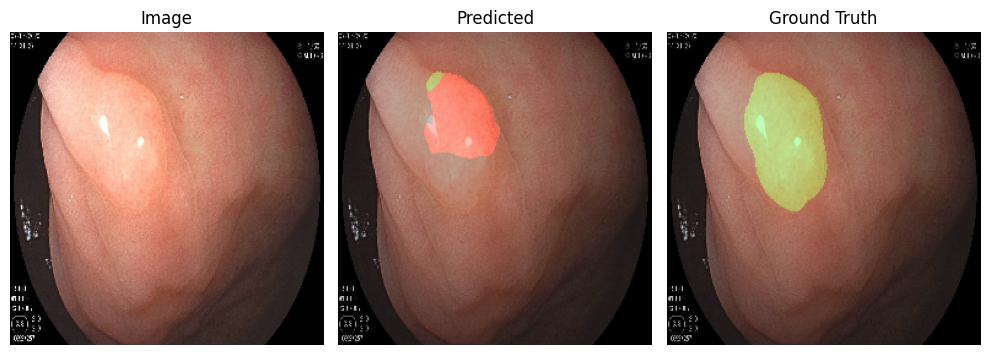

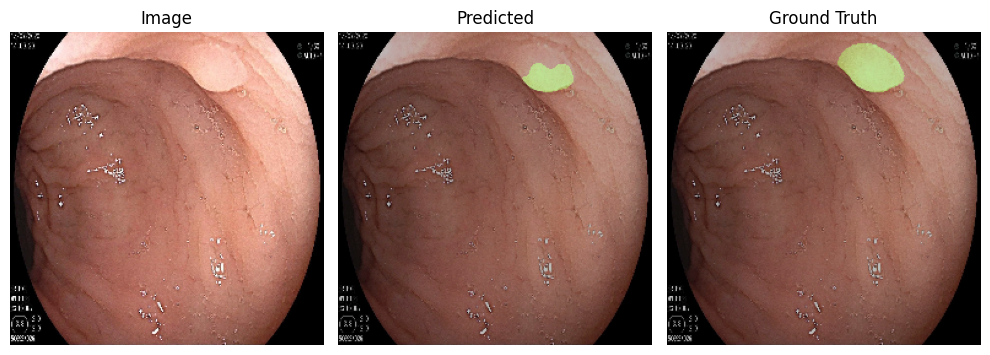

In [47]:
if __name__ == "__main__":
    torch.manual_seed(0)
    test_batches = DataLoader(test_dataset, shuffle=False, batch_size=len(test_dataset), pin_memory=True)
    torch.manual_seed(0)
    plot_test_batches = DataLoader(test_dataset, batch_size=4, shuffle=False, pin_memory=True)

    # load model
    model = AttentionUNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/attnunetset3_model_epoch220.pth")['model_state_dict'])
    model.to(device)

    with torch.no_grad():
        model.eval()
        print("Results for Best Attention UNet model")
        evaluate_results(test_batches, plot_test_batches, model)

### Plotting feature maps

In [118]:
def get_activation(activation, name):
        def hook(model, input, output):
            if name.startswith("Encoding"):
                activation[name] = output[0].detach(), output[1].detach()
            else:
                activation[name] = output.detach()
        return hook
    
def plot_feature_map(values, layer_name):
    x = values
    skip = None
    if layer_name.startswith("Encoding"):
        x, skip = values

    def plot_output_features(output, rows, cols, fig_title, fig_size=(10, 5)):
        fig, ax = plt.subplots(rows, cols, figsize=fig_size)
        fig.suptitle(fig_title)
        if rows > 1:
            for i in range(output.shape[1]):
                row = i % rows
                col = i // rows
                ax[row, col].imshow(output[0, i, :, :].cpu().numpy(), cmap="gray")
                ax[row, col].axis("off")
        else:
            for i in range(output.shape[1]):
                ax[i].imshow(output[0, i, :, :].cpu().numpy(), cmap="gray")
                ax[i].axis("off")
        plt.tight_layout()
        plt.show()

    if layer_name == "Output":
        plot_output_features(x, 1, 3, f"{layer_name} features", (15, 5))
    if layer_name.startswith("Decoding"):
        plot_output_features(x, 8, x.shape[1]//8, f"{layer_name} features", (x.shape[1]//8, 8))
    if skip is not None:
        plot_output_features(skip, 8, skip.shape[1]//8, f"{layer_name} skip features", (skip.shape[1]//8, 8))


#### Best Dice Loss Unet Model

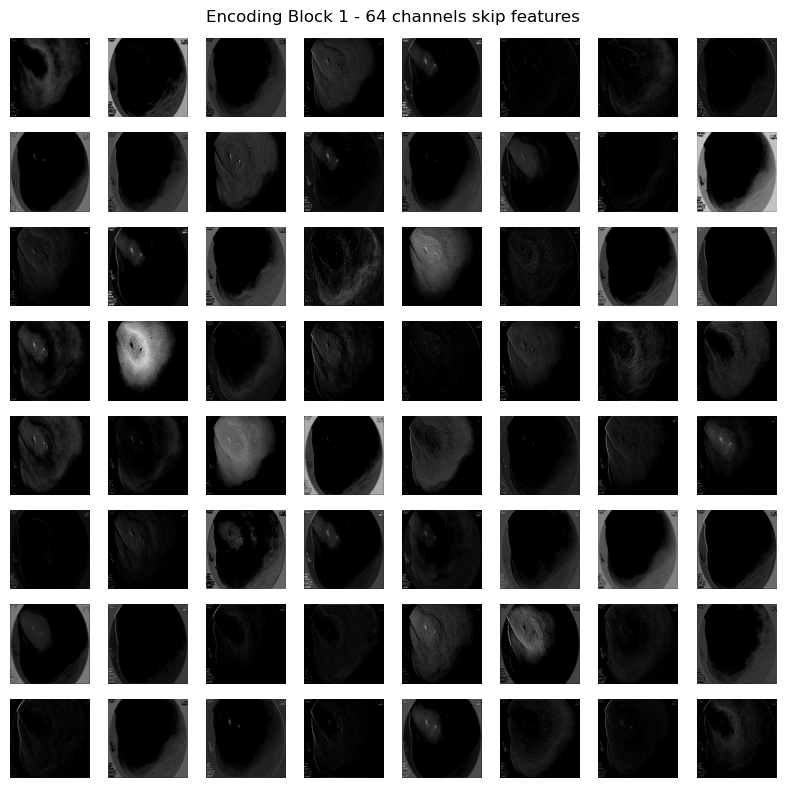

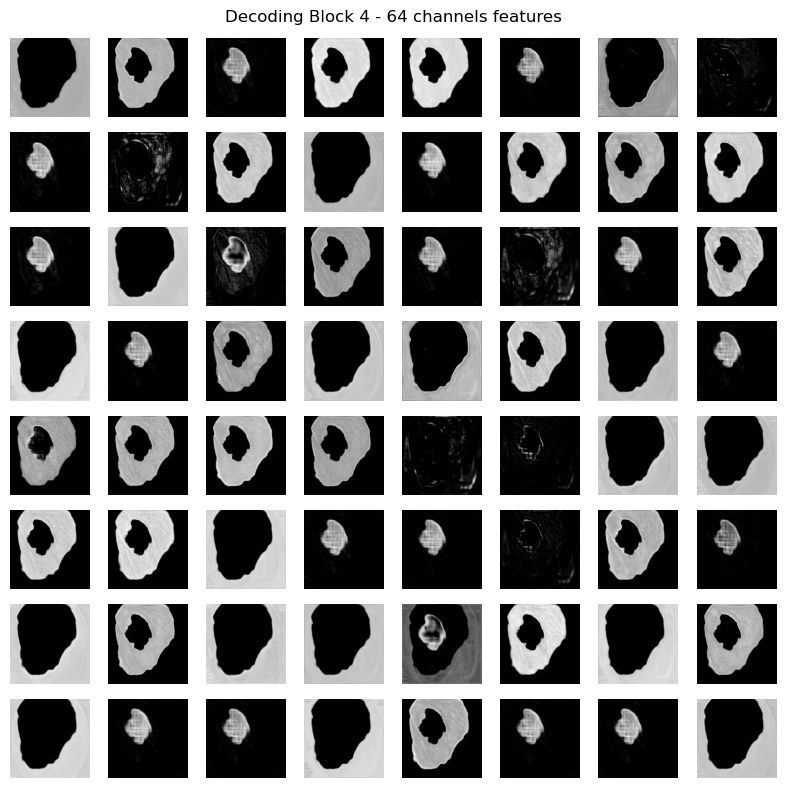

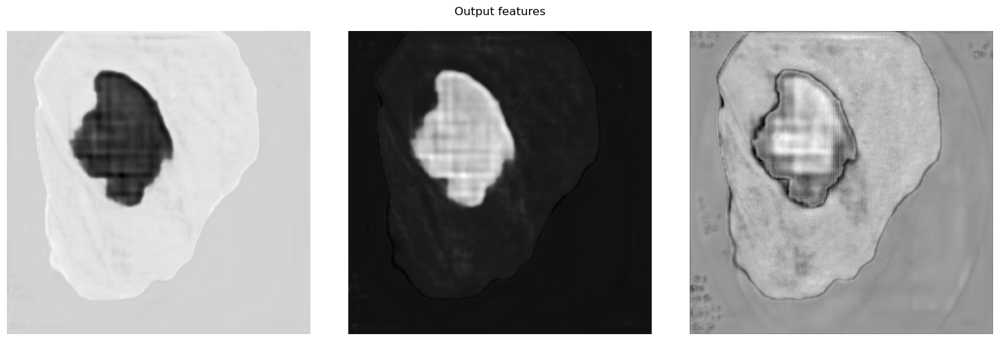

In [119]:
if __name__ == "__main__":
    # load model
    model = UNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/unetset3_model_epoch220.pth")['model_state_dict'])
    model.to(device)

    activation = {}

    with torch.no_grad():
        model.eval()

        # register hooks
        model.down1.register_forward_hook(get_activation(activation, 'Encoding Block 1 - 64 channels'))
        model.up4.register_forward_hook(get_activation(activation, 'Decoding Block 4 - 64 channels'))
        model.out.register_forward_hook(get_activation(activation, 'Output'))

        # run forward pass
        sample_img, _ = test_dataset[2]
        sample_img = sample_img.unsqueeze(0).to(device)
        pred_mask = model(sample_img)

        # plot feature maps
        for key, value in activation.items():
            plot_feature_map(value, key)

#### Best Dice Loss Attention Unet Model

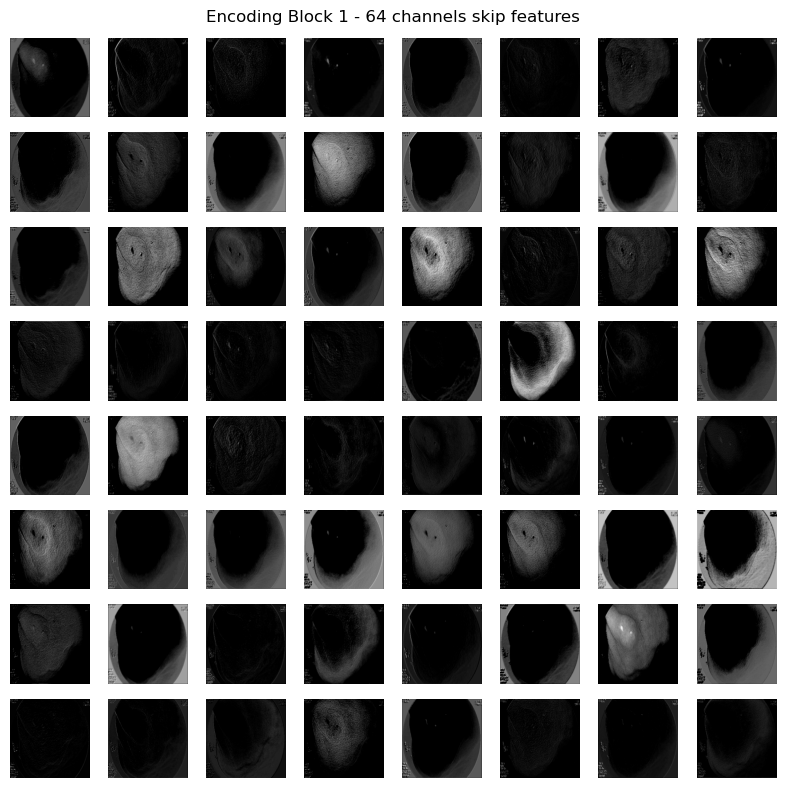

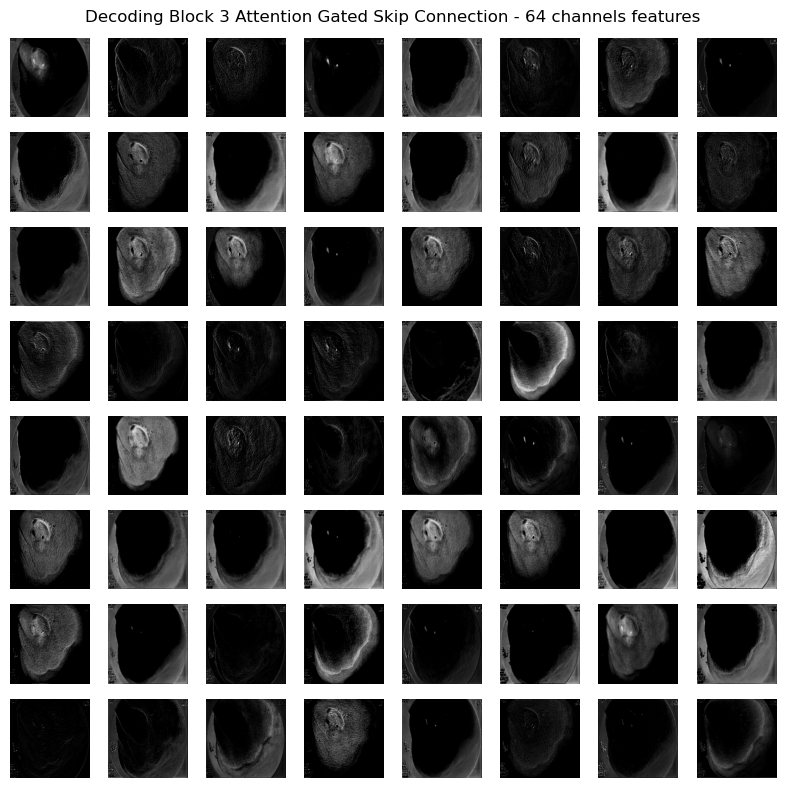

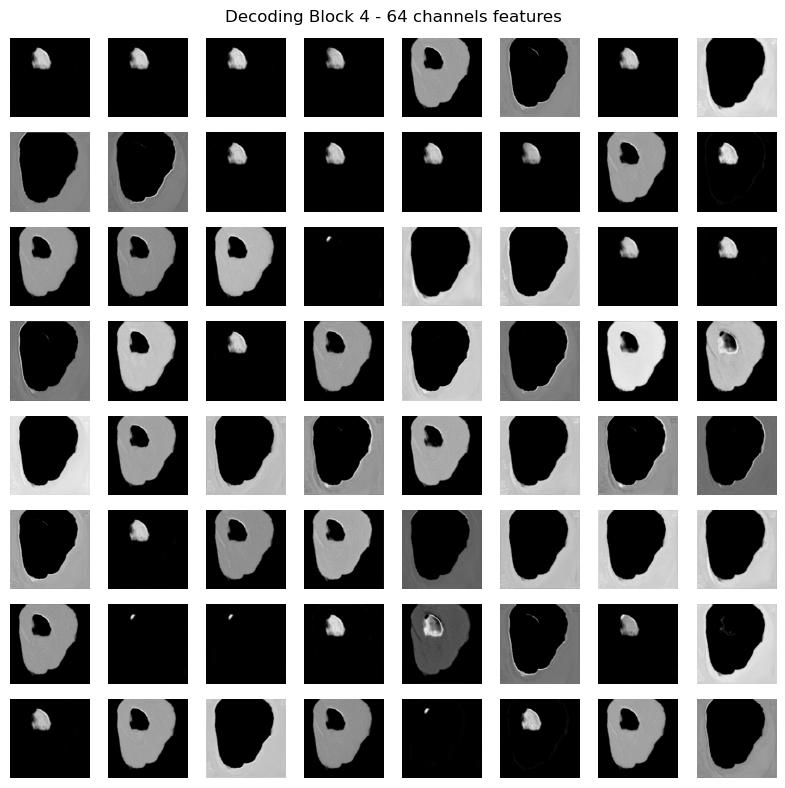

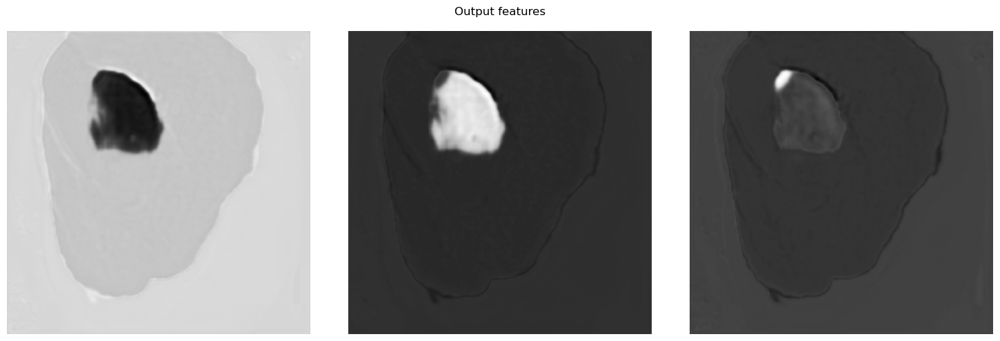

In [122]:
if __name__ == "__main__":
    # load model
    model = AttentionUNet(out_channels=3)
    model.load_state_dict(torch.load(f"{project_folder_path}models/attnunetset3_model_epoch220.pth")['model_state_dict'])
    model.to(device)

    activation = {}
    
    with torch.no_grad():
        model.eval()

        # register hooks
        model.down1.register_forward_hook(get_activation(activation, 'Encoding Block 1 - 64 channels'))
        model.up4.attn.register_forward_hook(get_activation(activation, 'Decoding Block 3 Attention Gated Skip Connection - 64 channels'))
        model.up4.register_forward_hook(get_activation(activation, 'Decoding Block 4 - 64 channels'))
        model.out.register_forward_hook(get_activation(activation, 'Output'))

        # run forward pass
        sample_img, _ = test_dataset[2]
        sample_img = sample_img.unsqueeze(0).to(device)
        pred_mask = model(sample_img)

        # plot feature maps
        for key, value in activation.items():
            plot_feature_map(value, key)